# Comparison of climate model prediction and ERA5 historical data for beginning of century (2015 - 2022)

In [1]:
from atlite.datasets.era5 import retrieve_data, _rename_and_clean_coords, retrieval_times, _area
import xarray as xr
import atlite
from pathlib import Path
import math

import logging
import cdsapi
import cartopy.crs as ccrs
from cartopy.crs import PlateCarree as plate
from cartopy.io import shapereader
import geopandas as gpd
import cartopy.crs as ccrs
import matplotlib as mpl
import matplotlib.pyplot as plt
logging.basicConfig(level=logging.INFO)

import numpy as np
import pandas as pd

import pgeocode      
import seaborn as sns

import scipy.sparse as sp
from collections import OrderedDict
%matplotlib inline
import requests
import os
# Removing facets warning: 
os.environ['ESGF_PYCLIENT_NO_FACETS_STAR_WARNING']='1'
import zipfile
import datetime
from dateutil.relativedelta import relativedelta

from matplotlib.gridspec import GridSpec
from atlite.gis import shape_availability, ExclusionContainer
from rasterio.plot import show
from matplotlib.colors import TwoSlopeNorm

from matplotlib.colors import LinearSegmentedColormap
from matplotlib.gridspec import GridSpec
from countrygroups import EUROPEAN_UNION

import rioxarray
from mpl_toolkits.axes_grid1 import AxesGrid
import rasterio

# Defining figure size for maps:
map_fig_size = (8,8)
turbine = "Siemens_SWT_107_3600kW"
PV_panel = atlite.solarpanels.CSi
num_years_ERA5 = 8               # number of years in ERA5 cutouts

In [2]:
# Loading a simple excel spreadsheet that defines what color should be used for each CMIP6 model in the future plots
model_colors = pd.read_excel("model_colors.xlsx",header=0,index_col=0)

In [3]:
# Defining plotting function: 
def plot_path(plot_filename):
    plot_path = f'Figures/{plot_filename}'
    return plot_path

In [4]:
# Creating custom color map range to enable transparent background outside country borders

# get colormap
ncolors = 256
color_array = plt.get_cmap('Greens')(range(ncolors))

# change alpha values
color_array[:,-1] = np.linspace(0.0,1.0,ncolors)

# create a colormap object
map_object = LinearSegmentedColormap.from_list(name='green_alpha',colors=color_array)

# register this new colormap with matplotlib (needs to be run once after opening the document)
plt.matplotlib.colormaps.register(cmap=map_object)

In [5]:
# Adding non-EU countries to the list of countries

others = (["Switzerland","Czech Republic", "Serbia","Albania", "United Kingdom", 
           "Montenegro","Bosnia and Herzegovina","North Macedonia","Kosovo","Norway"])
europe_list = EUROPEAN_UNION.names + others
europe_list.remove("Czechia")
europe_list.sort()
# print(europe_list)

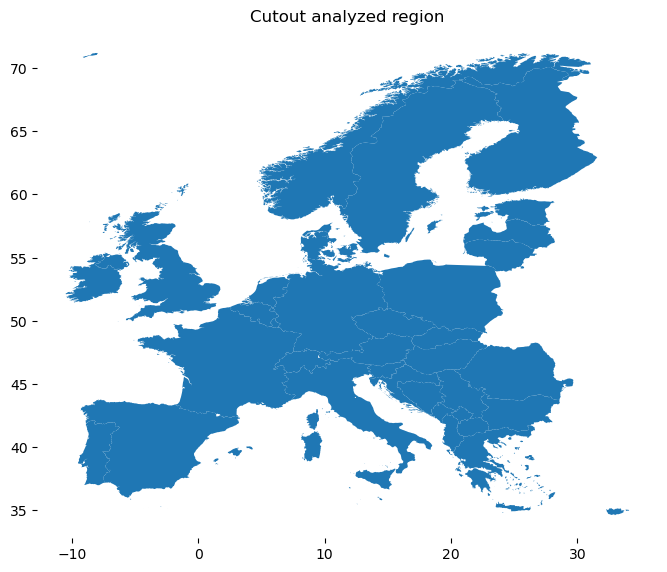

In [6]:
# Defining shape of European countries

shpfilename = shapereader.natural_earth(
    resolution="10m", category="cultural", name="admin_0_countries"
)
reader = shapereader.Reader(shpfilename)
Europe = gpd.GeoSeries(
    {r.attributes["NAME_EN"]: r.geometry for r in reader.records()},
    crs="epsg:4326",
).reindex(europe_list)

# Removing extra territories (islands in the Atlantic, etc.)
mask = (-11, 30, 50, 74)
Europe = Europe.clip(mask)
Europe.plot(figsize=map_fig_size,aspect='equal').set_frame_on(False)
# plt.grid()
plt.title('Cutout analyzed region');

bounds = Europe.unary_union.buffer(1).bounds

In [7]:
# Importing ERA5 cutouts from external HDD
date_format = "%Y-%m-%d"
start_date = "2015-01-01"
end_date = "2015-12-31"

for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    filename = f'Europe_ERA5_{i}.nc'
    path = f'E://Cutouts/{filename}'
    locals()[cutout_name] = atlite.Cutout(path=path, module="era5", bounds=bounds, time=slice(start_date, end_date))
    start = datetime.datetime.strptime(start_date,date_format).date() + relativedelta(years=1)
    end = datetime.datetime.strptime(end_date,date_format).date() + relativedelta(years=1)
    start_date = datetime.datetime.strftime(start,date_format)
    end_date = datetime.datetime.strftime(end,date_format)

c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time are ignored, since cutout is already built.
  warn(
c:\Users\c

In [8]:
# ## Testing ERA5 cutout with coarser grid: 

# CF_avg_wind_coarse_test = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True,index=Europe.index)

# name = f'CF_avg_wind_{CMIP6_model}_ssp585_15_22'
# CF_avg_wind_coarse_test = CF_avg_wind_coarse_test.interp_like(locals()[name], method='linear')

# plot_grid_dict = dict(
#     alpha=0.1,
#     edgecolor="k",
#     zorder=4,
#     aspect="equal",
#     facecolor="None",
#     transform=plate(),
#     )
# cap_factors = CF_avg_wind_coarse_test
# fig, ax = plt.subplots(subplot_kw={"projection": projection}, figsize=map_fig_size)
# cap_factors.name = "Capacity Factor"
# cap_factors.plot(ax=ax, transform=plate(), alpha=0.9)
# cells.plot(ax=ax, **plot_grid_dict)
# Europe.plot(ax=ax,transform=plate(),edgecolor="k",color="None",aspect="equal").set_frame_on(False);
# ax.spines['geo'].set_edgecolor('None')
# fig.tight_layout();
# ax.set_title('Average capacity factor for onshore wind');

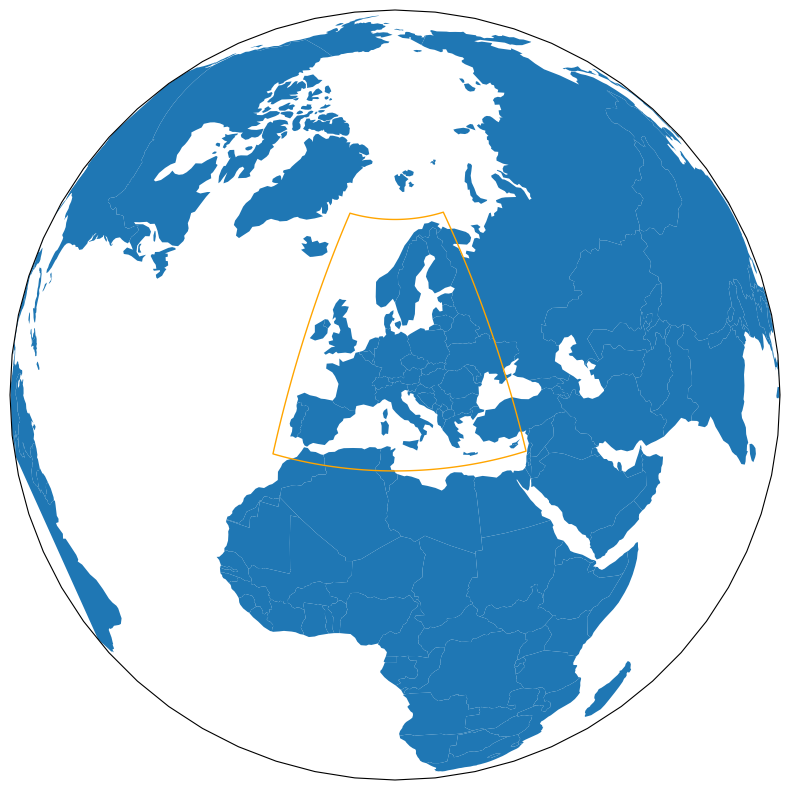

In [9]:
# Defining projection: 
cells = Europe_ERA5_15.grid
df = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
country_bound = gpd.GeoSeries(cells.unary_union)

projection = ccrs.Orthographic(11, 45)
fig, ax = plt.subplots(subplot_kw={"projection": projection}, figsize=map_fig_size)
df.plot(ax=ax, transform=plate())
country_bound.plot(ax=ax, edgecolor="orange", facecolor="None", transform=plate())
fig.tight_layout()

In [10]:
# Importing/creating  CMIP6 cutouts from external HDD
# Models with all 4 ssp variants:
CMIP6_models = ['EC-Earth3', 'MPI-ESM1-2-HR', 'MIROC6', 'MPI-ESM1-2-LR']
ssp_variants = ['ssp126', 'ssp245', 'ssp370', 'ssp585']

# folder with the cutout NetCDF files: 
output_file_path = f'E://Cutouts/CMIP6_BOC/'

date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000

for i in CMIP6_models:
    i = i.replace("-", "_")     # Replacing - with _ for all CMIP6 model names
    for j in ssp_variants:
        cutout_name = f'Europe_{i}_{j}_{yy_start}_{yy_end}'
        filename = f'Europe_{i}_{j}_{yy_start}_{yy_end}.nc'
        path = f'{output_file_path}{filename}'
        locals()[cutout_name] = atlite.Cutout(
        path=path, module="cmip", bounds=bounds, time=slice(start_date, end_date),
        dt='3H',dx=1, dy=1)

c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy ar

In [11]:
# Importing Global wind atlas data (data downloaded from: https://globalwindatlas.info/api/gis/global/wind-speed/100)
gwa_data = rioxarray.open_rasterio("E://Cutouts/GWA from Marta/gwa3_250_windspeed_100m.tif")

# use version 1.2.9 of rasterio for the working Resampling by mean
# downsamples the gwa data to match the raster of the cutout. The resampling is done with averaging the wind speed.
gwa=gwa_data.sel(band=1, x=slice(*Europe_ERA5_15.extent[[0,1]]), y=slice(*Europe_ERA5_15.extent[[3,2]]))
gwa=gwa.where(gwa!=-999)
gwa=atlite.gis.regrid(gwa,Europe_ERA5_15.data.x, Europe_ERA5_15.data.y,resampling=rasterio.warp.Resampling.average)

gwa_CMIP_res = atlite.gis.regrid(gwa,Europe_EC_Earth3_ssp585_15_22.data.x, Europe_EC_Earth3_ssp585_15_22.data.y,resampling=rasterio.warp.Resampling.average)

In [12]:
# Importing/creating  CMIP6 cutouts from external HDD
CMIP6_models = ['HadGEM3-GC31-MM']
ssp_variants = ['ssp126', 'ssp585']

date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000

for i in CMIP6_models:
    i = i.replace("-", "_")     # Replacing - with _ for all CMIP6 model names
    for j in ssp_variants:
        cutout_name = f'Europe_{i}_{j}_{yy_start}_{yy_end}'
        filename = f'Europe_{i}_{j}_{yy_start}_{yy_end}.nc'
        path = f'{output_file_path}{filename}'
        locals()[cutout_name] = atlite.Cutout(
        path=path, module="cmip", bounds=bounds, time=slice(start_date, end_date),
        dt='3H',dx=1, dy=1)

c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(


In [13]:
# Importing/creating  CMIP6 cutouts from external HDD
CMIP6_models = ['HadGEM3-GC31-LL']
ssp_variants = ['ssp126', 'ssp245', 'ssp585']

date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000

for i in CMIP6_models:
    i = i.replace("-", "_")     # Replacing - with _ for all CMIP6 model names
    for j in ssp_variants:
        cutout_name = f'Europe_{i}_{j}_{yy_start}_{yy_end}'
        filename = f'Europe_{i}_{j}_{yy_start}_{yy_end}.nc'
        path = f'{output_file_path}{filename}'
        locals()[cutout_name] = atlite.Cutout(
        path=path, module="cmip", bounds=bounds, time=slice(start_date, end_date),
        dt='3H',dx=1, dy=1)

c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(


In [14]:
# Importing/creating  CMIP6 cutouts from external HDD
CMIP6_models = ['IPSL-CM6A-LR','AWI-CM-1-1-MR','EC-Earth3-Veg','ACCESS-CM2']
ssp_variants = ['ssp585']

date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000

for i in CMIP6_models:
    i = i.replace("-", "_")     # Replacing - with _ for all CMIP6 model names
    for j in ssp_variants:
        cutout_name = f'Europe_{i}_{j}_{yy_start}_{yy_end}'
        filename = f'Europe_{i}_{j}_{yy_start}_{yy_end}.nc'
        path = f'{output_file_path}{filename}'
        locals()[cutout_name] = atlite.Cutout(
        path=path, module="cmip", bounds=bounds, time=slice(start_date, end_date),
        dt='3H',dx=1, dy=1)

c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(


In [15]:
# Importing/creating  EC-Earth3 cutouts with wind_100m from external HDD
CMIP6_models = ['EC-Earth3']
ssp_variants = ['ssp126', 'ssp245', 'ssp370', 'ssp585'] 

date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000

for i in CMIP6_models:
    i = i.replace("-", "_")     # Replacing - with _ for all CMIP6 model names
    for j in ssp_variants:
        cutout_name = f'Europe_{i}_{j}_{yy_start}_{yy_end}_wind_100m'
        filename = f'{cutout_name}.nc'
        path = f'{output_file_path}EC_Earth3 with wind_100m/{filename}'
        locals()[cutout_name] = atlite.Cutout(
        path=path, module="cmip", bounds=bounds, time=slice(start_date, end_date),
        dt='3H',dx=1, dy=1)

c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(


c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(


In [16]:
# Generating average CF per year for wind for EC-Earth3 models WITH WIND_100M: 
overwrite = 0;

output_folder_path = f'E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/'

CMIP6_models = ['EC-Earth3']
ssp_variants = ['ssp126', 'ssp245', 'ssp370', 'ssp585'] 

for CMIP6_model in CMIP6_models:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        name = f'CF_avg_wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
        filename = f'{name}.nc'
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
        cutout_path = f'E://Cutouts/CMIP6_BOC/EC_Earth3 with wind_100m/{cutout_name}.nc'
        if Path(cutout_path).is_file():        # Checking if a cutout exists
            path = f'{output_folder_path}{filename}'
            if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
                # Creating wind timeseries:
                print(f'Creating "{filename}"')
                locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True)
                locals()[name].to_netcdf(path=path)      # Saving wind CF to file
            else:
                locals()[name] = xr.open_dataarray(path)
                print(f'"{filename}" already exists in "{path}". ')
        else: 
            print(f'File "{path}" skipped as it does not exist. ')

# Output all prepared files: 
prepared_files = os.listdir(output_folder_path)
print(f'\nPrepared files: ')
print(*prepared_files, sep='\n')

"CF_avg_wind_EC_Earth3_ssp126_15_22_wind_100m.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_EC_Earth3_ssp126_15_22_wind_100m.nc". 
"CF_avg_wind_EC_Earth3_ssp245_15_22_wind_100m.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_EC_Earth3_ssp245_15_22_wind_100m.nc". 
"CF_avg_wind_EC_Earth3_ssp370_15_22_wind_100m.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_EC_Earth3_ssp370_15_22_wind_100m.nc". 
"CF_avg_wind_EC_Earth3_ssp585_15_22_wind_100m.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_EC_Earth3_ssp585_15_22_wind_100m.nc". 

Prepared files: 
CF_avg_wind_EC_Earth3_ssp126_15_22.nc
CF_avg_wind_EC_Earth3_ssp245_15_22.nc
CF_avg_wind_EC_Earth3_ssp370_15_22.nc
CF_avg_wind_EC_Earth3_ssp585_15_22.nc
CF_avg_wind_HadGEM3_GC31_MM_ssp126_15_22.nc
CF_avg_wind_HadGEM3_GC31_MM_ssp585_15_22.nc
CF_avg_wind_MPI_ESM1_2_HR_ssp126_15_22.nc
CF_a

In [17]:
# All CMIP6 models: 
CMIP6_models = ['EC-Earth3', 'MPI-ESM1-2-HR', 'MIROC6', 'MPI-ESM1-2-LR', 'HadGEM3-GC31-LL', 'HadGEM3-GC31-MM', 'IPSL-CM6A-LR', 'AWI-CM-1-1-MR']
CMIP6_models_wind = ['EC-Earth3', 'MPI-ESM1-2-HR', 'MIROC6', 'MPI-ESM1-2-LR', 'HadGEM3-GC31-LL', 'HadGEM3-GC31-MM', 'IPSL-CM6A-LR', 'AWI-CM-1-1-MR', 'EC-Earth3-Veg']
CMIP6_models_wind_selection = ['EC-Earth3', 'MPI-ESM1-2-HR', 'MPI-ESM1-2-LR', 'HadGEM3-GC31-LL', 'HadGEM3-GC31-MM', 'IPSL-CM6A-LR', 'AWI-CM-1-1-MR', 'EC-Earth3-Veg']
CMIP6_models_solar = ['EC-Earth3', 'MPI-ESM1-2-HR', 'MIROC6', 'MPI-ESM1-2-LR', 'HadGEM3-GC31-LL', 'HadGEM3-GC31-MM', 'IPSL-CM6A-LR', 'AWI-CM-1-1-MR','ACCESS-CM2']
ssp_variants = ['ssp126', 'ssp245', 'ssp370', 'ssp585']

In [18]:
# Generating average CF per year for wind for CMIP6 models:
overwrite = 0;

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/'
output_folder_path_PV = f'E://Cutouts/CMIP6_BOC/Annual average CF per cell/PV/'

# Defining roughness to extrapolate hub height wind speed:
roughness = xr.open_dataset('roughness.nc')
roughness = roughness.rename({'fsr':'roughness'})
roughness = roughness.mean(dim='time')
roughness = _rename_and_clean_coords(roughness)
roughness.roughness.attrs['prepared_feature'] = 'wind'
# Wind:
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        cutout_path = f'E://Cutouts/CMIP6_BOC/{cutout_name}.nc'
        my_file = Path(cutout_path)
        name = f'CF_avg_wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'    # Defining average CF filename: 
        filename = f'{name}.nc'
        path = f'{output_folder_path}{filename}'
        if my_file.is_file():
            if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
                # Adding roughness data (from ERA5) into the cutout:
                da = roughness.roughness.interp_like(locals()[cutout_name].data['wnd10m'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                # Creating wind timeseries:
                print(f'Creating "{filename}"')
                locals()[name] = locals()[cutout_name].wind(turbine=turbine, capacity_factor=True)
                locals()[name].to_netcdf(path=path)      # Saving average CF to file
            else:
                locals()[name] = xr.open_dataarray(path)
                # print(f'"{filename}" already exists in "{path}". ')
        else: 
            print(f'File "{path}" skipped. The cutout does not exist. ')
# PV: 
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        cutout_path = f'E://Cutouts/CMIP6_BOC/{cutout_name}.nc'
        my_file = Path(cutout_path)
        name = f'CF_avg_PV_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'     # Defining average CF filename: 
        filename = f'{name}.nc'
        path = f'{output_folder_path_PV}{filename}'
        if my_file.is_file():
            # PV
            if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
                # Creating PV timeseries:
                print(f'Creating "{filename}"')
                locals()[name] = locals()[cutout_name].pv(panel=PV_panel,orientation="latitude_optimal",capacity_factor=True)
                locals()[name].to_netcdf(path=path)      # Saving average CF to file
            else:
                locals()[name] = xr.open_dataarray(path)
                # print(f'"{filename}" already exists in "{path}". ')
        else: 
            print(f'File "{path}" skipped. The cutout does not exist. ')
            
# Output all prepared files: 
prepared_files = os.listdir(output_folder_path)
print(f'\nPrepared files: ')
print(*prepared_files, sep='\n')

File "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_HadGEM3_GC31_LL_ssp370_15_22.nc" skipped. The cutout does not exist. 
File "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_HadGEM3_GC31_MM_ssp245_15_22.nc" skipped. The cutout does not exist. 
File "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_HadGEM3_GC31_MM_ssp370_15_22.nc" skipped. The cutout does not exist. 
File "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_IPSL_CM6A_LR_ssp126_15_22.nc" skipped. The cutout does not exist. 
File "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_IPSL_CM6A_LR_ssp245_15_22.nc" skipped. The cutout does not exist. 
File "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_IPSL_CM6A_LR_ssp370_15_22.nc" skipped. The cutout does not exist. 
File "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_AWI_CM_1_1_MR_ssp126_15_22.nc" skipped. The cutout does not exist. 
File "E://Cutouts

In [19]:
# Load average CF for wind for ERA5:

for i in range(15,23):
    name = f'CF_avg_wind_{i}'
    filename = f'CF_avg_wind_{i}.nc'
    path = f'E://Cutouts/Annual average CF per cell/{filename}'
    locals()[name] = xr.open_dataarray(path)
# CF_avg_wind_15 = xr.open_dataarray("E://Cutouts/Annual average CF per cell/CF_avg_wind_15.nc")

# Average CF for 8 years: 
cap_factors = (1/num_years_ERA5)*(CF_avg_wind_15
                                  +CF_avg_wind_16
                                  +CF_avg_wind_17
                                  +CF_avg_wind_18
                                  +CF_avg_wind_19
                                  +CF_avg_wind_20
                                  +CF_avg_wind_21
                                  +CF_avg_wind_22
                     )
# Interpolate ERA5 annual average CFs to coarser grid corresponding to CMIP6 grid
name = f'CF_avg_wind_EC_Earth3_{ssp_variant}_{yy_start}_{yy_end}'
cap_factors_coarse = cap_factors.interp_like(locals()[name], method='linear')

In [20]:
# Load average CF for PV for ERA5:

for i in range(15,23):
    name = f'CF_avg_PV_{i}'
    filename = f'{name}.nc'
    path = f'E://Cutouts/Annual average CF per cell/{filename}'
    locals()[name] = xr.open_dataarray(path)

# Average CF for 8 years: 
cap_factors_PV = (1/num_years_ERA5)*(CF_avg_PV_15
                                  +CF_avg_PV_16
                                  +CF_avg_PV_17
                                  +CF_avg_PV_18
                                  +CF_avg_PV_19
                                  +CF_avg_PV_20
                                  +CF_avg_PV_21
                                  +CF_avg_PV_22
                     )
# Interpolate ERA5 annual average CFs to coarser grid corresponding to CMIP6 grid
name = f'CF_avg_PV_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
cap_factors_coarse_PV = cap_factors_PV.interp_like(locals()[name], method='linear')

In [21]:
# # Calculating indicator matrix - land only

# indicator_matrix_EC_Earth3 = 0
# for i in range(len(europe_list)):
#     # country = Europe_useful.loc[[i]].geometry.to_crs(excluder.crs)
#     indicator_matrix_ir = locals()[cutout_name].indicatormatrix(Europe)[i]

#     indicator_matrix_ir = xr.DataArray(indicator_matrix_ir.toarray().reshape(locals()[cutout_name].shape),
#                                 #    dims=['lat','lon'],
#                                    dims=['y','x'],
#                                    coords=[locals()[cutout_name].coords['lat'], locals()[cutout_name].coords['lon']])
#     # fig1 = indicator_matrix_ir.plot(cmap="green_alpha", ax=ax)
#     indicator_matrix_EC_Earth3 = indicator_matrix_EC_Earth3 + indicator_matrix_ir;

# # Saving indicator matrix to file:
# indicator_matrix_EC_Earth3.to_netcdf(path="E://Cutouts/indicator_matrix_EC_Earth3.nc")

In [22]:
# Loading indicator matrix from file:
indicator_matrix_EC_Earth3 = xr.open_dataarray("E://Cutouts/indicator_matrix_EC_Earth3.nc")
# Loading indicator matrix from file for ERA5:
indicator_matrix_ERA5 = xr.open_dataarray("E://Cutouts/indicator_matrix_ir_sum.nc")

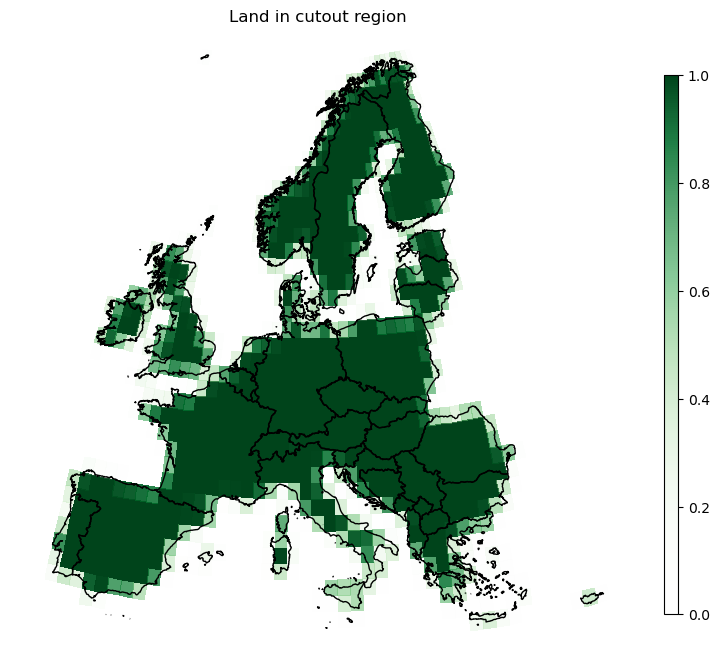

In [23]:
# Plotting indicator matrix - showing land only
fig, ax = plt.subplots(subplot_kw={"projection": projection}, figsize=map_fig_size)
# fig, ax = plt.subplots(1, figsize=map_fig_size)
indicator_matrix_EC_Earth3.plot(cmap="green_alpha", 
                                transform=plate(), 
                                ax=ax,
                                cbar_kwargs={'shrink': 0.7, 'aspect': 40});
fig.tight_layout()
ax.spines['geo'].set_edgecolor('None')
ax.set_title('Land in cutout region');
Europe.plot(ax=ax,transform=plate(),edgecolor="k",color="None",aspect="equal").set_frame_on(False);

In [24]:
# # Plotting wind CF for land only
# CF_land_only_wind = indicator_matrix_EC_Earth3*locals()[name];

# fig, ax = plt.subplots(subplot_kw={"projection": projection}, figsize=map_fig_size)
# CF_land_only_wind.plot(cmap="Greens", 
#                 transform=plate(), 
#                 # legend=False, 
#                 ax=ax);
# Europe.plot(ax=ax, transform=plate(), edgecolor="k", color="None",aspect="equal").set_frame_on(False);
# # Removing frame: 
# ax.spines['geo'].set_edgecolor('white')
# ax.set_title(f'Annual mean CF for wind for land only for {CMIP6_model} model with {j} scenario. ');

In [25]:
# Import CORINE land type database: 
CORINE = "E://Cutouts/corine.tif"
excluder_wind = ExclusionContainer()
excluder_PV = ExclusionContainer()

# List of excluded categories for onshore wind:
range_wind = [*range(1,11),*range(14,17),*range(22,25),29,31,*range(33,44)]
# List of excluded categories for PV:
range_solar = [*range(21,25),27,*range(29,31),*range(33,44)]

excluder_PV.add_raster(CORINE, codes=range_solar)
Europe_useful_PV = Europe.geometry.to_crs(excluder_PV.crs)

excluder_wind.add_raster(CORINE, codes=range_wind)
Europe_useful_wind = Europe.geometry.to_crs(excluder_wind.crs)

In [26]:
# # Plotting the land available for onshore wind
# fig, ax = plt.subplots(figsize=(10, 10))
# Europe_useful_wind.plot(ax=ax, edgecolor="k", color="None",aspect="equal").set_frame_on(False)
# count = 0
# eligible_share_wind = pd.DataFrame(np.zeros(len(europe_list)),europe_list,columns=['Ratio of available area for onshore wind'])

# for i in europe_list:
#     country = Europe_useful_wind.loc[[i]].geometry.to_crs(excluder_wind.crs)
#     masked, transform = shape_availability(country, excluder_wind)
#     eligible_share_wind.loc[[i]] = masked.sum() * excluder_wind.res**2 / Europe_useful_wind.loc[[i]].geometry.item().area
#     ax = show(masked, transform=transform, adjust=True, cmap="green_alpha", ax=ax)
#     count = count + 1
# Europe_useful_wind.plot(ax=ax, edgecolor="k", color="None",aspect="equal").set_frame_on(False);
# ax.set_title('Usable land for onshore wind');

In [27]:
# # Calculating availability matrix for grid with the same size as EC-Earth3
# A_wind = locals()[cutout_name].availabilitymatrix(Europe, excluder_wind)
# A_wind.to_netcdf(path="E://Cutouts/Corine_wind_EC_Earth3.nc")

# A_PV = locals()[cutout_name].availabilitymatrix(Europe, excluder_PV)
# A_PV.to_netcdf(path="E://Cutouts/Corine_PV_EC_Earth3.nc")

# # Calculating total land use matrix for entire Europe: 
# A_tot_wind = 0
# A_tot_PV = 0
# for i in europe_list:
#     A_country = A_wind.sel(dim_0=i);
#     A_tot_wind = A_tot_wind + A_country;

#     A_country_PV = A_PV.sel(dim_0=i);
#     A_tot_PV = A_tot_PV + A_country_PV;

# # Correcting elements with values > 1
# for in_x in range(len(A_tot_wind.coords["y"])):
#     for in_y in range(len(A_tot_wind.coords["x"])):
#         if A_tot_wind[in_x,in_y] > 1:
#             A_tot_wind[in_x,in_y] = 1
#         if A_tot_PV[in_x,in_y] > 1:
#             A_tot_PV[in_x,in_y] = 1

# # Saving corine capacity matrix to file:
# A_tot_wind.to_netcdf(path="E://Cutouts/Corine_tot_wind_EC_Earth3.nc")
# A_tot_PV.to_netcdf(path="E://Cutouts/Corine_tot_PV_EC_Earth3.nc")

In [28]:
# Loading corine capacity matrix from files:
A_tot_wind = xr.open_dataarray("E://Cutouts/Corine_tot_wind_EC_Earth3.nc")
A_wind = xr.open_dataarray("E://Cutouts/Corine_wind_EC_Earth3.nc")

A_tot_PV = xr.open_dataarray("E://Cutouts/Corine_tot_PV_EC_Earth3.nc")
A_PV = xr.open_dataarray("E://Cutouts/Corine_PV_EC_Earth3.nc")

In [29]:
# # Calculating availability matrix for grid with the same size as ERA5
# cutout_name = f'Europe_ERA5_15'
# A_wind_era5 = locals()[cutout_name].availabilitymatrix(Europe, excluder_wind)
# A_wind_era5.to_netcdf(path="E://Cutouts/Corine_wind_ERA5.nc")
# A_PV_era5 = locals()[cutout_name].availabilitymatrix(Europe, excluder_PV)
# A_PV_era5.to_netcdf(path="E://Cutouts/Corine_PV_ERA5.nc")

# # Calculating total land use matrix for entire Europe: 
# A_tot_wind_era5 = 0
# A_tot_PV_era5 = 0
# for i in europe_list:
#     A_country = A_wind_era5.sel(dim_0=i);
#     A_tot_wind_era5 = A_tot_wind_era5 + A_country;
#     A_country_PV = A_PV_era5.sel(dim_0=i);
#     A_tot_PV_era5 = A_tot_PV_era5 + A_country_PV;

# # Correcting elements with values > 1
# for in_x in range(len(A_tot_wind_era5.coords["y"])):
#     for in_y in range(len(A_tot_wind_era5.coords["x"])):
#         if A_tot_wind_era5[in_x,in_y] > 1:
#             A_tot_wind_era5[in_x,in_y] = 1
#         if A_tot_PV_era5[in_x,in_y] > 1:
#             A_tot_PV_era5[in_x,in_y] = 1

# # Saving corine capacity matrix to file:
# A_tot_wind_era5.to_netcdf(path="E://Cutouts/Corine_tot_wind_ERA5.nc")
# A_tot_PV_era5.to_netcdf(path="E://Cutouts/Corine_tot_PV_ERA5.nc")

In [30]:
# Loading corine capacity matrix for wind from file:
A_tot_wind_era5 = xr.open_dataarray("E://Cutouts/Corine_tot_wind_ERA5.nc")
A_wind_era5 = xr.open_dataarray("E://Cutouts/Corine_wind_ERA5.nc")
A_tot_PV_era5 = xr.open_dataarray("E://Cutouts/Corine_tot_PV_ERA5.nc")
A_PV_era5 = xr.open_dataarray("E://Cutouts/Corine_PV_ERA5.nc")

In [31]:
# Defining layout
# Onshore wind:
cf_exponent = 1
# For EC-Earth3:
CF_land_only_wind = indicator_matrix_EC_Earth3*cap_factors_coarse;
layout_wind = (CF_land_only_wind**cf_exponent)*A_tot_wind
# PV:
CF_land_only_PV = indicator_matrix_EC_Earth3*cap_factors_coarse_PV;
layout_PV = (CF_land_only_PV**cf_exponent)*A_tot_PV

# For ERA5:
CF_land_only_wind_era5 = indicator_matrix_ERA5*cap_factors;
layout_wind_era5 = (CF_land_only_wind_era5**cf_exponent)*A_tot_wind_era5;
CF_land_only_PV_era5 = indicator_matrix_ERA5*cap_factors;
layout_PV_era5 = (CF_land_only_PV_era5**cf_exponent)*A_tot_PV_era5;

In [32]:
# Define aggregation matrix (by country) for EC-Earth3 grid:

# Calculating the area of each grid cell: 
area = Europe_EC_Earth3_ssp126_15_22.grid.set_index(["y", "x"]).to_crs(3035).area / 1e6
area = xr.DataArray(area, dims=("spatial"))

matrix_wind = A_wind.stack(spatial=["y", "x"]) * area * 1
matrix_PV = A_PV.stack(spatial=["y", "x"]) * area * 1

country = 'country0';
for j in range(len(Europe_useful_wind.index)): 
   country = Europe_useful_wind.index[j]; 
   matrix_wind[j] = A_wind.stack(spatial=["y", "x"]).sel(dim_0=country) * area * 1
   country_PV = Europe_useful_PV.index[j]; 
   matrix_PV[j] = A_PV.stack(spatial=["y", "x"]).sel(dim_0=country) * area * 1

# CF_land_only_wind_new = CF_land_only_wind.stack(spatial=["y", "x"]).drop_vars(['lat', 'lon'])
CF_land_only_wind_new = cap_factors_coarse.stack(spatial=["y", "x"]).drop_vars(['lat', 'lon'])
CF_land_only_PV_new = cap_factors_coarse_PV.stack(spatial=["y", "x"]).drop_vars(['lat', 'lon'])
matrix_wind = (A_wind.stack(spatial=["y", "x"]))*(CF_land_only_wind_new**cf_exponent)
matrix_PV = (A_PV.stack(spatial=["y", "x"]))*(CF_land_only_PV_new**cf_exponent)

In [33]:
# Define aggregation matrix (by country) for ERA5 grid:

# Calculating the area of each grid cell: 
area_era5 = Europe_ERA5_15.grid.set_index(["y", "x"]).to_crs(3035).area / 1e6
area_era5 = xr.DataArray(area_era5, dims=("spatial"))

matrix_wind_era5 = A_wind_era5.stack(spatial=["y", "x"]) * area_era5 * 1
matrix_PV_era5 = A_PV_era5.stack(spatial=["y", "x"]) * area_era5 * 1

country = 'country0';
for j in range(len(Europe_useful_wind.index)): 
   country = Europe_useful_wind.index[j]; 
   matrix_wind_era5[j] = A_wind_era5.stack(spatial=["y", "x"]).sel(dim_0=country) * area_era5 * 1

   country_PV = Europe_useful_PV.index[j]; 
   matrix_PV_era5[j] = A_PV_era5.stack(spatial=["y", "x"]).sel(dim_0=country) * area_era5 * 1

# CF_land_only_wind_new = CF_land_only_wind.stack(spatial=["y", "x"]).drop_vars(['lat', 'lon'])
CF_land_only_wind_new = cap_factors.stack(spatial=["y", "x"]).drop_vars(['lat', 'lon'])
matrix_wind_era5 = (A_wind_era5.stack(spatial=["y", "x"]))*(CF_land_only_wind_new**cf_exponent)
CF_land_only_PV_new = cap_factors_PV.stack(spatial=["y", "x"]).drop_vars(['lat', 'lon'])
matrix_PV_era5 = (A_PV_era5.stack(spatial=["y", "x"]))*(CF_land_only_PV_new**cf_exponent)

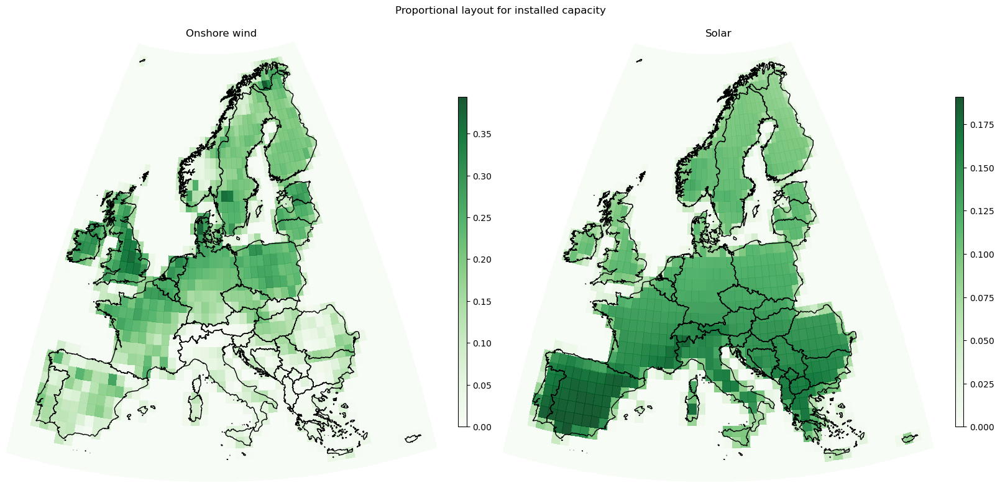

In [34]:
fig, axs = plt.subplots(1,2,subplot_kw={"projection": projection}, layout='constrained',figsize=(16,8))
CF_land_only_wind.plot(ax=axs[0], transform=plate(), 
                    cmap='green_alpha',
                    alpha=0.9, 
                    cbar_kwargs={'shrink': 0.7, 'aspect': 40});
fig.suptitle(f'Proportional layout for installed capacity');
Europe.plot(ax=axs[0],transform=plate(),edgecolor="k",color="None",aspect="equal").set_frame_on(False);
axs[0].set_title(f'Onshore wind');

CF_land_only_PV.plot(ax=axs[1], transform=plate(), 
                    cmap='green_alpha',
                    alpha=0.9, 
                    cbar_kwargs={'shrink': 0.7, 'aspect': 40});
Europe.plot(ax=axs[1],transform=plate(),edgecolor="k",color="None",aspect="equal").set_frame_on(False);
axs[1].set_title(f'Solar');
# Saving figure to file: 
plot_filename = f'Onshore wind and PV layout.pdf'
# plt.savefig(plot_path(plot_filename), dpi=300)
# plt.grid()

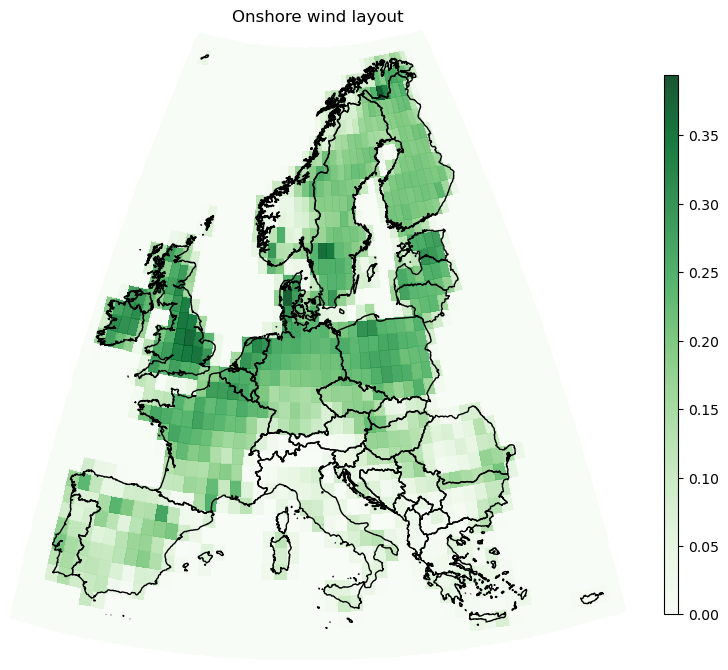

In [35]:
fig, ax = plt.subplots(subplot_kw={"projection": projection}, figsize=map_fig_size)
CF_land_only_wind.plot(ax=ax, transform=plate(), 
                    cmap='green_alpha',
                    alpha=0.9, 
                    cbar_kwargs={'shrink': 0.7, 'aspect': 40});
plt.title(f'Onshore wind layout');
Europe.plot(ax=ax,transform=plate(),edgecolor="k",color="None",aspect="equal").set_frame_on(False);
fig.tight_layout();
# Saving figure to file: 
plot_filename = f'Onshore_wind_layout.png'
# plt.savefig(plot_path(plot_filename), dpi=300)
# plt.grid()

In [36]:
# Creating aggregated CF time series from CMIP6 models with proportional layout for wind:
overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries

output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'
output_folder_path_PV = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/PV/'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        if cutout_name in locals():
            name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
            name_2 = f'{name}_total'
            filename = f'{name}.nc'
            filename_2 = f'{name_2}.nc'
            path = f'{output_folder_path}{filename}'
            path_2 = f'{output_folder_path}{filename_2}'
            if not Path(path).is_file() or overwrite == 1: 
                print(f'Creating "{filename}" from {cutout_name} cutout. ')
                # Adding roughness data (from ERA5) into the cutout:
                da = roughness.roughness.interp_like(locals()[cutout_name].data['wnd10m'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind,turbine=turbine,layout=layout_wind,per_unit=True,index=Europe.index)
                # Saving to file
                locals()[name].to_netcdf(path=f'{output_folder_path}{filename}')
            else: 
                locals()[name] = xr.open_dataarray(path)
                print(f'"{filename}" already exists in "{output_folder_path}". The file successfully imported. ')

            if not Path(path_2).is_file() or overwrite == 1: 
                print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
                da = roughness.roughness.interp_like(locals()[cutout_name].data['wnd10m'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                locals()[name_2] = locals()[cutout_name].wind(turbine=turbine,layout=layout_wind,per_unit=True)
                locals()[name_2].to_netcdf(path=f'{output_folder_path}{filename_2}')
            else: 
                locals()[name_2] = xr.open_dataarray(path_2)
                print(f'"{filename_2}" already exists in "{output_folder_path}". The file successfully imported. ')


for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        if cutout_name in locals():                
            # PV:
            name = f'PV_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
            name_2 = f'{name}_total'
            filename = f'{name}.nc'
            filename_2 = f'{name_2}.nc'
            path = f'{output_folder_path_PV}{filename}'
            path_2 = f'{output_folder_path_PV}{filename_2}'
            if not Path(path).is_file() or overwrite == 1: 
                print(f'Creating "{filename}" from {cutout_name} cutout. ')
                locals()[name] = locals()[cutout_name].pv(matrix=matrix_PV,panel=PV_panel,orientation="latitude_optimal",layout=layout_PV,per_unit=True,index=Europe.index)
                # Saving to file
                locals()[name].to_netcdf(path=f'{output_folder_path_PV}{filename}')
            else: 
                locals()[name] = xr.open_dataarray(path)
                print(f'"{filename}" already exists in "{output_folder_path_PV}". The file successfully imported. ')
            if not Path(path_2).is_file() or overwrite == 1: 
                print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
                locals()[name_2] = locals()[cutout_name].pv(panel=PV_panel,orientation="latitude_optimal",layout=layout_PV_era5,per_unit=True)
                locals()[name_2].to_netcdf(path=f'{output_folder_path_PV}{filename_2}')
            else: 
                locals()[name_2] = xr.open_dataarray(path_2)
                print(f'"{filename_2}" already exists in "{output_folder_path_PV}". The file successfully imported. ')
        else: 
            print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

# wind_15 = Europe_era5_15.wind(turbine=turbine,layout=proportional_layout_wind,per_unit=True,index=Europe.index)

"Wind_EC_Earth3_ssp126_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"Wind_EC_Earth3_ssp126_15_22_total.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"Wind_EC_Earth3_ssp245_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"Wind_EC_Earth3_ssp245_15_22_total.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"Wind_EC_Earth3_ssp370_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"Wind_EC_Earth3_ssp370_15_22_total.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"Wind_EC_Earth3_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"W

In [37]:
# Creating aggregated CF time series with proportional layout for wind with wind_100m: 

CMIP6_models_wind100m = ['EC-Earth3']
ssp_variants = ['ssp126', 'ssp245', 'ssp370', 'ssp585'] 

overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'

for CMIP6_model in CMIP6_models_wind100m:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
        if cutout_name in locals():
            name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
            name_2 = f'{name}_total'
            filename = f'{name}.nc'
            filename_2 = f'{name_2}.nc'
            path = f'{output_folder_path}{filename}'
            path_2 = f'{output_folder_path}{filename_2}'
            if not Path(path).is_file() or overwrite == 1: 
                print(f'Creating "{filename}" from {cutout_name} cutout. ')
                # Adding roughness data (from ERA5) into the cutout:
                da = roughness.roughness.interp_like(locals()[cutout_name].data['influx'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                
                locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind,turbine=turbine,layout=layout_wind,per_unit=True,index=Europe.index)
                print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
                locals()[name_2] = locals()[cutout_name].wind(turbine=turbine,layout=layout_wind,per_unit=True)

                # Saving to file
                locals()[name].to_netcdf(path=f'{output_folder_path}{filename}')
                locals()[name_2].to_netcdf(path=f'{output_folder_path}{filename_2}')
            else: 
                locals()[name] = xr.open_dataarray(path)
                locals()[name_2] = xr.open_dataarray(path_2)
                print(f'"{filename}" and "{filename_2}" already exist in "{output_folder_path}". Both files successfully imported. ')
        else: 
            print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

# wind_15 = Europe_era5_15.wind(turbine=turbine,layout=proportional_layout_wind,per_unit=True,index=Europe.index)

"Wind_EC_Earth3_ssp126_15_22_wind_100m.nc" and "Wind_EC_Earth3_ssp126_15_22_wind_100m_total.nc" already exist in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". Both files successfully imported. 
"Wind_EC_Earth3_ssp245_15_22_wind_100m.nc" and "Wind_EC_Earth3_ssp245_15_22_wind_100m_total.nc" already exist in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". Both files successfully imported. 
"Wind_EC_Earth3_ssp370_15_22_wind_100m.nc" and "Wind_EC_Earth3_ssp370_15_22_wind_100m_total.nc" already exist in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". Both files successfully imported. 
"Wind_EC_Earth3_ssp585_15_22_wind_100m.nc" and "Wind_EC_Earth3_ssp585_15_22_wind_100m_total.nc" already exist in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". Both files successfully imported. 


In [38]:
# Creating or loading aggregated CF time series from ERA5 with proportional layout for wind:

overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/'

for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    if cutout_name in locals():
        name = f'Wind_ERA5_{i}'
        name_2 = f'{name}_total'
        filename = f'{name}.nc'
        filename_2 = f'{name_2}.nc'
        path = f'{output_folder_path}{filename}'
        path_2 = f'{output_folder_path}{filename_2}'
        if not Path(path).is_file() or overwrite == 1: 
            print(f'Creating "{filename}" from {cutout_name} cutout. ')
            locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind_era5,turbine=turbine,layout=layout_wind_era5,per_unit=True,index=Europe.index)
            print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
            locals()[name_2] = locals()[cutout_name].wind(turbine=turbine,layout=layout_wind_era5,per_unit=True)

            # Saving to file
            locals()[name].to_netcdf(path=path)
            locals()[name_2].to_netcdf(path=path_2)
        else: 
            locals()[name] = xr.open_dataarray(path)
            locals()[name_2] = xr.open_dataarray(path_2)
            print(f'"{filename}" and "{filename_2}" already exist in "{output_folder_path}". Both files successfully imported. ')
    else: 
        print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

"Wind_ERA5_15.nc" and "Wind_ERA5_15_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". Both files successfully imported. 


"Wind_ERA5_16.nc" and "Wind_ERA5_16_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". Both files successfully imported. 
"Wind_ERA5_17.nc" and "Wind_ERA5_17_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". Both files successfully imported. 
"Wind_ERA5_18.nc" and "Wind_ERA5_18_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". Both files successfully imported. 
"Wind_ERA5_19.nc" and "Wind_ERA5_19_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". Both files successfully imported. 
"Wind_ERA5_20.nc" and "Wind_ERA5_20_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". Both files successfully imported. 
"Wind_ERA5_21.nc" and "Wind_ERA5_21_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". Both files successfully imported. 
"Wind_ERA5_22.nc" and "Wind_ERA5_22_total.nc" already exist in "E://Cutouts/Aggreg

In [39]:
# Creating or loading aggregated CF time series from ERA5 with proportional layout for PV:

overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/'

for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    if cutout_name in locals():
        name = f'PV_ERA5_{i}'
        name_2 = f'{name}_total'
        filename = f'{name}.nc'
        filename_2 = f'{name_2}.nc'
        path = f'{output_folder_path}{filename}'
        path_2 = f'{output_folder_path}{filename_2}'
        if not Path(path).is_file() or overwrite == 1: 
            print(f'Creating "{filename}" from {cutout_name} cutout. ')
            locals()[name] = locals()[cutout_name].pv(matrix=matrix_PV_era5,panel=PV_panel,orientation="latitude_optimal",layout=layout_PV_era5,per_unit=True,index=Europe.index)
            print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
            locals()[name_2] = locals()[cutout_name].pv(panel=PV_panel,orientation="latitude_optimal",layout=layout_PV_era5,per_unit=True)

            # Saving to file
            locals()[name].to_netcdf(path=path)
            locals()[name_2].to_netcdf(path=path_2)
        else: 
            locals()[name] = xr.open_dataarray(path)
            locals()[name_2] = xr.open_dataarray(path_2)
            print(f'"{filename}" and "{filename_2}" already exist in "{output_folder_path}". Both files successfully imported. ')
    else: 
        print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

"PV_ERA5_15.nc" and "PV_ERA5_15_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". Both files successfully imported. 
"PV_ERA5_16.nc" and "PV_ERA5_16_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". Both files successfully imported. 
"PV_ERA5_17.nc" and "PV_ERA5_17_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". Both files successfully imported. 
"PV_ERA5_18.nc" and "PV_ERA5_18_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". Both files successfully imported. 
"PV_ERA5_19.nc" and "PV_ERA5_19_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". Both files successfully imported. 
"PV_ERA5_20.nc" and "PV_ERA5_20_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". Both files successfully imported. 
"PV_ERA5_21.nc" and "PV_ERA5_21_total.nc" already exist in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". Both f

In [40]:
# Combining annual timeseries files into one: 
output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/'
path = f'{output_folder_path}Wind_ERA5_BOC.nc'
path_2 = f'{output_folder_path}Wind_ERA5_BOC_total.nc'

path_3 = f'{output_folder_path}PV_ERA5_BOC.nc'
path_4 = f'{output_folder_path}PV_ERA5_BOC_total.nc'


# Wind_ERA5_BOC = xr.concat([Wind_ERA5_15,Wind_ERA5_16,Wind_ERA5_17,Wind_ERA5_18,Wind_ERA5_19,Wind_ERA5_20,Wind_ERA5_21,Wind_ERA5_22],dim="time")
PV_ERA5_BOC = xr.concat([PV_ERA5_15,PV_ERA5_16,PV_ERA5_17,PV_ERA5_18,PV_ERA5_19,PV_ERA5_20,PV_ERA5_21,PV_ERA5_22],dim="time")

# Wind_ERA5_BOC_total = xr.concat([Wind_ERA5_15_total,Wind_ERA5_16_total,Wind_ERA5_17_total,Wind_ERA5_18_total,Wind_ERA5_19_total,Wind_ERA5_20_total,Wind_ERA5_21_total,Wind_ERA5_22_total],dim="time")
PV_ERA5_BOC_total = xr.concat([PV_ERA5_15_total,PV_ERA5_16_total,PV_ERA5_17_total,PV_ERA5_18_total,PV_ERA5_19_total,PV_ERA5_20_total,PV_ERA5_21_total,PV_ERA5_22_total],dim="time")

# Wind_ERA5_BOC.to_netcdf(path=path)
# Wind_ERA5_BOC_total.to_netcdf(path=path_2)
PV_ERA5_BOC.to_netcdf(path=path_3)
PV_ERA5_BOC_total.to_netcdf(path=path_4)

Wind_ERA5_BOC = xr.open_dataarray(path)
Wind_ERA5_BOC_total = xr.open_dataarray(path_2)
PV_ERA5_BOC = xr.open_dataarray(path_3)
PV_ERA5_BOC_total = xr.open_dataarray(path_4)

# Testing by plotting:
# PV_ERA5_BOC.sel(dim_0="Norway").plot(figsize=(14,4))

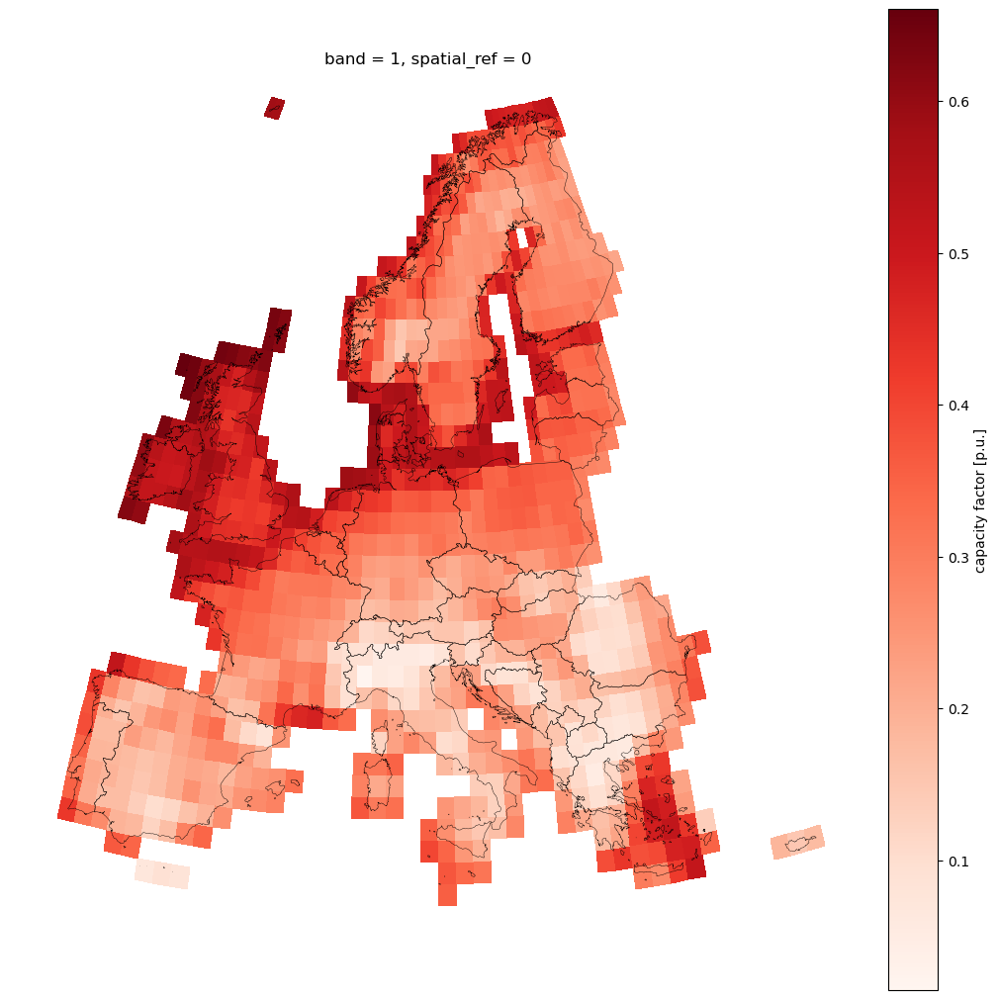

In [41]:
name = f'CF_avg_wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')
locals()[name].plot(ax=ax,cmap="Reds",transform=plate())
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)

## Correction using wind speed at hub height

In [42]:
# # locals()[name].data['wnd100m'].mean(dim=["time"],keep_attrs=True).plot()
# locals()[name].data['wnd100m'].sel(x=0,y=34).plot()

In [43]:
# name = f'Europe_ERA5_15'

# fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(8,8), layout='constrained')
# locals()[name].data['wnd100m'].mean(dim=["time"],keep_attrs=True).plot(ax=ax,cmap="Reds",transform=plate(),cbar_kwargs={'shrink': 0.8, 'aspect': 40});
# Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
# fig.suptitle(f'Mean wind speed at 100 m in 2015');
# fig.tight_layout;

In [44]:
# CMIP6_model = 'MIROC6'
# CMIP6_model = CMIP6_model.replace("-", "_")
# name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'

# fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(8,8), layout='constrained')
# locals()[name].data['wnd10m'].mean(dim=["time"],keep_attrs=True).plot(ax=ax,cmap="Reds",transform=plate(),cbar_kwargs={'shrink': 0.8, 'aspect': 40});
# Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
# fig.suptitle(f'Mean wind speed at 10 m for {CMIP6_model}');
# fig.tight_layout;

In [45]:
# CMIP6_model = 'EC-Earth3'
# CMIP6_model = CMIP6_model.replace("-", "_")
# name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'

# fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(8,8), layout='constrained')
# (locals()[name].data['wnd10m'].mean(dim=["time"],keep_attrs=True)*indicator_matrix_EC_Earth3).plot(ax=ax,cmap="Reds",transform=plate(),cbar_kwargs={'shrink': 0.8, 'aspect': 40});
# Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
# fig.suptitle(f'Mean wind speed at 10 m for {CMIP6_model}');
# fig.tight_layout;

In [46]:
# Calculating wind speed at hub height for ERA5 (as a timeseries for every cutout)
for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    # Calculating wind speed at hub height: 
    from_height = 100;
    from_name = "wnd{h:0d}m".format(h=int(from_height));
    to_height = atlite.resource.get_windturbineconfig(turbine)['hub_height'];       # 90 m in current config
    to_name = "wnd{h:0d}m".format(h=int(to_height));
    to_cutout_name = f'{cutout_name}_{to_name}'
    ds = locals()[cutout_name].data

    locals()[to_cutout_name] = ds[from_name] * (
                np.log(to_height / ds["roughness"]) / np.log(from_height / ds["roughness"])
            )
    locals()[to_cutout_name].attrs.update({"long name": "Extrapolated {ht} m wind speed using logarithmic "
                        "method with roughness and {hf} m wind speed"
                        "".format(ht=to_height, hf=from_height),
                        "units": "m s**-1"})
    

# Calculating average wind speed for each cell for 8 years from ERA5:
cutout_name = f'Europe_ERA5_15_wnd90m'
ERA5_wnd90m = xr.DataArray(locals()[cutout_name])
for i in range(16,23):
    cutout_name = f'Europe_ERA5_{i}_wnd90m'
    ERA5_wnd90m = xr.concat([ERA5_wnd90m,locals()[cutout_name]],dim="time")
ERA5_wnd90m_mean = ERA5_wnd90m.mean(dim=["time"],keep_attrs=True)

ERA5_wnd90m_coarse = atlite.gis.regrid(ERA5_wnd90m,Europe_EC_Earth3_ssp585_15_22.data.x, Europe_EC_Earth3_ssp585_15_22.data.y,resampling=rasterio.warp.Resampling.average)
ERA5_wnd90m_coarse_mean = ERA5_wnd90m_coarse.mean(dim=["time"],keep_attrs=True)

In [47]:
# Calculating influx for ERA5 (as a timeseries for every cutout)
for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    to_cutout_name = f'{cutout_name}_influx'

    locals()[to_cutout_name] = locals()[cutout_name].data['influx_direct'] + locals()[cutout_name].data['influx_diffuse']

# Calculating average influx for each cell for 8 years from ERA5:
cutout_name = f'Europe_ERA5_15_influx'
ERA5_influx = xr.DataArray(locals()[cutout_name])
for i in range(16,23):
    cutout_name = f'Europe_ERA5_{i}_influx'
    ERA5_influx = xr.concat([ERA5_influx,locals()[cutout_name]],dim="time")
ERA5_influx_mean = ERA5_influx.mean(dim=["time"],keep_attrs=True)

ERA5_influx_coarse = atlite.gis.regrid(ERA5_influx,Europe_EC_Earth3_ssp585_15_22.data.x, Europe_EC_Earth3_ssp585_15_22.data.y,resampling=rasterio.warp.Resampling.average)
ERA5_influx_coarse_mean = ERA5_influx_coarse.mean(dim=["time"],keep_attrs=True)

In [48]:
# # Plotting average wind speed at hub height for 8 years for ERA5:

# fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(8,8), layout='constrained')
# ERA5_wnd90m_mean.plot(ax=ax,cmap="Reds",transform=plate(),cbar_kwargs={'shrink': 0.8, 'aspect': 40})
# Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
# fig.suptitle(f'ERA5 Mean wind speed at {to_height} m \n2015 - 2022');
# fig.tight_layout;

# # Saving figure to file: 
# plot_filename = (f'ERA5 Mean wind speed at {to_height}m 15-22.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

In [49]:
# Getting wind speed at hub height from CMIP6 models
ssp_variant = 'ssp585'

# Defining roughness to extrapolate hub height wind speed:
roughness = xr.open_dataset('roughness.nc')
roughness = roughness.rename({'fsr':'roughness'})
roughness = roughness.mean(dim='time')
roughness = _rename_and_clean_coords(roughness)
roughness.roughness.attrs['prepared_feature'] = 'wind'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_15_22'
    if cutout_name in locals():
        # Calculating wind speed at hub height (as a timeseries for every cutout)
        from_height = 10;
        from_name = "wnd{h:0d}m".format(h=int(from_height));
        to_height = atlite.resource.get_windturbineconfig(turbine)['hub_height'];       # 90 m in current config
        to_name = "wnd{h:0d}m".format(h=int(to_height));
        to_cutout_name = f'{cutout_name}_{to_name}'
        
        # Adding roughness data (from ERA5) into the cutout:
        da = roughness.roughness.interp_like(locals()[cutout_name].data['wnd10m'].isel(time=0))
        locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)

        ds = locals()[cutout_name].data
        locals()[to_cutout_name] = ds[from_name] * (
                    np.log(to_height / ds["roughness"]) / np.log(from_height / ds["roughness"]))
        locals()[to_cutout_name].attrs.update({"long name": "Extrapolated {ht} m wind speed using logarithmic "
                            "method with roughness and {hf} m wind speed"
                            "".format(ht=to_height, hf=from_height),
                            "units": "m s**-1"})
        print(f'"{to_cutout_name}" created. ')
        # Calculating average wind speed for each cell for 8 years from ERA5:
        cutout_mean_name = f'{to_cutout_name}_mean'
        locals()[cutout_mean_name] = locals()[to_cutout_name].mean(dim=["time"],keep_attrs=True)
        print(f'"{cutout_mean_name}" created. ')
    else: 
        print(f'WARNING: Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

"Europe_EC_Earth3_ssp585_15_22_wnd90m" created. 
"Europe_EC_Earth3_ssp585_15_22_wnd90m_mean" created. 
"Europe_MPI_ESM1_2_HR_ssp585_15_22_wnd90m" created. 
"Europe_MPI_ESM1_2_HR_ssp585_15_22_wnd90m_mean" created. 
"Europe_MIROC6_ssp585_15_22_wnd90m" created. 
"Europe_MIROC6_ssp585_15_22_wnd90m_mean" created. 
"Europe_MPI_ESM1_2_LR_ssp585_15_22_wnd90m" created. 
"Europe_MPI_ESM1_2_LR_ssp585_15_22_wnd90m_mean" created. 
"Europe_HadGEM3_GC31_LL_ssp585_15_22_wnd90m" created. 
"Europe_HadGEM3_GC31_LL_ssp585_15_22_wnd90m_mean" created. 
"Europe_HadGEM3_GC31_MM_ssp585_15_22_wnd90m" created. 
"Europe_HadGEM3_GC31_MM_ssp585_15_22_wnd90m_mean" created. 
"Europe_IPSL_CM6A_LR_ssp585_15_22_wnd90m" created. 
"Europe_IPSL_CM6A_LR_ssp585_15_22_wnd90m_mean" created. 
"Europe_AWI_CM_1_1_MR_ssp585_15_22_wnd90m" created. 
"Europe_AWI_CM_1_1_MR_ssp585_15_22_wnd90m_mean" created. 
"Europe_EC_Earth3_Veg_ssp585_15_22_wnd90m" created. 
"Europe_EC_Earth3_Veg_ssp585_15_22_wnd90m_mean" created. 


In [50]:
# Getting wind speed at hub height for EC-Earth3 with wnd100m:
ssp_variant = 'ssp585'

CMIP6_model = 'EC-Earth3'
CMIP6_model = CMIP6_model.replace("-", "_")
cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_15_22_wind_100m'
if cutout_name in locals():
    # Calculating wind speed at hub height (as a timeseries for every cutout)
    from_height = 10;
    from_height2 = 100;
    from_name = "wnd{h:0d}m".format(h=int(from_height));
    from_name2 = "wnd{h:0d}m".format(h=int(from_height2));
    to_height = atlite.resource.get_windturbineconfig(turbine)['hub_height'];       # 90 m in current config
    to_name = "wnd{h:0d}m".format(h=int(to_height));
    to_cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_15_22_{to_name}_power_law'

    ds = locals()[cutout_name].data
    locals()[to_cutout_name] = ds[from_name] * (to_height / from_height)**(np.log(ds[from_name2] / ds[from_name]) / np.log(from_height2 / from_height))

    locals()[to_cutout_name].attrs.update({"long name": "Extrapolated {ht} m wind speed using power law "
                        "method with wind speed at {hf} and {hf2} m height levels"
                        "".format(ht=to_height, hf=from_height, hf2=from_height2),
                        "units": "m s**-1"})
    print(f'"{to_cutout_name}" created. ')
    # Calculating average wind speed for each cell for 8 years from ERA5:
    cutout_mean_name = f'{to_cutout_name}_mean'
    locals()[cutout_mean_name] = locals()[to_cutout_name].mean(dim=["time"],keep_attrs=True)
    print(f'"{cutout_mean_name}" created. ')
else: 
    print(f'WARNING: Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

"Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law" created. 
"Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_mean" created. 


In [51]:
# Calculating wind speed at hub height for GWA: 

# roughness_ERA5 = Europe_ERA5_15.data['roughness'].to_dataset(name='roughness')
# roughness_ERA5 = roughness_ERA5.mean(dim='time')

# Adding roughness data (from ERA5 in CMIP6 grid) into the cutout:
gwa_ds = gwa_CMIP_res.to_dataset(name='wnd100m')
da = roughness.roughness.interp_like(Europe_EC_Earth3_ssp585_15_22.data['wnd10m'].isel(time=0))
gwa_ds = gwa_ds.assign(roughness=da)

from_height = 100;
from_name = "wnd{h:0d}m".format(h=int(from_height));
to_height = atlite.resource.get_windturbineconfig(turbine)['hub_height'];       # 90 m in current config
to_name = "wnd{h:0d}m".format(h=int(to_height));
to_cutout_name = f'{cutout_name}_{to_name}'
ds = gwa_ds
gwa_wnd90m_mean = ds[from_name] * (np.log(to_height / ds["roughness"]) / np.log(from_height / ds["roughness"]))
gwa_wnd90m_mean = gwa_wnd90m_mean.fillna(0)
# gwa_wnd90m_mean_coarse = gwa_wnd90m_mean.resample()

In [52]:
path=f'gwa_wnd90m_mean.nc'
gwa_wnd90m_mean.to_netcdf(path=path)

In [53]:
# CMIP6_model = 'EC-Earth3'
# CMIP6_model = CMIP6_model.replace("-", "_")
# cutout_mean_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_mean'
# variance_name = f'variance_wnd90m_{CMIP6_model}'
# locals()[variance_name] = locals()[cutout_mean_name].var().load()

In [54]:
# Variance
# ERA5_wnd90m_mean.var().values

In [55]:
# Getting influx data from CMIP6 models
ssp_variant = 'ssp585'

for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_15_22'
    if cutout_name in locals():
        to_cutout_name = f'{cutout_name}_influx' 
        ds = locals()[cutout_name].data
        locals()[to_cutout_name] = locals()[cutout_name].data['influx']
        # Calculating average influx for each cell for 8 years:
        cutout_mean_name = f'{to_cutout_name}_mean'
        locals()[cutout_mean_name] = locals()[to_cutout_name].mean(dim=["time"],keep_attrs=True)
        print(f'{cutout_mean_name} created. ')
    else: 
        print(f'WARNING: Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

Europe_EC_Earth3_ssp585_15_22_influx_mean created. 
Europe_MPI_ESM1_2_HR_ssp585_15_22_influx_mean created. 
Europe_MIROC6_ssp585_15_22_influx_mean created. 
Europe_MPI_ESM1_2_LR_ssp585_15_22_influx_mean created. 
Europe_HadGEM3_GC31_LL_ssp585_15_22_influx_mean created. 
Europe_HadGEM3_GC31_MM_ssp585_15_22_influx_mean created. 
Europe_IPSL_CM6A_LR_ssp585_15_22_influx_mean created. 
Europe_AWI_CM_1_1_MR_ssp585_15_22_influx_mean created. 
Europe_ACCESS_CM2_ssp585_15_22_influx_mean created. 


In [56]:
# Calculating correction factors for wind and PV: 

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind: 
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_mean'
    corr_factor_filename = f'Corr_factors_wind_{CMIP6_model}'
    locals()[corr_factor_filename] = ((ERA5_wnd90m_coarse_mean*indicator_matrix_EC_Earth3) / (locals()[mean_da_name]*indicator_matrix_EC_Earth3))
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # PV:
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_influx_mean'
    corr_factor_filename = f'Corr_factors_PV_{CMIP6_model}'
    locals()[corr_factor_filename] = ((ERA5_influx_coarse_mean*indicator_matrix_EC_Earth3) / (locals()[mean_da_name]*indicator_matrix_EC_Earth3))

In [57]:
# Calculating correction factors for EC-Earth3 with wind100m:
CMIP6_model = 'EC-Earth3'
CMIP6_model = CMIP6_model.replace("-", "_")
# Wind: 
mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_power_law_mean'
corr_factor_filename = f'Corr_factors_wind_{CMIP6_model}_power_law'
locals()[corr_factor_filename] = ((ERA5_wnd90m_coarse_mean*indicator_matrix_EC_Earth3) / (locals()[mean_da_name]*indicator_matrix_EC_Earth3))

In [58]:
# Calculating GWA correction factors for wind only: 

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind: 
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_mean'
    corr_factor_filename = f'GWA_Corr_factors_wind_{CMIP6_model}'
    locals()[corr_factor_filename] = ((gwa_wnd90m_mean*indicator_matrix_EC_Earth3) / (locals()[mean_da_name]*indicator_matrix_EC_Earth3))

In [59]:
# Loading correction factors and saving them to nc files
overwrite = 0;

for CMIP6_model in CMIP6_models_solar: 
    # PV:
    CMIP6_model = CMIP6_model.replace("-", "_")
    name = f'Corr_factors_PV_{CMIP6_model}'   
    filename = f'{name}.nc'
    path = f'E://Cutouts/CMIP6_BOC/Correction factors/PV/{filename}'
    if not Path(path).is_file() or overwrite == 1:
        print(f'Loading {name}')
        locals()[name].load()
        locals()[name].to_netcdf(path=path)
    else: 
        locals()[name] = xr.open_dataarray(path)
        print(f'{name} loaded from saved file.')

for CMIP6_model in CMIP6_models_wind: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind: 
    name = f'Corr_factors_wind_{CMIP6_model}'
    filename = f'{name}.nc'
    path = f'E://Cutouts/CMIP6_BOC/Correction factors/Wind/{filename}'
    if not Path(path).is_file() or overwrite == 1:
        print(f'Loading {name}')
        locals()[name].load()
        locals()[name].to_netcdf(path=path)
    else:   # Loading the correction factor files from pre-saved files
        locals()[name] = xr.open_dataarray(path)
        print(f'{name} loaded from saved file.')

# Loading correction factors for EC-Earth3 with wind 100m: 
CMIP6_model = 'EC-Earth3'
CMIP6_model = CMIP6_model.replace("-", "_")
# Wind: 
name = f'Corr_factors_wind_{CMIP6_model}_power_law'
filename = f'{name}.nc'
path = f'E://Cutouts/CMIP6_BOC/Correction factors/Wind/{filename}'
if not Path(path).is_file() or overwrite == 1:
    print(f'Loading {name}')
    locals()[name].load()
    locals()[name].to_netcdf(path=path)
else:   # Loading the correction factor files from pre-saved files
    locals()[name] = xr.open_dataarray(path)
    print(f'{name} loaded from saved file.')

Corr_factors_PV_EC_Earth3 loaded from saved file.
Corr_factors_PV_MPI_ESM1_2_HR loaded from saved file.
Corr_factors_PV_MIROC6 loaded from saved file.
Corr_factors_PV_MPI_ESM1_2_LR loaded from saved file.
Corr_factors_PV_HadGEM3_GC31_LL loaded from saved file.
Corr_factors_PV_HadGEM3_GC31_MM loaded from saved file.
Corr_factors_PV_IPSL_CM6A_LR loaded from saved file.
Corr_factors_PV_AWI_CM_1_1_MR loaded from saved file.
Corr_factors_PV_ACCESS_CM2 loaded from saved file.
Corr_factors_wind_EC_Earth3 loaded from saved file.
Corr_factors_wind_MPI_ESM1_2_HR loaded from saved file.
Corr_factors_wind_MIROC6 loaded from saved file.
Corr_factors_wind_MPI_ESM1_2_LR loaded from saved file.
Corr_factors_wind_HadGEM3_GC31_LL loaded from saved file.
Corr_factors_wind_HadGEM3_GC31_MM loaded from saved file.
Corr_factors_wind_IPSL_CM6A_LR loaded from saved file.
Corr_factors_wind_AWI_CM_1_1_MR loaded from saved file.
Corr_factors_wind_EC_Earth3_Veg loaded from saved file.
Corr_factors_wind_EC_Earth3_p

In [60]:
# Loading correction factors based on GWA and saving them to nc files
overwrite = 0;

for CMIP6_model in CMIP6_models_wind: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind: 
    name = f'GWA_Corr_factors_wind_{CMIP6_model}'
    filename = f'{name}.nc'
    path = f'E://Cutouts/CMIP6_BOC/GWA Correction factors/Wind/{filename}'
    if not Path(path).is_file() or overwrite == 1:
        print(f'Loading {name}')
        locals()[name].load()
        locals()[name].to_netcdf(path=path)
    else:   # Loading the correction factor files from pre-saved files
        locals()[name] = xr.open_dataarray(path)
        print(f'{name} loaded from saved file.')

GWA_Corr_factors_wind_EC_Earth3 loaded from saved file.
GWA_Corr_factors_wind_MPI_ESM1_2_HR loaded from saved file.
GWA_Corr_factors_wind_MIROC6 loaded from saved file.
GWA_Corr_factors_wind_MPI_ESM1_2_LR loaded from saved file.
GWA_Corr_factors_wind_HadGEM3_GC31_LL loaded from saved file.
GWA_Corr_factors_wind_HadGEM3_GC31_MM loaded from saved file.
GWA_Corr_factors_wind_IPSL_CM6A_LR loaded from saved file.
GWA_Corr_factors_wind_AWI_CM_1_1_MR loaded from saved file.
GWA_Corr_factors_wind_EC_Earth3_Veg loaded from saved file.


In [61]:
# Calculating, max, min, mean correction factors: 

CMIP6_model = CMIP6_models[7]
data = 'PV'     # PV or wind

CMIP6_model = CMIP6_model.replace("-", "_")
corr_factor_filename = f'Corr_factors_{data}_{CMIP6_model}'
mean_val = np.ndarray.item(locals()[corr_factor_filename].min().values)
mean_val

0.8862203755773185

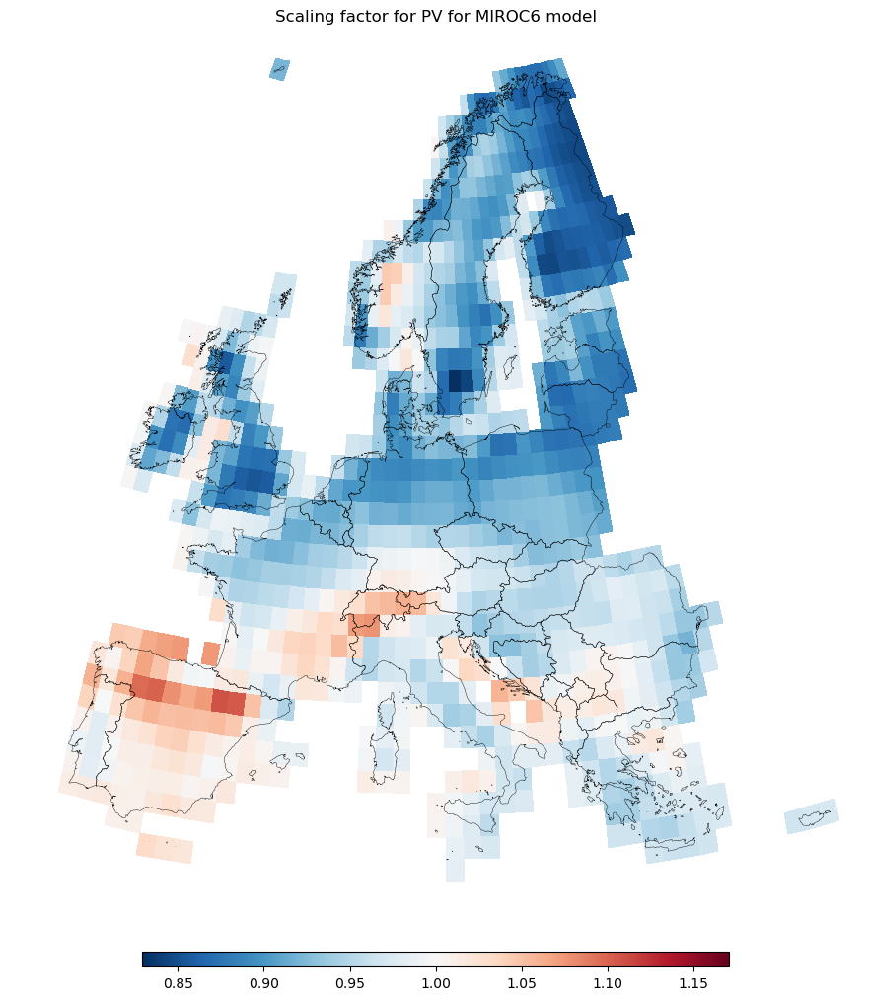

In [62]:
# Plotting correction factors from wind speed

CMIP6_model = 'MIROC6'
data = 'PV'     # PV or wind

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')
CMIP6_model = CMIP6_model.replace("-", "_")
corr_factor_filename = f'Corr_factors_{data}_{CMIP6_model}'

# Setting correction factors outside area of interest to 1: 
# locals()[corr_factor_filename] = locals()[corr_factor_filename].where(locals()[corr_factor_filename] > 0, 1);

# min_val = 0.5
# max_val = 1.5
min_val = np.nanmin(locals()[corr_factor_filename])
max_val = np.nanmax(locals()[corr_factor_filename])
max_val_abs = max_val-1
min_val_abs = 1-min_val;
if max_val_abs > min_val_abs:
    if max_val >= 2:
        z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
        norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=max_val);
    else:
        z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
        norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min())); 
else: 
    z = np.linspace(min_val,1+(1-min_val),50*50).reshape(50,50);
    norm = TwoSlopeNorm(vmin=min_val, vcenter=1, vmax=1+(1-z.min()));

im = locals()[corr_factor_filename].plot(ax=ax,transform=plate(),cmap="RdBu_r",#cbar_kwargs={'colorbar': False},
                  norm=norm);
cb = im.colorbar.remove()
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
fig.colorbar(im, ax=ax, location='bottom', fraction=.1,shrink=0.6,aspect=40,norm=norm,cmap="RdBu_r")
fig.suptitle(f'Scaling factor for {data} for {CMIP6_model} model');

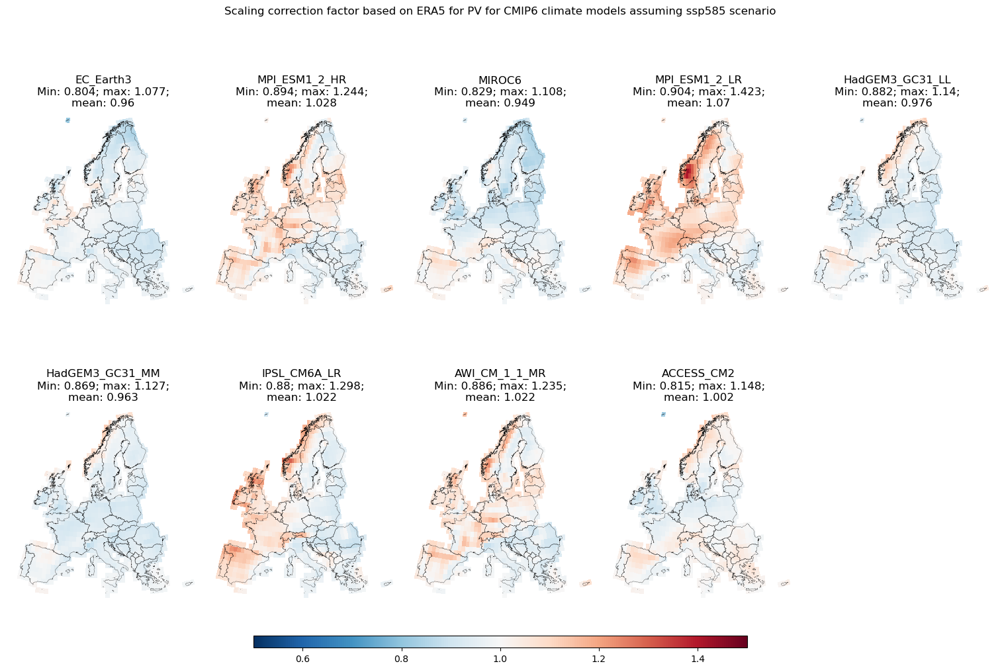

In [63]:
fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10),layout='constrained')

data = 'PV';

if data == 'PV': 
    min_val = 0.8;
    max_val = 1.5;
else: 
    min_val = 0.18;
    max_val = 6.02;

i = 0; # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_solar: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    corr_factor_filename = f'Corr_factors_{data}_{CMIP6_model}'

    max_val_abs = max_val-1
    min_val_abs = 1-min_val;
    if max_val_abs > min_val_abs:
        if max_val >= 2:
            z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
            norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=max_val);
        else:
            z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
            norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min())); 
    else: 
        z = np.linspace(min_val,1+(1-min_val),50*50).reshape(50,50);
        norm = TwoSlopeNorm(vmin=min_val, vcenter=1, vmax=1+(1-z.min()));
    
    im = locals()[corr_factor_filename].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                    norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)

    mean_val = np.ndarray.item(locals()[corr_factor_filename].mean().values);
    min_val_1 = np.ndarray.item(locals()[corr_factor_filename].min().values);
    max_val_1 = np.ndarray.item(locals()[corr_factor_filename].max().values);
    axs.flat[i].set_title(f'{CMIP6_model}\nMin: {round(min_val_1,3)}; max: {round(max_val_1,3)};\nmean: {round(mean_val,3)}');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.5,aspect=40,norm=norm,cmap="RdBu_r")
fig.suptitle(f'Scaling correction factor based on ERA5 for {data} for CMIP6 climate models assuming {ssp_variant} scenario');
fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'Correction of influx per cell for all CMIP6 models.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

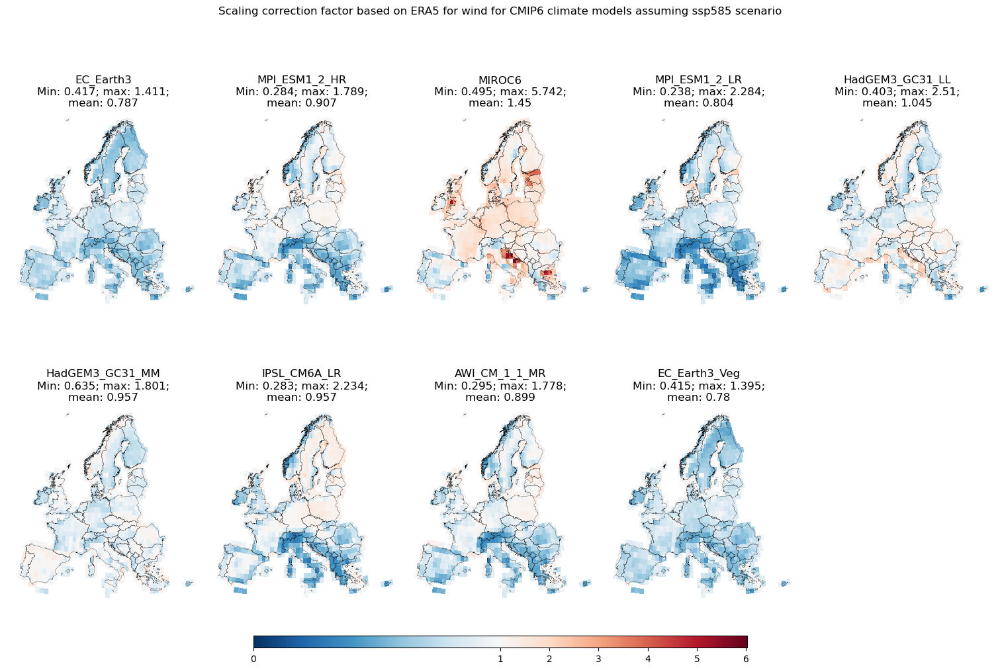

In [64]:
fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10),layout='constrained')

data = 'wind';

if data == 'PV': 
    min_val = 0.8;
    max_val = 1.5;
else: 
    min_val = 0.18;
    max_val = 6.02;

i = 0; # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    corr_factor_filename = f'Corr_factors_{data}_{CMIP6_model}'

    max_val_abs = max_val-1
    min_val_abs = 1-min_val;
    if max_val_abs > min_val_abs:
        if max_val >= 2:
            z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
            norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=max_val);
        else:
            z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
            norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min())); 
    else: 
        z = np.linspace(min_val,1+(1-min_val),50*50).reshape(50,50);
        norm = TwoSlopeNorm(vmin=min_val, vcenter=1, vmax=1+(1-z.min()));
    
    im = locals()[corr_factor_filename].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                    norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)

    mean_val = np.ndarray.item(locals()[corr_factor_filename].mean().values);
    min_val_1 = np.ndarray.item(locals()[corr_factor_filename].min().values);
    max_val_1 = np.ndarray.item(locals()[corr_factor_filename].max().values);
    axs.flat[i].set_title(f'{CMIP6_model}\nMin: {round(min_val_1,3)}; max: {round(max_val_1,3)};\nmean: {round(mean_val,3)}');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.5,aspect=40,norm=norm,cmap="RdBu_r")
fig.suptitle(f'Scaling correction factor based on ERA5 for {data} for CMIP6 climate models assuming {ssp_variant} scenario');
fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'Correction of {data} speed per cell for all CMIP6 models.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

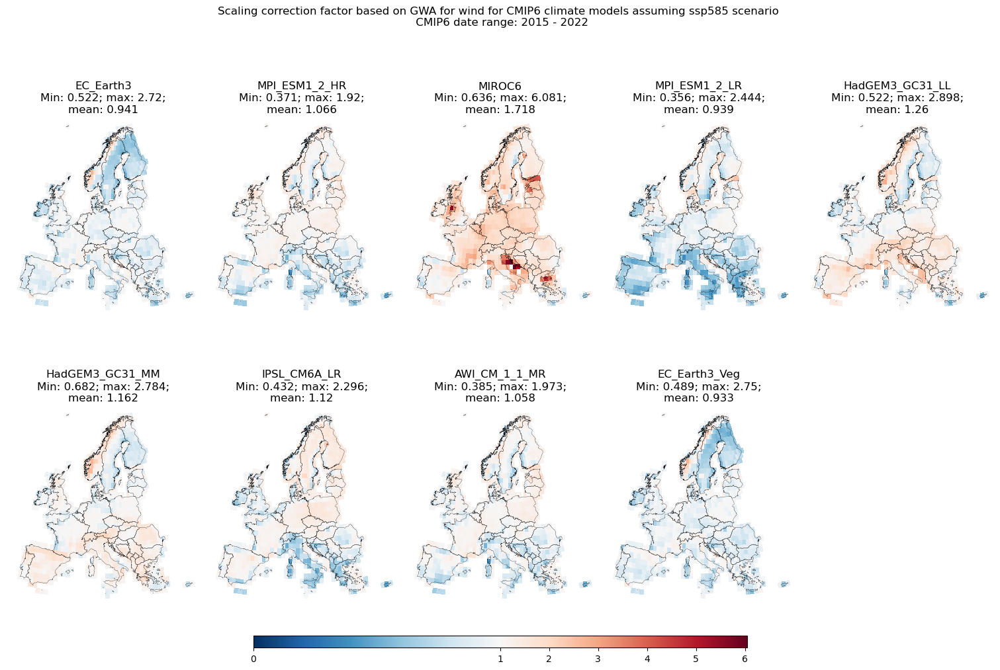

In [65]:
fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10),layout='constrained')

data = 'wind';

if data == 'PV': 
    min_val = 0.8;
    max_val = 1.5;
else: 
    min_val = 0.24;
    max_val = 6.04;

i = 0; # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    corr_factor_filename = f'GWA_Corr_factors_{data}_{CMIP6_model}'

    max_val_abs = max_val-1
    min_val_abs = 1-min_val;
    if max_val_abs > min_val_abs:
        if max_val >= 2:
            z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
            norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=max_val);
        else:
            z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
            norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min())); 
    else: 
        z = np.linspace(min_val,1+(1-min_val),50*50).reshape(50,50);
        norm = TwoSlopeNorm(vmin=min_val, vcenter=1, vmax=1+(1-z.min()));

    im = locals()[corr_factor_filename].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                    norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)

    mean_val = np.ndarray.item(locals()[corr_factor_filename].mean().values);
    min_val_1 = np.ndarray.item(locals()[corr_factor_filename].min().values);
    max_val_1 = np.ndarray.item(locals()[corr_factor_filename].max().values);
    axs.flat[i].set_title(f'{CMIP6_model}\nMin: {round(min_val_1,3)}; max: {round(max_val_1,3)};\nmean: {round(mean_val,3)}');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.5,aspect=40,norm=norm,cmap="RdBu_r")
fig.suptitle(f'Scaling correction factor based on GWA for {data} for CMIP6 climate models assuming {ssp_variant} scenario \n CMIP6 date range: 2015 - 2022');
fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'GWA Correction of {data} speed per cell for all CMIP6 models.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

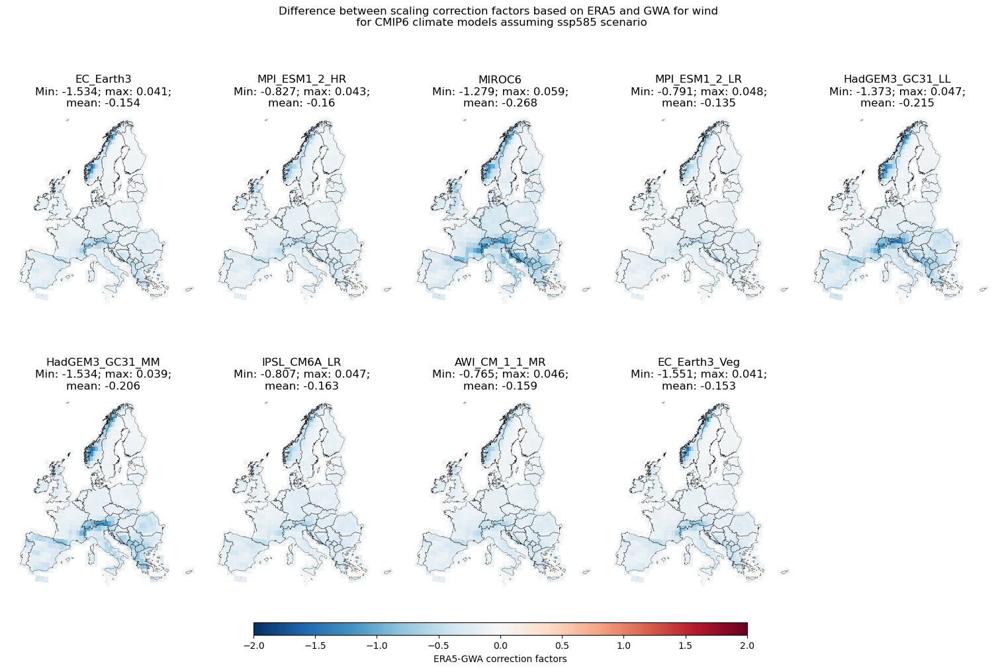

In [66]:
# Plotting difference between ERA5 and GWA correction factors for wind

fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10),layout='constrained')
data = 'wind';

max_val_abs = 2

i = 0; # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    corr_factor_filename = f'Corr_factors_{data}_{CMIP6_model}'
    GWA_corr_factor_filename = f'GWA_Corr_factors_{data}_{CMIP6_model}'

    z = np.linspace(0,max_val_abs,50*50).reshape(50,50);
    norm = TwoSlopeNorm(vmin=-max_val_abs, vcenter=0, vmax=max_val_abs);
    # Difference (ERA5 - GWA):
    corr_factors_diff = locals()[corr_factor_filename] - locals()[GWA_corr_factor_filename]

    im = corr_factors_diff.plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                    norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)

    mean_val = np.ndarray.item(corr_factors_diff.mean().values);
    min_val_1 = np.ndarray.item(corr_factors_diff.min().values);
    max_val_1 = np.ndarray.item(corr_factors_diff.max().values);
    axs.flat[i].set_title(f'{CMIP6_model}\nMin: {round(min_val_1,3)}; max: {round(max_val_1,3)};\nmean: {round(mean_val,3)}');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.5,aspect=40,norm=norm,cmap="RdBu_r",label='ERA5-GWA correction factors')
fig.suptitle(f'Difference between scaling correction factors based on ERA5 and GWA for {data} \n for CMIP6 climate models assuming {ssp_variant} scenario');
fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'ERA5-GWA Difference in correction of {data} speed per cell.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

In [67]:
# All CMIP6 models:
# CMIP6_models = ['EC-Earth3', 'MPI-ESM1-2-HR', 'MIROC6', 'MPI-ESM1-2-LR', 'HadGEM3-GC31-LL', 'HadGEM3-GC31-MM','IPSL-CM6A-LR','AWI-CM-1-1-MR']
# ssp_variants = ['ssp126', 'ssp245', 'ssp370', 'ssp585']
ssp_variant = 'ssp585'

columns = ['ERA5 (reference)']
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    columns += [f'{CMIP6_model} {ssp_variant}']

CF_mean = pd.DataFrame(np.zeros((len(Europe.index),len(CMIP6_models_wind)+1)),columns=[columns],index=Europe.index)
# Calculating average CF per country for ERA5:
for country in Europe.index:
    name = f'Wind_ERA5_BOC'
    column_name = columns[0]
    CF_mean.loc[country][column_name] = locals()[name].sel(dim_0=country).squeeze().to_series().mean()

# Calculating for all CMIP6 models: 
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for country in Europe.index:
        name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        column_name = f'{CMIP6_model} {ssp_variant}'
        CF_mean.loc[country][column_name] = locals()[name].sel(dim_0=country).squeeze().to_series().mean()
print(f'Average CF per country for all climate models for wind')
# CF_mean

Average CF per country for all climate models for wind


In [68]:
# Calculating mean CF for PV
columns = ['ERA5 (reference)']
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    columns += [f'{CMIP6_model} {ssp_variant}']

CF_mean_PV = pd.DataFrame(np.zeros((len(Europe.index),len(CMIP6_models_solar)+1)),columns=[columns],index=Europe.index)
# Calculating average CF per country for ERA5:
for country in Europe.index:
    name = f'PV_ERA5_BOC'
    column_name = columns[0]
    CF_mean_PV.loc[country][column_name] = locals()[name].sel(dim_0=country).squeeze().to_series().mean()

# Calculating for all CMIP6 models: 
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for country in Europe.index:
        name = f'PV_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        column_name = f'{CMIP6_model} {ssp_variant}'
        CF_mean_PV.loc[country][column_name] = locals()[name].sel(dim_0=country).squeeze().to_series().mean()
print(f'Average CF per country for all climate models for PV')
# CF_mean_PV

Average CF per country for all climate models for PV


In [69]:
# Calculating scaling factor for PV:
columns = []
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    columns += [f'{CMIP6_model} {ssp_variant}']

corr_factors_PV = pd.DataFrame(np.zeros((len(Europe.index),len(CMIP6_models_solar))),columns=[columns],index=Europe.index)

# Calculating for all CMIP6 models: 
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for country in Europe.index:
        name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        column_name = f'{CMIP6_model} {ssp_variant}'
        CF_ERA5 = CF_mean_PV.loc[country]['ERA5 (reference)']
        CF_CMIP = CF_mean_PV.loc[country][column_name]
        corr_factors_PV.loc[country][column_name] = np.nanmean(CF_ERA5/CF_CMIP)
print(f'Scaling correction factors per country for all climate models for PV')
corr_factors_PV.replace([np.inf, -np.inf], 0, inplace=True)
corr_factors_PV.to_excel("Corr_factors_PV.xlsx", sheet_name="PV")
# corr_factors_PV.to_csv("Corr_factors_wind.csv")
corr_factors_PV

Scaling correction factors per country for all climate models for PV


C:\Users\c10si\AppData\Local\Temp\ipykernel_3296\1705461530.py:17: RuntimeWarning: divide by zero encountered in scalar divide
  corr_factors_PV.loc[country][column_name] = np.nanmean(CF_ERA5/CF_CMIP)


,EC_Earth3 ssp585,MPI_ESM1_2_HR ssp585,MIROC6 ssp585,MPI_ESM1_2_LR ssp585,HadGEM3_GC31_LL ssp585,HadGEM3_GC31_MM ssp585,IPSL_CM6A_LR ssp585,AWI_CM_1_1_MR ssp585,ACCESS_CM2 ssp585
Norway,1.221051,1.435556,1.258205,1.558977,1.430849,1.329879,1.588747,1.476538,1.377407
France,1.335570,1.371983,1.321038,1.433846,1.298482,1.270997,1.501160,1.359963,1.329370
Netherlands,1.455828,1.445289,1.303536,1.493728,1.337399,1.362925,1.556360,1.430831,1.336684
Spain,1.340191,1.360416,1.390426,1.363485,1.346826,1.309583,1.479514,1.344849,1.351824
Malta,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Portugal,1.366109,1.353476,1.337880,1.369992,1.298498,1.292614,1.507304,1.328461,1.318828
Italy,1.409474,1.341528,1.423428,1.350464,1.415434,1.376059,1.445388,1.351062,1.445597
Croatia,1.324084,1.292477,1.341370,1.312252,1.344987,1.300853,1.367500,1.286699,1.404839
Slovenia,1.294650,1.228304,1.288659,1.251825,1.305336,1.255592,1.342526,1.225078,1.379995
Switzerland,1.277016,1.431325,1.413247,1.476355,1.357598,1.271658,1.528423,1.425625,1.389675


In [70]:
# Calculating scaling factor for wind:
columns = []
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    columns += [f'{CMIP6_model} {ssp_variant}']

corr_factors = pd.DataFrame(np.zeros((len(Europe.index),len(CMIP6_models_wind))),columns=[columns],index=Europe.index)

# Calculating for all CMIP6 models: 
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for country in Europe.index:
        name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        column_name = f'{CMIP6_model} {ssp_variant}'
        CF_ERA5 = CF_mean.loc[country]['ERA5 (reference)']
        CF_CMIP = CF_mean.loc[country][column_name]
        corr_factors.loc[country][column_name] = np.nanmean(CF_ERA5/CF_CMIP)
print(f'Scaling correction factors per country for all climate models for wind')
corr_factors.replace([np.inf, -np.inf], 0, inplace=True)

corr_factors.to_excel("Corr_factors_wind.xlsx", sheet_name="Onshore wind")
# corr_factors.to_csv("Corr_factors_wind.csv")
corr_factors

C:\Users\c10si\AppData\Local\Temp\ipykernel_3296\2282390094.py:17: RuntimeWarning: divide by zero encountered in scalar divide
  corr_factors.loc[country][column_name] = np.nanmean(CF_ERA5/CF_CMIP)


Scaling correction factors per country for all climate models for wind


,EC_Earth3 ssp585,MPI_ESM1_2_HR ssp585,MIROC6 ssp585,MPI_ESM1_2_LR ssp585,HadGEM3_GC31_LL ssp585,HadGEM3_GC31_MM ssp585,IPSL_CM6A_LR ssp585,AWI_CM_1_1_MR ssp585,EC_Earth3_Veg ssp585
Norway,0.833571,1.129612,2.017748,0.861991,1.421479,1.560114,0.928934,1.029082,0.836428
France,0.742346,0.870858,2.422917,0.564275,0.843943,0.798620,0.790791,0.806438,0.710646
Netherlands,0.850460,0.818903,2.241441,0.636188,0.671708,0.844156,0.646059,0.850880,0.824317
Spain,0.687457,0.743967,1.425235,0.429206,2.331740,1.331851,0.865754,0.742751,0.683939
Malta,0.898609,0.861082,1.235432,0.000000,1.143475,0.862909,0.000000,0.000000,0.000000
Portugal,0.570729,0.563820,0.579641,0.364216,0.657304,0.807776,0.697325,0.562952,0.590847
Italy,0.556251,0.471004,1.626825,0.289288,1.009556,0.918707,0.361200,0.490821,0.511038
Croatia,0.486904,0.490792,2.617594,0.409013,1.792084,0.788192,0.408113,0.442037,0.457224
Slovenia,0.438507,0.493235,3.385317,0.286596,2.866417,1.061871,0.454058,0.525520,0.512965
Switzerland,0.386441,0.402282,2.993166,0.248634,4.130712,0.591683,0.333863,0.383504,0.460058


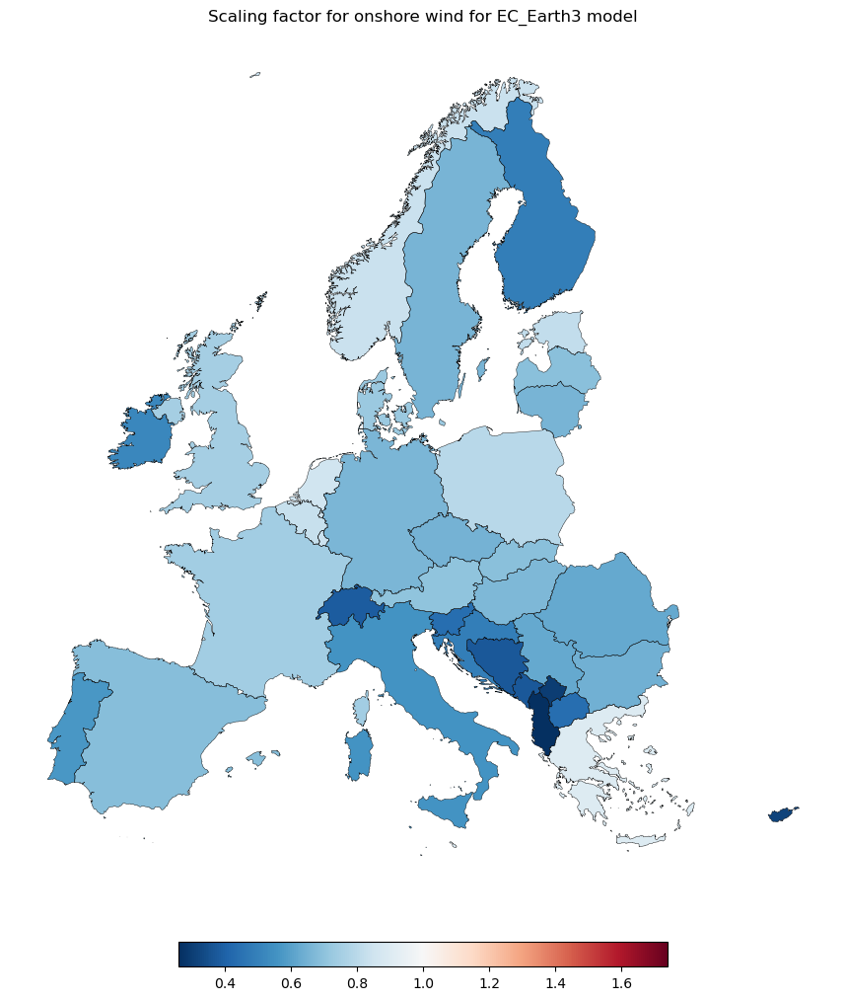

In [71]:
# Plotting correction factors for one climate model only:

CMIP6_model = 'EC-Earth3'

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')
CMIP6_model = CMIP6_model.replace("-", "_")
column_name = f'{CMIP6_model} {ssp_variant}'
# Getting geo data:
Countries_europe_df = gpd.GeoDataFrame(Europe)
Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
Countries_europe_df[column_name] = corr_factors[column_name]

min_val = np.nanmin(Countries_europe_df[column_name])
max_val = np.nanmax(Countries_europe_df[column_name])
if 0 <= max_val <= 1:
    z = np.linspace(min_val,1, 50*50).reshape(50,50);
    norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min()));
else: 
    z = np.linspace(0,max_val,50*50).reshape(50,50);
    norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=z.max());

im = Countries_europe_df.plot(ax=ax, column=column_name,transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.5},
                  norm=norm,aspect="equal").set_frame_on(False);
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
fig.colorbar(im, ax=ax, location='bottom', fraction=.1,shrink=0.5,norm=norm,cmap="RdBu_r")
fig.suptitle(f'Scaling factor for onshore wind for {CMIP6_model} model');


In [72]:
corr_factors.max()

EC_Earth3 ssp585           0.900629
MPI_ESM1_2_HR ssp585       1.251200
MIROC6 ssp585             10.983267
MPI_ESM1_2_LR ssp585       0.895251
HadGEM3_GC31_LL ssp585     4.130712
HadGEM3_GC31_MM ssp585     2.005334
IPSL_CM6A_LR ssp585        1.717549
AWI_CM_1_1_MR ssp585       1.758599
EC_Earth3_Veg ssp585       0.855056
dtype: float64

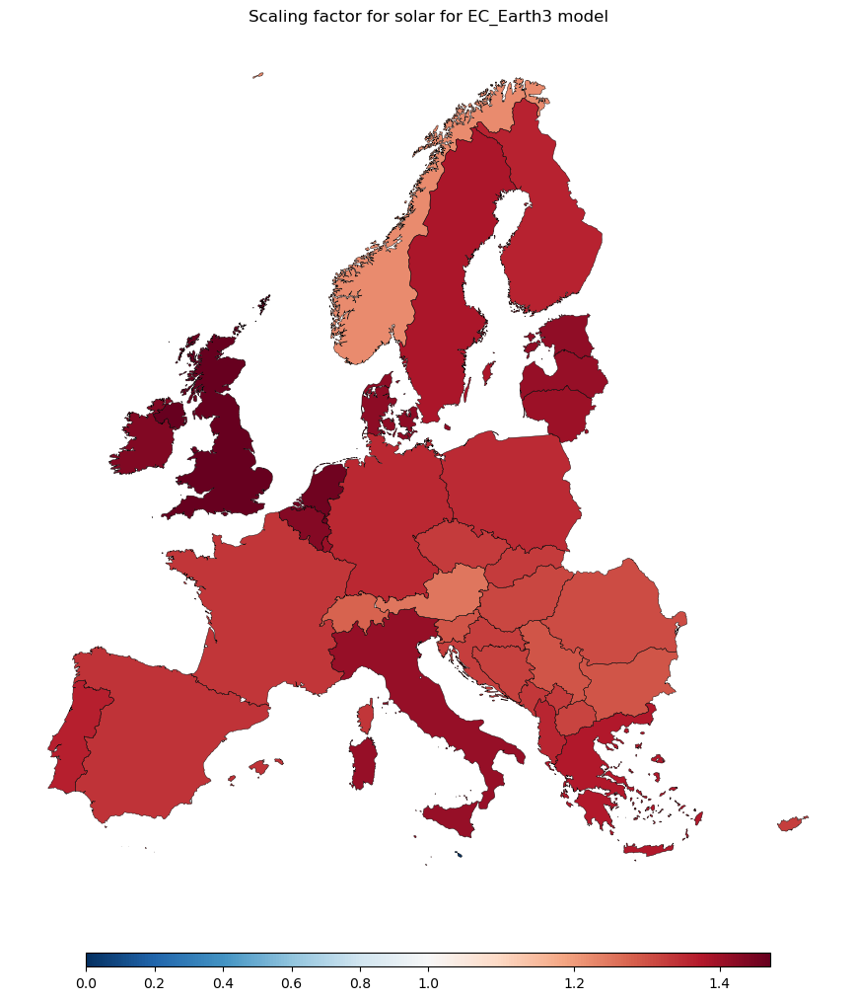

In [73]:
# Plotting correction factors

CMIP6_model = 'EC-Earth3'

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')
CMIP6_model = CMIP6_model.replace("-", "_")
column_name = f'{CMIP6_model} {ssp_variant}'
# Getting geo data:
Countries_europe_df = gpd.GeoDataFrame(Europe)
Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
Countries_europe_df[column_name] = corr_factors_PV[column_name]

min_val = np.nanmin(Countries_europe_df[column_name])
max_val = np.nanmax(Countries_europe_df[column_name])
if 0 <= max_val <= 1:
    z = np.linspace(min_val,1, 50*50).reshape(50,50);
    norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min()));
else: 
    z = np.linspace(0,max_val,50*50).reshape(50,50);
    norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=z.max());

im = Countries_europe_df.plot(ax=ax, column=column_name,transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.5},
                  norm=norm,aspect="equal").set_frame_on(False);
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
fig.colorbar(im, ax=ax, location='bottom', fraction=.1,shrink=0.7,aspect=50,norm=norm,cmap="RdBu_r")
fig.suptitle(f'Scaling factor for solar for {CMIP6_model} model');

In [74]:
# # Wind correction per country: 

# fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10),layout='constrained')
# # fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10))
# ssp_variant = 'ssp585'
# min_val = corr_factors.min().min();
# # max_val = corr_factors.max().max();
# max_val_global = 5
# nr_of_decimals = 2;

# i = 0
# for CMIP6_model in CMIP6_models_wind: 
#     CMIP6_model = CMIP6_model.replace("-", "_")
#     column_name = f'{CMIP6_model} {ssp_variant}'
#     # Getting geo data:
#     Countries_europe_df = gpd.GeoDataFrame(Europe)
#     Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
#     Countries_europe_df[column_name] = corr_factors[column_name]

#     min_val = np.nanmin(Countries_europe_df[column_name])
#     max_val = np.nanmax(Countries_europe_df[column_name])
#     mean_val = np.mean(Countries_europe_df[column_name])

#     if 0 <= max_val_global <= 1:
#         z = np.linspace(min_val,1, 50*50).reshape(50,50);
#         norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min()));
#     else: 
#         z = np.linspace(0,max_val_global,50*50).reshape(50,50);
#         norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=z.max());

#     im = Countries_europe_df.plot(ax=axs.flat[i], transform=plate(),column=column_name,cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
#                     norm=norm,aspect="equal").set_frame_on(False);
#     Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
#     axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}; max={round(max_val,nr_of_decimals)} \n mean={round(mean_val,nr_of_decimals)}');
#     i = i+1;
# fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=50,norm=norm,cmap="RdBu_r",label='Capacity factor')
# fig.suptitle(f'Scaling factor for onshore wind CF for CMIP6 climate models \n 2015 - 2022 ');
# fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)
# # fig.tight_layout();

# # Saving figure to file: 
# plot_filename = (f'Correction of wind CF for all CMIP6 models.png')
# # plt.savefig(plot_path(plot_filename), dpi=300)

In [75]:
# # PV Correction per country: 

# fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10),layout='constrained')
# min_val = corr_factors_PV.min().min();
# max_val_global = corr_factors_PV.max().max();


# i = 0
# for CMIP6_model in CMIP6_models_solar: 
#     CMIP6_model = CMIP6_model.replace("-", "_")
#     column_name = f'{CMIP6_model} {ssp_variant}'
#     # Getting geo data:
#     Countries_europe_df = gpd.GeoDataFrame(Europe)
#     Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
#     Countries_europe_df[column_name] = corr_factors_PV[column_name]

#     min_val = np.nanmin(Countries_europe_df[column_name])
#     max_val = np.nanmax(Countries_europe_df[column_name])
#     mean_val = np.mean(Countries_europe_df[column_name])
#     if 0 <= max_val_global <= 1:
#         z = np.linspace(min_val,1, 50*50).reshape(50,50);
#         norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min()));
#     else: 
#         z = np.linspace(0,max_val_global,50*50).reshape(50,50);
#         norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=z.max());

#     im = Countries_europe_df.plot(ax=axs.flat[i], transform=plate(),column=column_name,cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
#                     norm=norm,aspect="equal").set_frame_on(False);
#     Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
#     axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}; max={round(max_val,nr_of_decimals)} \n mean={round(mean_val,nr_of_decimals)}');
#     i = i+1;
# fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=50,norm=norm,cmap="RdBu_r",label='Capacity factor')
# fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)
# fig.suptitle(f'Scaling correction factor for solar CF for CMIP6 climate models \n 2015 - 2022');

# # Saving figure to file: 
# plot_filename = (f'Correction of solar CF for all CMIP6 models.png')
# # plt.savefig(plot_path(plot_filename), dpi=300)

In [76]:
corr_factors_PV.max()

EC_Earth3 ssp585          1.470080
MPI_ESM1_2_HR ssp585      1.516926
MIROC6 ssp585             1.439029
MPI_ESM1_2_LR ssp585      1.558977
HadGEM3_GC31_LL ssp585    1.473375
HadGEM3_GC31_MM ssp585    1.449224
IPSL_CM6A_LR ssp585       1.712688
AWI_CM_1_1_MR ssp585      1.523821
ACCESS_CM2 ssp585         1.480378
dtype: float64

In [77]:
# cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
CMIP6_models

['EC-Earth3',
 'MPI-ESM1-2-HR',
 'MIROC6',
 'MPI-ESM1-2-LR',
 'HadGEM3-GC31-LL',
 'HadGEM3-GC31-MM',
 'IPSL-CM6A-LR',
 'AWI-CM-1-1-MR']

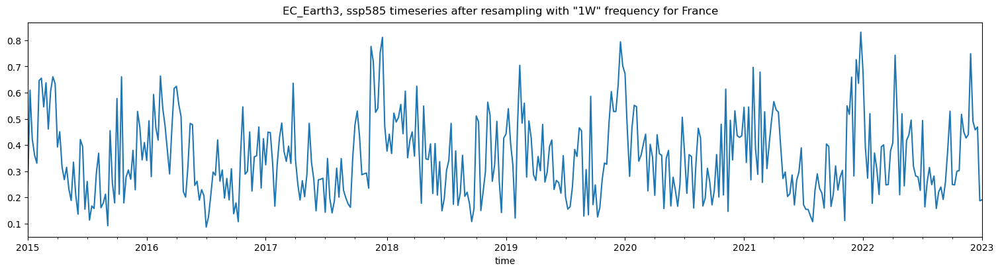

In [78]:
country = "France"
resample_freq = "1W"
CMIP6_model = CMIP6_models[0]
ssp_variant = 'ssp585'

CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
fig,ax = plt.subplots(figsize=(15,4),layout='constrained')
locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resample_freq).mean().plot(ax=ax, layout='constrained')
fig.suptitle(f'{CMIP6_model}, {ssp_variant} timeseries after resampling with "{resample_freq}" frequency for {country}');

C:\Users\c10si\AppData\Local\Temp\ipykernel_3296\1881399069.py:16: UserWarning: The figure layout has changed to tight
  fig.tight_layout();


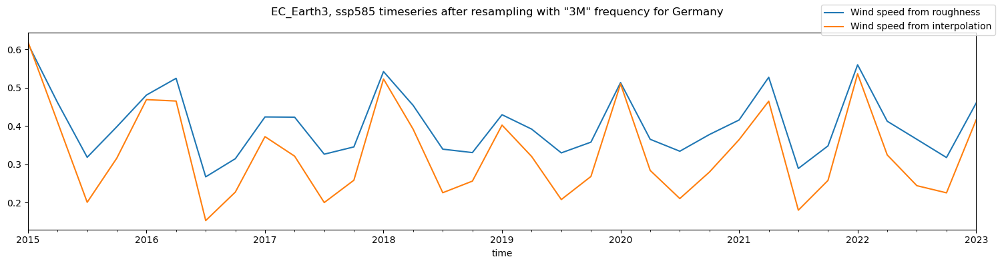

In [79]:
country = "Germany"
resample_freq = "3M"
CMIP6_model = CMIP6_models[0]
ssp_variant = 'ssp585'

CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
fig,ax = plt.subplots(figsize=(15,4),layout='constrained')
locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resample_freq).mean().plot(ax=ax, layout='constrained',label='Wind speed from roughness');
fig.suptitle(f'{CMIP6_model}, {ssp_variant} timeseries after resampling with "{resample_freq}" frequency for {country}');

# Wind 100m timeseries:
filename_2 = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
locals()[filename_2].sel(dim_0=country).squeeze().to_series().resample(resample_freq).mean().plot(ax=ax, layout='constrained', label='Wind speed from interpolation');
fig.legend();
fig.tight_layout();

C:\Users\c10si\AppData\Local\Temp\ipykernel_3296\1923038509.py:23: UserWarning: The figure layout has changed to tight
  fig.tight_layout();


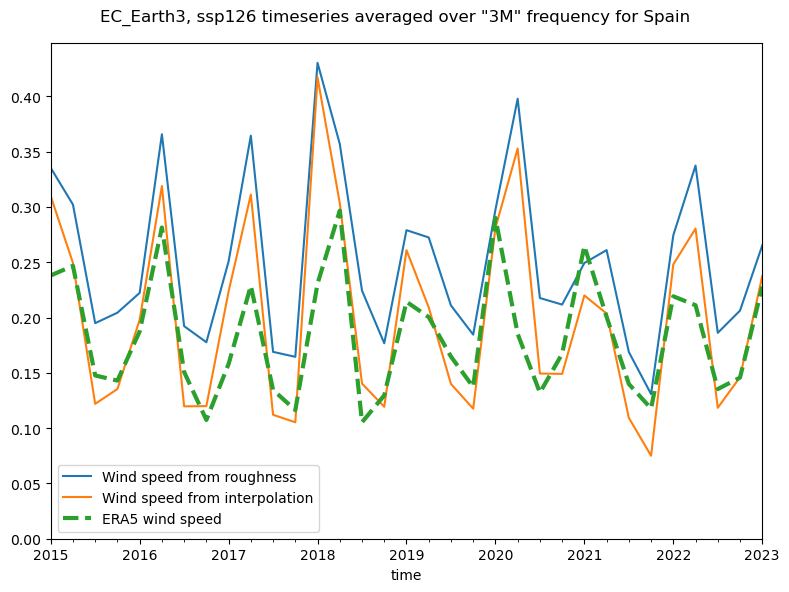

In [80]:
country = "Spain"
resample_freq = "3M"
CMIP6_model = CMIP6_models[0]
ssp_variant = 'ssp126'

CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'

fig,ax = plt.subplots(figsize=(8,6),layout='constrained')
locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resample_freq).mean().plot(ax=ax,label='Wind speed from roughness');
fig.suptitle(f'{CMIP6_model}, {ssp_variant} timeseries averaged over "{resample_freq}" frequency for {country}');

# Wind 100m timeseries:
filename_2 = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
locals()[filename_2].sel(dim_0=country).squeeze().to_series().resample(resample_freq).mean().plot(ax=ax, label='Wind speed from interpolation');

# ERA5
filename = f'Wind_ERA5_BOC'
locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resample_freq).mean().plot(ax=ax,label='ERA5 wind speed',linewidth=3,linestyle="--");

plt.ylim(0, ) 
plt.legend(loc="best");
fig.tight_layout();

# Saving figure to file: 
plot_filename = (f'{CMIP6_model} {ssp_variant} timeseries {resample_freq} freq {country}');
# plt.savefig(plot_path(plot_filename), dpi=300);

C:\Users\c10si\AppData\Local\Temp\ipykernel_3296\2606527707.py:22: UserWarning: The figure layout has changed to tight
  fig.tight_layout();


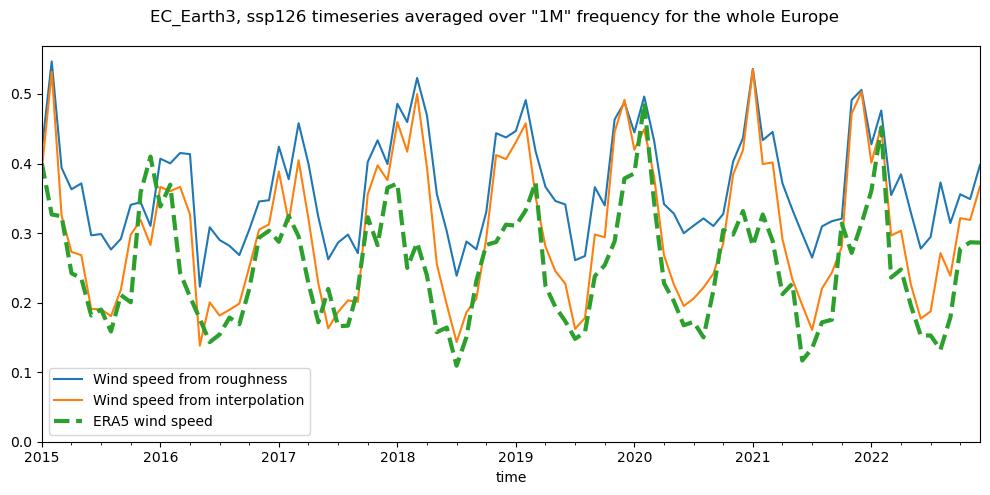

In [81]:
resample_freq = "1M"
CMIP6_model = CMIP6_models[0]
# ssp_variant = 'ssp585'

CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'

fig,ax = plt.subplots(figsize=(10,5),layout='constrained')
locals()[filename].squeeze().to_series().resample(resample_freq).mean().plot(ax=ax,label='Wind speed from roughness');
fig.suptitle(f'{CMIP6_model}, {ssp_variant} timeseries averaged over "{resample_freq}" frequency for the whole Europe');

# Wind 100m timeseries:
filename_2 = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m_total'
locals()[filename_2].squeeze().to_series().resample(resample_freq).mean().plot(ax=ax, label='Wind speed from interpolation');

# ERA5
filename = f'Wind_ERA5_BOC_total'
locals()[filename].squeeze().to_series().resample(resample_freq).mean().plot(ax=ax,label='ERA5 wind speed',linewidth=3,linestyle="--");

plt.ylim(0, ) 
plt.legend(loc="best");
fig.tight_layout();

# Saving figure to file: 
plot_filename = (f'{CMIP6_model} {ssp_variant} timeseries {resample_freq} freq Europe');
# plt.savefig(plot_path(plot_filename), dpi=300);

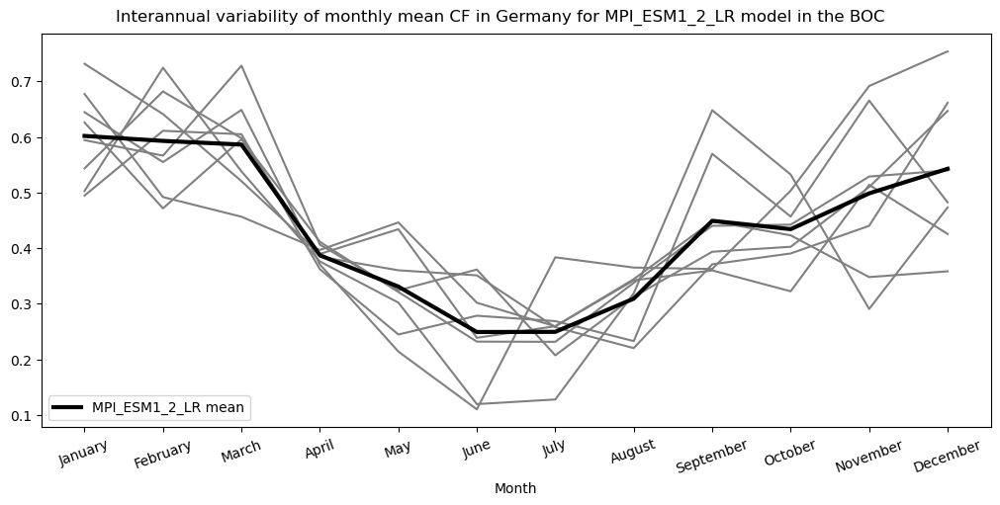

In [82]:
# euro_to_dollar[(euro_to_dollar["Time"].dt.strftime('%Y') == '2020')
CMIP6_model = CMIP6_models[3]
# ssp_variant = 'ssp585'
country = 'Germany'

CMIP6_model = CMIP6_model.replace("-", "_")
# filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'

fig,ax = plt.subplots(figsize=(10,5),layout='constrained')
# data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data = locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resample_freq).mean()

data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",legend=False)

data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,color="black",linewidth=3, legend=True,label=f'{CMIP6_model} mean')
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
fig.suptitle(f'Interannual variability of monthly mean CF in {country} for {CMIP6_model} model in the BOC')

# Saving figure to file: 
plot_filename = (f'{CMIP6_model} {ssp_variant} timeseries {resample_freq} freq Europe.png');
# plt.savefig(plot_path(plot_filename), dpi=300);

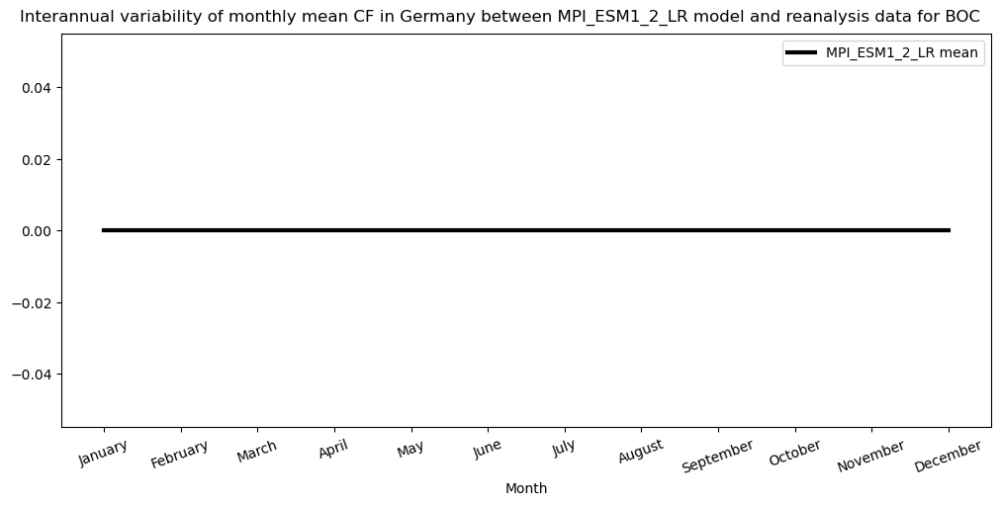

In [83]:
CMIP6_model = CMIP6_models[3]
ssp_variant = 'ssp585'
country = 'Germany'

CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'

fig,ax = plt.subplots(figsize=(10,5),layout='constrained')
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
# data = locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resample_freq).mean()

data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",legend=False)

data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,color="black",linewidth=3, legend=True,label=f'{CMIP6_model} mean')
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
fig.suptitle(f'Interannual variability of monthly mean CF in {country} between {CMIP6_model} model and reanalysis data for BOC')

# Saving figure to file: 
plot_filename = (f'{CMIP6_model} {ssp_variant} timeseries {resample_freq} freq Europe');
# plt.savefig(plot_path(plot_filename), dpi=300);

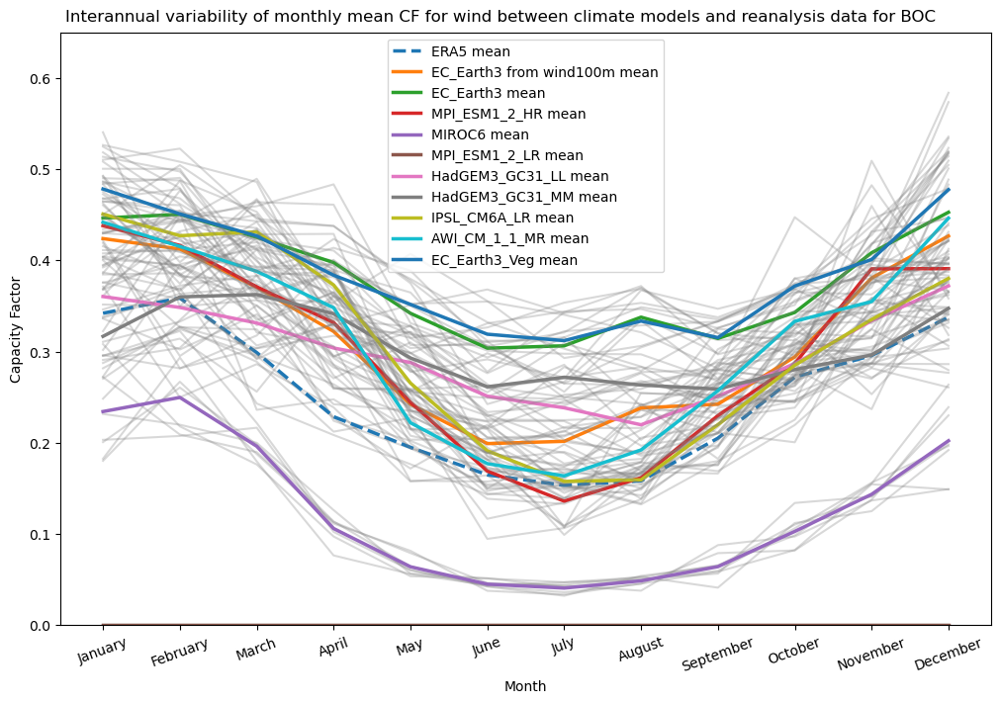

In [84]:
ssp_variant = 'ssp585'
fig,ax = plt.subplots(figsize=(10,7),layout='constrained')
title = f'Interannual variability of monthly mean CF for wind between climate models and reanalysis data for BOC'
fig.suptitle(title)

Monthly_mean = pd.DataFrame()

# ERA5
filename = f'Wind_ERA5_BOC_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, linestyle="--",legend=True,label=f'ERA5 mean')
Monthly_mean['ERA5'] = data_df['mean']
# EC-Earth3 CF from wind interpolation using wind100m:
CMIP6_model = 'EC_Earth3'
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'{CMIP6_model} from wind100m mean')
Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'{CMIP6_model} mean')
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Capacity Factor')
plt.ylim([0,0.65])

# Saving figure to file: 
plot_filename = title;
# plt.savefig(plot_path(plot_filename), dpi=300);

In [85]:
import math
# RMSE
y_actual = Monthly_mean['ERA5']
RMSE_data = pd.DataFrame(index=[0])
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    y_predicted = Monthly_mean[CMIP6_model]
    MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
    RMSE = math.sqrt(MSE)
    RMSE_data[CMIP6_model] = RMSE
# Adding values for EC-Earth3 from wind100m: 
CMIP6_model = 'EC_Earth3'
y_predicted = Monthly_mean[f'{CMIP6_model}_wind_100m']
MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
RMSE = math.sqrt(MSE)
RMSE_data[f'{CMIP6_model}_wind_100m'] = RMSE
# print("Root Mean Square Error:\n")
# print(RMSE)
RMSE_data.sort_values(0,axis=1,ascending=True,inplace=True)
RMSE_data

,HadGEM3_GC31_LL,MPI_ESM1_2_HR,EC_Earth3_wind_100m,AWI_CM_1_1_MR,IPSL_CM6A_LR,HadGEM3_GC31_MM,MIROC6,EC_Earth3,EC_Earth3_Veg,MPI_ESM1_2_LR
0,0.057151,0.060461,0.066188,0.070256,0.073183,0.073293,0.12756,0.130118,0.136736,0.261152


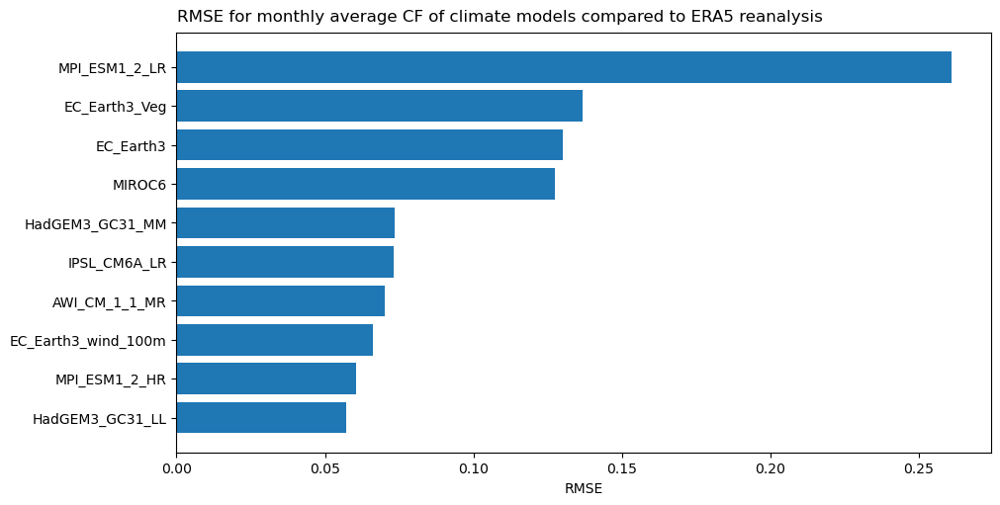

In [86]:
fig,ax = plt.subplots(figsize=(10,5),layout='constrained');
ax.barh(RMSE_data.columns,RMSE_data.iloc[0]);
title = f'RMSE for monthly average CF of climate models compared to ERA5 reanalysis';
plt.xlabel('RMSE')
fig.suptitle(title);

# Saving figure to file: 
plot_filename = title;
# plt.savefig(plot_path(plot_filename), dpi=300);

In [87]:
CMIP6_models = ['EC-Earth3', 'MPI-ESM1-2-HR', 'MIROC6', 'MPI-ESM1-2-LR', 'HadGEM3-GC31-LL', 'HadGEM3-GC31-MM', 'IPSL-CM6A-LR', 'AWI-CM-1-1-MR']

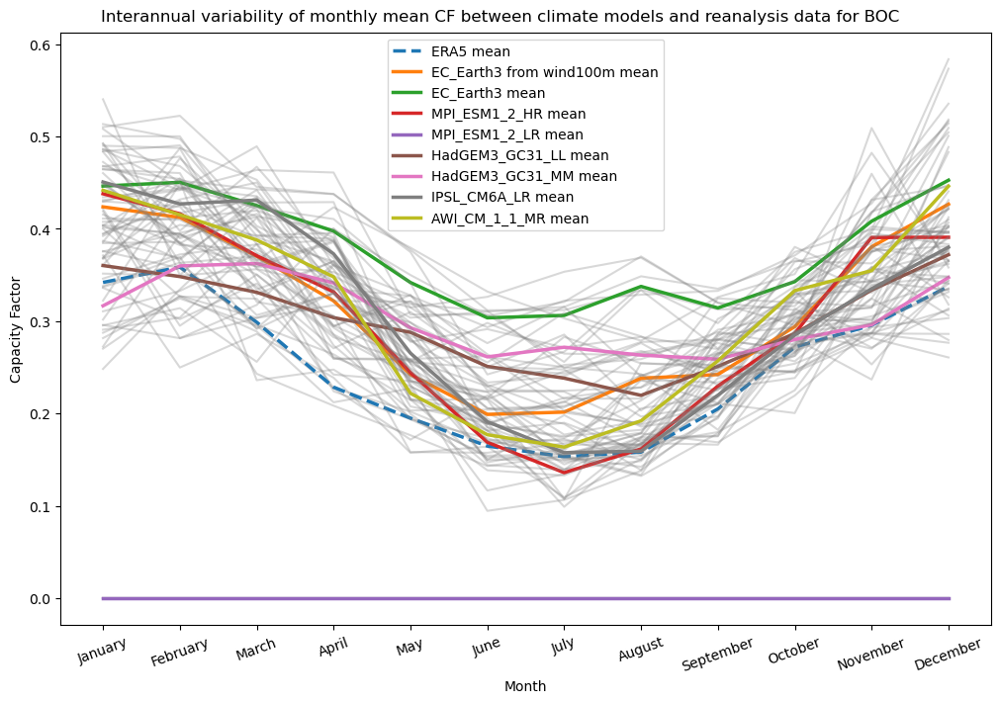

In [88]:
ssp_variant = 'ssp585'
CMIP6_models_better = CMIP6_models
CMIP6_models_better.remove('MIROC6')
fig,ax = plt.subplots(figsize=(10,7),layout='constrained')
title = f'Interannual variability of monthly mean CF between climate models and reanalysis data for BOC'
fig.suptitle(title)

Monthly_mean = pd.DataFrame()

# ERA5
filename = f'Wind_ERA5_BOC_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, linestyle="--",legend=True,label=f'ERA5 mean')
Monthly_mean['ERA5'] = data_df['mean']
# EC-Earth3 CF from wind interpolation using wind100m:
CMIP6_model = 'EC_Earth3'
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'{CMIP6_model} from wind100m mean')
Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

for CMIP6_model in CMIP6_models_better:
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'{CMIP6_model} mean')
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Capacity Factor')
# plt.ylim(0.7)

# Saving figure to file: 
plot_filename = title;
# plt.savefig(plot_path(plot_filename), dpi=300);

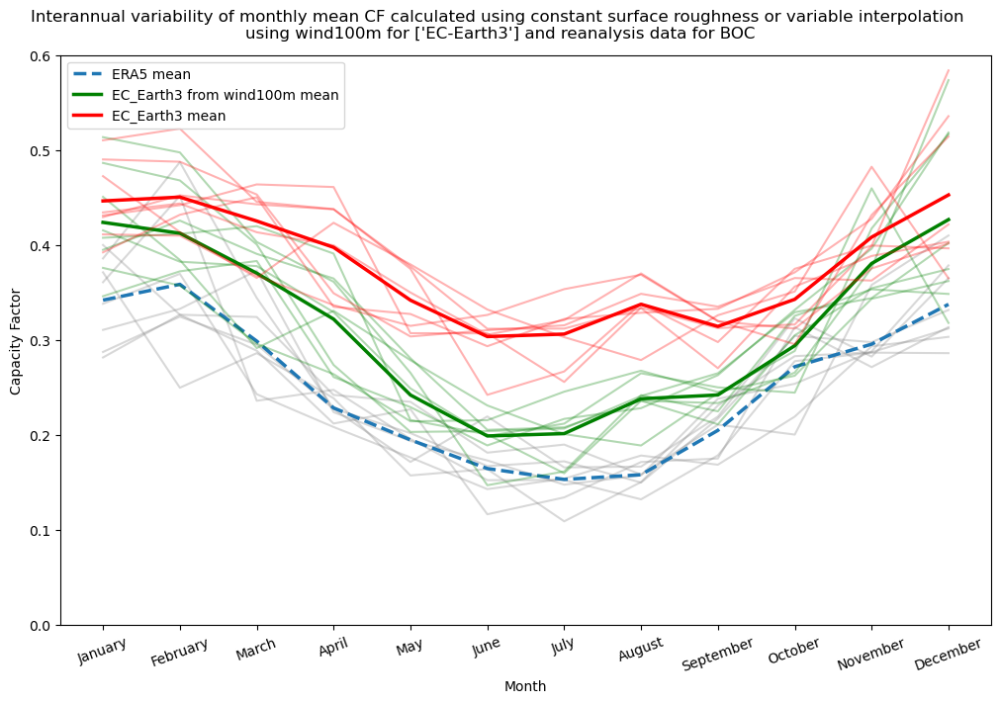

In [89]:
CMIP6_models_EC_Earth3 = ['EC-Earth3']

fig,ax = plt.subplots(figsize=(10,7),layout='constrained')
title = f'Interannual variability of monthly mean CF calculated using constant surface roughness or variable interpolation \nusing wind100m for {CMIP6_models_EC_Earth3} and reanalysis data for BOC'
fig.suptitle(title)

Monthly_mean = pd.DataFrame()

# ERA5
filename = f'Wind_ERA5_BOC_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, linestyle="--",legend=True,label=f'ERA5 mean')
Monthly_mean['ERA5'] = data_df['mean']
# EC-Earth3 CF from wind interpolation using wind100m:
CMIP6_model = 'EC_Earth3'
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="green",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, color="green",legend=True,label=f'{CMIP6_model} from wind100m mean')
Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

for CMIP6_model in CMIP6_models_EC_Earth3:
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    data_df.plot(ax=ax,color="red",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2.5, color="red",legend=True,label=f'{CMIP6_model} mean')
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Capacity Factor')
plt.ylim([0,0.6])

# Saving figure to file: 
plot_filename = f'Monthly mean CF ERA5 vs EC_Earth3 using wind100m and roughness';
# plt.savefig(plot_path(plot_filename), dpi=300);

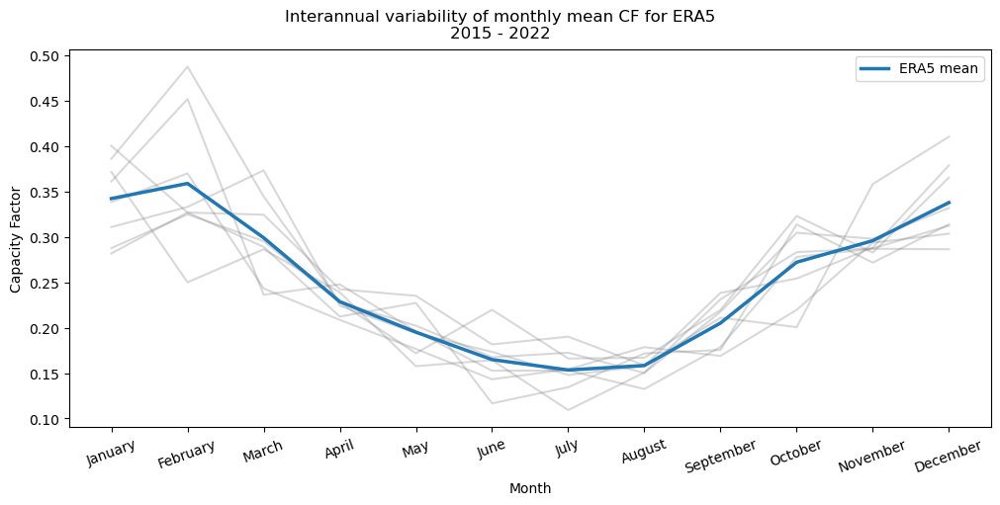

In [90]:
fig,ax = plt.subplots(figsize=(10,5),layout='constrained')
fig.suptitle(f'Interannual variability of monthly mean CF for ERA5\n2015 - 2022')

# ERA5
filename = f'Wind_ERA5_BOC_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,8):
    year = 2015+i;
    data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'ERA5 mean')
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Capacity Factor')

# Saving figure to file: 
plot_filename = (f'ERA5 Monthly interannual variability of CF in Europe');
# plt.savefig(plot_path(plot_filename), dpi=300);

In [91]:
data_df.describe()

,ERA5 2015,ERA5 2016,ERA5 2017,ERA5 2018,ERA5 2019,ERA5 2020,ERA5 2021,ERA5 2022,mean
count,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000
mean,0.269831,0.233085,0.254110,0.236783,0.256032,0.274048,0.236137,0.246632,0.250832
std,0.089123,0.076155,0.068015,0.077655,0.080925,0.102365,0.073496,0.094005,0.075920
min,0.158527,0.143178,0.166042,0.109284,0.147889,0.150091,0.116695,0.132442,0.153388
25%,0.197916,0.174622,0.207582,0.162556,0.188705,0.194691,0.174462,0.172225,0.187457
50%,0.238644,0.214000,0.255031,0.244337,0.246125,0.262838,0.249357,0.241880,0.250287
75%,0.334520,0.295910,0.302120,0.286463,0.316237,0.334831,0.295009,0.286377,0.308572
max,0.410017,0.369675,0.365165,0.371291,0.378569,0.487195,0.326746,0.451623,0.358658


C:\Users\c10si\AppData\Local\Temp\ipykernel_3296\2550801860.py:23: UserWarning: The figure layout has changed to tight
  fig.tight_layout();


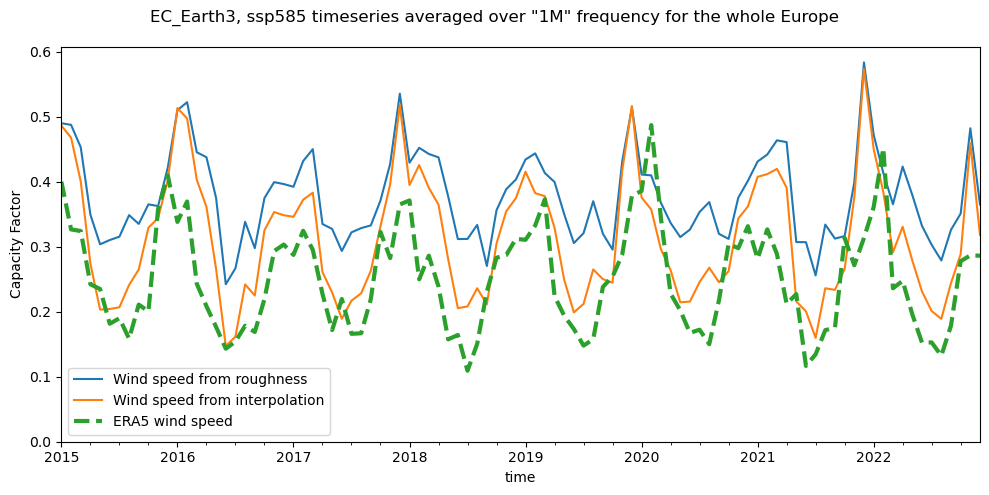

In [92]:
resample_freq = "1M"
CMIP6_model = CMIP6_models[0]
# ssp_variant = 'ssp585'

CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'

fig,ax = plt.subplots(figsize=(10,5),layout='constrained')
locals()[filename].squeeze().to_series().resample(resample_freq).mean().plot(ax=ax,label='Wind speed from roughness');
fig.suptitle(f'{CMIP6_model}, {ssp_variant} timeseries averaged over "{resample_freq}" frequency for the whole Europe');

# Wind 100m timeseries:
filename_2 = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m_total'
locals()[filename_2].squeeze().to_series().resample(resample_freq).mean().plot(ax=ax, label='Wind speed from interpolation');

# ERA5
filename = f'Wind_ERA5_BOC_total'
locals()[filename].squeeze().to_series().resample(resample_freq).mean().plot(ax=ax,label='ERA5 wind speed',linewidth=3,linestyle="--");

plt.ylim(0, ) 
plt.ylabel('Capacity Factor')
plt.legend(loc="best");
fig.tight_layout();

# Saving figure to file: 
plot_filename = (f'{CMIP6_model} {ssp_variant} timeseries {resample_freq} freq Europe');
# plt.savefig(plot_path(plot_filename), dpi=300);

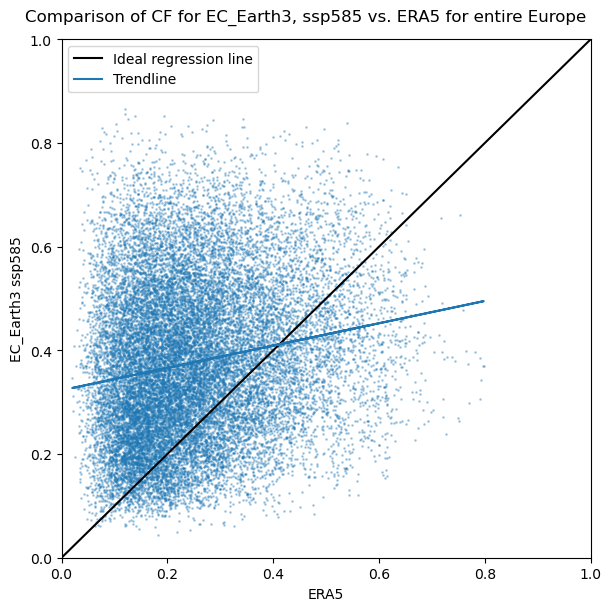

In [93]:
CMIP6_model = CMIP6_models[0]
CMIP6_model = CMIP6_model.replace("-", "_")
ssp_variant = 'ssp585'

filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'
CMIP6_data = locals()[filename].squeeze().to_series()

era5_filename = f'Wind_ERA5_BOC_total'
ERA5_data = locals()[era5_filename].squeeze().to_series().resample('3H').mean()
fig, ax = plt.subplots(figsize=(6, 6),layout='constrained')
ax.scatter(ERA5_data,CMIP6_data,s=1, alpha=0.3)

x_vals = np.linspace(0,1,2)
y_vals = np.linspace(0,1,2)
ax.plot(x_vals,y_vals,"k",label="Ideal regression line")

# Trendline: 
z = np.polyfit(ERA5_data.values, CMIP6_data.values, 1)
p = np.poly1d(z)
ax.plot(ERA5_data.values, p(ERA5_data),label="Trendline")

ax.set_xlim([0,1])
ax.set_ylim([0,1])
title = f'Comparison of CF for {CMIP6_model}, {ssp_variant} vs. ERA5 for entire Europe'
fig.suptitle(title);
ax.legend()
ax.set_xlabel("ERA5")
ax.set_ylabel(f'{CMIP6_model} {ssp_variant}')

# Saving figure to file: 
plot_filename = (f'{title}.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

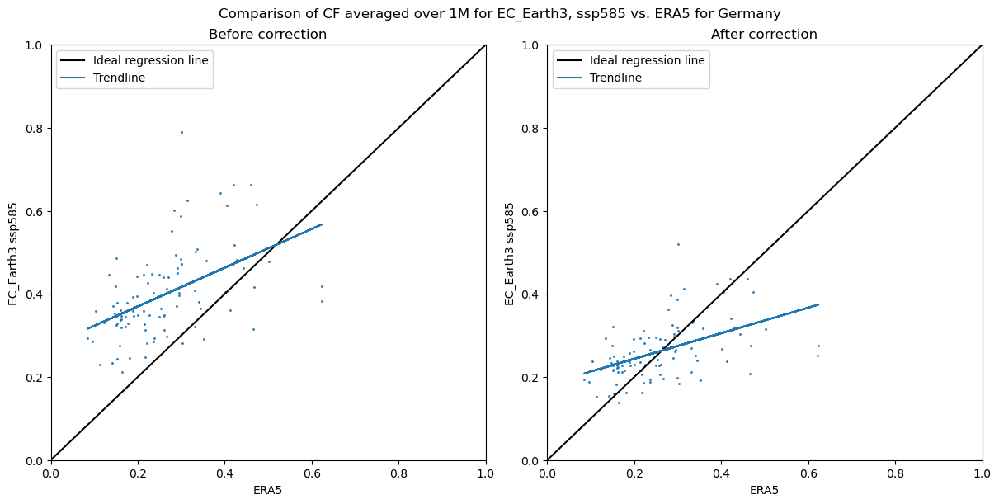

In [94]:
# Scatter plot before correction 

country = 'Germany'
resampling_freq = '1M'
alpha = 0.8
s = 1.5

filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
CMIP6_data = locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()

era5_filename = f'Wind_ERA5_BOC'
# ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample('3H').mean()
ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()
fig, [ax ,ax2] = plt.subplots(1,2,figsize=(12, 6),layout='constrained')
ax.scatter(ERA5_data,CMIP6_data,s=s, alpha=alpha)

x_vals = np.linspace(0,1,2)
y_vals = np.linspace(0,1,2)
ax.plot(x_vals,y_vals,"k",label="Ideal regression line")

# Trendline: 
z = np.polyfit(ERA5_data.values, CMIP6_data.values, 1)
p = np.poly1d(z)
ax.plot(ERA5_data.values, p(ERA5_data),label="Trendline")
ax.set_xlim([0,1])
ax.set_ylim([0,1])
title = f'Comparison of CF for {CMIP6_model}, {ssp_variant} vs. ERA5 for {country}'
fig.suptitle(title);
ax.legend()
ax.set_xlabel("ERA5")
ax.set_ylabel(f'{CMIP6_model} {ssp_variant}')

# Scatter plot after correction 
column_name = f'{CMIP6_model} {ssp_variant}'
CMIP6_data = locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()*corr_factors.loc[country][column_name]
# ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample('3H').mean()
ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()
ax2.scatter(ERA5_data,CMIP6_data,s=s, alpha=alpha)
ax2.plot(x_vals,y_vals,"k",label="Ideal regression line")
# Trendline: 
z = np.polyfit(ERA5_data.values, CMIP6_data.values, 1)
p = np.poly1d(z)
ax2.plot(ERA5_data.values, p(ERA5_data),label="Trendline")
ax2.set_xlim([0,1])
ax2.set_ylim([0,1])
ax.set_title(f'Before correction')
ax2.set_title(f'After correction')
title = f'Comparison of CF averaged over {resampling_freq} for {CMIP6_model}, {ssp_variant} vs. ERA5 for {country}'
fig.suptitle(title);
ax2.legend()
ax2.set_xlabel("ERA5")
ax2.set_ylabel(f'{CMIP6_model} {ssp_variant}')

# Saving figure to file: 
plot_filename = (f'{title}.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

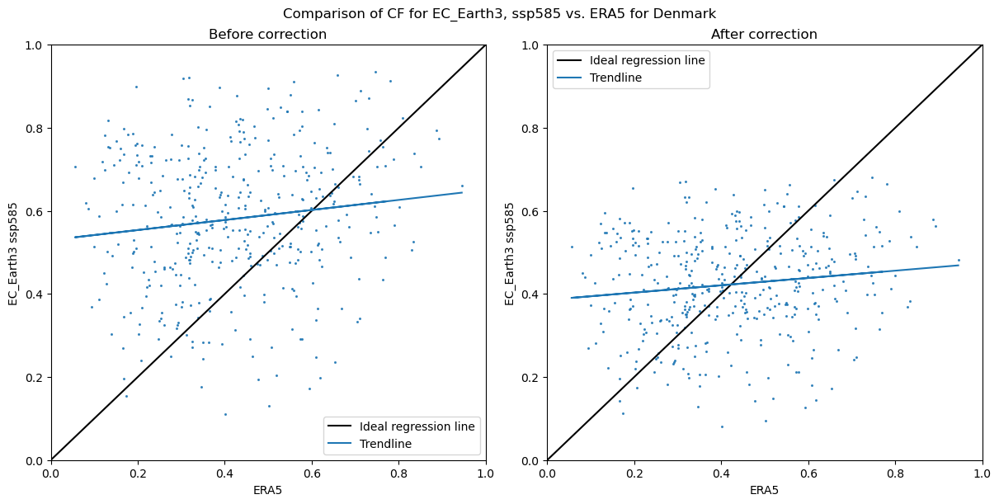

In [95]:
# Scatter plot before correction 

country = 'Denmark'
resampling_freq = '1W'
alpha = 0.8
s = 1.5

filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
CMIP6_data = locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()

era5_filename = f'Wind_ERA5_BOC'
# ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample('3H').mean()
ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()
fig, [ax ,ax2] = plt.subplots(1,2,figsize=(12, 6),layout='constrained')
ax.scatter(ERA5_data,CMIP6_data,s=s, alpha=alpha)

x_vals = np.linspace(0,1,2)
y_vals = np.linspace(0,1,2)
ax.plot(x_vals,y_vals,"k",label="Ideal regression line")

# Trendline: 
z = np.polyfit(ERA5_data.values, CMIP6_data.values, 1)
p = np.poly1d(z)
ax.plot(ERA5_data.values, p(ERA5_data),label="Trendline")
ax.set_xlim([0,1])
ax.set_ylim([0,1])
title = f'Comparison of CF for {CMIP6_model}, {ssp_variant} vs. ERA5 for {country}'
fig.suptitle(title);
ax.legend()
ax.set_xlabel("ERA5")
ax.set_ylabel(f'{CMIP6_model} {ssp_variant}')

# Scatter plot after correction 
column_name = f'{CMIP6_model} {ssp_variant}'
CMIP6_data = locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()*corr_factors.loc[country][column_name]
# ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample('3H').mean()
ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()
ax2.scatter(ERA5_data,CMIP6_data,s=s, alpha=alpha)
ax2.plot(x_vals,y_vals,"k",label="Ideal regression line")
# Trendline: 
z = np.polyfit(ERA5_data.values, CMIP6_data.values, 1)
p = np.poly1d(z)
ax2.plot(ERA5_data.values, p(ERA5_data),label="Trendline")
ax2.set_xlim([0,1])
ax2.set_ylim([0,1])
ax.set_title(f'Before correction')
ax2.set_title(f'After correction')
title = f'Comparison of CF for {CMIP6_model}, {ssp_variant} vs. ERA5 for {country}'
fig.suptitle(title);
ax2.legend()
ax2.set_xlabel("ERA5")
ax2.set_ylabel(f'{CMIP6_model} {ssp_variant}')

# Saving figure to file: 
plot_filename = (f'{title}.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

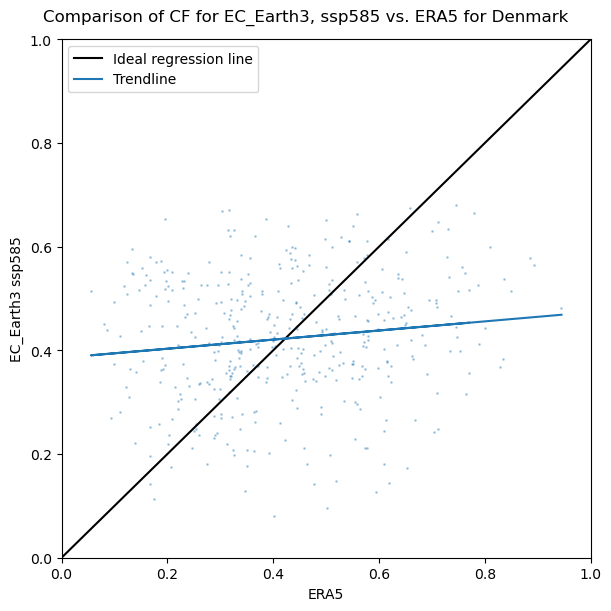

In [96]:
# Scatter plot after correction 

filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
column_name = f'{CMIP6_model} {ssp_variant}'
CMIP6_data = locals()[filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()*corr_factors.loc[country][column_name]

era5_filename = f'Wind_ERA5_BOC'
# ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample('3H').mean()
ERA5_data = locals()[era5_filename].sel(dim_0=country).squeeze().to_series().resample(resampling_freq).mean()
fig, ax = plt.subplots(figsize=(6, 6),layout='constrained')
ax.scatter(ERA5_data,CMIP6_data,s=1, alpha=0.3)

x_vals = np.linspace(0,1,2)
y_vals = np.linspace(0,1,2)
ax.plot(x_vals,y_vals,"k",label="Ideal regression line")

# Trendline: 
z = np.polyfit(ERA5_data.values, CMIP6_data.values, 1)
p = np.poly1d(z)
ax.plot(ERA5_data.values, p(ERA5_data),label="Trendline")

ax.set_xlim([0,1])
ax.set_ylim([0,1])
title = f'Comparison of CF for {CMIP6_model}, {ssp_variant} vs. ERA5 for {country}'
fig.suptitle(title);
ax.legend()
ax.set_xlabel("ERA5")
ax.set_ylabel(f'{CMIP6_model} {ssp_variant}')

# Saving figure to file: 
plot_filename = (f'{title}.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

In [97]:
# Plotting correction factor as a function of country area

df = pd.read_csv('Countries-Europe.csv',delimiter=';')
Countries_europe = df.drop(['zoom','abbreviation','ISO numeric','population','latitude','longitude','continent','PV capacity 2015 [MW]','PV capacity 2016','Hydro capacity 2015','Hydro capacity 2016','Wind power capacity 2015','Wind power capacity 2016'],axis=1).set_index('name',inplace=False).drop(['Vatican City','Monaco','Andorra','San Marino','Guernsey','Liechtenstein','Ukraine','Moldova','Belarus','Faroe Is.','Iceland','Gibraltar']).sort_values('name')

Countries_europe.rename(index={'Macedonia': 'North Macedonia'},inplace=True)
Countries_europe

,ISO alpha 2,ISO alpha 3,land area km
name,,,
Albania,AL,ALB,28748
Austria,AT,AUT,83858
Belgium,BE,BEL,30510
Bosnia and Herzegovina,BA,BIH,51129
Bulgaria,BG,BGR,110910
Croatia,HR,HRV,56542
Cyprus,CY,CYP,9250
Czech Republic,CZ,CZE,78866
Denmark,DK,DNK,43094


In [98]:
corr_factors

,EC_Earth3 ssp585,MPI_ESM1_2_HR ssp585,MIROC6 ssp585,MPI_ESM1_2_LR ssp585,HadGEM3_GC31_LL ssp585,HadGEM3_GC31_MM ssp585,IPSL_CM6A_LR ssp585,AWI_CM_1_1_MR ssp585,EC_Earth3_Veg ssp585
Norway,0.833571,1.129612,2.017748,0.861991,1.421479,1.560114,0.928934,1.029082,0.836428
France,0.742346,0.870858,2.422917,0.564275,0.843943,0.798620,0.790791,0.806438,0.710646
Netherlands,0.850460,0.818903,2.241441,0.636188,0.671708,0.844156,0.646059,0.850880,0.824317
Spain,0.687457,0.743967,1.425235,0.429206,2.331740,1.331851,0.865754,0.742751,0.683939
Malta,0.898609,0.861082,1.235432,0.000000,1.143475,0.862909,0.000000,0.000000,0.000000
Portugal,0.570729,0.563820,0.579641,0.364216,0.657304,0.807776,0.697325,0.562952,0.590847
Italy,0.556251,0.471004,1.626825,0.289288,1.009556,0.918707,0.361200,0.490821,0.511038
Croatia,0.486904,0.490792,2.617594,0.409013,1.792084,0.788192,0.408113,0.442037,0.457224
Slovenia,0.438507,0.493235,3.385317,0.286596,2.866417,1.061871,0.454058,0.525520,0.512965
Switzerland,0.386441,0.402282,2.993166,0.248634,4.130712,0.591683,0.333863,0.383504,0.460058


In [99]:
# Calculating scaling factor for wind:
columns = []
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    columns += [f'{CMIP6_model} {ssp_variant}']

corr_factors = pd.DataFrame(np.zeros((len(Europe.index),len(CMIP6_models_wind))),columns=[columns],index=Europe.index)

# Calculating for all CMIP6 models: 
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for country in Europe.index:
        name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        column_name = f'{CMIP6_model} {ssp_variant}'
        CF_ERA5 = CF_mean.loc[country]['ERA5 (reference)']
        CF_CMIP = CF_mean.loc[country][column_name]
        corr_factors.loc[country][column_name] = np.nanmean(CF_ERA5/CF_CMIP)
print(f'Scaling correction factors per country for all climate models for wind')
corr_factors.replace([np.inf, -np.inf], 0, inplace=True)

# corr_factors.to_excel("Corr_factors_wind.xlsx", sheet_name="Onshore wind")
# corr_factors.to_csv("Corr_factors_wind.csv")
corr_factors

Scaling correction factors per country for all climate models for wind


C:\Users\c10si\AppData\Local\Temp\ipykernel_3296\3479140761.py:17: RuntimeWarning: divide by zero encountered in scalar divide
  corr_factors.loc[country][column_name] = np.nanmean(CF_ERA5/CF_CMIP)


,EC_Earth3 ssp585,MPI_ESM1_2_HR ssp585,MIROC6 ssp585,MPI_ESM1_2_LR ssp585,HadGEM3_GC31_LL ssp585,HadGEM3_GC31_MM ssp585,IPSL_CM6A_LR ssp585,AWI_CM_1_1_MR ssp585,EC_Earth3_Veg ssp585
Norway,0.833571,1.129612,2.017748,0.861991,1.421479,1.560114,0.928934,1.029082,0.836428
France,0.742346,0.870858,2.422917,0.564275,0.843943,0.798620,0.790791,0.806438,0.710646
Netherlands,0.850460,0.818903,2.241441,0.636188,0.671708,0.844156,0.646059,0.850880,0.824317
Spain,0.687457,0.743967,1.425235,0.429206,2.331740,1.331851,0.865754,0.742751,0.683939
Malta,0.898609,0.861082,1.235432,0.000000,1.143475,0.862909,0.000000,0.000000,0.000000
Portugal,0.570729,0.563820,0.579641,0.364216,0.657304,0.807776,0.697325,0.562952,0.590847
Italy,0.556251,0.471004,1.626825,0.289288,1.009556,0.918707,0.361200,0.490821,0.511038
Croatia,0.486904,0.490792,2.617594,0.409013,1.792084,0.788192,0.408113,0.442037,0.457224
Slovenia,0.438507,0.493235,3.385317,0.286596,2.866417,1.061871,0.454058,0.525520,0.512965
Switzerland,0.386441,0.402282,2.993166,0.248634,4.130712,0.591683,0.333863,0.383504,0.460058


In [100]:
ssp_variant = 'ssp585'

corr_wind_per_area = pd.DataFrame(np.zeros((len(Europe.index),len(CMIP6_models_wind))),columns=[columns],index=Europe.index)

# Calculating for all CMIP6 models: 
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for country in Europe.index:
        name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        column_name = f'{CMIP6_model} {ssp_variant}'
        corr_factor = corr_factors.loc[country][column_name]
        area = Countries_europe.loc[country]['land area km']
        corr_wind_per_area.loc[country][column_name] = np.nanmean(corr_factor/area)
print(f'Scaling correction factors per unit area per country for all climate models for wind')
# corr_wind_per_area.replace([np.inf, -np.inf], 0, inplace=True)
# corr_wind_per_area.to_excel("Corr_factors_per_area_wind.xlsx", sheet_name="Onshore wind")
corr_wind_per_area

Scaling correction factors per unit area per country for all climate models for wind


,EC_Earth3 ssp585,MPI_ESM1_2_HR ssp585,MIROC6 ssp585,MPI_ESM1_2_LR ssp585,HadGEM3_GC31_LL ssp585,HadGEM3_GC31_MM ssp585,IPSL_CM6A_LR ssp585,AWI_CM_1_1_MR ssp585,EC_Earth3_Veg ssp585
Norway,0.000003,0.000003,0.000006,2.658660e-06,0.000004,0.000005,0.000003,0.000003,0.000003
France,0.000001,0.000002,0.000004,1.031525e-06,0.000002,0.000001,0.000001,0.000001,0.000001
Netherlands,0.000020,0.000020,0.000054,1.532023e-05,0.000016,0.000020,0.000016,0.000020,0.000020
Spain,0.000001,0.000001,0.000003,8.502793e-07,0.000005,0.000003,0.000002,0.000001,0.000001
Malta,0.002844,0.002725,0.003910,0.000000e+00,0.003619,0.002731,0.000000,0.000000,0.000000
Portugal,0.000006,0.000006,0.000006,3.942114e-06,0.000007,0.000009,0.000008,0.000006,0.000006
Italy,0.000002,0.000002,0.000005,9.603573e-07,0.000003,0.000003,0.000001,0.000002,0.000002
Croatia,0.000009,0.000009,0.000046,7.233784e-06,0.000032,0.000014,0.000007,0.000008,0.000008
Slovenia,0.000022,0.000024,0.000167,1.413681e-05,0.000141,0.000052,0.000022,0.000026,0.000025
Switzerland,0.000009,0.000010,0.000072,6.021645e-06,0.000100,0.000014,0.000008,0.000009,0.000011


In [101]:
corr_wind_per_area_PV = pd.DataFrame(np.zeros((len(Europe.index),len(CMIP6_models_solar))),columns=[columns],index=Europe.index)

# Calculating for all CMIP6 models: 
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for country in Europe.index:
        name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        column_name = f'{CMIP6_model} {ssp_variant}'
        corr_factor = corr_factors_PV.loc[country][column_name]
        area = Countries_europe.loc[country]['land area km']
        corr_wind_per_area_PV.loc[country][column_name] = np.nanmean(corr_factor/area)
print(f'Scaling correction factors per unit area per country for all climate models for solar')
# corr_wind_per_area.replace([np.inf, -np.inf], 0, inplace=True)
corr_wind_per_area_PV.to_excel("Corr_factors_per_area_PV.xlsx", sheet_name="Solar")
corr_wind_per_area_PV

Scaling correction factors per unit area per country for all climate models for solar


,EC_Earth3 ssp585,MPI_ESM1_2_HR ssp585,MIROC6 ssp585,MPI_ESM1_2_LR ssp585,HadGEM3_GC31_LL ssp585,HadGEM3_GC31_MM ssp585,IPSL_CM6A_LR ssp585,AWI_CM_1_1_MR ssp585,EC_Earth3_Veg ssp585
Norway,0.000004,0.000004,0.000004,0.000005,0.000004,0.000004,0.000005,0.000005,0.0
France,0.000002,0.000003,0.000002,0.000003,0.000002,0.000002,0.000003,0.000002,0.0
Netherlands,0.000035,0.000035,0.000031,0.000036,0.000032,0.000033,0.000037,0.000034,0.0
Spain,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.000003,0.0
Malta,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
Portugal,0.000015,0.000015,0.000014,0.000015,0.000014,0.000014,0.000016,0.000014,0.0
Italy,0.000005,0.000004,0.000005,0.000004,0.000005,0.000005,0.000005,0.000004,0.0
Croatia,0.000023,0.000023,0.000024,0.000023,0.000024,0.000023,0.000024,0.000023,0.0
Slovenia,0.000064,0.000061,0.000064,0.000062,0.000064,0.000062,0.000066,0.000060,0.0
Switzerland,0.000031,0.000035,0.000034,0.000036,0.000033,0.000031,0.000037,0.000035,0.0


In [102]:
# # Loading created CF timeseries for wind: 
# count = 0;
# for CMIP6_model in CMIP6_models_wind:
#     CMIP6_model = CMIP6_model.replace("-", "_")
#     for ssp_variant in ssp_variants:
#         name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
#         filename = f'{name}.nc'
#         path = f"E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/{filename}"
#         locals()[name] = xr.open_dataarray(path)
#         print(f'File "{name}" successfully imported. ')
#         count = count+1;

# print(f'{count} file(s) imported in total. ')

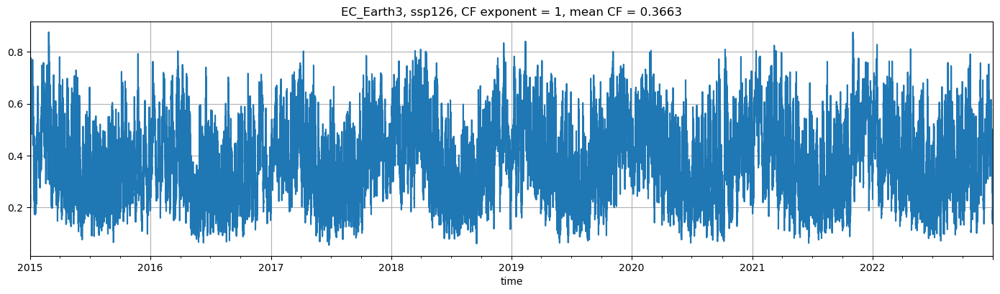

In [103]:
# Plotting timeseries: 
CMIP6_model = 'EC_Earth3'
ssp_variant = 'ssp126'
name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'

fig, ax = plt.subplots(1, figsize=(14, 4))
locals()[name].to_pandas().plot(ax=ax, label=f'{CMIP6_model}_{ssp_variant}')
CF_mean_PV = locals()[name].values.mean()
fig.tight_layout();
plt.title(f'{CMIP6_model}, {ssp_variant}, CF exponent = 1, mean CF = {round(CF_mean_PV,4)}');
ax.get_legend().remove()
plt.grid()

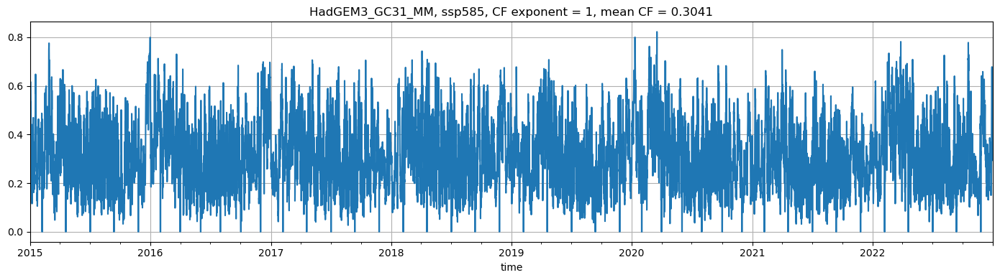

In [104]:
# Plotting timeseries: 
CMIP6_model = 'HadGEM3_GC31_MM'
# CMIP6_model = 'MPI-ESM1-2-LR'
CMIP6_model = CMIP6_model.replace("-", "_")
ssp_variant = 'ssp585'
name = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'
plot_filename = f'{name}.png'

fig, ax = plt.subplots(1, figsize=(14, 4))
locals()[name].to_pandas().plot(ax=ax, label=f'{CMIP6_model}_{ssp_variant}')
CF_mean_PV = locals()[name].values.mean()

plt.title(f'{CMIP6_model}, {ssp_variant}, CF exponent = 1, mean CF = {round(CF_mean_PV,4)}');
ax.get_legend().remove()
plt.grid()
fig.tight_layout();
# Saving figure to file: 
# plt.savefig(plot_path(plot_filename), dpi=300)

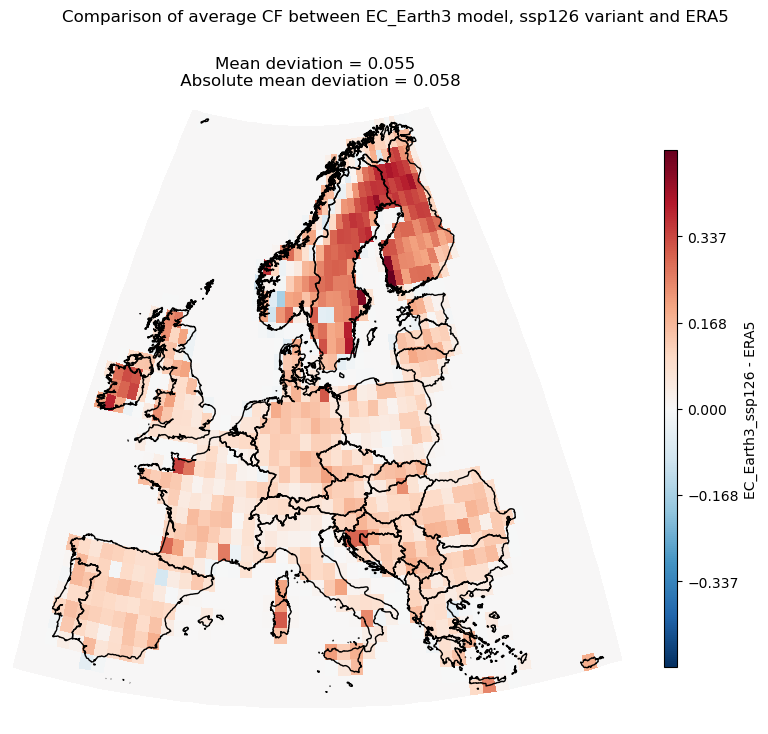

In [105]:
# Plotting wind CF for land only

CMIP6_model = 'EC-Earth3'
ssp_variant = 'ssp126'

CMIP6_model = CMIP6_model.replace("-", "_")
CF_ERA5_all = cap_factors_coarse.values
CMIP_name = f'CF_avg_wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
CF_ERA5 = indicator_matrix_EC_Earth3*CF_ERA5_all;
CF_CMIP = indicator_matrix_EC_Earth3*locals()[CMIP_name]

CF_diff = (CF_CMIP - CF_ERA5)
CF_diff_mean = round(np.nanmean(CF_diff.values),3)
CF_diff_mean_abs = round(np.nanmean(abs(CF_diff.values)),3)
scaling_correction = np.nanmean(CF_ERA5/CF_CMIP)

fig, ax = plt.subplots(subplot_kw={"projection": projection}, figsize=map_fig_size)
max_value = np.nanmax(abs(CF_diff))
max_rounded = round(max_value,3)
z = np.linspace(-max_value,max_value,50*50).reshape(50,50);
norm = TwoSlopeNorm(vmin=z.min(), vcenter=0, vmax=z.max());

CF_diff.plot(transform=plate(), norm=norm, ax=ax, cmap="RdBu_r",
             cbar_kwargs={'shrink': 0.7, 'aspect': 40, 'label': f"{CMIP6_model}_{ssp_variant} - ERA5", 'ticks': np.linspace(-max_rounded,max_rounded,7)}
             );
Europe.plot(ax=ax, transform=plate(), edgecolor="k", color="None",aspect="equal",).set_frame_on(False);
# Removing frame: 
ax.spines['geo'].set_edgecolor('None')
fig.suptitle(f'Comparison of average CF between {CMIP6_model} model, {ssp_variant} variant and ERA5');
# ax.set_title(f'Mean deviation = {CF_diff_mean} \n Absolute mean deviation = {CF_diff_mean_abs} \n Scaling correction = {round(scaling_correction,3)}');
ax.set_title(f'Mean deviation = {CF_diff_mean} \n Absolute mean deviation = {CF_diff_mean_abs}');
# ax.set_title(f'Mean deviation = {CF_diff_mean} \n Scaling correction = {scaling_correction}');
fig.tight_layout();

# Saving figure to file: 
plot_filename = (f'Average_CF_{CMIP6_model}_{ssp_variant}_vs_ERA5.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

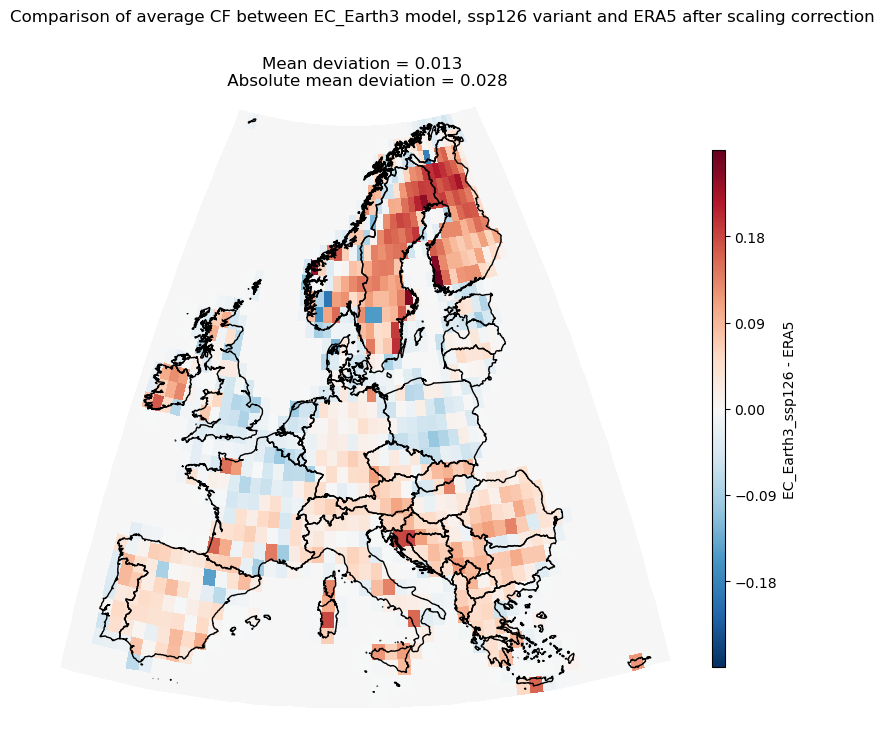

In [106]:
# Plotting wind CF after scaling correction

CF_CMIP_corr = CF_CMIP*scaling_correction
CF_diff = (CF_CMIP_corr - CF_ERA5)
CF_diff_mean = round(np.nanmean(CF_diff.values),3)
CF_diff_mean_abs = round(np.nanmean(abs(CF_diff.values)),3)
scaling_correction = np.nanmean(CF_ERA5/CF_CMIP_corr)

fig, ax = plt.subplots(subplot_kw={"projection": projection}, figsize=map_fig_size)
max_value = np.nanmax(abs(CF_diff))
max_rounded = round(max_value,3)
z = np.linspace(-max_value,max_value,50*50).reshape(50,50);
norm = TwoSlopeNorm(vmin=z.min(), vcenter=0, vmax=z.max());

CF_diff.plot(transform=plate(), norm=norm, ax=ax, cmap="RdBu_r",
             cbar_kwargs={'shrink': 0.7, 'aspect': 40, 'label': f"{CMIP6_model}_{ssp_variant} - ERA5", 
             'ticks': np.linspace(-max_rounded,max_rounded,7)
             }
             );
Europe.plot(ax=ax, transform=plate(), edgecolor="k", color="None",aspect="equal",).set_frame_on(False);
# Removing frame: 
ax.spines['geo'].set_edgecolor('None')
fig.suptitle(f'Comparison of average CF between {CMIP6_model} model, {ssp_variant} variant and ERA5 after scaling correction');
ax.set_title(f'Mean deviation = {CF_diff_mean} \n Absolute mean deviation = {CF_diff_mean_abs}');
fig.tight_layout();

# Saving figure to file: 
plot_filename = (f'Average_CF_{CMIP6_model}_{ssp_variant}_vs_ERA5.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

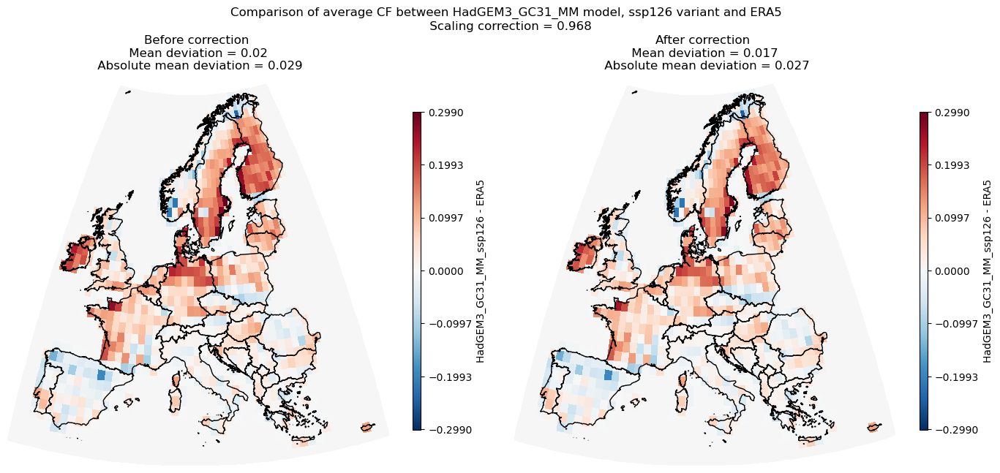

In [107]:
# Plotting wind CF before and after scale correction

CMIP6_model = 'HadGEM3_GC31_MM'
ssp_variant = 'ssp126'

CF_ERA5_all = cap_factors_coarse.values
CMIP_name = f'CF_avg_wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
CF_ERA5 = indicator_matrix_EC_Earth3*CF_ERA5_all;
CF_CMIP = indicator_matrix_EC_Earth3*locals()[CMIP_name]

CF_diff = (CF_CMIP - CF_ERA5)
CF_diff_mean = round(np.nanmean(CF_diff.values),3)
CF_diff_mean_abs = round(np.nanmean(abs(CF_diff.values)),3)
scaling_correction = np.nanmean(CF_ERA5/CF_CMIP)

fig,axs = plt.subplots(1,2,subplot_kw={"projection": projection}, figsize=(14,7))
max_value = np.nanmax(abs(CF_diff))
max_rounded = round(max_value,3)
z = np.linspace(-max_value,max_value,50*50).reshape(50,50);
norm = TwoSlopeNorm(vmin=z.min(), vcenter=0, vmax=z.max());

CF_diff.plot(transform=plate(), norm=norm, ax=axs[0], cmap="RdBu_r",
             cbar_kwargs={'shrink': 0.7, 'aspect': 40, 'label': f"{CMIP6_model}_{ssp_variant} - ERA5", 'ticks': np.linspace(-max_rounded,max_rounded,7)}
             );
Europe.plot(ax=axs[0], transform=plate(), edgecolor="k", color="None",aspect="equal",).set_frame_on(False);
axs[0].spines['geo'].set_edgecolor('None')  # Removing frame: 
fig.suptitle(f'Comparison of average CF between {CMIP6_model} model, {ssp_variant} variant and ERA5 \n Scaling correction = {round(scaling_correction,3)}');
axs[0].set_title(f'Before correction \n Mean deviation = {CF_diff_mean} \n Absolute mean deviation = {CF_diff_mean_abs}');

# Plot 2
CF_CMIP_corr = CF_CMIP*scaling_correction
CF_diff = (CF_CMIP_corr - CF_ERA5)
CF_diff_mean = round(np.nanmean(CF_diff.values),3)
CF_diff_mean_abs = round(np.nanmean(abs(CF_diff.values)),3)

im = CF_diff.plot(transform=plate(), norm=norm, ax=axs[1], cmap="RdBu_r",
             cbar_kwargs={'shrink': 0.7, 'aspect': 40, 'label': f"{CMIP6_model}_{ssp_variant} - ERA5", 
             'ticks': np.linspace(-max_rounded,max_rounded,7)
             }
             );
Europe.plot(ax=axs[1], transform=plate(), edgecolor="k", color="None",aspect="equal",).set_frame_on(False);
# Removing frame: 
axs[1].spines['geo'].set_edgecolor('None')
axs[1].set_title(f'After correction \n Mean deviation = {CF_diff_mean} \n Absolute mean deviation = {CF_diff_mean_abs}');
fig.tight_layout();

# Saving figure to file: 
plot_filename = (f'Correction of CF {CMIP6_model}_{ssp_variant}before and after global correction.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

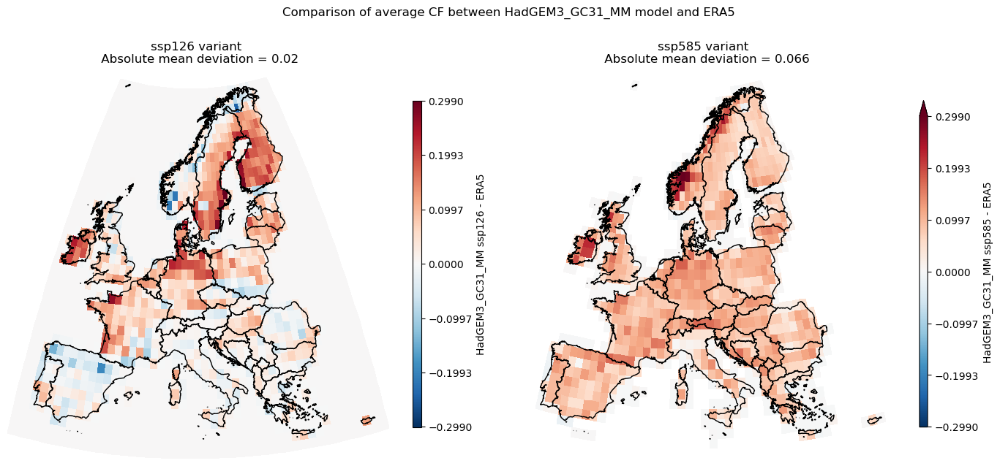

In [108]:
CMIP6_model = 'HadGEM3_GC31_MM'
ssp_variants = ['ssp126', 'ssp585']

fig,axs = plt.subplots(1,len(ssp_variants),subplot_kw={"projection": projection}, figsize=(14,7))
for i in range(len(ssp_variants)):
    CMIP_name = f'CF_avg_wind_{CMIP6_model}_{ssp_variants[i]}_{yy_start}_{yy_end}'
    CF_CMIP = indicator_matrix_EC_Earth3*locals()[CMIP_name]
    CF_diff = (CF_CMIP - CF_ERA5)
    CF_diff.plot(transform=plate(), norm=norm, ax=axs[i], cmap="RdBu_r",
             cbar_kwargs={'shrink': 0.7, 'aspect': 40, 'label': f"{CMIP6_model} {ssp_variants[i]} - ERA5", 'ticks': np.linspace(-max_rounded,max_rounded,7)},
            );
    # CF_diff_mean = round(np.nanmean(abs(CF_diff.values)),3)
    CF_diff_mean = round(np.nanmean(CF_diff.values),3)
    Europe.plot(ax=axs[i], transform=plate(), edgecolor="k", color="None",aspect="equal",).set_frame_on(False);
    axs[i].set_title(f'{ssp_variants[i]} variant \n Absolute mean deviation = {CF_diff_mean}');
    axs[i].spines['geo'].set_edgecolor('None') 
fig.suptitle(f'Comparison of average CF between {CMIP6_model} model and ERA5');
fig.tight_layout()

# Saving figure to file: 
plot_filename = (f'Average_CF_{CMIP6_model}_vs_ERA5.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

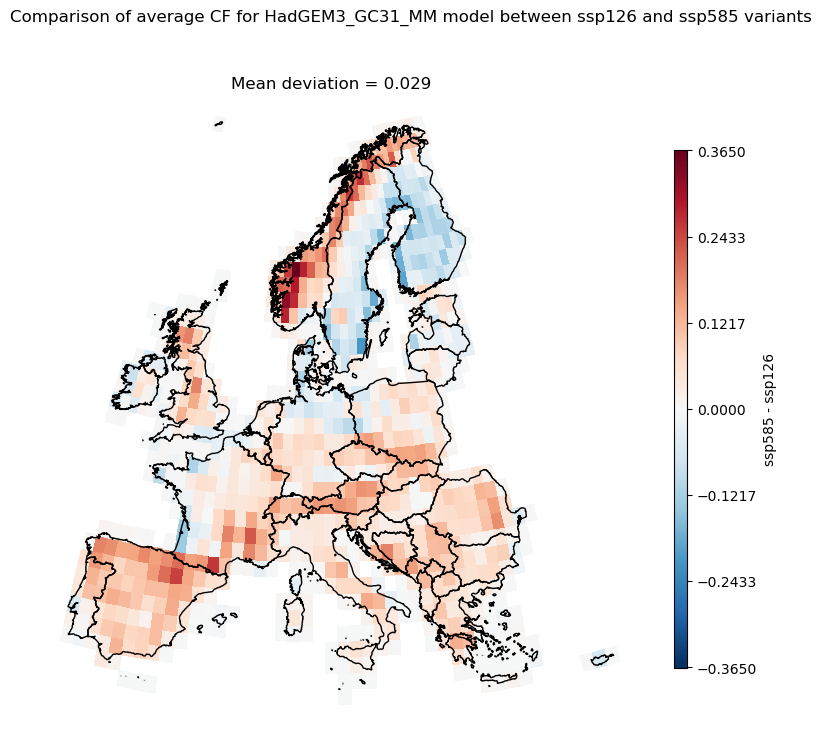

In [109]:
# Plotting wind CF for land only

CMIP6_model = 'HadGEM3_GC31_MM'
ssp_variants = ['ssp126', 'ssp585']

# CF_ERA5_all = cap_factors_coarse.values
CMIP_name_1 = f'CF_avg_wind_{CMIP6_model}_{ssp_variants[0]}_{yy_start}_{yy_end}'
CMIP_name_2 = f'CF_avg_wind_{CMIP6_model}_{ssp_variants[1]}_{yy_start}_{yy_end}'
# CF_ERA5 = indicator_matrix_EC_Earth3*CF_ERA5_all;
CF_CMIP_1 = indicator_matrix_EC_Earth3*locals()[CMIP_name_1]
CF_CMIP_2 = indicator_matrix_EC_Earth3*locals()[CMIP_name_2]

CF_diff = (CF_CMIP_2 - CF_CMIP_1)
CF_diff_mean = round(np.nanmean(CF_diff.values),3)
CF_diff_mean_abs = round(np.nanmean(abs(CF_diff.values)),3)

fig, ax = plt.subplots(subplot_kw={"projection": projection}, figsize=map_fig_size)
max_value = np.nanmax(abs(CF_diff))
max_rounded = round(max_value,3)
z = np.linspace(-max_value,max_value,50*50).reshape(50,50);
norm = TwoSlopeNorm(vmin=z.min(), vcenter=0, vmax=z.max());

CF_diff.plot(transform=plate(), norm=norm, ax=ax, cmap="RdBu_r",
             cbar_kwargs={'shrink': 0.7, 'aspect': 40, 'label': f"{ssp_variants[1]} - {ssp_variants[0]}", 'ticks': np.linspace(-max_rounded,max_rounded,7)}
             );
Europe.plot(ax=ax, transform=plate(), edgecolor="k", color="None",aspect="equal",).set_frame_on(False);
# Removing frame: 
ax.spines['geo'].set_edgecolor('None')
fig.suptitle(f'Comparison of average CF for {CMIP6_model} model between {ssp_variants[0]} and {ssp_variants[1]} variants');
ax.set_title(f'Mean deviation = {CF_diff_mean}');
fig.tight_layout()

# Saving figure to file: 
plot_filename = (f'CF_difference_{CMIP6_model}_{ssp_variants[0]}_vs_{ssp_variants[1]}.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

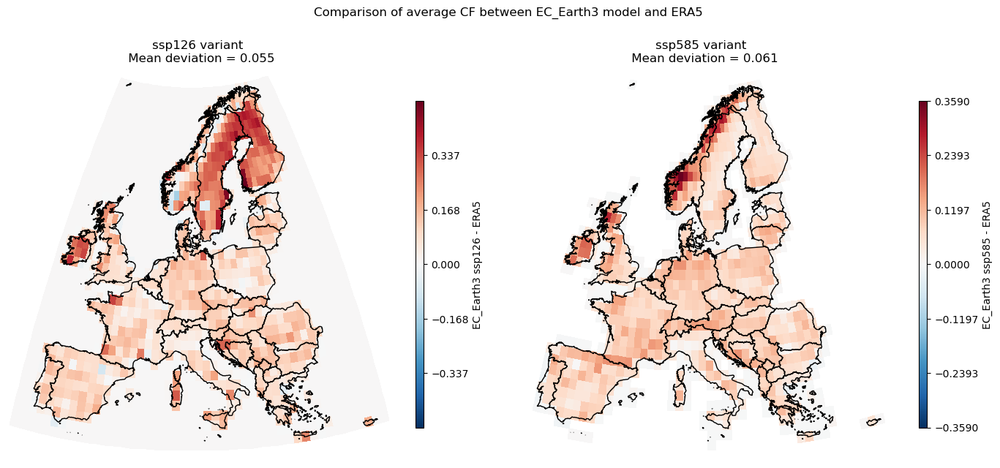

In [110]:
CMIP6_model = 'EC_Earth3'
ssp_variants = ['ssp126', 'ssp585']

fig,axs = plt.subplots(1,len(ssp_variants),subplot_kw={"projection": projection}, figsize=(14,7))
for i in range(len(ssp_variants)):
    CMIP_name = f'CF_avg_wind_{CMIP6_model}_{ssp_variants[i]}_{yy_start}_{yy_end}'
    CF_CMIP = indicator_matrix_EC_Earth3*locals()[CMIP_name]
    CF_diff = (CF_CMIP - CF_ERA5)
    CF_diff_mean = round(np.nanmean(CF_diff.values),3)
    CF_diff_mean_abs = round(np.nanmean(abs(CF_diff.values)),3)

    max_value = np.nanmax(abs(CF_diff))
    max_rounded = round(max_value,3)
    z = np.linspace(-max_value,max_value,50*50).reshape(50,50);
    norm = TwoSlopeNorm(vmin=z.min(), vcenter=0, vmax=z.max());

    CF_diff.plot(transform=plate(), norm=norm, ax=axs[i], cmap="RdBu_r",
             cbar_kwargs={'shrink': 0.7, 'aspect': 40, 'label': f"{CMIP6_model} {ssp_variants[i]} - ERA5", 
             'ticks': np.linspace(-max_rounded,max_rounded,7)
             },
            );
    Europe.plot(ax=axs[i], transform=plate(), edgecolor="k", color="None",aspect="equal",).set_frame_on(False);
    axs[i].set_title(f'{ssp_variants[i]} variant \n Mean deviation = {CF_diff_mean}');
    axs[i].spines['geo'].set_edgecolor('None') 
fig.suptitle(f'Comparison of average CF between {CMIP6_model} model and ERA5');
fig.tight_layout()

# Saving figure to file: 
plot_filename = (f'Average_CF_{CMIP6_model}_vs_ERA5.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

## Applying wind speed correction factors

In [111]:
CMIP6_model = 'EC_Earth3'
ssp_variant = 'ssp585'
data = 'PV'
cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
corr_factor_filename = f'Corr_factors_{data}_{CMIP6_model}'
locals()[cutout_name].data['influx'] = locals()[cutout_name].data['influx']*locals()[corr_factor_filename]

In [112]:
# Creating ERA5-corrected aggregated CF time series from CMIP6 models with proportional layout for wind:
overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries

ssp_variants = ['ssp585']

output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'
output_folder_path_PV = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/PV/'

# Wind: 
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        # Correcting the "wind 10m" speed data using ERA5 correction factors: 
        data = 'wind'
        corr_factor_filename = f'Corr_factors_{data}_{CMIP6_model}'
        locals()[cutout_name].data['wnd10m'] = locals()[cutout_name].data['wnd10m']*locals()[corr_factor_filename]
        if cutout_name in locals():
            name = f'ERA5-corrected_Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
            name_2 = f'{name}_total'
            filename = f'{name}.nc'
            filename_2 = f'{name_2}.nc'
            path = f'{output_folder_path}{filename}'
            path_2 = f'{output_folder_path}{filename_2}'
            if not Path(path).is_file() or overwrite == 1: 
                print(f'Creating "{filename}" from {cutout_name} cutout. ')
                # Adding roughness data (from ERA5) into the cutout:
                da = roughness.roughness.interp_like(locals()[cutout_name].data['wnd10m'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind,turbine=turbine,layout=layout_wind,per_unit=True,index=Europe.index)
                # Saving to file
                locals()[name].to_netcdf(path=f'{output_folder_path}{filename}')
            else: 
                locals()[name] = xr.open_dataarray(path)
                print(f'"{filename}" already exists in "{output_folder_path}". The file successfully imported. ')

            if not Path(path_2).is_file() or overwrite == 1: 
                print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
                da = roughness.roughness.interp_like(locals()[cutout_name].data['wnd10m'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                locals()[name_2] = locals()[cutout_name].wind(turbine=turbine,layout=layout_wind,per_unit=True)
                locals()[name_2].to_netcdf(path=f'{output_folder_path}{filename_2}')
            else: 
                locals()[name_2] = xr.open_dataarray(path_2)
                print(f'"{filename_2}" already exists in "{output_folder_path}". The file successfully imported. ')
# PV:
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        # Correcting "influx" data using ERA5 correction factors: 
        data = 'PV'
        corr_factor_filename = f'Corr_factors_{data}_{CMIP6_model}'
        locals()[cutout_name].data['influx'] = locals()[cutout_name].data['influx']*locals()[corr_factor_filename]
        if cutout_name in locals():        
            # PV:
            name = f'ERA5-corrected_PV_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
            name_2 = f'{name}_total'
            filename = f'{name}.nc'
            filename_2 = f'{name_2}.nc'
            path = f'{output_folder_path_PV}{filename}'
            path_2 = f'{output_folder_path_PV}{filename_2}'
            if not Path(path).is_file() or overwrite == 1: 
                print(f'Creating "{filename}" from {cutout_name} cutout. ')
                locals()[name] = locals()[cutout_name].pv(matrix=matrix_PV,panel=PV_panel,orientation="latitude_optimal",layout=layout_PV,per_unit=True,index=Europe.index)
                # Saving to file
                locals()[name].to_netcdf(path=f'{output_folder_path_PV}{filename}')
            else: 
                locals()[name] = xr.open_dataarray(path)
                print(f'"{filename}" already exists in "{output_folder_path_PV}". The file successfully imported. ')
            if not Path(path_2).is_file() or overwrite == 1: 
                print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
                locals()[name_2] = locals()[cutout_name].pv(panel=PV_panel,orientation="latitude_optimal",layout=layout_PV_era5,per_unit=True)
                locals()[name_2].to_netcdf(path=f'{output_folder_path_PV}{filename_2}')
            else: 
                locals()[name_2] = xr.open_dataarray(path_2)
                print(f'"{filename_2}" already exists in "{output_folder_path_PV}". The file successfully imported. ')
        else: 
            print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

"ERA5-corrected_Wind_EC_Earth3_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"ERA5-corrected_Wind_EC_Earth3_ssp585_15_22_total.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"ERA5-corrected_Wind_MPI_ESM1_2_HR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"ERA5-corrected_Wind_MPI_ESM1_2_HR_ssp585_15_22_total.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"ERA5-corrected_Wind_MIROC6_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"ERA5-corrected_Wind_MIROC6_ssp585_15_22_total.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"ERA5-corrected_Wind_MPI_ESM1_2_LR_ssp585_15_22.nc

In [113]:
# Creating GWA-corrected aggregated CF time series from CMIP6 models with proportional layout for wind:
overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries

ssp_variants = ['ssp585']

output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'
output_folder_path_PV = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/PV/'

# Wind: 
for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
        # Correcting the "wind 10m" speed data using ERA5 correction factors: 
        data = 'wind'
        corr_factor_filename = f'GWA_Corr_factors_{data}_{CMIP6_model}'
        locals()[cutout_name].data['wnd10m'] = locals()[cutout_name].data['wnd10m']*locals()[corr_factor_filename]
        if cutout_name in locals():
            name = f'GWA-corrected_Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'
            name_2 = f'{name}_total'
            filename = f'{name}.nc'
            filename_2 = f'{name_2}.nc'
            path = f'{output_folder_path}{filename}'
            path_2 = f'{output_folder_path}{filename_2}'
            if not Path(path).is_file() or overwrite == 1: 
                print(f'Creating "{filename}" from {cutout_name} cutout. ')
                # Adding roughness data (from ERA5) into the cutout:
                da = roughness.roughness.interp_like(locals()[cutout_name].data['wnd10m'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind,turbine=turbine,layout=layout_wind,per_unit=True,index=Europe.index)
                # Saving to file
                locals()[name].to_netcdf(path=f'{output_folder_path}{filename}')
            else: 
                locals()[name] = xr.open_dataarray(path)
                print(f'"{filename}" already exists in "{output_folder_path}". The file successfully imported. ')

            if not Path(path_2).is_file() or overwrite == 1: 
                print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
                da = roughness.roughness.interp_like(locals()[cutout_name].data['wnd10m'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                locals()[name_2] = locals()[cutout_name].wind(turbine=turbine,layout=layout_wind,per_unit=True)
                locals()[name_2].to_netcdf(path=f'{output_folder_path}{filename_2}')
            else: 
                locals()[name_2] = xr.open_dataarray(path_2)
                print(f'"{filename_2}" already exists in "{output_folder_path}". The file successfully imported. ')

"GWA-corrected_Wind_EC_Earth3_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"GWA-corrected_Wind_EC_Earth3_ssp585_15_22_total.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"GWA-corrected_Wind_MPI_ESM1_2_HR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"GWA-corrected_Wind_MPI_ESM1_2_HR_ssp585_15_22_total.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"GWA-corrected_Wind_MIROC6_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"GWA-corrected_Wind_MIROC6_ssp585_15_22_total.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file successfully imported. 
"GWA-corrected_Wind_MPI_ESM1_2_LR_ssp585_15_22.nc" alrea

In [114]:
# Creating aggregated CF time series with proportional layout for wind with wind_100m: 

CMIP6_models_wind100m = ['EC-Earth3']
# ssp_variants = ['ssp126', 'ssp245', 'ssp370', 'ssp585'] 
ssp_variants = ['ssp585']

overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'

for CMIP6_model in CMIP6_models_wind100m:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
        # Correcting the "wind 10m" and "wind 100m" speed data using ERA5 correction factors: 
        data = 'wind'
        corr_factor_filename = f'GWA_Corr_factors_{data}_{CMIP6_model}'
        locals()[cutout_name].data['wnd10m'] = locals()[cutout_name].data['wnd10m']*locals()[corr_factor_filename]
        locals()[cutout_name].data['wnd100m'] = locals()[cutout_name].data['wnd100m']*locals()[corr_factor_filename]
        if cutout_name in locals():
            name = f'GWA-corrected_Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
            name_2 = f'{name}_total'
            filename = f'{name}.nc'
            filename_2 = f'{name_2}.nc'
            path = f'{output_folder_path}{filename}'
            path_2 = f'{output_folder_path}{filename_2}'
            if not Path(path).is_file() or overwrite == 1: 
                print(f'Creating "{filename}" from {cutout_name} cutout. ')
                # Adding roughness data (from ERA5) into the cutout:
                da = roughness.roughness.interp_like(locals()[cutout_name].data['influx'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                
                locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind,turbine=turbine,layout=layout_wind,per_unit=True,index=Europe.index)
                print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
                locals()[name_2] = locals()[cutout_name].wind(turbine=turbine,layout=layout_wind,per_unit=True)

                # Saving to file
                locals()[name].to_netcdf(path=f'{output_folder_path}{filename}')
                locals()[name_2].to_netcdf(path=f'{output_folder_path}{filename_2}')
            else: 
                locals()[name] = xr.open_dataarray(path)
                locals()[name_2] = xr.open_dataarray(path_2)
                print(f'"{filename}" and "{filename_2}" already exist in "{output_folder_path}". Both files successfully imported. ')
        else: 
            print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

"GWA-corrected_Wind_EC_Earth3_ssp585_15_22_wind_100m.nc" and "GWA-corrected_Wind_EC_Earth3_ssp585_15_22_wind_100m_total.nc" already exist in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". Both files successfully imported. 


In [115]:
# Creating aggregated CF time series with proportional layout for wind with wind_100m: 

CMIP6_models_wind100m = ['EC-Earth3']
# ssp_variants = ['ssp126', 'ssp245', 'ssp370', 'ssp585'] 
ssp_variants = ['ssp585']

overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'

for CMIP6_model in CMIP6_models_wind100m:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
        # Correcting the "wind 10m" and "wind 100m" speed data using ERA5 correction factors: 
        data = 'wind'
        corr_factor_filename = f'Corr_factors_{data}_{CMIP6_model}'
        locals()[cutout_name].data['wnd10m'] = locals()[cutout_name].data['wnd10m']*locals()[corr_factor_filename]
        locals()[cutout_name].data['wnd100m'] = locals()[cutout_name].data['wnd100m']*locals()[corr_factor_filename]
        if cutout_name in locals():
            name = f'ERA5-corrected_Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m'
            name_2 = f'{name}_total'
            filename = f'{name}.nc'
            filename_2 = f'{name_2}.nc'
            path = f'{output_folder_path}{filename}'
            path_2 = f'{output_folder_path}{filename_2}'
            if not Path(path).is_file() or overwrite == 1: 
                print(f'Creating "{filename}" from {cutout_name} cutout. ')
                # Adding roughness data (from ERA5) into the cutout:
                da = roughness.roughness.interp_like(locals()[cutout_name].data['influx'].isel(time=0))
                locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)
                
                locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind,turbine=turbine,layout=layout_wind,per_unit=True,index=Europe.index)
                print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
                locals()[name_2] = locals()[cutout_name].wind(turbine=turbine,layout=layout_wind,per_unit=True)

                # Saving to file
                locals()[name].to_netcdf(path=f'{output_folder_path}{filename}')
                locals()[name_2].to_netcdf(path=f'{output_folder_path}{filename_2}')
            else: 
                locals()[name] = xr.open_dataarray(path)
                locals()[name_2] = xr.open_dataarray(path_2)
                print(f'"{filename}" and "{filename_2}" already exist in "{output_folder_path}". Both files successfully imported. ')
        else: 
            print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

"ERA5-corrected_Wind_EC_Earth3_ssp585_15_22_wind_100m.nc" and "ERA5-corrected_Wind_EC_Earth3_ssp585_15_22_wind_100m_total.nc" already exist in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". Both files successfully imported. 


## Calculating ERA5 correction of CF per cell based on GWA

In [116]:
# Calculating CF timeseries per cell for ERA5
# wind

overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/'
output_folder_path_PV = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/'

for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    if cutout_name in locals():
        # Wind: 
        name = f'Wind_ERA5_per_cell_{i}'
        filename = f'{name}.nc'
        path = f'{output_folder_path}{filename}'
        if not Path(path).is_file() or overwrite == 1: 
            print(f'Creating "{filename}" from {cutout_name} cutout. ')
            locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind_era5,turbine=turbine,layout=layout_wind_era5,per_unit=True,
                                                        capacity_factor_timeseries=True, index=Europe.index)
            # Saving to file
            locals()[name].to_netcdf(path=path)
        else: 
            locals()[name] = xr.open_dataarray(path)
            print(f'"{filename}" already exists in "{output_folder_path}". The file was successfully imported. ')
        # PV: 
        name = f'PV_ERA5_per_cell_{i}'
        filename = f'{name}.nc'
        path = f'{output_folder_path_PV}{filename}'
        if not Path(path).is_file() or overwrite == 1: 
            print(f'Creating "{filename}" from {cutout_name} cutout. ')
            locals()[name] = locals()[cutout_name].pv(matrix=matrix_PV_era5,panel=PV_panel,orientation="latitude_optimal",layout=layout_PV_era5,per_unit=True,
                                                      capacity_factor_timeseries=True, index=Europe.index)
            # Saving to file
            locals()[name].to_netcdf(path=path)
        else: 
            locals()[name] = xr.open_dataarray(path)
            print(f'"{filename}" already exists in "{output_folder_path_PV}". The file was successfully imported. ')
    else: 
        print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

"Wind_ERA5_per_cell_15.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"PV_ERA5_per_cell_15.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". The file was successfully imported. 


"Wind_ERA5_per_cell_16.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"PV_ERA5_per_cell_16.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". The file was successfully imported. 
"Wind_ERA5_per_cell_17.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"PV_ERA5_per_cell_17.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". The file was successfully imported. 
"Wind_ERA5_per_cell_18.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"PV_ERA5_per_cell_18.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/". The file was successfully imported. 
"Wind_ERA5_per_cell_19.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"PV_ERA5_per_cell_19.nc" already exists in "E://Cutou

In [117]:
# Saving ERA5 wind speed at 100m: 
for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    # Calculating wind speed at hub height: 
    from_height = 100;
    from_name = "wnd{h:0d}m".format(h=int(from_height));
    to_cutout_name = f'{cutout_name}_{from_name}'
    ds = locals()[cutout_name].data
    locals()[to_cutout_name] = ds[from_name]    

# Calculating average wind speed for each cell for 8 years from ERA5:
cutout_name = f'Europe_ERA5_15_wnd100m'
ERA5_wnd100m = xr.DataArray(locals()[cutout_name])
for i in range(16,23):
    cutout_name = f'Europe_ERA5_{i}_wnd100m'
    ERA5_wnd100m = xr.concat([ERA5_wnd100m,locals()[cutout_name]],dim="time")
ERA5_wnd100m_mean = ERA5_wnd100m.mean(dim=["time"],keep_attrs=True)
ERA5_wnd100m_mean_coarse = ERA5_wnd100m_mean.interp_like(cap_factors_coarse, method='linear')

In [118]:
# Calculating ERA5 correction factors based on GWA for wind speed: 

# mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_mean'
Corr_factors_wind_ERA5_coarse = ((gwa_CMIP_res*indicator_matrix_EC_Earth3).fillna(0) / (ERA5_wnd100m_mean_coarse*indicator_matrix_EC_Earth3))        # correction_fac = GWA / ERA5
# Correction with ERA5 resolution:
Corr_factors_wind_ERA5 = ((gwa*indicator_matrix_ERA5).fillna(0) / (ERA5_wnd100m_mean*indicator_matrix_ERA5))        # correction_fac = GWA / ERA5

In [119]:
# # Calculating GWA-based correction factors for ERA5 for entire cutout including sea:

# Corr_factors_wind_era5 = (gwa.fillna(0) / ERA5_wnd100m_mean)
# path = f'E://Cutouts/Corrected ERA5/Corr_factors_wind_era5.nc'
# Corr_factors_wind_era5.to_netcdf(path=path)

In [120]:
# Loading just calculated correction factors: 
overwrite = 0;      
name = f'Corr_factors_wind_ERA5'
name_2 = f'Corr_factors_wind_ERA5_coarse'
filename = f'{name}.nc'
filename_2 = f'{name_2}.nc'
path = f'E://Cutouts/CMIP6_BOC/Correction factors/Wind/{filename}'
path_2 = f'E://Cutouts/CMIP6_BOC/Correction factors/Wind/{filename_2}'
if not Path(path).is_file() or overwrite == 1:
    print(f'Loading {name}')
    locals()[name].load()
    locals()[name].to_netcdf(path=path)
else:   # Loading the correction factor files from pre-saved files
    locals()[name] = xr.open_dataarray(path)
    print(f'{name} loaded from saved file.')
if not Path(path_2).is_file() or overwrite == 1:
    print(f'Loading {name_2}')
    locals()[name_2].load()
    locals()[name_2].to_netcdf(path=path_2)
else:   # Loading the correction factor files from pre-saved files
    locals()[name_2] = xr.open_dataarray(path_2)
    print(f'{name_2} loaded from saved file.')

Corr_factors_wind_ERA5 = Corr_factors_wind_ERA5.reset_coords(['band','spatial_ref'], drop=True)

Corr_factors_wind_ERA5 loaded from saved file.
Corr_factors_wind_ERA5_coarse loaded from saved file.


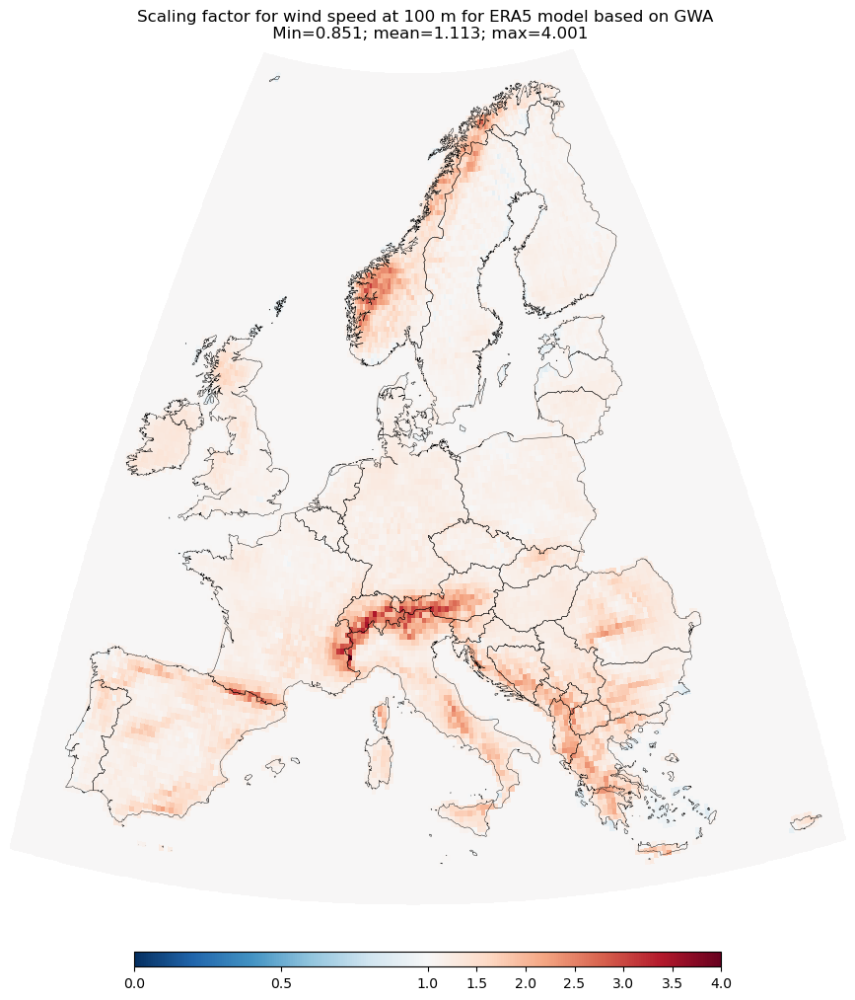

In [121]:
# Plotting correction factors from wind speed

data = 'wind'     # PV or wind

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')

CMIP6_model = CMIP6_model.replace("-", "_")
corr_factor_filename = f'Corr_factors_wind_ERA5'

# Setting correction factors outside area of interest to 1: 
locals()[corr_factor_filename] = locals()[corr_factor_filename].where(locals()[corr_factor_filename] > 0, 1);

# min_val = 0.5
# max_val = 1.5
min_val = np.nanmin(locals()[corr_factor_filename])
max_val = np.nanmax(locals()[corr_factor_filename])
mean_val = np.nanmean(locals()[corr_factor_filename])
max_val_abs = max_val-1
min_val_abs = 1-min_val;
if max_val_abs > min_val_abs:
    if max_val >= 2:
        z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
        norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=max_val);
    else:
        z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
        norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min())); 
else: 
    z = np.linspace(min_val,1+(1-min_val),50*50).reshape(50,50);
    norm = TwoSlopeNorm(vmin=min_val, vcenter=1, vmax=1+(1-z.min()));

im = Corr_factors_wind_ERA5.plot(ax=ax,transform=plate(),cmap="RdBu_r",#cbar_kwargs={'colorbar': False},
                  norm=norm);
cb = im.colorbar.remove();
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False);
fig.colorbar(im, ax=ax, location='bottom', fraction=.1,shrink=0.6,aspect=40,norm=norm,cmap="RdBu_r")
fig.suptitle(f'Scaling factor for wind speed at 100 m for ERA5 model based on GWA \n Min={round(min_val,3)}; mean={round(mean_val,3)}; max={round(max_val,3)}');

# Saving figure to file: 
plot_filename = f'Scaling factor for wind speed at 100 m for ERA5 model based on GWA.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

In [122]:
# Creating or loading CF time series for ERA5 based on GWA-corrected wind:

overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/'

for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    if cutout_name in locals():
        name_2 = f'GWA_corrected_Wind_ERA5_{i}_total'

        filename_2 = f'{name_2}.nc'
        path_2 = f'{output_folder_path}{filename_2}'
        if not Path(path_2).is_file() or overwrite == 1: 
            print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
            locals()[cutout_name].data['wnd100m'] = (locals()[cutout_name].data['wnd100m']*Corr_factors_wind_ERA5)
            locals()[name_2] = locals()[cutout_name].wind(turbine=turbine,layout=layout_wind_era5,per_unit=True)

            # Saving to file
            locals()[name_2].to_netcdf(path=path_2)
        else: 
            locals()[name_2] = xr.open_dataarray(path_2)
            print(f'"{filename_2}" already exists in "{output_folder_path}". The file was successfully imported. ')
    else: 
        print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

"GWA_corrected_Wind_ERA5_15_total.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_Wind_ERA5_16_total.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_Wind_ERA5_17_total.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_Wind_ERA5_18_total.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_Wind_ERA5_19_total.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_Wind_ERA5_20_total.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_Wind_ERA5_21_total.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". T

In [123]:
# Combining annual timeseries files into one: 
overwrite = 0;
output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/'
final_name = f'GWA_corrected_Wind_ERA5_BOC_total'
path = f'{output_folder_path}{final_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Creating "{final_name}" and saving it to {output_folder_path}. ')
    locals()[final_name] = xr.concat([GWA_corrected_Wind_ERA5_15_total,
                                               GWA_corrected_Wind_ERA5_16_total,
                                               GWA_corrected_Wind_ERA5_17_total,
                                               GWA_corrected_Wind_ERA5_18_total,
                                               GWA_corrected_Wind_ERA5_19_total,
                                               GWA_corrected_Wind_ERA5_20_total,
                                               GWA_corrected_Wind_ERA5_21_total,
                                               GWA_corrected_Wind_ERA5_22_total],dim="time")
    locals()[final_name].to_netcdf(path=path)
else:
    locals()[final_name] = xr.open_dataarray(path)
    print(f'"{final_name}" already exists in "{output_folder_path}". The file was successfully imported. ')

"GWA_corrected_Wind_ERA5_BOC_total" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 


## Calculating ERA5 CF per cell for BOC

In [124]:
# Creating or loading CF time series per cell for ERA5 based on GWA-corrected wind:

overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/'

for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    if cutout_name in locals():
        name_2 = f'GWA_corrected_wind_CF_per_cell_ERA5_{i}'

        filename_2 = f'{name_2}.nc'
        path_2 = f'{output_folder_path}{filename_2}'
        if not Path(path_2).is_file() or overwrite == 1: 
            print(f'Creating "{filename_2}" from {cutout_name} cutout. ')
            locals()[cutout_name].data['wnd100m'] = (locals()[cutout_name].data['wnd100m']*Corr_factors_wind_ERA5)
            locals()[name_2] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True,capacity_factor_timeseries=True)

            # Saving to file
            locals()[name_2].to_netcdf(path=path_2)
            
        else: 
            locals()[name_2] = xr.open_dataarray(path_2)
            print(f'"{filename_2}" already exists in "{output_folder_path}". The file was successfully imported. ')
    else: 
        print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

# Combining into a single file
final_name = f'GWA_corrected_wind_CF_per_cell_ERA5_BOC'
path = f'{output_folder_path}{final_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Creating "{final_name}" and saving it to {output_folder_path}. ')
    locals()[final_name] = xr.concat([GWA_corrected_wind_CF_per_cell_ERA5_15,
                                            GWA_corrected_wind_CF_per_cell_ERA5_16,
                                            GWA_corrected_wind_CF_per_cell_ERA5_17,
                                            GWA_corrected_wind_CF_per_cell_ERA5_18,
                                            GWA_corrected_wind_CF_per_cell_ERA5_19,
                                            GWA_corrected_wind_CF_per_cell_ERA5_20,
                                            GWA_corrected_wind_CF_per_cell_ERA5_21,
                                            GWA_corrected_wind_CF_per_cell_ERA5_22],dim="time")
    locals()[final_name].to_netcdf(path=path)
else:
    locals()[final_name] = xr.open_dataarray(path)
    print(f'"{final_name}" already exists in "{output_folder_path}". The file was successfully imported. ')

"GWA_corrected_wind_CF_per_cell_ERA5_15.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_16.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_17.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_18.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 


"GWA_corrected_wind_CF_per_cell_ERA5_19.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_20.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_21.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_22.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_BOC" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 


In [125]:
# Resampling yearly wind CF to coarse resolution:
for i in range(15,23):
    cutout_name = f'GWA_corrected_wind_CF_per_cell_ERA5_{i}'
    if cutout_name in locals():
        name_2 = f'GWA_corrected_wind_CF_per_cell_ERA5_{i}_coarse'

        filename_2 = f'{name_2}.nc'
        path_2 = f'{output_folder_path}{filename_2}'
        if not Path(path_2).is_file() or overwrite == 1: 
            print(f'Creating "{filename_2}" by resampling from {cutout_name}. ')
            locals()[name_2] = atlite.gis.regrid(locals()[cutout_name],Europe_EC_Earth3_ssp585_15_22.data.x, Europe_EC_Earth3_ssp585_15_22.data.y,resampling=rasterio.warp.Resampling.average,GDAL_MAX_BAND_COUNT=170128)

            # Saving to file
            locals()[name_2].to_netcdf(path=path_2)
        else: 
            locals()[name_2] = xr.open_dataarray(path_2)
            print(f'"{filename_2}" already exists in "{output_folder_path}". The file was successfully imported. ')
    else: 
        print(f'Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

# Combining into a single file
final_name = f'GWA_corrected_wind_CF_per_cell_ERA5_BOC_coarse'
path = f'{output_folder_path}{final_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Creating "{final_name}" and saving it to {output_folder_path}. ')
    locals()[final_name] = xr.concat([GWA_corrected_wind_CF_per_cell_ERA5_15_coarse,
                                            GWA_corrected_wind_CF_per_cell_ERA5_16_coarse,
                                            GWA_corrected_wind_CF_per_cell_ERA5_17_coarse,
                                            GWA_corrected_wind_CF_per_cell_ERA5_18_coarse,
                                            GWA_corrected_wind_CF_per_cell_ERA5_19_coarse,
                                            GWA_corrected_wind_CF_per_cell_ERA5_20_coarse,
                                            GWA_corrected_wind_CF_per_cell_ERA5_21_coarse,
                                            GWA_corrected_wind_CF_per_cell_ERA5_22_coarse],dim="time")
    locals()[final_name].to_netcdf(path=path)
else:
    locals()[final_name] = xr.open_dataarray(path)
    print(f'"{final_name}" already exists in "{output_folder_path}". The file was successfully imported. ')

"GWA_corrected_wind_CF_per_cell_ERA5_15_coarse.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_16_coarse.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_17_coarse.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_18_coarse.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_19_coarse.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ERA5_20_coarse.nc" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 
"GWA_corrected_wind_CF_per_cell_ER

In [126]:
# # Resampling final CF into coarse grid:
# final_name = f'GWA_corrected_wind_CF_per_cell_ERA5_BOC_coarse'
# path = f'{output_folder_path}{final_name}.nc'
# if not Path(path).is_file() or overwrite == 1: 
#     print(f'Creating "{final_name}" and saving it to {output_folder_path}. ')
#     locals()[final_name] = atlite.gis.regrid(GWA_corrected_wind_CF_per_cell_ERA5_BOC,Europe_EC_Earth3_ssp585_15_22.data.x, Europe_EC_Earth3_ssp585_15_22.data.y,resampling=rasterio.warp.Resampling.average,GDAL_MAX_BAND_COUNT=170128)
#     locals()[final_name].to_netcdf(path=path)
# else:
#     locals()[final_name] = xr.open_dataarray(path)
#     print(f'"{final_name}" already exists in "{output_folder_path}". The file was successfully imported. ')

In [127]:
GWA_corrected_Wind_ERA5_BOC_total_mean = GWA_corrected_Wind_ERA5_BOC_total.mean(dim=["time"],keep_attrs=True)

output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/'
final_name = f'GWA_corrected_Wind_ERA5_BOC_total_mean'
path = f'{output_folder_path}{final_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Creating "{final_name}" and saving it to {output_folder_path}. ')
    GWA_corrected_Wind_ERA5_BOC_total_mean.to_netcdf(path=path)
else:
    locals()[final_name] = xr.open_dataarray(path)
    print(f'"{final_name}" already exists in "{output_folder_path}". The file was successfully imported. ')

"GWA_corrected_Wind_ERA5_BOC_total_mean" already exists in "E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/". The file was successfully imported. 


In [128]:
# Calculating wind speed at 90m for GWA-corrected ERA5 (as a timeseries for every cutout)

corr_factor_filename = f'Corr_factors_wind_ERA5'
# Setting correction factors outside area of interest to 1: 
locals()[corr_factor_filename] = locals()[corr_factor_filename].where(locals()[corr_factor_filename] > 0, 1);

for i in range(15,23):
    cutout_name = f'Europe_ERA5_{i}'
    # Calculating wind speed at hub height: 
    from_height = 100;
    from_name = "wnd{h:0d}m".format(h=int(from_height));
    to_height = atlite.resource.get_windturbineconfig(turbine)['hub_height'];       # 90 m in current config
    to_name = "wnd{h:0d}m".format(h=int(to_height));
    to_cutout_name = f'GWA_corrected_{cutout_name}_{to_name}'
    locals()[cutout_name].data['wnd100m'] = locals()[cutout_name].data['wnd100m']*locals()[corr_factor_filename]        # Correcting ERA5 wind100m using GWA 
    ds = locals()[cutout_name].data

    locals()[to_cutout_name] = ds[from_name] * (
                np.log(to_height / ds["roughness"]) / np.log(from_height / ds["roughness"])
            )
    locals()[to_cutout_name].attrs.update({"long name": "Extrapolated {ht} m wind speed using logarithmic "
                        "method with roughness and {hf} m wind speed"
                        "".format(ht=to_height, hf=from_height),
                        "units": "m s**-1"})
    

# Calculating average wind speed for each cell for 8 years from ERA5:
cutout_name = f'GWA_corrected_Europe_ERA5_15_wnd90m'
GWA_corrected_ERA5_wnd90m = xr.DataArray(locals()[cutout_name])
for i in range(16,23):
    cutout_name = f'GWA_corrected_Europe_ERA5_{i}_wnd90m'
    GWA_corrected_ERA5_wnd90m = xr.concat([GWA_corrected_ERA5_wnd90m,locals()[cutout_name]],dim="time")
GWA_corrected_ERA5_wnd90m_mean = GWA_corrected_ERA5_wnd90m.mean(dim=["time"],keep_attrs=True)

GWA_corrected_ERA5_wnd90m_coarse = atlite.gis.regrid(GWA_corrected_ERA5_wnd90m,Europe_EC_Earth3_ssp585_15_22.data.x, Europe_EC_Earth3_ssp585_15_22.data.y,resampling=rasterio.warp.Resampling.average)
GWA_corrected_ERA5_wnd90m_coarse_mean = GWA_corrected_ERA5_wnd90m_coarse.mean(dim=["time"],keep_attrs=True)

# Saving to file: 
name = f'GWA_corrected_ERA5_wnd90m_coarse_mean'
path = f'E://Cutouts/Corrected ERA5/{name}.nc'
if not Path(path).is_file() or overwrite == 1:
    locals()[name].load()
    locals()[name].to_netcdf(path=path)
else:
    locals()[name] = xr.open_dataarray(path)
    print(f'{name} loaded from saved file.')

GWA_corrected_ERA5_wnd90m_coarse_mean loaded from saved file.


In [129]:
# Calculating correction factors based on GWA-corrected ERA5 (for wind only): 

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind: 
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_mean'
    corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}'
    locals()[corr_factor_filename] = ((GWA_corrected_ERA5_wnd90m_coarse_mean*indicator_matrix_EC_Earth3) / (locals()[mean_da_name]*indicator_matrix_EC_Earth3))

# Calculating corrections for EC-Earth3 with wnd100m:
CMIP6_model = 'EC-Earth3'
CMIP6_model = CMIP6_model.replace("-", "_")
# Wind: 
mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_power_law_mean'
corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}_power_law'
locals()[corr_factor_filename] = ((GWA_corrected_ERA5_wnd90m_coarse_mean*indicator_matrix_EC_Earth3) / (locals()[mean_da_name]*indicator_matrix_EC_Earth3))
Corrected_ERA5_Corr_factors_wind_EC_Earth3_power_law_no_indicator_matrix = (GWA_corrected_ERA5_wnd90m_coarse_mean) / (locals()[mean_da_name])

In [130]:
# Loading correction factors based on GWA-corrected ERA5 and saving them to nc files
overwrite = 0;

for CMIP6_model in CMIP6_models_wind: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind: 
    name = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}'
    path = f'E://Cutouts/CMIP6_BOC/GWA Correction factors/Wind/{name}.nc'
    if not Path(path).is_file() or overwrite == 1:
        print(f'Loading {name}')
        locals()[name].load()
        locals()[name].to_netcdf(path=path)
    else:   # Loading the correction factor files from pre-saved files
        locals()[name] = xr.open_dataarray(path)
        print(f'{name} loaded from saved file.')

# Loading corrections for EC-Earth3 with wnd100m:
CMIP6_model = 'EC-Earth3'
CMIP6_model = CMIP6_model.replace("-", "_")
# Wind: 
name = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}_power_law'
path = f'E://Cutouts/CMIP6_BOC/GWA Correction factors/Wind/{name}.nc'
if not Path(path).is_file() or overwrite == 1:
    print(f'Loading {name}')
    locals()[name].load()
    locals()[name].to_netcdf(path=path)
else:   # Loading the correction factor files from pre-saved files
    locals()[name] = xr.open_dataarray(path)
    print(f'{name} loaded from saved file.')

# Loading Corrected_ERA5_Corr_factors_wind_EC_Earth3_power_law_no_indicator_matrix: 
name_2 = f'Corrected_ERA5_Corr_factors_wind_EC_Earth3_power_law_no_indicator_matrix'
path_2 = f'E://Cutouts/CMIP6_BOC/GWA Correction factors/Wind/{name_2}.nc'
if not Path(path_2).is_file() or overwrite == 1:
    print(f'Loading {name_2}')
    locals()[name_2].load()
    locals()[name_2].to_netcdf(path=path_2)
else:   # Loading the correction factor files from pre-saved files
    locals()[name_2] = xr.open_dataarray(path_2)
    print(f'{name_2} loaded from saved file.')

Corrected_ERA5_Corr_factors_wind_EC_Earth3 loaded from saved file.
Corrected_ERA5_Corr_factors_wind_MPI_ESM1_2_HR loaded from saved file.
Corrected_ERA5_Corr_factors_wind_MIROC6 loaded from saved file.
Corrected_ERA5_Corr_factors_wind_MPI_ESM1_2_LR loaded from saved file.


Corrected_ERA5_Corr_factors_wind_HadGEM3_GC31_LL loaded from saved file.
Corrected_ERA5_Corr_factors_wind_HadGEM3_GC31_MM loaded from saved file.
Corrected_ERA5_Corr_factors_wind_IPSL_CM6A_LR loaded from saved file.
Corrected_ERA5_Corr_factors_wind_AWI_CM_1_1_MR loaded from saved file.
Corrected_ERA5_Corr_factors_wind_EC_Earth3_Veg loaded from saved file.
Corrected_ERA5_Corr_factors_wind_EC_Earth3_power_law loaded from saved file.
Corrected_ERA5_Corr_factors_wind_EC_Earth3_power_law_no_indicator_matrix loaded from saved file.


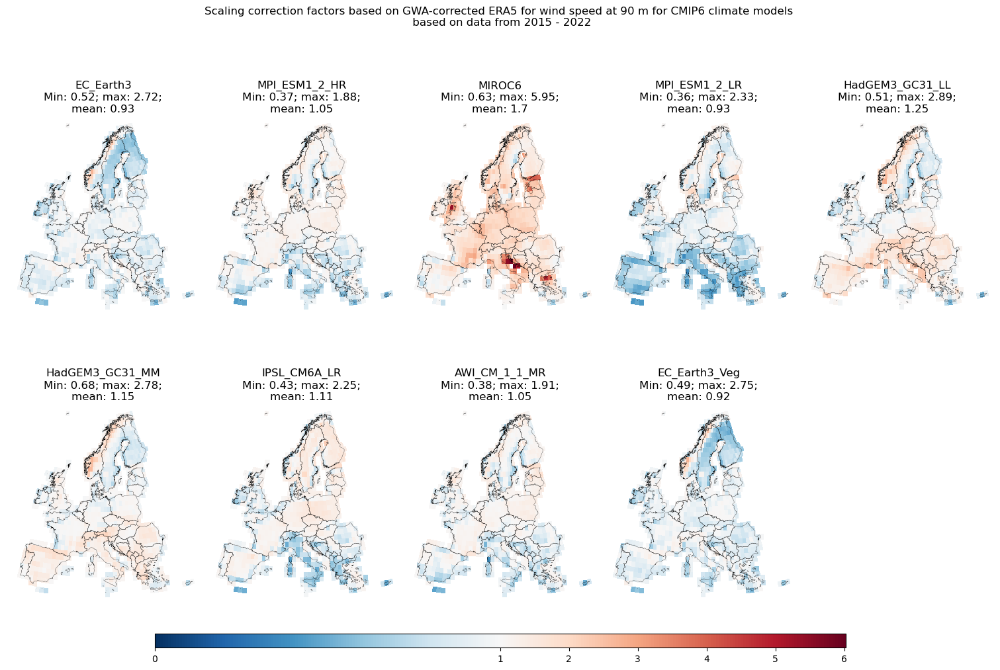

In [131]:
# Plotting Corrected_ERA5_Corr_factors_wind_{CMIP6_model} 

fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10),layout='constrained')

data = 'wind';

if data == 'PV': 
    min_val = 0.8;
    max_val = 1.5;
else: 
    min_val = 0.18;
    max_val = 6.02;

nr_of_decimals = 2
# Finding global absolute max for common colorbar: 
abs_max_global = 0
for CMIP6_model in CMIP6_models_wind: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}'
    abs_max_local = np.nanmax(abs(locals()[corr_factor_filename]))
    if abs_max_local > abs_max_global: 
        abs_max_global = abs_max_local

i = 0; # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}'

    max_val_abs = max_val-1
    min_val_abs = 1-min_val;
    if max_val_abs > min_val_abs:
        if max_val >= 2:
            z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
            norm = TwoSlopeNorm(vmin=0, vcenter=1, vmax=max_val);
        else:
            z = np.linspace(max_val_abs,1, 50*50).reshape(50,50);
            norm = TwoSlopeNorm(vmin=z.min(), vcenter=1, vmax=1+(1-z.min())); 
    else: 
        z = np.linspace(min_val,1+(1-min_val),50*50).reshape(50,50);
        norm = TwoSlopeNorm(vmin=min_val, vcenter=1, vmax=1+(1-z.min()));
    
    im = locals()[corr_factor_filename].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                    norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)

    mean_val = np.ndarray.item(locals()[corr_factor_filename].mean().values);
    min_val_1 = np.ndarray.item(locals()[corr_factor_filename].min().values);
    max_val_1 = np.ndarray.item(locals()[corr_factor_filename].max().values);
    axs.flat[i].set_title(f'{CMIP6_model}\nMin: {round(min_val_1,nr_of_decimals)}; max: {round(max_val_1,nr_of_decimals)};\nmean: {round(mean_val,nr_of_decimals)}');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=50,norm=norm,cmap="RdBu_r")
fig.suptitle(f'Scaling correction factors based on GWA-corrected ERA5 for wind speed at 90 m for CMIP6 climate models \n based on data from 2015 - 2022');
fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'GWA corrected ERA5 correction of wnd90m per cell for all CMIP6 models.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

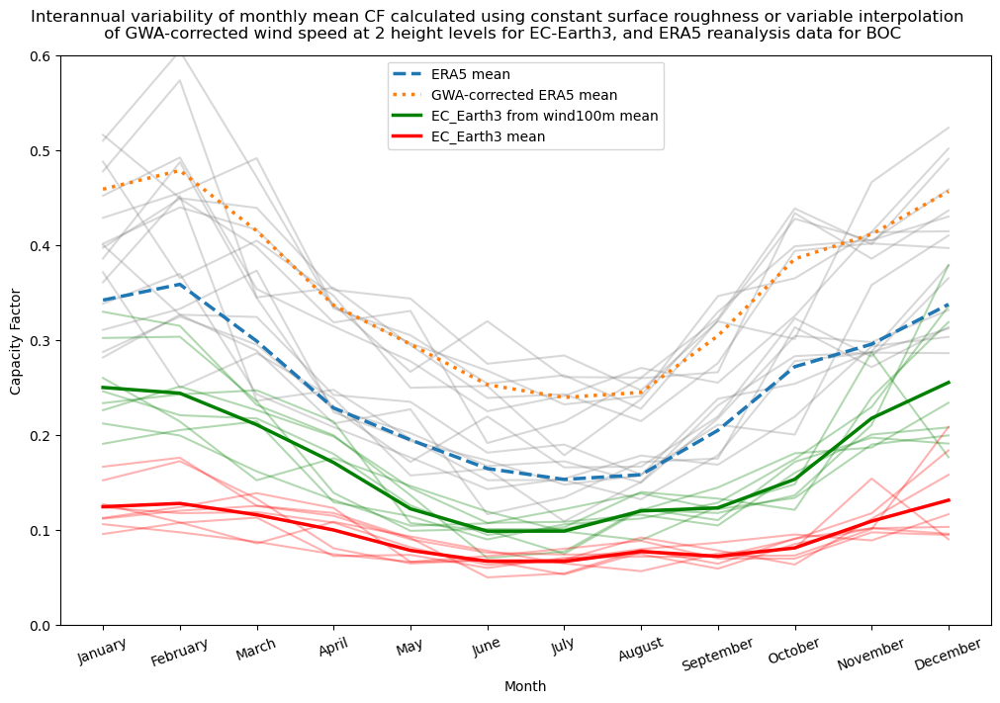

In [132]:
CMIP6_models_EC_Earth3 = ['EC-Earth3']

fig,ax = plt.subplots(figsize=(10,7),layout='constrained')
title = f'Interannual variability of monthly mean CF calculated using constant surface roughness or variable interpolation \n of GWA-corrected wind speed at 2 height levels for {CMIP6_models_EC_Earth3[0]}, and ERA5 reanalysis data for BOC'
fig.suptitle(title)

Monthly_mean = pd.DataFrame()

# ERA5 before correction
filename = f'Wind_ERA5_BOC_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, linestyle="--",legend=True,label=f'ERA5 mean')
Monthly_mean['ERA5'] = data_df['mean']
# ERA5 after GWA correction
filename = f'GWA_corrected_Wind_ERA5_BOC_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'GWA-corrected ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['GWA-corrected ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="GWA-corrected ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, linestyle=":",legend=True,label=f'GWA-corrected ERA5 mean')
Monthly_mean['ERA5'] = data_df['mean']
# EC-Earth3 CF from wind interpolation using wind100m:
CMIP6_model = 'EC_Earth3'
filename = f'GWA-corrected_Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
data_df.plot(ax=ax,color="green",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, color="green",legend=True,label=f'{CMIP6_model} from wind100m mean')
Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

for CMIP6_model in CMIP6_models_EC_Earth3:
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'GWA-corrected_Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    data_df.plot(ax=ax,color="red",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2.5, color="red",legend=True,label=f'{CMIP6_model} mean')
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Capacity Factor')
plt.ylim([0,0.6])

# Saving figure to file: 
plot_filename = f'Monthly mean wind CF ERA5 vs GWA-corrected EC_Earth3.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

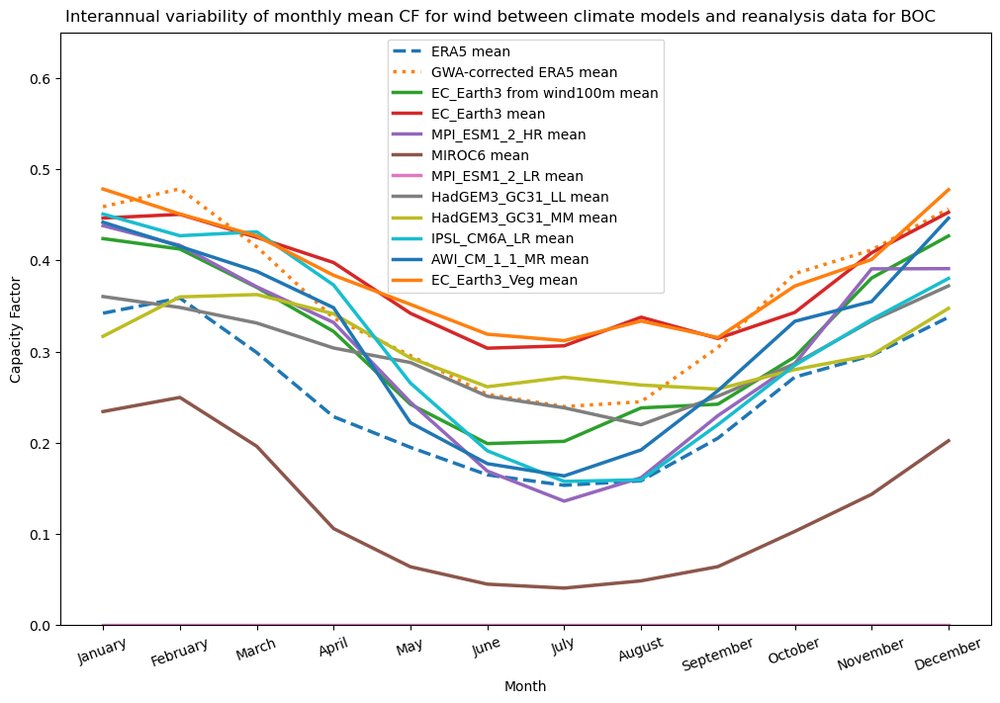

In [133]:
ssp_variant = 'ssp585'
fig,ax = plt.subplots(figsize=(10,7),layout='constrained')
title = f'Interannual variability of monthly mean CF for wind between climate models and reanalysis data for BOC'
fig.suptitle(title)
Monthly_mean = pd.DataFrame()

# ERA5
filename = f'Wind_ERA5_BOC_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, linestyle="--",legend=True,label=f'ERA5 mean')
Monthly_mean['ERA5'] = data_df['mean']

# ERA5 after GWA correction
filename = f'GWA_corrected_Wind_ERA5_BOC_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'GWA-corrected ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['GWA-corrected ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="GWA-corrected ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, linestyle=":",legend=True,label=f'GWA-corrected ERA5 mean')
Monthly_mean['ERA5'] = data_df['mean']

# EC-Earth3 CF from wind interpolation using wind100m:
CMIP6_model = 'EC_Earth3'
filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m_total'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'{CMIP6_model} from wind100m mean')
Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_total'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'{CMIP6_model} mean')
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Capacity Factor')
plt.ylim([0,0.65])

# Saving figure to file: 
plot_filename = title;
# plt.savefig(plot_path(plot_filename), dpi=300);

In [134]:
# Calculating corrected wind at 90 m and influx timeseries
overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind: 
    output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m'
    non_corr_da_name = f'{mean_da_name}_Europe_timeseries'
    path = f'{output_folder_path}{non_corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {non_corr_da_name}')
        locals()[non_corr_da_name] = locals()[mean_da_name].mean(dim=["x","y"],keep_attrs=True).load();
        locals()[non_corr_da_name].to_netcdf(path=path)
    else:
        locals()[non_corr_da_name] = xr.open_dataarray(path)
        print(f'"{non_corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')
    corr_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries_corrected'
    corr_factor_filename = f'Corr_factors_wind_{CMIP6_model}'
    
    path = f'{output_folder_path}{corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {corr_da_name}')
        locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name]).mean(dim=["x","y"]).load()
        locals()[corr_da_name].to_netcdf(path=path)
    else:
        locals()[corr_da_name] = xr.open_dataarray(path)
        print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # PV:
    output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/PV/'
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_influx'
    non_corr_da_name = f'{mean_da_name}_Europe_timeseries'
    path = f'{output_folder_path}{non_corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {non_corr_da_name}')
        locals()[non_corr_da_name] = locals()[mean_da_name].mean(dim=["x","y"],keep_attrs=True).load();
        locals()[non_corr_da_name].to_netcdf(path=path)
    else:
        locals()[non_corr_da_name] = xr.open_dataarray(path)
        print(f'"{non_corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')
    corr_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_influx_Europe_timeseries_corrected'
    corr_factor_filename = f'Corr_factors_PV_{CMIP6_model}'
    path = f'{output_folder_path}{corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {corr_da_name}')
        locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name]).mean(dim=["x","y"]).load()
        locals()[corr_da_name].to_netcdf(path=path)
    else:
        locals()[corr_da_name] = xr.open_dataarray(path)
        print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

"Europe_EC_Earth3_ssp585_15_22_wnd90m_Europe_timeseries.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_EC_Earth3_ssp585_15_22_wnd90m_Europe_timeseries_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_MPI_ESM1_2_HR_ssp585_15_22_wnd90m_Europe_timeseries.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_MPI_ESM1_2_HR_ssp585_15_22_wnd90m_Europe_timeseries_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_MIROC6_ssp585_15_22_wnd90m_Europe_timeseries.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_MIROC6_ssp585_15_22_wnd90m_Europe_timeseries_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated C

In [135]:
# Calculating corrected wind at 90 m based on GWA-corrected ERA5
overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind: 
    output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m'
    non_corr_da_name = f'{mean_da_name}_Europe_timeseries'
    path = f'{output_folder_path}{non_corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {non_corr_da_name}')
        locals()[non_corr_da_name] = locals()[mean_da_name].mean(dim=["x","y"],keep_attrs=True).load();
        locals()[non_corr_da_name].to_netcdf(path=path)
    else:
        locals()[non_corr_da_name] = xr.open_dataarray(path)
        print(f'"{non_corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')
    corr_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries_GWA_corrected'
    corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}'
    
    path = f'{output_folder_path}{corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {corr_da_name}')
        locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name]).mean(dim=["x","y"]).load()
        locals()[corr_da_name].to_netcdf(path=path)
    else:
        locals()[corr_da_name] = xr.open_dataarray(path)
        print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

"Europe_EC_Earth3_ssp585_15_22_wnd90m_Europe_timeseries.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_EC_Earth3_ssp585_15_22_wnd90m_Europe_timeseries_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_MPI_ESM1_2_HR_ssp585_15_22_wnd90m_Europe_timeseries.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_MPI_ESM1_2_HR_ssp585_15_22_wnd90m_Europe_timeseries_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_MIROC6_ssp585_15_22_wnd90m_Europe_timeseries.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_MIROC6_ssp585_15_22_wnd90m_Europe_timeseries_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/

In [136]:
# Calculating corrected wind at 90 m based on GWA-corrected ERA5 for EC-Earth3 with wnd100m

CMIP6_model = 'EC-Earth3'
CMIP6_model = CMIP6_model.replace("-", "_")
# Wind: 
output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'
mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_power_law'
non_corr_da_name = f'{mean_da_name}_Europe_timeseries'
path = f'{output_folder_path}{non_corr_da_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Loading {non_corr_da_name}')
    locals()[non_corr_da_name] = locals()[mean_da_name].mean(dim=["x","y"],keep_attrs=True).load();
    locals()[non_corr_da_name].to_netcdf(path=path)
else:
    locals()[non_corr_da_name] = xr.open_dataarray(path)
    print(f'"{non_corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')
corr_da_name = f'{non_corr_da_name}_GWA_corrected'
corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}_power_law'

path = f'{output_folder_path}{corr_da_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Loading {corr_da_name}')
    locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name]).mean(dim=["x","y"]).load()
    locals()[corr_da_name].to_netcdf(path=path)
else:
    locals()[corr_da_name] = xr.open_dataarray(path)
    print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

"Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_Europe_timeseries.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 
"Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_Europe_timeseries_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/". The file was successfully imported. 


In [137]:
# Loading ERA5 timeseries
overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries

output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/'
path = f'{output_folder_path}ERA5_wnd90m_coarse_timeseries.nc'
if not Path(path).is_file() or overwrite == 1: 
    ERA5_wnd90m_coarse_timeseries = ERA5_wnd90m_coarse.mean(dim=["x","y"],keep_attrs=True)
    ERA5_wnd90m_coarse_timeseries.load()
    ERA5_wnd90m_coarse_timeseries.to_netcdf(path=path)
else: 
    ERA5_wnd90m_coarse_timeseries = xr.open_dataarray(path)

In [138]:
# Loading GWA-corrected ERA5 timeseries
overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries

output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/Wind/'
path = f'{output_folder_path}GWA_corrected_ERA5_wnd90m_coarse_timeseries.nc'
if not Path(path).is_file() or overwrite == 1: 
    GWA_corrected_ERA5_wnd90m_coarse_timeseries = GWA_corrected_ERA5_wnd90m_coarse.mean(dim=["x","y"],keep_attrs=True)
    GWA_corrected_ERA5_wnd90m_coarse_timeseries.load()
    GWA_corrected_ERA5_wnd90m_coarse_timeseries.to_netcdf(path=path)
else: 
    GWA_corrected_ERA5_wnd90m_coarse_timeseries = xr.open_dataarray(path)

In [139]:
output_folder_path = f'E://Cutouts/Aggregated CF timeseries/ERA5 BOC/PV/'
path = f'{output_folder_path}ERA5_influx_coarse_timeseries.nc'
if not Path(path).is_file() or overwrite == 1: 
    ERA5_influx_coarse_timeseries = ERA5_influx_coarse.mean(dim=["x","y"],keep_attrs=True)
    ERA5_influx_coarse_timeseries.load()
    ERA5_influx_coarse_timeseries.to_netcdf(path=path)
else: 
    ERA5_influx_coarse_timeseries = xr.open_dataarray(path)

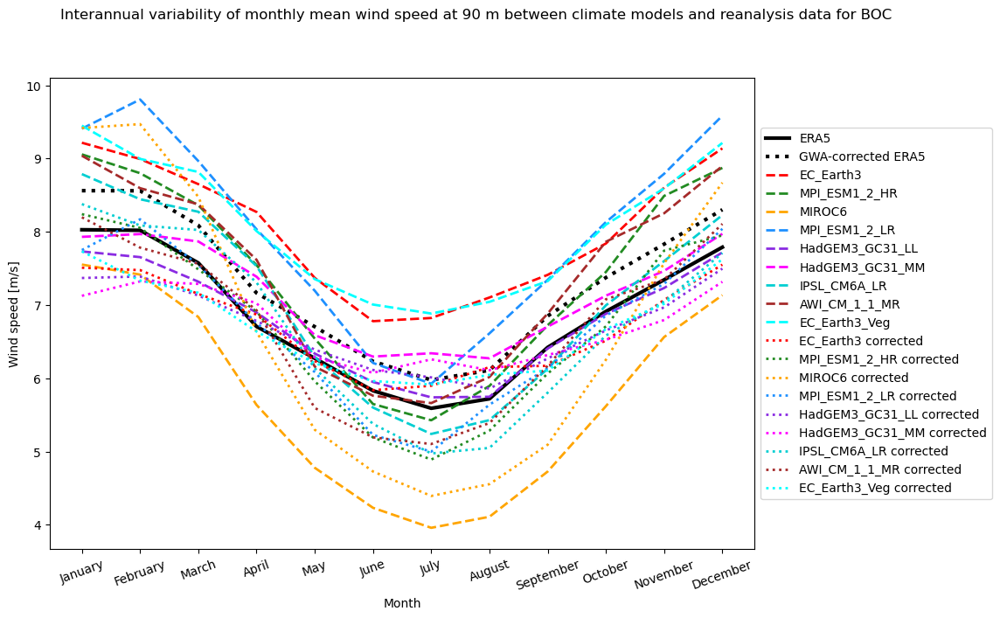

In [140]:
ssp_variant = 'ssp585'
fig,ax = plt.subplots(figsize=(13,7),layout='constrained')
title = f'Interannual variability of monthly mean wind speed at 90 m between climate models and reanalysis data for BOC'
fig.suptitle(title)
Monthly_mean = pd.DataFrame()

# ERA5
filename = f'ERA5_wnd90m_coarse_timeseries'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=3,legend=True,label=f'ERA5', color='black')
Monthly_mean['ERA5'] = data_df['mean']

# ERA5 after GWA correction
filename = f'GWA_corrected_ERA5_wnd90m_coarse_timeseries'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'GWA-corrected ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['GWA-corrected ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="GWA-corrected ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=3, linestyle=":",legend=True,label=f'GWA-corrected ERA5', color='black')
Monthly_mean['ERA5'] = data_df['mean']

# # EC-Earth3 CF from wind interpolation using wind100m:
# CMIP6_model = 'EC_Earth3'
# filename = f'Wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}_wind_100m_total'
# data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
# data_df = pd.DataFrame(data);
# data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
# data_df['Month'] = data.index.month
# data_df.set_index('Month',inplace=True)
# for i in range(0,9):
#     year = 2014+i;
#     data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
# data_df.drop(columns="CMIP6 data",inplace=True)
# data_df = data_df.iloc[0:12]
# # data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
# data_df = data_df.assign(mean=data_df.mean(axis=1))
# data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'{CMIP6_model} from wind100m mean')
# Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

# Not corrected:
for CMIP6_model in CMIP6_models_wind:
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle="--",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, linestyle="--", legend=True, label=f'{CMIP6_model}',color=plotcolor)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

# Corrected:
for CMIP6_model in CMIP6_models_wind:
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries_GWA_corrected'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle=":",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, legend=True,linestyle=":", label=f'{CMIP6_model} corrected',color=plotcolor)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']
    
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Wind speed [m/s]')
# plt.ylim([0,10])
# Shrink current axis by 20%
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Saving figure to file: 
plot_filename = title;
# plt.savefig(plot_path(plot_filename), dpi=300);

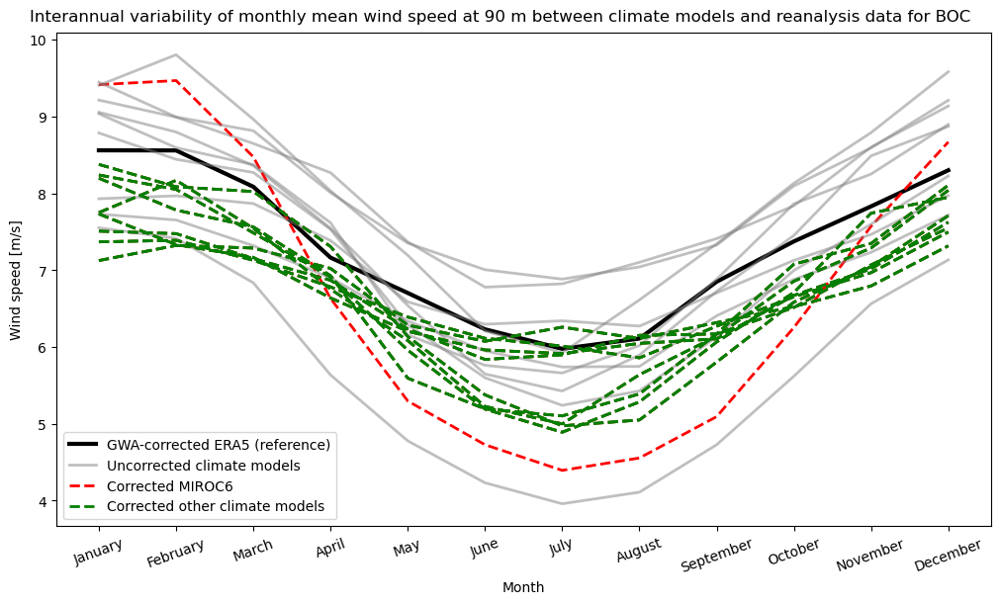

In [141]:
ssp_variant = 'ssp585'
fig,ax = plt.subplots(figsize=(10,6),layout='constrained')
title = f'Interannual variability of monthly mean wind speed at 90 m between climate models and reanalysis data for BOC'
fig.suptitle(title)
Monthly_mean = pd.DataFrame()
color_uncorrected = 'grey'
color_corrected_miroc6 = 'red'
color_corrected = 'green'

# ERA5 after GWA correction
filename = f'GWA_corrected_ERA5_wnd90m_coarse_timeseries'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'GWA-corrected ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['GWA-corrected ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="GWA-corrected ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=3,legend=True,label=f'GWA-corrected ERA5', color='black')
Monthly_mean['ERA5'] = data_df['mean']

# Not corrected:
for CMIP6_model in CMIP6_models_wind:
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle="--",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, legend=True, label=f'{CMIP6_model}',color=color_uncorrected,alpha=0.5)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

# Corrected MIROC6:
# for CMIP6_model in CMIP6_models_wind:
    # plotcolor = model_colors.loc[CMIP6_model]['Color']
    # CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries_GWA_corrected'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle=":",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, legend=False,linestyle="--", label=f'{CMIP6_model} corrected',color=color_corrected_miroc6)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

# Corrected:
# for CMIP6_model in CMIP6_models_wind:
    # plotcolor = model_colors.loc[CMIP6_model]['Color']
    # CMIP6_model = CMIP6_model.replace("-", "_")
    if not CMIP6_model == 'MIROC6':
        filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries_GWA_corrected'
        data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
        data_df = pd.DataFrame(data);
        data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
        data_df['Month'] = data.index.month
        data_df.set_index('Month',inplace=True)
        for i in range(0,9):
            year = 2014+i;
            data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
        data_df.drop(columns="CMIP6 data",inplace=True)
        data_df = data_df.iloc[0:12]
        # data_df.plot(ax=ax,color="grey",linestyle=":",alpha=0.3,legend=False)
        data_df = data_df.assign(mean=data_df.mean(axis=1))
        data_df['mean'].plot(ax=ax,linewidth=2, legend=False,linestyle="--", label=f'{CMIP6_model} corrected',color=color_corrected)
        Monthly_mean[f'{CMIP6_model}'] = data_df['mean']
plt.legend(['GWA-corrected ERA5 (reference)', 'Uncorrected climate models','Corrected MIROC6','Corrected other climate models'])

# Corrected:
for CMIP6_model in CMIP6_models_wind_selection:
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries_GWA_corrected'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle=":",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, legend=False,linestyle="--",color=color_corrected)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Wind speed [m/s]')
# plt.ylim([0,10])

# Saving figure to file: 
plot_filename = f'{title}_simplified_MIROC6.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

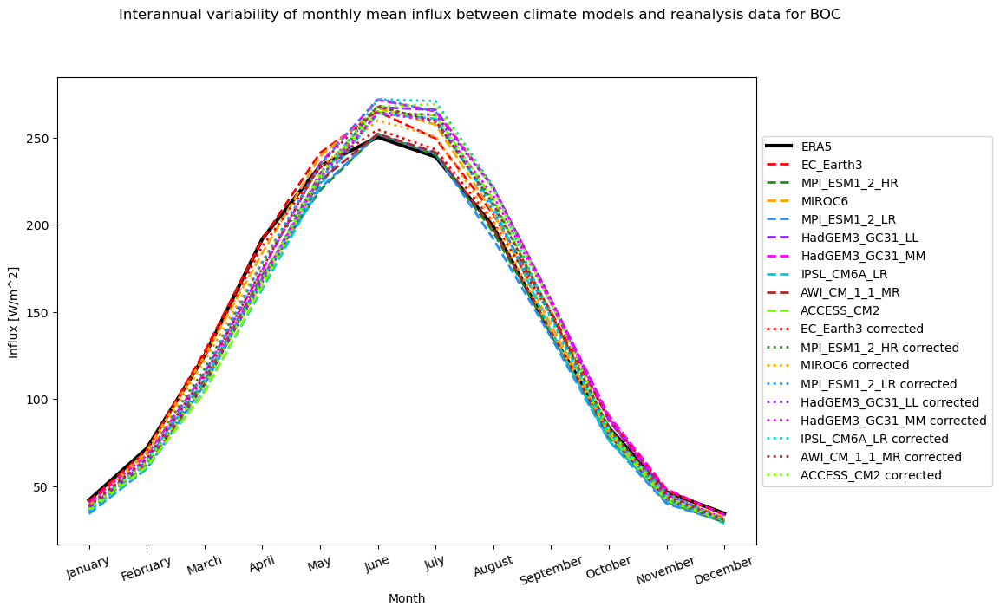

In [142]:
ssp_variant = 'ssp585'
fig,ax = plt.subplots(figsize=(13,7),layout='constrained')
title = f'Interannual variability of monthly mean influx between climate models and reanalysis data for BOC'
fig.suptitle(title)
Monthly_mean = pd.DataFrame()

# ERA5
filename = f'ERA5_influx_coarse_timeseries'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=3,legend=True,label=f'ERA5', color='black')
Monthly_mean['ERA5'] = data_df['mean']

# Not corrected:
for CMIP6_model in CMIP6_models_solar:
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_influx_Europe_timeseries'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={'influx':'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle="--",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, linestyle="--", legend=True, label=f'{CMIP6_model}',color=plotcolor)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

# Corrected:
for CMIP6_model in CMIP6_models_solar:
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_influx_Europe_timeseries_corrected'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle=":",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, legend=True,linestyle=":", label=f'{CMIP6_model} corrected',color=plotcolor)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Influx [W/m^2]')
# plt.ylim([0,0.65])
# Shrink current axis by 20%
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Saving figure to file: 
plot_filename = title;
# plt.savefig(plot_path(plot_filename), dpi=300);

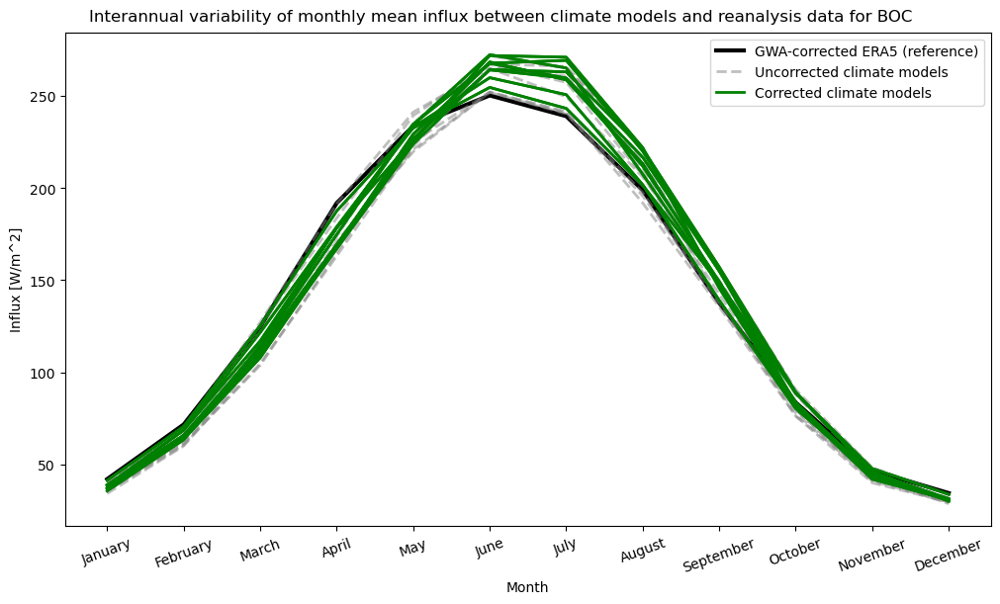

In [143]:
ssp_variant = 'ssp585'
fig,ax = plt.subplots(figsize=(10,6),layout='constrained')
title = f'Interannual variability of monthly mean influx between climate models and reanalysis data for BOC'
fig.suptitle(title)
Monthly_mean = pd.DataFrame()
color_uncorrected = 'grey'
color_corrected = 'green'

# ERA5
filename = f'ERA5_influx_coarse_timeseries'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=3,legend=False,label=f'ERA5 (reference)', color='black')
Monthly_mean['ERA5'] = data_df['mean']

# Not corrected:
for CMIP6_model in CMIP6_models_solar:
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_influx_Europe_timeseries'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={'influx':'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle="--",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, linestyle="--",legend=False, label=f'Uncorrected climate models',color=color_uncorrected, alpha=0.5)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

# Corrected:
# for CMIP6_model in CMIP6_models_solar:
    # plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_influx_Europe_timeseries_corrected'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle=":",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, legend=False, label=f'Corrected climate models',color=color_corrected)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']
plt.ylabel('Influx [W/m^2]')
# plt.ylim([0,0.65])
plt.legend(['GWA-corrected ERA5 (reference)', 'Uncorrected climate models','Corrected climate models'])

# Corrected (again, to be on top):
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_influx_Europe_timeseries_corrected'
    data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",linestyle=":",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=ax,linewidth=2, legend=False, label=f'Corrected climate models',color=color_corrected)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
# Saving figure to file: 
plot_filename = f'{title}_simplified.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

## Seasonal analysis for EC-Earth3 with wnd100m

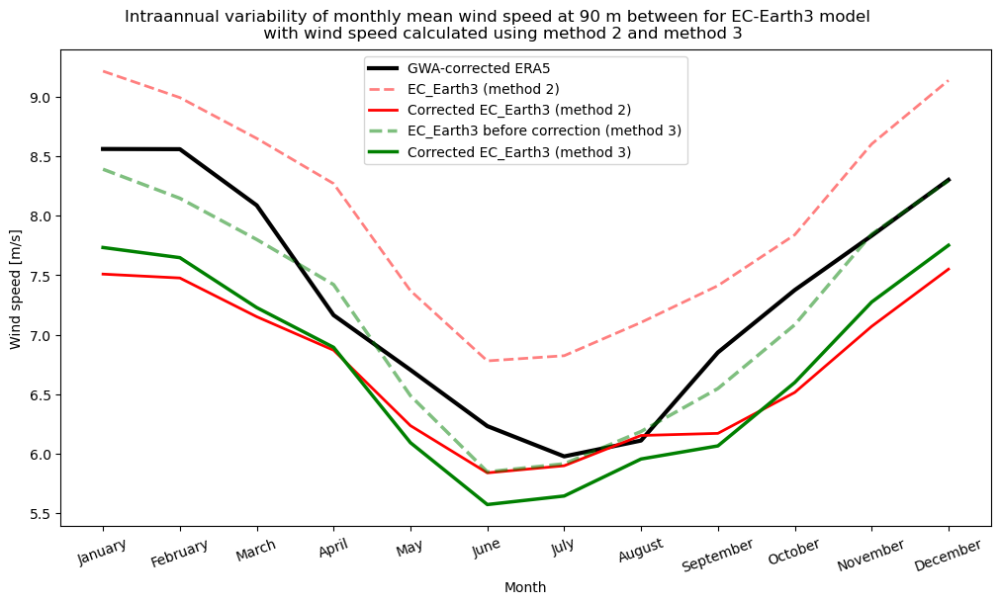

In [144]:
ssp_variant = 'ssp585'
fig,ax = plt.subplots(figsize=(10,6),layout='constrained')
title = f'Intraannual variability of monthly mean wind speed at 90 m between for EC-Earth3 model \n with wind speed calculated using method 2 and method 3'
fig.suptitle(title)
Monthly_mean = pd.DataFrame()

# # ERA5 before GWA correction
# filename = f'ERA5_wnd90m_coarse_timeseries'
# data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
# data_df = pd.DataFrame(data);
# data_df.rename(columns ={0:'ERA5 data'},inplace=True);
# data_df['Month'] = data.index.month
# data_df.set_index('Month',inplace=True)
# for i in range(0,9):
#     year = 2014+i;
#     data_df[f'ERA5 {year}'] = data_df['ERA5 data'].iloc[12*i+0:12*i+12]
# data_df.drop(columns="ERA5 data",inplace=True)
# data_df = data_df.iloc[0:12]
# # data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
# data_df = data_df.assign(mean=data_df.mean(axis=1))
# data_df['mean'].plot(ax=ax,linewidth=3,linestyle="--",legend=True,label=f'ERA5', color='black',alpha=0.5)
# Monthly_mean['ERA5'] = data_df['mean']

# ERA5 after GWA correction
filename = f'GWA_corrected_ERA5_wnd90m_coarse_timeseries'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'GWA-corrected ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['GWA-corrected ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="GWA-corrected ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=3,legend=True,label=f'GWA-corrected ERA5', color='black')
Monthly_mean['ERA5'] = data_df['mean']

# Not corrected:
CMIP6_model = 'EC-Earth3'
plotcolor = model_colors.loc[CMIP6_model]['Color']
CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",linestyle="--",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2, linestyle="--", legend=True, label=f'{CMIP6_model} (method 2)',color=plotcolor,alpha=0.5)
Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

# Corrected:
CMIP6_model = 'EC-Earth3'
plotcolor = model_colors.loc[CMIP6_model]['Color']
CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_Europe_timeseries_GWA_corrected'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",linestyle=":",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2, legend=True, label=f'Corrected {CMIP6_model} (method 2)',color=plotcolor)
Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

# EC-Earth3 CF from wind interpolation using wind100m before correction:
CMIP6_model = 'EC_Earth3'
filename = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_Europe_timeseries'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, linestyle="--",legend=True,label=f'{CMIP6_model} before correction (method 3)',color='green',alpha=0.5)
Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

# EC-Earth3 CF from wind interpolation using wind100m after correction:
CMIP6_model = 'EC_Earth3'
filename = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_Europe_timeseries_GWA_corrected'
data = locals()[filename].squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'Corrected {CMIP6_model} (method 3)', color='green')
Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Wind speed [m/s]')
# plt.ylim([0,10])

# Saving figure to file: 
plot_filename = 'Intraannual variability EC_Earth3 using constant roughness vs power law with seasonability';
# plt.savefig(plot_path(plot_filename), dpi=300);

## RMSE for every grid cell monthly values

In [145]:
# Calculating corrected wind at 90 m and influx timeseries
overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/CMIP6_BOC/'
output_folder_path_mean = f'E://Cutouts/CMIP6_BOC/Mean corrected wnd90m and influx per grid cell/'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind:
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m'
    corr_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_GWA_corrected'
    corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}'
    path = f'{output_folder_path}{corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {corr_da_name}')
        locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name]).load()
        locals()[corr_da_name].to_netcdf(path=path)
    else:
        locals()[corr_da_name] = xr.open_dataarray(path)
        locals()[corr_da_name] = locals()[corr_da_name].load()
        print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')
    
    # Calculating average wind speed for each cell for 30 years:
    cutout_mean_name = f'{corr_da_name}_mean'
    path = f'{output_folder_path_mean}{cutout_mean_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {cutout_mean_name}.')
        locals()[cutout_mean_name] = locals()[corr_da_name].mean(dim=["time"],keep_attrs=True).load()
        locals()[cutout_mean_name].to_netcdf(path=path)
    else:
        locals()[cutout_mean_name] = xr.open_dataarray(path)
        locals()[cutout_mean_name] = locals()[cutout_mean_name].load()
        print(f'"{cutout_mean_name}.nc" already exists in "{output_folder_path_mean}". The file was successfully imported. ')

for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # PV:
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_influx'
    path = f'{output_folder_path}{mean_da_name}.nc'
    # if not Path(path).is_file() or overwrite == 1: 
    #     print(f'Loading {mean_da_name}')
    #     locals()[mean_da_name] = locals()[mean_da_name]#.load();
    #     # locals()[mean_da_name].to_netcdf(path=path)
    # else:
    #     # locals()[mean_da_name] = xr.open_dataarray(path)
    #     print(f'"{mean_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')
    corr_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_influx_corrected'
    corr_factor_filename = f'Corr_factors_PV_{CMIP6_model}'
    path = f'{output_folder_path}{corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {corr_da_name}')
        locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name])#.load()
        locals()[corr_da_name].to_netcdf(path=path)
    else:
        locals()[corr_da_name] = xr.open_dataarray(path)
        locals()[corr_da_name] = locals()[corr_da_name].load()
        print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

    # Calculating average wind speed for each cell for 30 years:
    cutout_mean_name = f'{corr_da_name}_mean'
    path = f'{output_folder_path_mean}{cutout_mean_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {cutout_mean_name}.')
        locals()[cutout_mean_name] = locals()[corr_da_name].mean(dim=["time"],keep_attrs=True).load()
        locals()[cutout_mean_name].to_netcdf(path=path)
    else:
        locals()[cutout_mean_name] = xr.open_dataarray(path)
        print(f'"{cutout_mean_name}.nc" already exists in "{output_folder_path_mean}". The file was successfully imported. ')

# Calculating corrected wind at 90 m for EC-Earth3 with wnd100m:
CMIP6_model = 'EC-Earth3'
CMIP6_model = CMIP6_model.replace("-", "_")
# Uncorrected:
mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_power_law'
path = f'{output_folder_path}{mean_da_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Loading {mean_da_name}')
    locals()[mean_da_name].to_netcdf(path=path)
else:
    locals()[mean_da_name] = xr.open_dataarray(path)
    print(f'"{mean_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')
# Corrected: 
corr_da_name = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_GWA_corrected'
corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}_power_law'
path = f'{output_folder_path}{corr_da_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Loading {corr_da_name}')
    locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name])#.load()
    locals()[corr_da_name].to_netcdf(path=path)
else:
    locals()[corr_da_name] = xr.open_dataarray(path)
    print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

# Corrected without indicator matrix: 
corr_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_power_law_GWA_corrected_no_indicator_matrix'
corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}_power_law_no_indicator_matrix'
path = f'{output_folder_path}{corr_da_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Loading {corr_da_name}')
    locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name])#.load()
    locals()[corr_da_name].to_netcdf(path=path)
else:
    locals()[corr_da_name] = xr.open_dataarray(path)
    print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

# Calculating average wind speed for each cell for 30 years:
cutout_mean_name = f'{corr_da_name}_mean'
path = f'{output_folder_path_mean}{cutout_mean_name}.nc'
if not Path(path).is_file() or overwrite == 1: 
    print(f'Loading {cutout_mean_name}.')
    locals()[cutout_mean_name] = locals()[corr_da_name].mean(dim=["time"],keep_attrs=True).load()
    locals()[cutout_mean_name].to_netcdf(path=path)
else:
    locals()[cutout_mean_name] = xr.open_dataarray(path)
    locals()[cutout_mean_name] = locals()[cutout_mean_name].load()
    print(f'"{cutout_mean_name}.nc" already exists in "{output_folder_path_mean}". The file was successfully imported. ')

"Europe_EC_Earth3_ssp585_15_22_wnd90m_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/". The file was successfully imported. 
"Europe_EC_Earth3_ssp585_15_22_wnd90m_GWA_corrected_mean.nc" already exists in "E://Cutouts/CMIP6_BOC/Mean corrected wnd90m and influx per grid cell/". The file was successfully imported. 
"Europe_MPI_ESM1_2_HR_ssp585_15_22_wnd90m_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/". The file was successfully imported. 
"Europe_MPI_ESM1_2_HR_ssp585_15_22_wnd90m_GWA_corrected_mean.nc" already exists in "E://Cutouts/CMIP6_BOC/Mean corrected wnd90m and influx per grid cell/". The file was successfully imported. 
"Europe_MIROC6_ssp585_15_22_wnd90m_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_BOC/". The file was successfully imported. 
"Europe_MIROC6_ssp585_15_22_wnd90m_GWA_corrected_mean.nc" already exists in "E://Cutouts/CMIP6_BOC/Mean corrected wnd90m and influx per grid cell/". The file was successfully imported. 
"Europe_MPI_ESM1_2_L

In [146]:
# Loading necessary ERA5 files: 

overwrite = 0;
output_folder_path = f"E://Cutouts/Corrected ERA5/"

path = f"{output_folder_path}GWA_corrected_ERA5_wnd90m_coarse.nc"
if not Path(path).is_file() or overwrite == 1: 
    print(f'Loading GWA_corrected_ERA5_wnd90m_coarse')
    GWA_corrected_ERA5_wnd90m_coarse.load()
    GWA_corrected_ERA5_wnd90m_coarse.to_netcdf(path=path)
else:
    GWA_corrected_ERA5_wnd90m_coarse = xr.open_dataarray(path)
    print(f'"GWA_corrected_ERA5_wnd90m_coarse.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

path = f"{output_folder_path}ERA5_influx_coarse.nc"
if not Path(path).is_file() or overwrite == 1: 
    print(f'Loading ERA5_influx_coarse')
    ERA5_influx_coarse.load()
    ERA5_influx_coarse.to_netcdf(path=path)
else:
    ERA5_influx_coarse = xr.open_dataarray(path)
    print(f'"ERA5_influx_coarse.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

"GWA_corrected_ERA5_wnd90m_coarse.nc" already exists in "E://Cutouts/Corrected ERA5/". The file was successfully imported. 


"ERA5_influx_coarse.nc" already exists in "E://Cutouts/Corrected ERA5/". The file was successfully imported. 


In [147]:
RMSE_data_per_grid_cell = pd.DataFrame(index=CMIP6_models_wind, columns=['RMSE before correction', 'RMSE after correction'])
NRMSE_data_per_grid_cell = pd.DataFrame(index=CMIP6_models_wind, columns=['NRMSE before correction', 'NRMSE after correction'])

ERA5_wnd90m_mean_number = GWA_corrected_ERA5_wnd90m_coarse_mean.mean().data

for CMIP6_model in CMIP6_models_wind:
    # plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Calculating RMSE before corrections: 
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m'
    data = locals()[filename].resample(time=resample_freq).mean().to_series()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    # ERA5 after GWA correction
    filename = f'GWA_corrected_ERA5_wnd90m_coarse'
    data_df['Corrected ERA5'] = locals()[filename].resample(time=resample_freq).mean().to_series()
    y_actual = data_df['Corrected ERA5']
    y_predicted = data_df['CMIP6 data']
    MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
    RMSE = math.sqrt(MSE)
    CMIP6_model = CMIP6_model.replace("_", "-")
    RMSE_data_per_grid_cell['RMSE before correction'].loc[CMIP6_model] = RMSE
    NRMSE_data_per_grid_cell['NRMSE before correction'].loc[CMIP6_model] = RMSE/ERA5_wnd90m_mean_number*100

    # RMSE after corrections: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_GWA_corrected'
    data = locals()[filename].resample(time=resample_freq).mean().to_series()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);

    y_predicted = data_df['CMIP6 data']
    MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
    RMSE = math.sqrt(MSE)
    CMIP6_model = CMIP6_model.replace("_", "-")
    RMSE_data_per_grid_cell['RMSE after correction'].loc[CMIP6_model] = RMSE
    NRMSE_data_per_grid_cell['NRMSE after correction'].loc[CMIP6_model] = RMSE/ERA5_wnd90m_mean_number*100

RMSE_data_per_grid_cell.sort_values('RMSE after correction',axis=0,ascending=True,inplace=True)
NRMSE_data_per_grid_cell.sort_values('NRMSE after correction',axis=0,ascending=True,inplace=True)
NRMSE_data_per_grid_cell

,NRMSE before correction,NRMSE after correction
EC-Earth3,27.456869,17.265243
EC-Earth3-Veg,28.667472,17.519782
MPI-ESM1-2-LR,34.252681,18.291371
HadGEM3-GC31-LL,27.72294,18.920409
HadGEM3-GC31-MM,23.798661,18.968894
AWI-CM-1-1-MR,26.159566,19.03204
IPSL-CM6A-LR,28.222565,19.053835
MIROC6,37.305273,26.65621
MPI-ESM1-2-HR,NaN,NaN


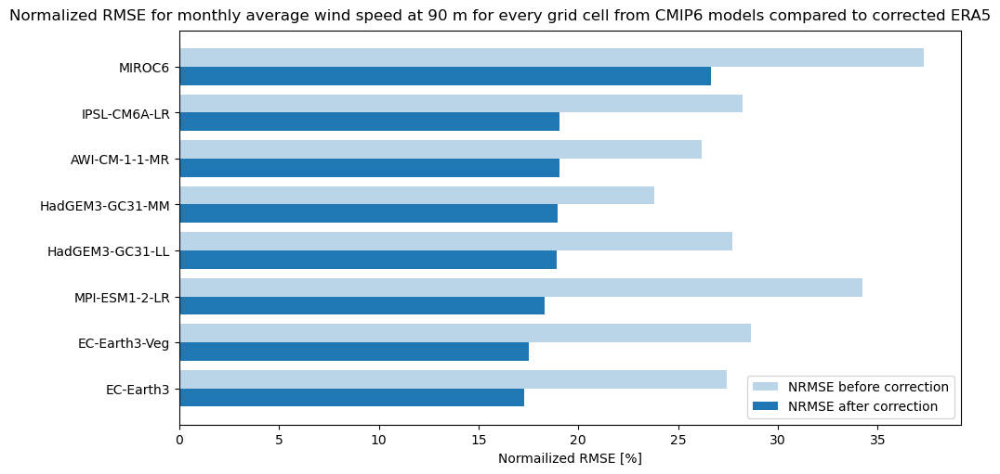

In [148]:
width = 0.4;
y_pos = np.arange(len(CMIP6_models_wind))
color_wind = '#1f77b4'

fig,ax = plt.subplots(figsize=(10,5),layout='constrained');
ax.set_yticks(y_pos, labels=RMSE_data_per_grid_cell.index)
ax.barh(y_pos + 0.5*width,NRMSE_data_per_grid_cell['NRMSE before correction'],width,label='NRMSE before correction',color=color_wind, alpha=0.3);
ax.barh(y_pos - 0.5*width,NRMSE_data_per_grid_cell['NRMSE after correction'],width,label='NRMSE after correction',color=color_wind);
title = f'Normalized RMSE for monthly average wind speed at 90 m for every grid cell from CMIP6 models compared to corrected ERA5';
plt.xlabel('Normailized RMSE [%]')
plt.legend()
fig.suptitle(title);

# Saving figure to file: 
plot_filename = f'Grid_based_RMSE_monthly_avg_wnd90m';
# plt.savefig(plot_path(plot_filename), dpi=300);

In [149]:
# NRMSE for EC-Earth3 with wnd100m: 

# RMSE_data_per_grid_cell = pd.DataFrame(index=CMIP6_models_wind, columns=['RMSE before correction', 'RMSE after correction'])
NRMSE_data_per_grid_cell_power_law = pd.DataFrame(index=['EC-Earth3 (method 2)', 'EC-Earth3 (method 3)'], columns=['NRMSE before correction', 'NRMSE after correction'])

ERA5_wnd90m_mean_number = GWA_corrected_ERA5_wnd90m_coarse_mean.mean().data

# Reusing data from already calculated DataFrame: 
NRMSE_data_per_grid_cell_power_law.loc['EC-Earth3 (method 2)'] = NRMSE_data_per_grid_cell.loc['EC-Earth3']

CMIP6_model = 'EC-Earth3'
CMIP6_model = CMIP6_model.replace("-", "_")
# Calculating RMSE before corrections: 
filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_power_law'
data = locals()[filename].resample(time=resample_freq).mean().to_series()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
# ERA5 after GWA correction
filename = f'GWA_corrected_ERA5_wnd90m_coarse'
data_df['Corrected ERA5'] = locals()[filename].resample(time=resample_freq).mean().to_series()
y_actual = data_df['Corrected ERA5']
y_predicted = data_df['CMIP6 data']
MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
RMSE = math.sqrt(MSE)
CMIP6_model = CMIP6_model.replace("_", "-")
NRMSE_data_per_grid_cell_power_law['NRMSE before correction'].loc['EC-Earth3 (method 3)'] = RMSE/ERA5_wnd90m_mean_number*100

# RMSE after corrections: 
CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_power_law_GWA_corrected'
data = locals()[filename].resample(time=resample_freq).mean().to_series()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);

y_predicted = data_df['CMIP6 data']
MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
RMSE = math.sqrt(MSE)
CMIP6_model = CMIP6_model.replace("_", "-")
NRMSE_data_per_grid_cell_power_law['NRMSE after correction'].loc['EC-Earth3 (method 3)'] = RMSE/ERA5_wnd90m_mean_number*100
NRMSE_data_per_grid_cell_power_law.sort_values('NRMSE after correction',axis=0,ascending=False,inplace=True)
NRMSE_data_per_grid_cell_power_law

,NRMSE before correction,NRMSE after correction
EC-Earth3 (method 3),20.893546,17.501811
EC-Earth3 (method 2),27.456869,17.265243


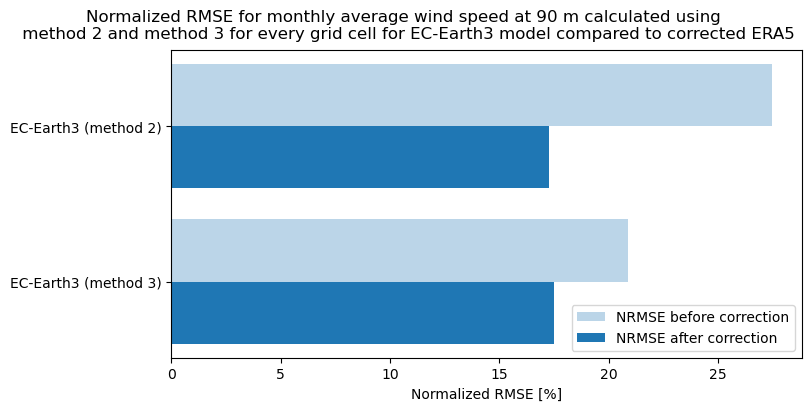

In [150]:
# Plotting "NRMSE_data_per_grid_cell_power_law"
width = 0.4;
y_pos = np.arange(2)
color_wind = '#1f77b4'

fig,ax = plt.subplots(figsize=(8,4),layout='constrained');
ax.set_yticks(y_pos, labels=NRMSE_data_per_grid_cell_power_law.index)
ax.barh(y_pos + 0.5*width,NRMSE_data_per_grid_cell_power_law['NRMSE before correction'],width,label='NRMSE before correction',color=color_wind, alpha=0.3);
ax.barh(y_pos - 0.5*width,NRMSE_data_per_grid_cell_power_law['NRMSE after correction'],width,label='NRMSE after correction',color=color_wind);
title = f'Normalized RMSE for monthly average wind speed at 90 m calculated using \n method 2 and method 3 for every grid cell for EC-Earth3 model compared to corrected ERA5';
plt.xlabel('Normalized RMSE [%]')
plt.legend()
fig.suptitle(title);

# Saving figure to file: 
plot_filename = f'Grid_based_NRMSE_monthly_avg_wnd90m_power_law_vs_constant_roughness';
# plt.savefig(plot_path(plot_filename), dpi=300);

In [151]:
# RMSE for PV (influx)
RMSE_data_per_grid_cell_PV = pd.DataFrame(index=CMIP6_models_solar, columns=['RMSE before correction', 'RMSE after correction'])
NRMSE_data_per_grid_cell_PV = pd.DataFrame(index=CMIP6_models_wind, columns=['NRMSE before correction', 'NRMSE after correction'])
ERA5_influx_mean_number = ERA5_influx_coarse.mean(dim=['x','y','time']).data

for CMIP6_model in CMIP6_models_solar:
    # plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Calculating RMSE before corrections: 
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_influx'
    data = locals()[filename].resample(time=resample_freq).mean().to_series()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={'influx':'CMIP6 data'},inplace=True);
    # ERA5 after correction
    filename = f'ERA5_influx_coarse'
    data_df['Corrected ERA5'] = locals()[filename].resample(time=resample_freq).mean().to_series()
    y_actual = data_df['Corrected ERA5']
    y_predicted = data_df['CMIP6 data']
    MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
    RMSE = math.sqrt(MSE)
    CMIP6_model = CMIP6_model.replace("_", "-")
    RMSE_data_per_grid_cell_PV['RMSE before correction'].loc[CMIP6_model] = RMSE
    NRMSE_data_per_grid_cell_PV['NRMSE before correction'].loc[CMIP6_model] = RMSE/ERA5_influx_mean_number*100

    # RMSE after corrections: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_influx_corrected'
    data = locals()[filename].resample(time=resample_freq).mean().to_series()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);

    y_predicted = data_df['CMIP6 data']
    MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
    RMSE = math.sqrt(MSE)
    CMIP6_model = CMIP6_model.replace("_", "-")
    RMSE_data_per_grid_cell_PV['RMSE after correction'].loc[CMIP6_model] = RMSE
    NRMSE_data_per_grid_cell_PV['NRMSE after correction'].loc[CMIP6_model] = RMSE/ERA5_influx_mean_number*100

RMSE_data_per_grid_cell_PV.sort_values('RMSE after correction',axis=0,ascending=True,inplace=True)
NRMSE_data_per_grid_cell_PV.sort_values('NRMSE after correction',axis=0,ascending=True,inplace=True)
NRMSE_data_per_grid_cell_PV

,NRMSE before correction,NRMSE after correction
EC-Earth3,14.231176,13.063473
MIROC6,16.315632,15.069315
HadGEM3-GC31-MM,17.203797,16.474014
HadGEM3-GC31-LL,17.897277,17.055137
AWI-CM-1-1-MR,17.426952,17.55117
MPI-ESM1-2-HR,17.857982,18.309549
IPSL-CM6A-LR,18.844257,19.191775
MPI-ESM1-2-LR,18.80562,19.603428
EC-Earth3-Veg,NaN,NaN


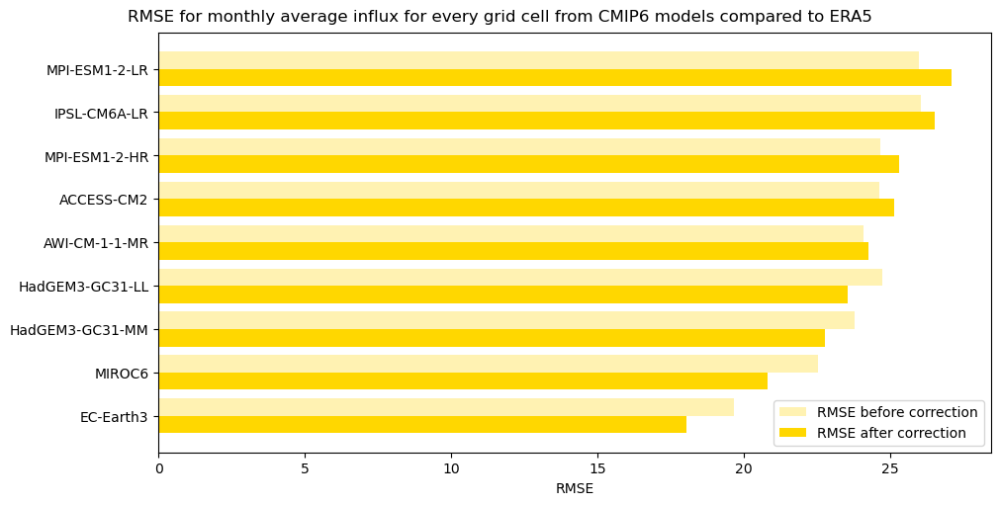

In [152]:
width = 0.4;
y_pos = np.arange(len(CMIP6_models_solar))
color_PV = 'gold'

fig,ax = plt.subplots(figsize=(10,5),layout='constrained');
ax.set_yticks(y_pos, labels=RMSE_data_per_grid_cell_PV.index)
ax.barh(y_pos + 0.5*width,RMSE_data_per_grid_cell_PV['RMSE before correction'],width,label='RMSE before correction',color=color_PV, alpha=0.3);
ax.barh(y_pos - 0.5*width,RMSE_data_per_grid_cell_PV['RMSE after correction'],width,label='RMSE after correction',color=color_PV);
title = f'RMSE for monthly average influx for every grid cell from CMIP6 models compared to ERA5';
plt.xlabel('RMSE')
plt.legend()
fig.suptitle(title);

# Saving figure to file: 
plot_filename = f'Grid_based_RMSE_monthly_avg_influx';
# plt.savefig(plot_path(plot_filename), dpi=300);

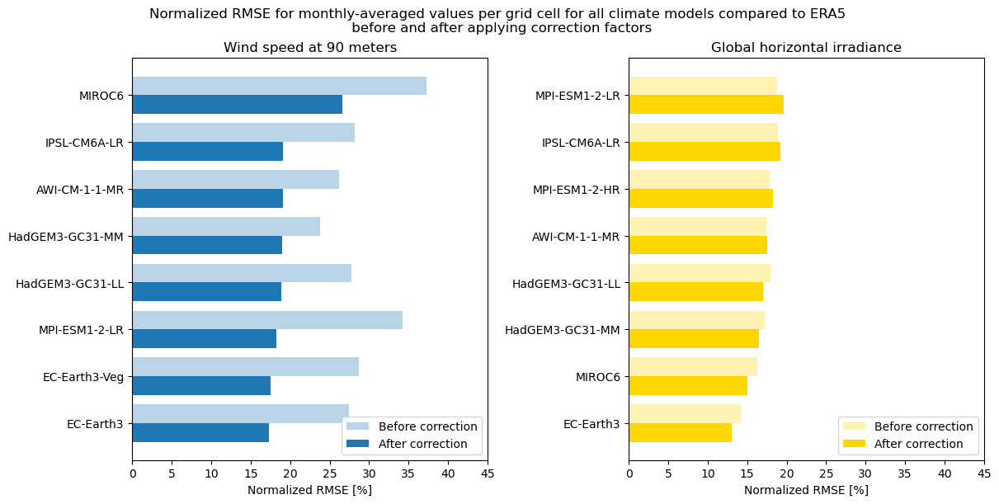

In [153]:
width = 0.4;
y_pos = np.arange(len(CMIP6_models_solar))
color_PV = 'gold'
color_wind = '#1f77b4'

fig,axs = plt.subplots(1,2,figsize=(12,6),layout='constrained');

# Wind
axs[0].set_yticks(y_pos, labels=NRMSE_data_per_grid_cell.index)
axs[0].barh(y_pos + 0.5*width,NRMSE_data_per_grid_cell['NRMSE before correction'],width,label='Before correction',color=color_wind, alpha=0.3);
axs[0].barh(y_pos - 0.5*width,NRMSE_data_per_grid_cell['NRMSE after correction'],width,label='After correction',color=color_wind);
axs[0].set_title('Wind speed at 90 meters')
axs[0].legend()
axs[0].set_xlabel('Normalized RMSE [%]')
axs[0].set_xlim([0,45])

# PV
axs[1].set_yticks(y_pos, labels=NRMSE_data_per_grid_cell_PV.index)
axs[1].barh(y_pos + 0.5*width,NRMSE_data_per_grid_cell_PV['NRMSE before correction'],width,label='Before correction',color=color_PV, alpha=0.3);
axs[1].barh(y_pos - 0.5*width,NRMSE_data_per_grid_cell_PV['NRMSE after correction'],width,label='After correction',color=color_PV);
axs[1].set_title('Global horizontal irradiance');
axs[1].legend(loc='lower right')
axs[1].set_xlabel('Normalized RMSE [%]')
axs[1].set_xlim([0,45])

title = f'Normalized RMSE for monthly-averaged values per grid cell for all climate models compared to ERA5 \n before and after applying correction factors';
fig.suptitle(title);

# Saving figure to file: 
plot_filename = f'Grid_based_NRMSE_monthly_avg';
# plt.savefig(plot_path(plot_filename), dpi=300);

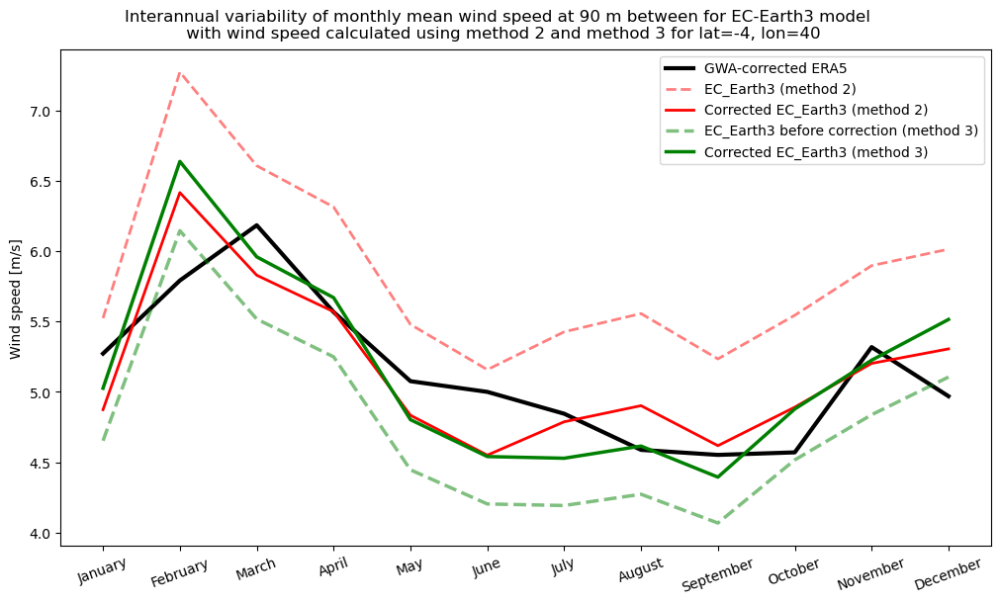

In [154]:
# Intraanual variability for specific point
point = (-4,40)
ssp_variant = 'ssp585'
fig,ax = plt.subplots(figsize=(10,6),layout='constrained')
title = f'Interannual variability of monthly mean wind speed at 90 m between for EC-Earth3 model \n with wind speed calculated using method 2 and method 3 for lat={point[0]}, lon={point[1]}'
fig.suptitle(title)
Monthly_mean = pd.DataFrame()

# ERA5 after GWA correction
filename = f'GWA_corrected_ERA5_wnd90m_coarse'
data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'GWA-corrected ERA5 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'ERA5 {year}'] = data_df['GWA-corrected ERA5 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="GWA-corrected ERA5 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=3,legend=True,label=f'GWA-corrected ERA5', color='black')
Monthly_mean['ERA5'] = data_df['mean']

# Not corrected:
CMIP6_model = 'EC-Earth3'
plotcolor = model_colors.loc[CMIP6_model]['Color']
CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m'
data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",linestyle="--",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2, linestyle="--", legend=True, label=f'{CMIP6_model} (method 2)',color=plotcolor,alpha=0.5)
Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

# Corrected:
CMIP6_model = 'EC-Earth3'
plotcolor = model_colors.loc[CMIP6_model]['Color']
CMIP6_model = CMIP6_model.replace("-", "_")
filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_GWA_corrected'
data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",linestyle=":",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2, legend=True, label=f'Corrected {CMIP6_model} (method 2)',color=plotcolor)
Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

# EC-Earth3 CF from wind interpolation using wind100m before correction:
CMIP6_model = 'EC_Earth3'
filename = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law'
data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, linestyle="--",legend=True,label=f'{CMIP6_model} before correction (method 3)',color='green',alpha=0.5)
Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

# EC-Earth3 CF from wind interpolation using wind100m after correction:
CMIP6_model = 'EC_Earth3'
filename = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_GWA_corrected'
data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
data_df = pd.DataFrame(data);
data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
data_df['Month'] = data.index.month
data_df.set_index('Month',inplace=True)
for i in range(0,9):
    year = 2014+i;
    data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
data_df.drop(columns="CMIP6 data",inplace=True)
data_df = data_df.iloc[0:12]
# data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
data_df = data_df.assign(mean=data_df.mean(axis=1))
data_df['mean'].plot(ax=ax,linewidth=2.5, legend=True,label=f'Corrected {CMIP6_model} (method 3)', color='green')
Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=20);
plt.ylabel('Wind speed [m/s]')
# plt.ylim([0,10])
ax.set(xlabel=None)

# Saving figure to file: 
plot_filename = f'Intraannual variability EC_Earth3 using constant roughness vs power law with seasonability for {point[0]}_{point[1]}';
# plt.savefig(plot_path(plot_filename), dpi=300);

In [155]:
# Definition of reference points, where some results will be shown for: 
point_1 = (17,64)
point_2 = (26,59)
point_3 = (-1,52)
point_4 = (10,51)
point_5 = (25,46)
point_6 = (-4,40)

ref_country = ['Sweden', 'Estonia', 'United Kingdom', 'Germany', 'Romania', 'Spain']

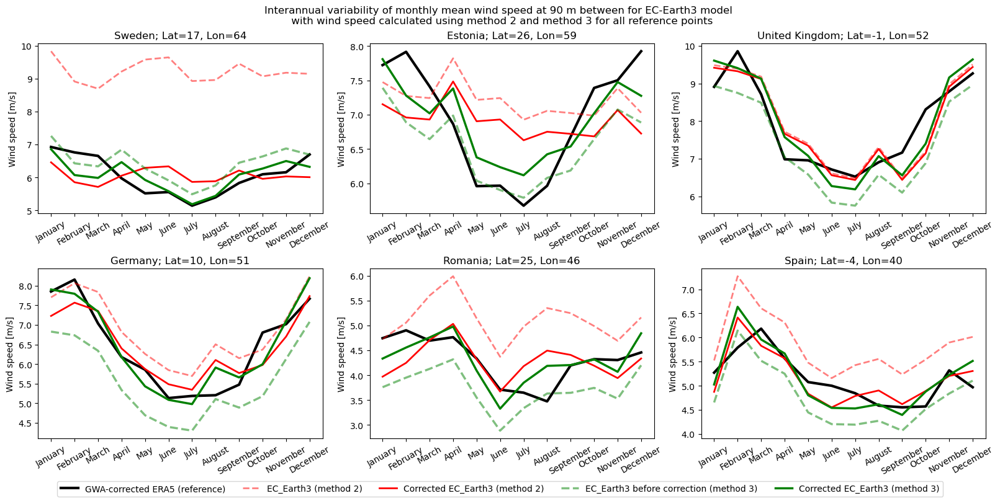

In [156]:
# Intraanual variability for specific points in 1 plot:
legend_mod = False;
ssp_variant = 'ssp585'
fig,axs = plt.subplots(2,3,figsize=(16,8),layout='constrained')
title = f'Interannual variability of monthly mean wind speed at 90 m between for EC-Earth3 model \n with wind speed calculated using method 2 and method 3 for all reference points'
fig.suptitle(title)

for ii in range(6):
    point_name = f'point_{ii+1}';
    point = locals()[point_name];
    country_name = ref_country[ii]
    Monthly_mean = pd.DataFrame()

    # ERA5 after GWA correction
    filename = f'GWA_corrected_ERA5_wnd90m_coarse'
    data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'GWA-corrected ERA5 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'ERA5 {year}'] = data_df['GWA-corrected ERA5 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="GWA-corrected ERA5 data",inplace=True)
    data_df = data_df.iloc[0:12]
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=axs.flat[ii],linewidth=3,legend=legend_mod,label=f'GWA-corrected ERA5 (reference)', color='black')
    Monthly_mean['ERA5'] = data_df['mean']

    # Not corrected:
    CMIP6_model = 'EC-Earth3'
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m'
    data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=axs.flat[ii],linewidth=2, linestyle="--", legend=legend_mod, label=f'{CMIP6_model} (method 2)',color=plotcolor,alpha=0.5)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

    # Corrected:
    CMIP6_model = 'EC-Earth3'
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")
    filename = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_GWA_corrected'
    data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=axs.flat[ii],linewidth=2, legend=legend_mod, label=f'Corrected {CMIP6_model} (method 2)',color=plotcolor)
    Monthly_mean[f'{CMIP6_model}'] = data_df['mean']

    # EC-Earth3 CF from wind interpolation using wind100m before correction:
    CMIP6_model = 'EC_Earth3'
    filename = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law'
    data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=axs.flat[ii],linewidth=2.5, linestyle="--",legend=legend_mod,label=f'{CMIP6_model} before correction (method 3)',color='green',alpha=0.5)
    Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

    # EC-Earth3 CF from wind interpolation using wind100m after correction:
    # CMIP6_model = 'EC_Earth3'
    filename = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_GWA_corrected'
    data = locals()[filename].sel(x=point[0],y=point[1]).squeeze().to_series().resample(resample_freq).mean()
    data_df = pd.DataFrame(data);
    data_df.rename(columns ={0:'CMIP6 data'},inplace=True);
    data_df['Month'] = data.index.month
    data_df.set_index('Month',inplace=True)
    for i in range(0,9):
        year = 2014+i;
        data_df[f'{CMIP6_model} {year}'] = data_df['CMIP6 data'].iloc[12*i+0:12*i+12]
    data_df.drop(columns="CMIP6 data",inplace=True)
    data_df = data_df.iloc[0:12]
    # data_df.plot(ax=ax,color="grey",alpha=0.3,legend=False)
    data_df = data_df.assign(mean=data_df.mean(axis=1))
    data_df['mean'].plot(ax=axs.flat[ii],linewidth=2.5, legend=legend_mod,label=f'Corrected {CMIP6_model} (method 3)', color='green')
    Monthly_mean[f'{CMIP6_model}_wind_100m'] = data_df['mean']

    axs.flat[ii].set_xticks([1,2,3,4,5,6,7,8,9,10,11,12], ['January', 'February', 'March','April','May','June','July','August','September','October','November','December'],rotation=30);
    axs.flat[ii].set_ylabel('Wind speed [m/s]')
    axs.flat[ii].set(xlabel=None)
    axs.flat[ii].set_title(f'{country_name}; Lat={point[0]}, Lon={point[1]}')

    if ii == 0: 
        fig.legend(ncols=5,loc='outside lower center')
    # # Shrink current axis by 20%
    # box = axs.flat[ii].get_position()
    # axs.flat[ii].set_position([box.x0, box.y0, box.width * 0.8, box.height])

# fig.legend(ncols=5,loc='outside lower center')
# Saving figure to file: 
plot_filename = f'Intraannual variability EC_Earth3 using constant roughness vs power law with seasonability for all reference points';
# plt.savefig(plot_path(plot_filename), dpi=300);

## EC-Earth3 with wnd100m (method 3) - CF

In [157]:
# # Plotting % difference between GWA-corrected ERA5 and 1) EC-Earth3 with wnd100m and 2) EC-Earth3 without wind100m - wnd90m 
# nr_of_decimals = 4

# # Finding global absolute max for common colorbar: 
# abs_max_global = 0
# ERA5_name = f'GWA_corrected_ERA5_wnd90m_coarse_mean'
# method_2 = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_GWA_corrected_mean'
# method_3 = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_GWA_corrected_mean'
# percent_diff = f'Europe_method_2_ssp585_percent_difference'
# locals()[percent_diff] = ((locals()[method_2] - locals()[ERA5_name]) / locals()[ERA5_name])*100
# abs_max_local = np.nanmax(abs(locals()[percent_diff]))
# if abs_max_local > abs_max_global: 
#     abs_max_global = abs_max_local
# percent_diff = f'Europe_method_3_ssp585_percent_difference'
# locals()[percent_diff] = ((locals()[method_3] - locals()[ERA5_name]) / locals()[ERA5_name])*100
# if abs_max_local > abs_max_global: 
#     abs_max_global = abs_max_local


# fig,axs = plt.subplots(1,2,subplot_kw={"projection": projection},figsize=(12,8),layout='constrained')
# i = 0;      # Initializing counter for subplot number
# ERA5_name = f'GWA_corrected_ERA5_wnd90m_coarse_mean'
# method_2 = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_GWA_corrected_mean'
# method_3 = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_power_law_GWA_corrected_mean'

# percent_diff = f'Europe_method_2_ssp585_percent_difference'
# locals()[percent_diff] = ((locals()[method_2] - locals()[ERA5_name]) / locals()[ERA5_name])*100
# # locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

# min_val = np.nanmin(locals()[percent_diff])
# max_val = np.nanmax(locals()[percent_diff])
# mean_val = np.nanmean(locals()[percent_diff])
# abs_max = np.nanmax(abs(locals()[percent_diff]))
# norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
# im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
#                 norm=norm);
# Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
# axs.flat[i].set_title(f'Method 2 \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
# im.colorbar.remove()
# i = i+1;

# percent_diff = f'Europe_method_3_ssp585_percent_difference'
# locals()[percent_diff] = ((locals()[method_3] - locals()[ERA5_name]) / locals()[ERA5_name])*100
# # locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

# min_val = np.nanmin(locals()[percent_diff])
# max_val = np.nanmax(locals()[percent_diff])
# mean_val = np.nanmean(locals()[percent_diff])
# abs_max = np.nanmax(abs(locals()[percent_diff]))
# norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
# im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
#                 norm=norm);
# Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
# axs.flat[i].set_title(f'Method 3 \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
# im.colorbar.remove()

# fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.5,aspect=40,norm=norm,cmap="RdBu_r",label='Change in GWA-corrected ERA5 vs. EC-Earth3 [%]')
# fig.suptitle(f'Percentage difference in wind speed at 90 meters for EC-Earth3 calculated using method 2 and method 3');

# # Saving figure to file: 
# plot_filename = (f'ERA5_vs_method_2_percentage_diff_wnd90m.png')
# # plt.savefig(plot_path(plot_filename), dpi=300)

In [158]:
# Generating average CF per year for wind for BOC:
overwrite = 0;

date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000
ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
        corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_wnd90m_GWA_corrected'
        locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
        my_file = Path(cutout_path)
        name = f'CF_avg_wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'    # Defining average CF filename: 
        filename = f'{name}.nc'
        path = f'{output_folder_path}{filename}'
        if cutout_name in locals():
            if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
                # Creating average wind CF:
                print(f'Creating "{filename}"')
                locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True)
                locals()[name].to_netcdf(path=path)      # Saving average CF to file
            else:
                locals()[name] = xr.open_dataarray(path)
                locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
                print(f'"{filename}" already exists in "{path}". ')
        else: 
            print(f'File "{path}" skipped. The cutout does not exist. ')

# overwrite = 1;
cutout_name = f'Europe_EC_Earth3_ssp585_{yy_start}_{yy_end}_wind_100m'
corrected_data_name = f'Europe_EC_Earth3_ssp585_{yy_start}_{yy_end}_wnd90m_power_law_GWA_corrected'
locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
my_file = Path(cutout_path)
name = f'CF_avg_wind_EC_Earth3_ssp585_{yy_start}_{yy_end}_wind_100m'    # Defining average CF filename: 
filename = f'{name}.nc'
path = f'{output_folder_path}{filename}'
if cutout_name in locals():
    if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
        # Creating average wind CF:
        print(f'Creating "{filename}"')
        locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True)
        locals()[name].to_netcdf(path=path)      # Saving average CF to file
    else:
        locals()[name] = xr.open_dataarray(path)
        locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
        print(f'"{filename}" already exists in "{path}". ')
else: 
    print(f'File "{path}" skipped. The cutout does not exist. ')

"CF_avg_wind_EC_Earth3_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_EC_Earth3_ssp585_15_22.nc". 
"CF_avg_wind_MPI_ESM1_2_HR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_MPI_ESM1_2_HR_ssp585_15_22.nc". 
"CF_avg_wind_MIROC6_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_MIROC6_ssp585_15_22.nc". 
"CF_avg_wind_MPI_ESM1_2_LR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_MPI_ESM1_2_LR_ssp585_15_22.nc". 
"CF_avg_wind_HadGEM3_GC31_LL_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_HadGEM3_GC31_LL_ssp585_15_22.nc". 
"CF_avg_wind_HadGEM3_GC31_MM_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_HadGEM3_GC31_MM_ssp585_15_22.nc". 
"CF_avg_wind_IPSL_CM6A_LR_ssp585_15_22.nc"

In [159]:
# Creating ERA5 CF timeseries for every grid cell for BOC: 

overwrite = 1;
date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000
ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_wnd90m_GWA_corrected'
    locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
    my_file = Path(cutout_path)
    name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'    # Defining average CF filename: 
    filename = f'{name}.nc'
    path = f'{output_folder_path}{filename}'
    if cutout_name in locals():
        if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
            # Creating average wind CF:
            print(f'Creating "{filename}"')
            locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True,capacity_factor_timeseries=True)
            locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name].to_netcdf(path=path)      # Saving average CF to file
        else:
            locals()[name] = xr.open_dataarray(path)
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            print(f'"{filename}" already exists in "{path}". ')
    else: 
        print(f'File "{path}" skipped. The cutout does not exist. ')

Creating "CF_timeseries_per_cell_wind_EC_Earth3_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_MPI_ESM1_2_HR_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_MIROC6_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_MPI_ESM1_2_LR_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_HadGEM3_GC31_LL_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_HadGEM3_GC31_MM_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_IPSL_CM6A_LR_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_AWI_CM_1_1_MR_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_EC_Earth3_Veg_ssp585_15_22.nc"


In [160]:
# Creating CF timeseries for every grid cell for BOC: 

overwrite = 1;
date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000
ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_wnd90m_GWA_corrected'
    locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
    my_file = Path(cutout_path)
    name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'    # Defining average CF filename: 
    filename = f'{name}.nc'
    path = f'{output_folder_path}{filename}'
    if cutout_name in locals():
        if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
            # Creating average wind CF:
            print(f'Creating "{filename}"')
            locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True,capacity_factor_timeseries=True)
            locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name].to_netcdf(path=path)      # Saving average CF to file
        else:
            locals()[name] = xr.open_dataarray(path)
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            print(f'"{filename}" already exists in "{path}". ')
    else: 
        print(f'File "{path}" skipped. The cutout does not exist. ')

# EC-Earth3 with wind 100m:
cutout_name = f'Europe_EC_Earth3_ssp585_{yy_start}_{yy_end}_wind_100m'
corrected_data_name = f'Europe_EC_Earth3_ssp585_{yy_start}_{yy_end}_wnd90m_power_law_GWA_corrected'
locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
my_file = Path(cutout_path)

name = f'CF_timeseries_per_cell_wind_EC_Earth3_ssp585_{yy_start}_{yy_end}_wind_100m'    # Defining average CF filename: 
filename = f'{name}.nc'
path = f'{output_folder_path}{filename}'
if cutout_name in locals():
    if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
        # Creating average wind CF:
        print(f'Creating "{filename}"')
        locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True,capacity_factor_timeseries=True)
        locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
        locals()[name].to_netcdf(path=path)      # Saving average CF to file
    else:
        locals()[name] = xr.open_dataarray(path)
        # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
        print(f'"{filename}" already exists in "{path}". ')
else: 
    print(f'File "{path}" skipped. The cutout does not exist. ')

Creating "CF_timeseries_per_cell_wind_EC_Earth3_ssp585_15_22.nc"


Creating "CF_timeseries_per_cell_wind_MPI_ESM1_2_HR_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_MIROC6_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_MPI_ESM1_2_LR_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_HadGEM3_GC31_LL_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_HadGEM3_GC31_MM_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_IPSL_CM6A_LR_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_AWI_CM_1_1_MR_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_EC_Earth3_Veg_ssp585_15_22.nc"
Creating "CF_timeseries_per_cell_wind_EC_Earth3_ssp585_15_22_wind_100m.nc"


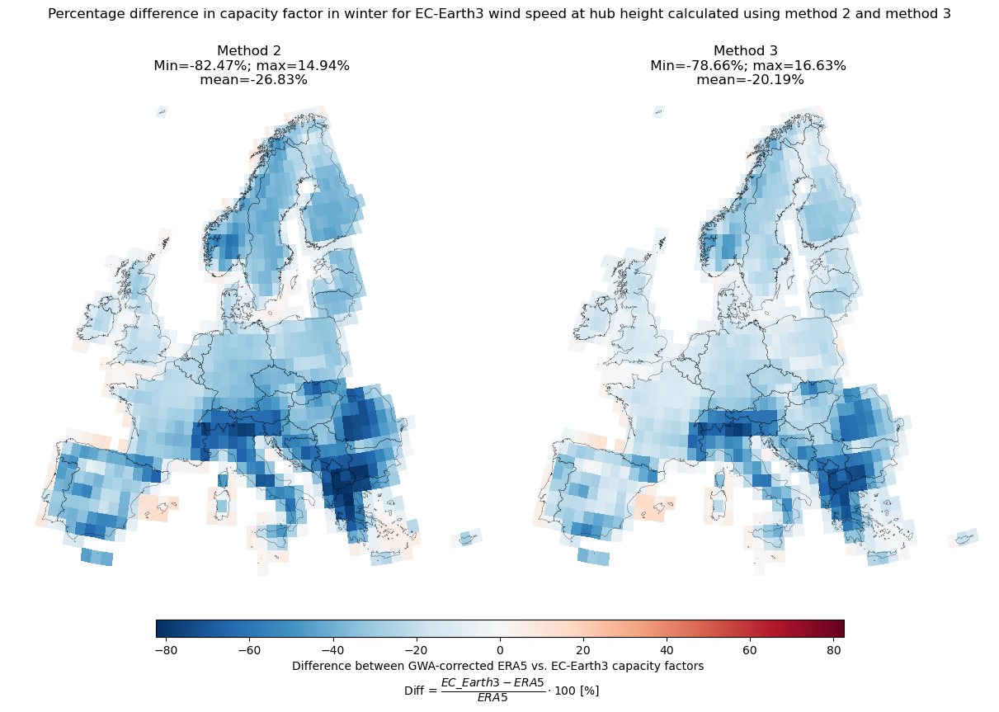

In [161]:
# Plotting % difference between GWA-corrected ERA5 and 1) EC-Earth3 with wnd100m and 2) EC-Earth3 without wind100m - wnd90m 
nr_of_decimals = 2

# Select season to compare: 
season = 'winter'


if season == 'winter':
    season_name = 'DJF'
if season == 'summer':
    season_name = 'JJA'
if season == 'spring':
    season_name = 'MAM'
if season == 'autumn':
    season_name = 'SON'

ERA5_data = GWA_corrected_wind_CF_per_cell_ERA5_BOC_coarse.groupby("time.season").mean().sel(season=season_name)
method_2_data = CF_timeseries_per_cell_wind_EC_Earth3_ssp585_15_22.groupby("time.season").mean().sel(season=season_name)
method_3_data = CF_timeseries_per_cell_wind_EC_Earth3_ssp585_15_22_wind_100m.groupby("time.season").mean().sel(season=season_name)

# Finding global absolute max for common colorbar: 
abs_max_global = 0
ERA5_name = f'ERA5_data'
method_2 = f'method_2_data'
method_3 = f'method_3_data'
percent_diff = f'Europe_method_2_ssp585_percent_difference'
locals()[percent_diff] = ((locals()[method_2] - locals()[ERA5_name]) / locals()[ERA5_name])*100
abs_max_local = np.nanmax(abs(locals()[percent_diff]))
if abs_max_local > abs_max_global: 
    abs_max_global = abs_max_local
percent_diff = f'Europe_method_3_ssp585_percent_difference'
locals()[percent_diff] = ((locals()[method_3] - locals()[ERA5_name]) / locals()[ERA5_name])*100
if abs_max_local > abs_max_global: 
    abs_max_global = abs_max_local


fig,axs = plt.subplots(1,2,subplot_kw={"projection": projection},figsize=(12,8.5),layout='constrained')
fig.suptitle(f'Percentage difference in capacity factor in {season} for EC-Earth3 wind speed at hub height calculated using method 2 and method 3');
i = 0;      # Initializing counter for subplot number
ERA5_name = f'ERA5_data'
method_2 = f'method_2_data'
method_3 = f'method_3_data'

percent_diff = f'Europe_method_2_ssp585_percent_difference'
locals()[percent_diff] = ((locals()[method_2] - locals()[ERA5_name]) / locals()[ERA5_name])*100
# locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

min_val = np.nanmin(locals()[percent_diff])
max_val = np.nanmax(locals()[percent_diff])
mean_val = np.nanmean(locals()[percent_diff])
abs_max = np.nanmax(abs(locals()[percent_diff]))
norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                norm=norm);
Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
axs.flat[i].set_title(f'Method 2 \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
im.colorbar.remove()
i = i+1;

percent_diff = f'Europe_method_3_ssp585_percent_difference'
locals()[percent_diff] = ((locals()[method_3] - locals()[ERA5_name]) / locals()[ERA5_name])*100
# locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

min_val = np.nanmin(locals()[percent_diff])
max_val = np.nanmax(locals()[percent_diff])
mean_val = np.nanmean(locals()[percent_diff])
abs_max = np.nanmax(abs(locals()[percent_diff]))
norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                norm=norm);
Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
axs.flat[i].set_title(f'Method 3 \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
im.colorbar.remove()
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=40,norm=norm,cmap="RdBu_r",label='Difference between GWA-corrected ERA5 vs. EC-Earth3 capacity factors \n Diff = 'r'$\dfrac{EC\_Earth3 - ERA5}{ERA5}\cdot 100 $ [%]')

# Saving figure to file: 
plot_filename = (f'ERA5_vs_method_2_vs_method_3_{season}_CF_percentage_diff.png')
plt.savefig(plot_path(plot_filename), dpi=300)

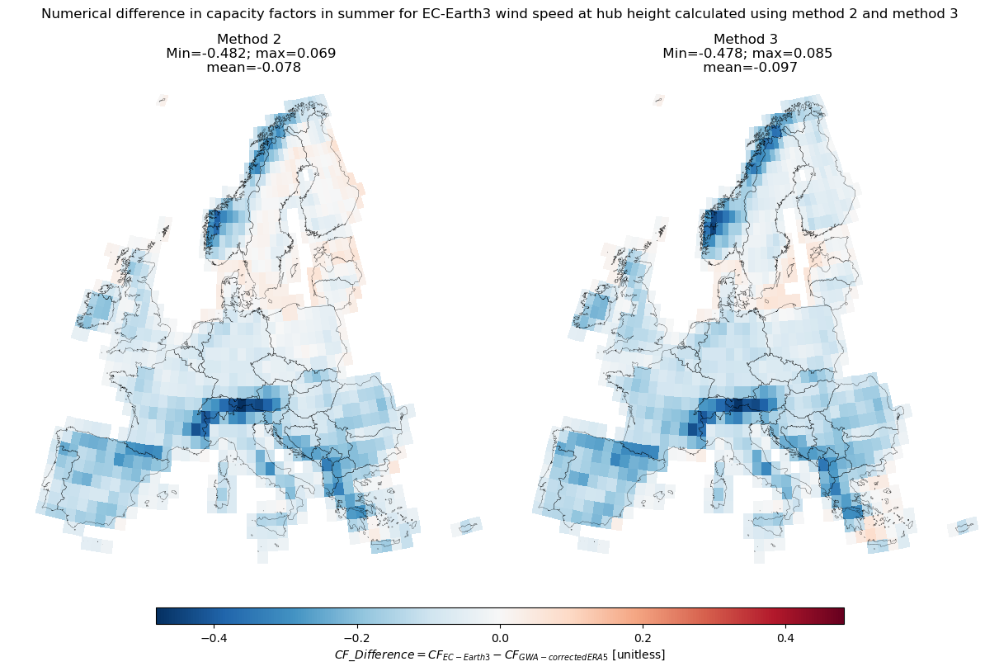

In [162]:
# Plotting  numerical difference between GWA-corrected ERA5 and 1) EC-Earth3 with wnd100m and 2) EC-Earth3 without wind100m - wnd90m 
nr_of_decimals = 3

# Select season to compare: 
season = 'summer'


if season == 'winter':
    season_name = 'DJF'
if season == 'summer':
    season_name = 'JJA'
if season == 'spring':
    season_name = 'MAM'
if season == 'autumn':
    season_name = 'SON'

ERA5_data = GWA_corrected_wind_CF_per_cell_ERA5_BOC_coarse.groupby("time.season").mean().sel(season=season_name)
method_2_data = CF_timeseries_per_cell_wind_EC_Earth3_ssp585_15_22.groupby("time.season").mean().sel(season=season_name)
method_3_data = CF_timeseries_per_cell_wind_EC_Earth3_ssp585_15_22_wind_100m.groupby("time.season").mean().sel(season=season_name)

# Finding global absolute max for common colorbar: 
abs_max_global = 0
ERA5_name = f'ERA5_data'
method_2 = f'method_2_data'
method_3 = f'method_3_data'
percent_diff = f'Europe_method_2_ssp585_percent_difference'
locals()[percent_diff] = ((locals()[method_2] - locals()[ERA5_name]))
abs_max_local = np.nanmax(abs(locals()[percent_diff]))
if abs_max_local > abs_max_global: 
    abs_max_global = abs_max_local
percent_diff = f'Europe_method_3_ssp585_percent_difference'
locals()[percent_diff] = ((locals()[method_3] - locals()[ERA5_name]))
if abs_max_local > abs_max_global: 
    abs_max_global = abs_max_local


fig,axs = plt.subplots(1,2,subplot_kw={"projection": projection},figsize=(12,8),layout='constrained')
i = 0;      # Initializing counter for subplot number
ERA5_name = f'ERA5_data'
method_2 = f'method_2_data'
method_3 = f'method_3_data'

percent_diff = f'Europe_method_2_ssp585_percent_difference'
locals()[percent_diff] = ((locals()[method_2] - locals()[ERA5_name]))
# locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

min_val = np.nanmin(locals()[percent_diff])
max_val = np.nanmax(locals()[percent_diff])
mean_val = np.nanmean(locals()[percent_diff])
abs_max = np.nanmax(abs(locals()[percent_diff]))
norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                norm=norm);
Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
axs.flat[i].set_title(f'Method 2 \n Min={round(min_val,nr_of_decimals)}; max={round(max_val,nr_of_decimals)} \n mean={round(mean_val,nr_of_decimals)}');
im.colorbar.remove()
i = i+1;

percent_diff = f'Europe_method_3_ssp585_percent_difference'
locals()[percent_diff] = ((locals()[method_3] - locals()[ERA5_name]))
# locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

min_val = np.nanmin(locals()[percent_diff])
max_val = np.nanmax(locals()[percent_diff])
mean_val = np.nanmean(locals()[percent_diff])
abs_max = np.nanmax(abs(locals()[percent_diff]))
norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                norm=norm);
Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
axs.flat[i].set_title(f'Method 3 \n Min={round(min_val,nr_of_decimals)}; max={round(max_val,nr_of_decimals)} \n mean={round(mean_val,nr_of_decimals)}');
im.colorbar.remove()
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=40,norm=norm,cmap="RdBu_r",label='$CF\_Difference = CF_{EC-Earth3} - CF_{GWA-corrected ERA5}$ [unitless]')
fig.suptitle(f'Numerical difference in capacity factors in {season} for EC-Earth3 wind speed at hub height calculated using method 2 and method 3');

# Saving figure to file: 
plot_filename = (f'ERA5_vs_method_2_vs_method_3_{season}_CF_numerical_diff.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

# EOC vs. BOC analysis

In [163]:
# Importing EOC cutouts from external HDD

date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2070-01-01"
end_date = "2099-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")     # Replacing - with _ for all CMIP6 model names
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    path = f'E://Cutouts/CMIP6_EOC/{cutout_name}.nc'
    locals()[cutout_name] = atlite.Cutout(
    path=path, module="cmip", bounds=bounds, time=slice(start_date, end_date),
    dt='3H',dx=1, dy=1)

for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")     # Replacing - with _ for all CMIP6 model names
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    path = f'E://Cutouts/CMIP6_EOC/{cutout_name}.nc'
    locals()[cutout_name] = atlite.Cutout(
    path=path, module="cmip", bounds=bounds, time=slice(start_date, end_date),
    dt='3H',dx=1, dy=1)

c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy are ignored, since cutout is already built.
  warn(
c:\Users\c10si\anaconda3\envs\Pre-project_environment_2_20230\lib\site-packages\atlite\cutout.py:194: UserWarning: Arguments module, bounds, time, dt, dx, dy ar

In [164]:
# Calculating wnd90m and influx from cutouts:

# Getting wind speed at hub height from CMIP6 EOC models
ssp_variant = 'ssp585'

# Defining roughness to extrapolate hub height wind speed:
roughness = xr.open_dataset('roughness.nc')
roughness = roughness.rename({'fsr':'roughness'})
roughness = roughness.mean(dim='time')
roughness = _rename_and_clean_coords(roughness)
roughness.roughness.attrs['prepared_feature'] = 'wind'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_70_99'
    if cutout_name in locals():
        # Calculating wind speed at hub height (as a timeseries for every cutout)
        from_height = 10;
        from_name = "wnd{h:0d}m".format(h=int(from_height));
        to_height = atlite.resource.get_windturbineconfig(turbine)['hub_height'];       # 90 m in current config
        to_name = "wnd{h:0d}m".format(h=int(to_height));
        to_cutout_name = f'{cutout_name}_{to_name}'     # It will result in: Europe_{CMIP6_model}_{ssp_variant}_70_99_ssp585_70_99_wnd90m
        
        # Adding roughness data (from ERA5) into the cutout:
        da = roughness.roughness.interp_like(locals()[cutout_name].data['wnd10m'].isel(time=0))
        locals()[cutout_name].data = locals()[cutout_name].data.assign(roughness=da)

        ds = locals()[cutout_name].data
        locals()[to_cutout_name] = ds[from_name] * (
                    np.log(to_height / ds["roughness"]) / np.log(from_height / ds["roughness"]))
        locals()[to_cutout_name].attrs.update({"long name": "Extrapolated {ht} m wind speed using logarithmic "
                            "method with roughness and {hf} m wind speed"
                            "".format(ht=to_height, hf=from_height),
                            "units": "m s**-1"})
    
        # Calculating average wind speed for each cell for 8 years from ERA5:
        cutout_mean_name = f'{to_cutout_name}_mean'
        locals()[cutout_mean_name] = locals()[to_cutout_name].mean(dim=["time"],keep_attrs=True)
        print(f'{cutout_mean_name} created. ')
    else: 
        print(f'WARNING: Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

# Getting influx data from CMIP6 models

for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_{ssp_variant}_70_99'
    if cutout_name in locals():
        to_cutout_name = f'{cutout_name}_influx' 
        ds = locals()[cutout_name].data
        locals()[to_cutout_name] = locals()[cutout_name].data['influx']
        # Calculating average influx for each cell for 8 years:
        cutout_mean_name = f'{to_cutout_name}_mean'
        locals()[cutout_mean_name] = locals()[to_cutout_name].mean(dim=["time"],keep_attrs=True)
        print(f'{cutout_mean_name} created. ')
    else: 
        print(f'WARNING: Cutout {cutout_name} skipped. It does not exist or is not loaded. ')

Europe_EC_Earth3_ssp585_70_99_wnd90m_mean created. 
Europe_MPI_ESM1_2_HR_ssp585_70_99_wnd90m_mean created. 
Europe_MIROC6_ssp585_70_99_wnd90m_mean created. 
Europe_MPI_ESM1_2_LR_ssp585_70_99_wnd90m_mean created. 
Europe_HadGEM3_GC31_LL_ssp585_70_99_wnd90m_mean created. 
Europe_HadGEM3_GC31_MM_ssp585_70_99_wnd90m_mean created. 
Europe_IPSL_CM6A_LR_ssp585_70_99_wnd90m_mean created. 
Europe_AWI_CM_1_1_MR_ssp585_70_99_wnd90m_mean created. 
Europe_EC_Earth3_Veg_ssp585_70_99_wnd90m_mean created. 
Europe_EC_Earth3_ssp585_70_99_influx_mean created. 
Europe_MPI_ESM1_2_HR_ssp585_70_99_influx_mean created. 
Europe_MIROC6_ssp585_70_99_influx_mean created. 
Europe_MPI_ESM1_2_LR_ssp585_70_99_influx_mean created. 
Europe_HadGEM3_GC31_LL_ssp585_70_99_influx_mean created. 
Europe_HadGEM3_GC31_MM_ssp585_70_99_influx_mean created. 
Europe_IPSL_CM6A_LR_ssp585_70_99_influx_mean created. 
Europe_AWI_CM_1_1_MR_ssp585_70_99_influx_mean created. 
Europe_ACCESS_CM2_ssp585_70_99_influx_mean created. 


In [165]:
# overwrite = 0;
# output_folder_path = f"E://Cutouts/Corrected ERA5/"

# path = f"{output_folder_path}GWA_corrected_ERA5_wnd90m_coarse.nc"
# if not Path(path).is_file() or overwrite == 1: 
#     print(f'Loading GWA_corrected_ERA5_wnd90m_coarse')
#     GWA_corrected_ERA5_wnd90m_coarse.load()
#     GWA_corrected_ERA5_wnd90m_coarse.to_netcdf(path=path)
# else:
#     GWA_corrected_ERA5_wnd90m_coarse = xr.open_dataarray(path)
#     print(f'"GWA_corrected_ERA5_wnd90m_coarse.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

In [166]:
# Applying correction factors to EOC CMIP6 cutouts

# Calculating corrected wind at 90 m and influx 
overwrite = 0;      # Set to 1 of you want to overwrite generated of timeseries
output_folder_path = f'E://Cutouts/CMIP6_EOC/Corrected wnd90m and influx/'
output_folder_path_mean = f'E://Cutouts/CMIP6_EOC/Mean wnd90m and influx per grid cell/'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # Wind: 
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_70_99_wnd90m'
    path = f'{output_folder_path}{mean_da_name}.nc'
    corr_da_name = f'Europe_{CMIP6_model}_ssp585_70_99_wnd90m_GWA_corrected'
    corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}'
    # Saving/loading from file:
    path = f'{output_folder_path}{corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {corr_da_name}')
        locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name]).load()
        locals()[corr_da_name].to_netcdf(path=path)
    else:
        locals()[corr_da_name] = xr.open_dataarray(path)
        print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

    # Calculating average wind speed for each cell for 30 years:
    cutout_mean_name = f'{corr_da_name}_mean'
    path = f'{output_folder_path_mean}{cutout_mean_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {cutout_mean_name}.')
        locals()[cutout_mean_name] = locals()[corr_da_name].mean(dim=["time"],keep_attrs=True).load()
        locals()[cutout_mean_name].to_netcdf(path=path)
    else:
        locals()[cutout_mean_name] = xr.open_dataarray(path)
        print(f'"{cutout_mean_name}.nc" already exists in "{output_folder_path_mean}". The file was successfully imported. ')
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # if CMIP6_model == 'MIROC6':
    #     overwrite = 1
    # else:
    #     overwrite = 0
    # PV:
    mean_da_name = f'Europe_{CMIP6_model}_ssp585_70_99_influx'
    path = f'{output_folder_path}{mean_da_name}.nc'

    corr_da_name = f'Europe_{CMIP6_model}_ssp585_70_99_influx_corrected'
    corr_factor_filename = f'Corr_factors_PV_{CMIP6_model}'
    path = f'{output_folder_path}{corr_da_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {corr_da_name}')
        locals()[corr_da_name] = (locals()[corr_factor_filename] * locals()[mean_da_name]).load()
        locals()[corr_da_name].to_netcdf(path=path)
    else:
        locals()[corr_da_name] = xr.open_dataarray(path)
        print(f'"{corr_da_name}.nc" already exists in "{output_folder_path}". The file was successfully imported. ')

    # Calculating average wind speed for each cell for 30 years:
    cutout_mean_name = f'{corr_da_name}_mean'
    path = f'{output_folder_path_mean}{cutout_mean_name}.nc'
    if not Path(path).is_file() or overwrite == 1: 
        print(f'Loading {cutout_mean_name}.')
        locals()[cutout_mean_name] = locals()[corr_da_name].mean(dim=["time"],keep_attrs=True).load()
        locals()[cutout_mean_name].to_netcdf(path=path)
    else:
        locals()[cutout_mean_name] = xr.open_dataarray(path)
        print(f'"{cutout_mean_name}.nc" already exists in "{output_folder_path_mean}". The file was successfully imported. ')

"Europe_EC_Earth3_ssp585_70_99_wnd90m_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_EOC/Corrected wnd90m and influx/". The file was successfully imported. 
"Europe_EC_Earth3_ssp585_70_99_wnd90m_GWA_corrected_mean.nc" already exists in "E://Cutouts/CMIP6_EOC/Mean wnd90m and influx per grid cell/". The file was successfully imported. 
"Europe_MPI_ESM1_2_HR_ssp585_70_99_wnd90m_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_EOC/Corrected wnd90m and influx/". The file was successfully imported. 
"Europe_MPI_ESM1_2_HR_ssp585_70_99_wnd90m_GWA_corrected_mean.nc" already exists in "E://Cutouts/CMIP6_EOC/Mean wnd90m and influx per grid cell/". The file was successfully imported. 
"Europe_MIROC6_ssp585_70_99_wnd90m_GWA_corrected.nc" already exists in "E://Cutouts/CMIP6_EOC/Corrected wnd90m and influx/". The file was successfully imported. 
"Europe_MIROC6_ssp585_70_99_wnd90m_GWA_corrected_mean.nc" already exists in "E://Cutouts/CMIP6_EOC/Mean wnd90m and influx per grid cell/". The

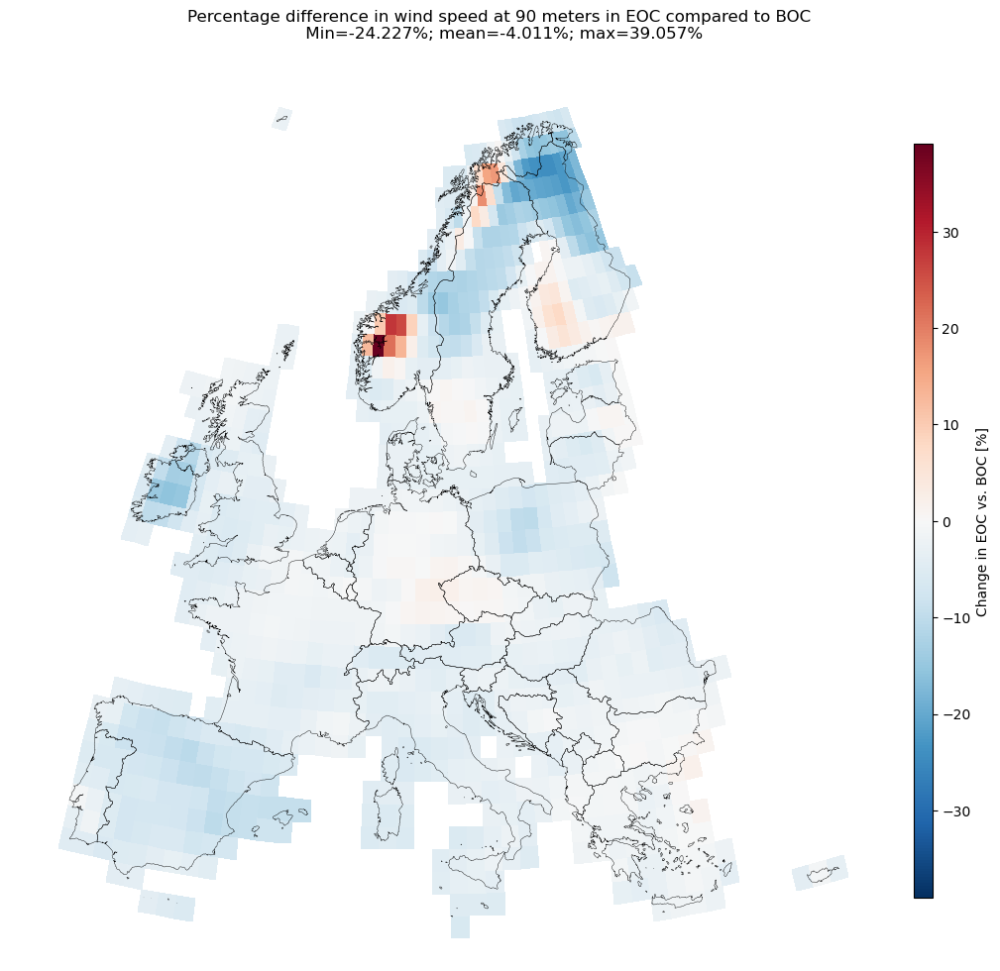

In [167]:
BOC = f'Europe_EC_Earth3_ssp585_15_22_wnd90m_GWA_corrected_mean'
EOC = f'Europe_EC_Earth3_ssp585_70_99_wnd90m_GWA_corrected_mean'

percent_diff = f'Europe_EC_Earth3_ssp585_percent_difference'
locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

min_val = np.nanmin(locals()[percent_diff])
max_val = np.nanmax(locals()[percent_diff])
mean_val = np.nanmean(locals()[percent_diff])
abs_max = np.nanmax(abs(locals()[percent_diff]))

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')
norm = TwoSlopeNorm(vmin=-abs_max, vcenter=0, vmax=abs_max);
im = locals()[percent_diff].plot(ax=ax,transform=plate(),cmap="RdBu_r",#cbar_kwargs={'colorbar': False},
                  norm=norm);
cb = im.colorbar.remove();
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False);
fig.colorbar(im, ax=ax, location='right', fraction=.1,shrink=0.8,aspect=40,norm=norm,cmap="RdBu_r",label='Change in EOC vs. BOC [%]')
fig.suptitle(f'Percentage difference in wind speed at 90 meters in EOC compared to BOC \n Min={round(min_val,3)}%; mean={round(mean_val,3)}%; max={round(max_val,3)}%');

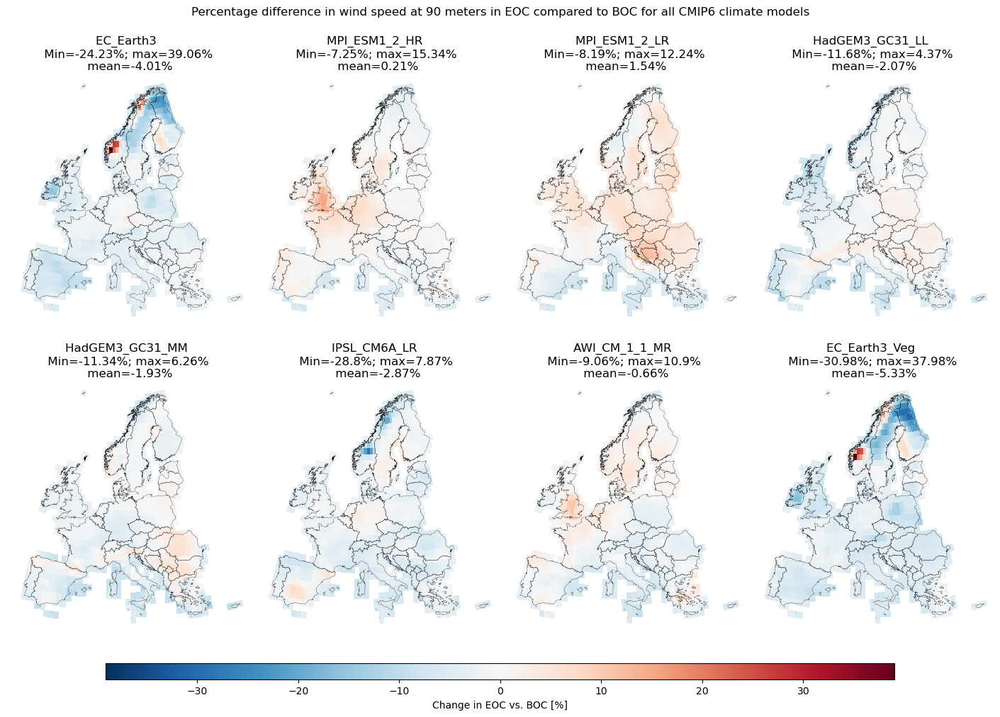

In [168]:
# Plotting % difference EOC vs. BOC wnd90m 
nr_of_decimals = 2

# Finding global absolute max for common colorbar: 
abs_max_global = 0
for CMIP6_model in CMIP6_models_wind_selection: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    BOC = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_GWA_corrected_mean'
    EOC = f'Europe_{CMIP6_model}_ssp585_70_99_wnd90m_GWA_corrected_mean'
    percent_diff = f'Europe_{CMIP6_model}_ssp585_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    abs_max_local = np.nanmax(abs(locals()[percent_diff]))
    if abs_max_local > abs_max_global: 
        abs_max_global = abs_max_local

fig,axs = plt.subplots(2,4,subplot_kw={"projection": projection},figsize=(14,10),layout='constrained')
fig.suptitle(f'Percentage difference in wind speed at 90 meters in EOC compared to BOC for all CMIP6 climate models');
i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind_selection: 
    CMIP6_model = CMIP6_model.replace("-", "_")

    BOC = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_GWA_corrected_mean'
    EOC = f'Europe_{CMIP6_model}_ssp585_70_99_wnd90m_GWA_corrected_mean'

    percent_diff = f'Europe_{CMIP6_model}_ssp585_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

    min_val = np.nanmin(locals()[percent_diff])
    max_val = np.nanmax(locals()[percent_diff])
    mean_val = np.nanmean(locals()[percent_diff])
    abs_max = np.nanmax(abs(locals()[percent_diff]))
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);

    im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                    norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.8,aspect=50,norm=norm,cmap="RdBu_r",label='Change in EOC vs. BOC [%]')
# fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'EOC_vs_BOC_percentage_diff_wnd90m.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

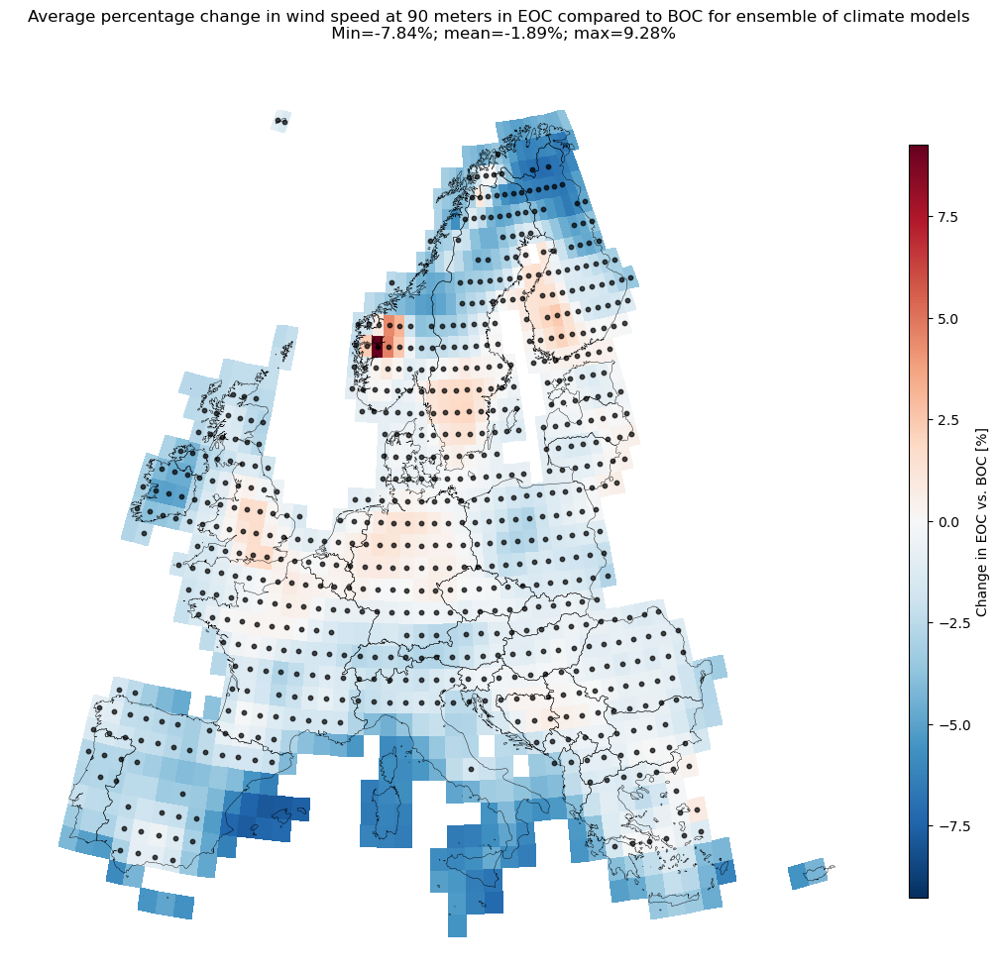

In [169]:
# Plotting % difference for ensemble of models - EOC vs. BOC; wnd90m 

i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind_selection: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    BOC = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_GWA_corrected_mean'
    EOC = f'Europe_{CMIP6_model}_ssp585_70_99_wnd90m_GWA_corrected_mean'
    if i == 0:
        total_change = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100/len(CMIP6_models_wind_selection)
    else:
        total_change += ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100/len(CMIP6_models_wind_selection)
    total_change = total_change.reset_coords(['band','spatial_ref'], drop=True)
    # Calculating direction of change matrix: 
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
    i = i+1;

# Defining points with uncertain direction of change:
i = 0;
diff_sum = 0
for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum = locals()[percent_diff]
    else: 
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum += locals()[percent_diff]
    i = i+1;
diff_sum = abs(diff_sum)
# Matrix with points smaller than 6 out of 8: 
diff_sum_matrix = xr.where(abs(diff_sum) < 6,1,0)
# points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]
points_df = diff_sum_matrix.to_dataframe(name='capacity factor')[diff_sum_matrix.to_dataframe(name='capacity factor')['capacity factor'] == 1]

min_val = np.nanmin(total_change)
max_val = np.nanmax(total_change)
mean_val = np.nanmean(total_change)
abs_max = np.nanmax(abs(total_change))

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')
norm = TwoSlopeNorm(vmin=-abs_max, vcenter=0, vmax=abs_max);
im = total_change.plot(ax=ax,transform=plate(),cmap="RdBu_r",#cbar_kwargs={'colorbar': False},
                  norm=norm);
cb = im.colorbar.remove();
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False);
ax.scatter(points_df['lon'],points_df['lat'],s=10,color='black',alpha=0.7,transform=plate())
fig.colorbar(im, ax=ax, location='right', fraction=.1,shrink=0.8,aspect=40,norm=norm,cmap="RdBu_r",label='Change in EOC vs. BOC [%]')
fig.suptitle(f'Average percentage change in wind speed at 90 meters in EOC compared to BOC for ensemble of climate models \n Min={round(min_val,2)}%; mean={round(mean_val,2)}%; max={round(max_val,2)}%');

# Saving figure to file: 
plot_filename = (f'Ensemble_total_percentage_change_wnd90m_EOC_vs_BOC.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

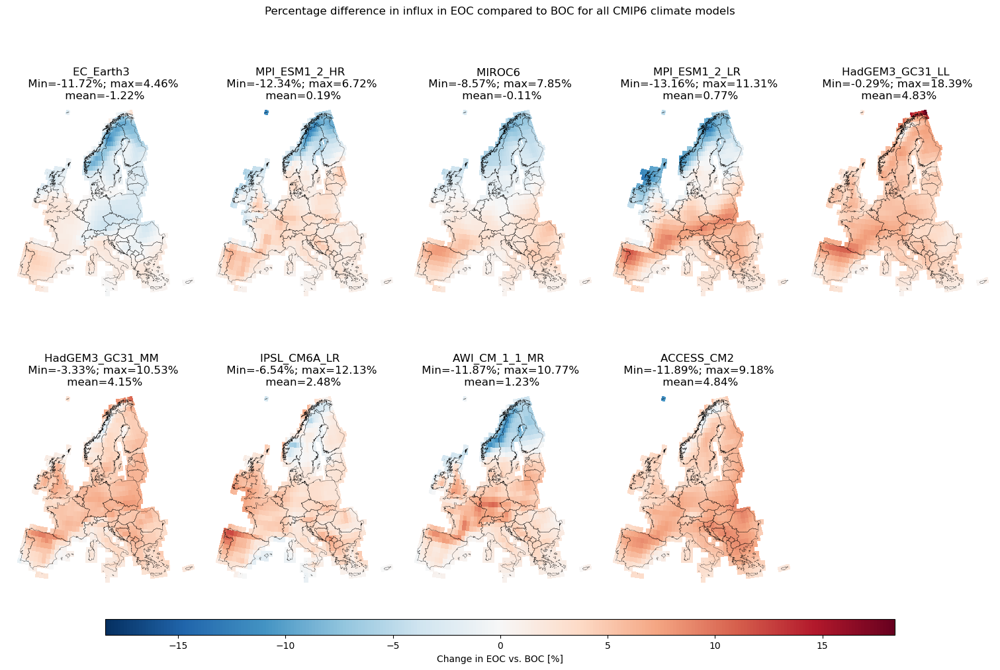

In [170]:
# Plotting % difference EOC vs. BOC influx 
nr_of_decimals = 2

# Finding global absolute max for common colorbar: 
abs_max_global = 0
for CMIP6_model in CMIP6_models_solar: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    BOC = f'Europe_{CMIP6_model}_ssp585_15_22_influx_corrected_mean'
    EOC = f'Europe_{CMIP6_model}_ssp585_70_99_influx_corrected_mean'
    percent_diff = f'Europe_{CMIP6_model}_ssp585_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    abs_max_local = np.nanmax(abs(locals()[percent_diff]))
    if abs_max_local > abs_max_global: 
        abs_max_global = abs_max_local

fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10),layout='constrained')
i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_solar: 
    CMIP6_model = CMIP6_model.replace("-", "_")

    BOC = f'Europe_{CMIP6_model}_ssp585_15_22_influx_corrected_mean'
    EOC = f'Europe_{CMIP6_model}_ssp585_70_99_influx_corrected_mean'

    percent_diff = f'Europe_{CMIP6_model}_ssp585_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    # locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

    min_val = np.nanmin(locals()[percent_diff])
    max_val = np.nanmax(locals()[percent_diff])
    mean_val = np.nanmean(locals()[percent_diff])
    abs_max = np.nanmax(abs(locals()[percent_diff]))
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);

    im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                    norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.8,aspect=50, norm=norm, cmap="RdBu_r", label='Change in EOC vs. BOC [%]')
fig.suptitle(f'Percentage difference in influx in EOC compared to BOC for all CMIP6 climate models');
fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'EOC_vs_BOC_percentage_diff_influx.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

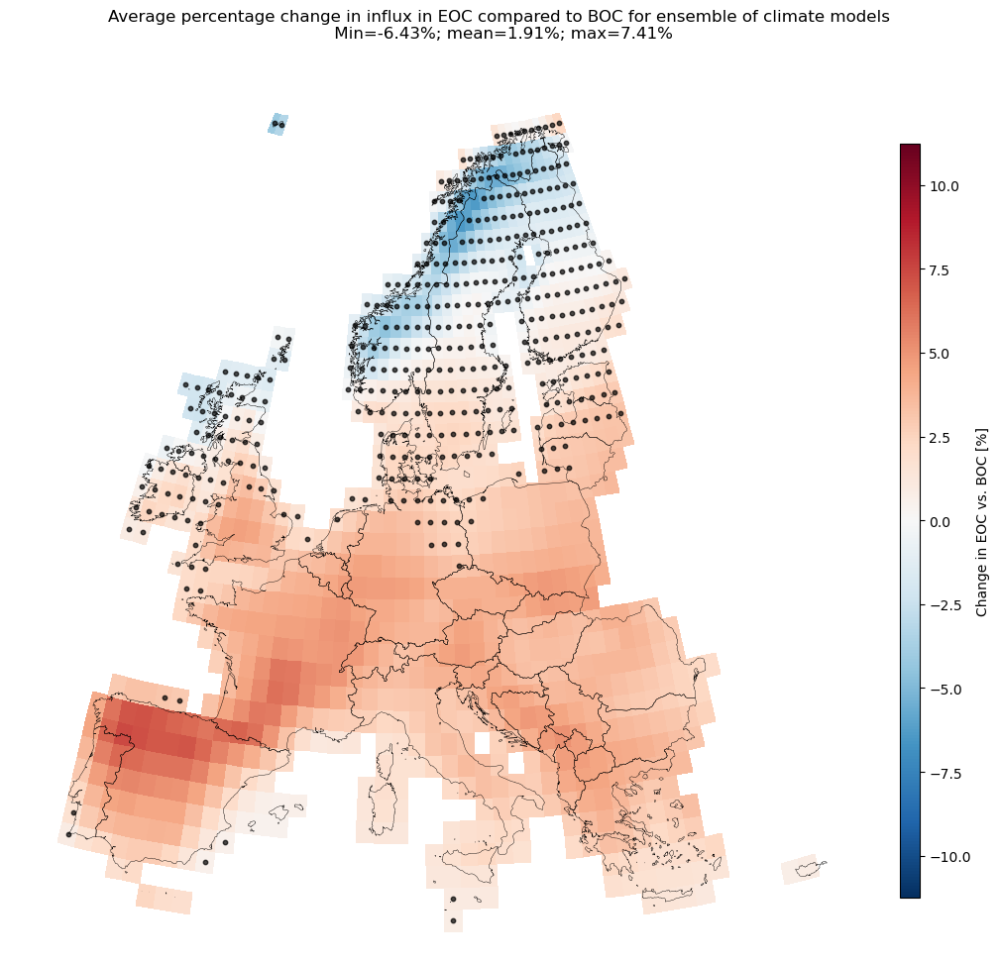

In [171]:
# Plotting % difference for ensemble of models - EOC vs. BOC; influx 

i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_solar: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    BOC = f'Europe_{CMIP6_model}_ssp585_15_22_influx_corrected_mean'
    EOC = f'Europe_{CMIP6_model}_ssp585_70_99_influx_corrected_mean'
    if i == 0:
        total_change = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    else:
        total_change += ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    # Calculating direction of change matrix: 
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
    i = i+1;
total_change = total_change/len(CMIP6_models_solar)
# Defining points with uncertain direction of change:
i = 0;
diff_sum = 0
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum = locals()[percent_diff]
    else: 
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum += locals()[percent_diff]
    i = i+1;
diff_sum = abs(diff_sum)
# Matrix with points smaller than 7 out of 9: 
diff_sum_matrix = xr.where(abs(diff_sum) < 7,1,0)
# points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]
points_df = diff_sum_matrix.to_dataframe(name='capacity factor')[diff_sum_matrix.to_dataframe(name='capacity factor')['capacity factor'] == 1]

min_val = np.nanmin(total_change)
max_val = np.nanmax(total_change)
mean_val = np.nanmean(total_change)
# abs_max = np.nanmax(abs(total_change))
abs_max = 11.24

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')
norm = TwoSlopeNorm(vmin=-abs_max, vcenter=0, vmax=abs_max);
im = total_change.plot(ax=ax,transform=plate(),cmap="RdBu_r",#cbar_kwargs={'colorbar': False},
                  norm=norm);
cb = im.colorbar.remove();
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False);
ax.scatter(points_df['lon'],points_df['lat'],s=10,color='black',alpha=0.7,transform=plate())
fig.colorbar(im, ax=ax, location='right', fraction=.1,shrink=0.8,aspect=40,norm=norm,cmap="RdBu_r",label='Change in EOC vs. BOC [%]')
fig.suptitle(f'Average percentage change in influx in EOC compared to BOC for ensemble of climate models \n Min={round(min_val,2)}%; mean={round(mean_val,2)}%; max={round(max_val,2)}%');

# Saving figure to file: 
plot_filename = (f'Ensemble_total_percentage_change_influx_EOC_vs_BOC.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

## Calculation of CF and comparison between EOC and BOC

In [172]:
# Generating average CF per year for wind for BOC:
overwrite = 0;

date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000

ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/'
output_folder_path_PV = f'E://Cutouts/CMIP6_BOC/Annual average CF per cell/PV/'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
        corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_wnd90m_GWA_corrected'
        locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
        my_file = Path(cutout_path)
        name = f'CF_avg_wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'    # Defining average CF filename: 
        filename = f'{name}.nc'
        path = f'{output_folder_path}{filename}'
        if cutout_name in locals():
            if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
                # Creating average wind CF:
                print(f'Creating "{filename}"')
                locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True)
                locals()[name].to_netcdf(path=path)      # Saving average CF to file
            else:
                locals()[name] = xr.open_dataarray(path)
                locals()[name] = locals()[name].load()
                print(f'"{filename}" already exists in "{path}". ')
        else: 
            print(f'File "{path}" skipped. The cutout does not exist. ')
# PV: 
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")       
    for ssp_variant in ssp_variants:
        corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_influx_corrected'
        cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
        locals()[cutout_name].data['influx'] = locals()[corrected_data_name]
        my_file = Path(cutout_path)
        name = f'CF_avg_PV_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'     # Defining average CF filename: 
        filename = f'{name}.nc'
        path = f'{output_folder_path_PV}{filename}'
        if cutout_name in locals():
            if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
                # Creating PV timeseries:
                print(f'Creating "{filename}"')
                locals()[name] = locals()[cutout_name].pv(panel=PV_panel,orientation="latitude_optimal",capacity_factor=True)
                locals()[name].to_netcdf(path=path)      # Saving average CF to file
            else:
                locals()[name] = xr.open_dataarray(path)
                locals()[name] = locals()[name].load()
                print(f'"{filename}" already exists in "{path}". ')
        else: 
            print(f'File "{path}" skipped. The cutout does not exist. ')
            
# Output all prepared files: 
prepared_files = os.listdir(output_folder_path)
print(f'\nPrepared files: ')
print(*prepared_files, sep='\n')

prepared_files = os.listdir(output_folder_path)
print(*prepared_files, sep='\n')

"CF_avg_wind_EC_Earth3_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_EC_Earth3_ssp585_15_22.nc". 
"CF_avg_wind_MPI_ESM1_2_HR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_MPI_ESM1_2_HR_ssp585_15_22.nc". 
"CF_avg_wind_MIROC6_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_MIROC6_ssp585_15_22.nc". 
"CF_avg_wind_MPI_ESM1_2_LR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_MPI_ESM1_2_LR_ssp585_15_22.nc". 
"CF_avg_wind_HadGEM3_GC31_LL_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_HadGEM3_GC31_LL_ssp585_15_22.nc". 
"CF_avg_wind_HadGEM3_GC31_MM_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/Wind/CF_avg_wind_HadGEM3_GC31_MM_ssp585_15_22.nc". 
"CF_avg_wind_IPSL_CM6A_LR_ssp585_15_22.nc"

In [173]:
# Generating average CF per year for wind for EOC:
overwrite = 0;

date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2070-01-01"
end_date = "2099-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000

ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/'
output_folder_path_PV = f'E://Cutouts/CMIP6_EOC/Annual average CF per cell/PV/'

for CMIP6_model in CMIP6_models_wind:
    CMIP6_model = CMIP6_model.replace("-", "_")
    for ssp_variant in ssp_variants:
        cutout_name = f'Europe_{CMIP6_model}_ssp585_70_99'
        corrected_data_name = f'Europe_{CMIP6_model}_ssp585_70_99_wnd90m_GWA_corrected'
        locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
        my_file = Path(cutout_path)
        name = f'CF_avg_wind_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'    # Defining average CF filename: 
        filename = f'{name}.nc'
        path = f'{output_folder_path}{filename}'
        if cutout_name in locals():
            if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
                # Creating average wind CF:
                print(f'Creating "{filename}"')
                locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True)
                locals()[name].to_netcdf(path=path)      # Saving average CF to file
            else:
                locals()[name] = xr.open_dataarray(path)
                locals()[name] = locals()[name].load()
                print(f'"{filename}" already exists in "{path}". ')
        else: 
            print(f'File "{path}" skipped. The cutout does not exist. ')
# PV: 
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    # if CMIP6_model == 'MIROC6':
    #     overwrite = 1
    # else:
    #     overwrite = 0
    for ssp_variant in ssp_variants:
        corrected_data_name = f'Europe_{CMIP6_model}_ssp585_70_99_influx_corrected'
        cutout_name = f'Europe_{CMIP6_model}_ssp585_70_99'
        locals()[cutout_name].data['influx'] = locals()[corrected_data_name]
        my_file = Path(cutout_path)
        name = f'CF_avg_PV_{CMIP6_model}_{ssp_variant}_{yy_start}_{yy_end}'     # Defining average CF filename: 
        filename = f'{name}.nc'
        path = f'{output_folder_path_PV}{filename}'
        if cutout_name in locals():
            if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
                # Creating PV timeseries:
                print(f'Creating "{filename}"')
                locals()[name] = locals()[cutout_name].pv(panel=PV_panel,orientation="latitude_optimal",capacity_factor=True)
                locals()[name].to_netcdf(path=path)      # Saving average CF to file
            else:
                locals()[name] = xr.open_dataarray(path)
                locals()[name] = locals()[name].load()
                print(f'"{filename}" already exists in "{path}". ')
        else: 
            print(f'File "{path}" skipped. The cutout does not exist. ')
            
# Output all prepared files: 
prepared_files = os.listdir(output_folder_path)
print(f'\nPrepared files: ')
print(*prepared_files, sep='\n')

"CF_avg_wind_EC_Earth3_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_avg_wind_EC_Earth3_ssp585_70_99.nc". 
"CF_avg_wind_MPI_ESM1_2_HR_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_avg_wind_MPI_ESM1_2_HR_ssp585_70_99.nc". 
"CF_avg_wind_MIROC6_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_avg_wind_MIROC6_ssp585_70_99.nc". 
"CF_avg_wind_MPI_ESM1_2_LR_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_avg_wind_MPI_ESM1_2_LR_ssp585_70_99.nc". 
"CF_avg_wind_HadGEM3_GC31_LL_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_avg_wind_HadGEM3_GC31_LL_ssp585_70_99.nc". 
"CF_avg_wind_HadGEM3_GC31_MM_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_avg_wind_HadGEM3_GC31_MM_ssp585_70_99.nc". 
"CF_avg_wind_IPSL_CM6A_LR_ssp585_70_99.nc"

In [175]:
# Creating CF timeseries for every grid cell for EOC: 

overwrite = 0;
date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2070-01-01"
end_date = "2099-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000
ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/'

for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_wnd90m_GWA_corrected'
    locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
    my_file = Path(cutout_path)
    name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'    # Defining average CF filename: 
    filename = f'{name}.nc'
    path = f'{output_folder_path}{filename}'
    if cutout_name in locals():
        if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
            # Creating average wind CF:
            print(f'Creating "{filename}"')
            locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True,capacity_factor_timeseries=True)
            locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name].to_netcdf(path=path)      # Saving average CF to file
        else:
            locals()[name] = xr.open_dataarray(path)
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name] = locals()[name].load()
            print(f'"{filename}" already exists in "{path}". ')
    else: 
        print(f'File "{path}" skipped. The cutout does not exist. ')

# # EC-Earth3 with wind 100m:
# cutout_name = f'Europe_EC_Earth3_ssp585_{yy_start}_{yy_end}_wind_100m'
# corrected_data_name = f'Europe_EC_Earth3_ssp585_{yy_start}_{yy_end}_wnd90m_power_law_GWA_corrected'
# locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
# my_file = Path(cutout_path)
# name = f'CF_timeseries_per_cell_wind_EC_Earth3_ssp585_{yy_start}_{yy_end}_wind_100m'    # Defining average CF filename: 
# filename = f'{name}.nc'
# path = f'{output_folder_path}{filename}'
# if cutout_name in locals():
#     if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
#         # Creating average wind CF:
#         print(f'Creating "{filename}"')
#         locals()[name] = locals()[cutout_name].wind(turbine=turbine,capacity_factor=True,capacity_factor_timeseries=True)
#         locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
#         locals()[name].to_netcdf(path=path)      # Saving average CF to file
#     else:
#         locals()[name] = xr.open_dataarray(path)
#         # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
#         print(f'"{filename}" already exists in "{path}". ')
# else: 
#     print(f'File "{path}" skipped. The cutout does not exist. ')

"CF_timeseries_per_cell_wind_EC_Earth3_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_timeseries_per_cell_wind_EC_Earth3_ssp585_70_99.nc". 
"CF_timeseries_per_cell_wind_MPI_ESM1_2_HR_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_timeseries_per_cell_wind_MPI_ESM1_2_HR_ssp585_70_99.nc". 
"CF_timeseries_per_cell_wind_MPI_ESM1_2_LR_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_timeseries_per_cell_wind_MPI_ESM1_2_LR_ssp585_70_99.nc". 
"CF_timeseries_per_cell_wind_HadGEM3_GC31_LL_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_timeseries_per_cell_wind_HadGEM3_GC31_LL_ssp585_70_99.nc". 
"CF_timeseries_per_cell_wind_HadGEM3_GC31_MM_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/Wind/CF_timeseries_per_cell_wind_HadGEM3_GC31_MM_ssp585_70_99.nc". 
"CF_timeseries_per_cell_wind_I

In [176]:
# Creating PV CF timeseries for every grid cell for BOC: 

overwrite = 0;
date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000
ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_BOC/Annual average CF per cell/PV/'

for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_influx_corrected'
    locals()[cutout_name].data['influx'] = locals()[corrected_data_name]
    my_file = Path(cutout_path)
    name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'    # Defining average CF filename: 
    filename = f'{name}.nc'
    path = f'{output_folder_path}{filename}'
    if cutout_name in locals():
        if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
            # Creating average wind CF:
            print(f'Creating "{filename}"')
            locals()[name] = locals()[cutout_name].pv(panel=PV_panel,orientation="latitude_optimal",capacity_factor=True,capacity_factor_timeseries=True)
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name].to_netcdf(path=path)      # Saving average CF to file
        else:
            locals()[name] = xr.open_dataarray(path)
            locals()[name] = locals()[name].load()
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            print(f'"{filename}" already exists in "{path}". ')
    else: 
        print(f'File "{path}" skipped. The cutout does not exist. ')

"CF_timeseries_per_cell_PV_EC_Earth3_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_EC_Earth3_ssp585_15_22.nc". 
"CF_timeseries_per_cell_PV_MPI_ESM1_2_HR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_MPI_ESM1_2_HR_ssp585_15_22.nc". 
"CF_timeseries_per_cell_PV_MIROC6_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_MIROC6_ssp585_15_22.nc". 
"CF_timeseries_per_cell_PV_MPI_ESM1_2_LR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_MPI_ESM1_2_LR_ssp585_15_22.nc". 
"CF_timeseries_per_cell_PV_HadGEM3_GC31_LL_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_HadGEM3_GC31_LL_ssp585_15_22.nc". 
"CF_timeseries_per_cell_PV_HadGEM3_GC31_MM_ssp585_15_22.nc" already exists in 

In [178]:
# Creating PV CF timeseries for every grid cell for EOC: 

overwrite = 0;
date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2070-01-01"
end_date = "2099-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000
ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_EOC/Annual average CF per cell/PV/'

for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_influx_corrected'
    locals()[cutout_name].data['influx'] = locals()[corrected_data_name]
    my_file = Path(cutout_path)
    name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'    # Defining average CF filename: 
    filename = f'{name}.nc'
    path = f'{output_folder_path}{filename}'
    if cutout_name in locals():
        if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
            # Creating average wind CF:
            print(f'Creating "{filename}"')
            locals()[name] = locals()[cutout_name].pv(panel=PV_panel,orientation="latitude_optimal",capacity_factor=True,capacity_factor_timeseries=True)
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name].to_netcdf(path=path)      # Saving average CF to file
        else:
            locals()[name] = xr.open_dataarray(path)
            locals()[name] = locals()[name].load()
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            print(f'"{filename}" already exists in "{path}". ')
    else: 
        print(f'File "{path}" skipped. The cutout does not exist. ')

"CF_timeseries_per_cell_PV_EC_Earth3_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_EC_Earth3_ssp585_70_99.nc". 
"CF_timeseries_per_cell_PV_MPI_ESM1_2_HR_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_MPI_ESM1_2_HR_ssp585_70_99.nc". 
"CF_timeseries_per_cell_PV_MIROC6_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_MIROC6_ssp585_70_99.nc". 
"CF_timeseries_per_cell_PV_MPI_ESM1_2_LR_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_MPI_ESM1_2_LR_ssp585_70_99.nc". 
"CF_timeseries_per_cell_PV_HadGEM3_GC31_LL_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Annual average CF per cell/PV/CF_timeseries_per_cell_PV_HadGEM3_GC31_LL_ssp585_70_99.nc". 
"CF_timeseries_per_cell_PV_HadGEM3_GC31_MM_ssp585_70_99.nc" already exists in 

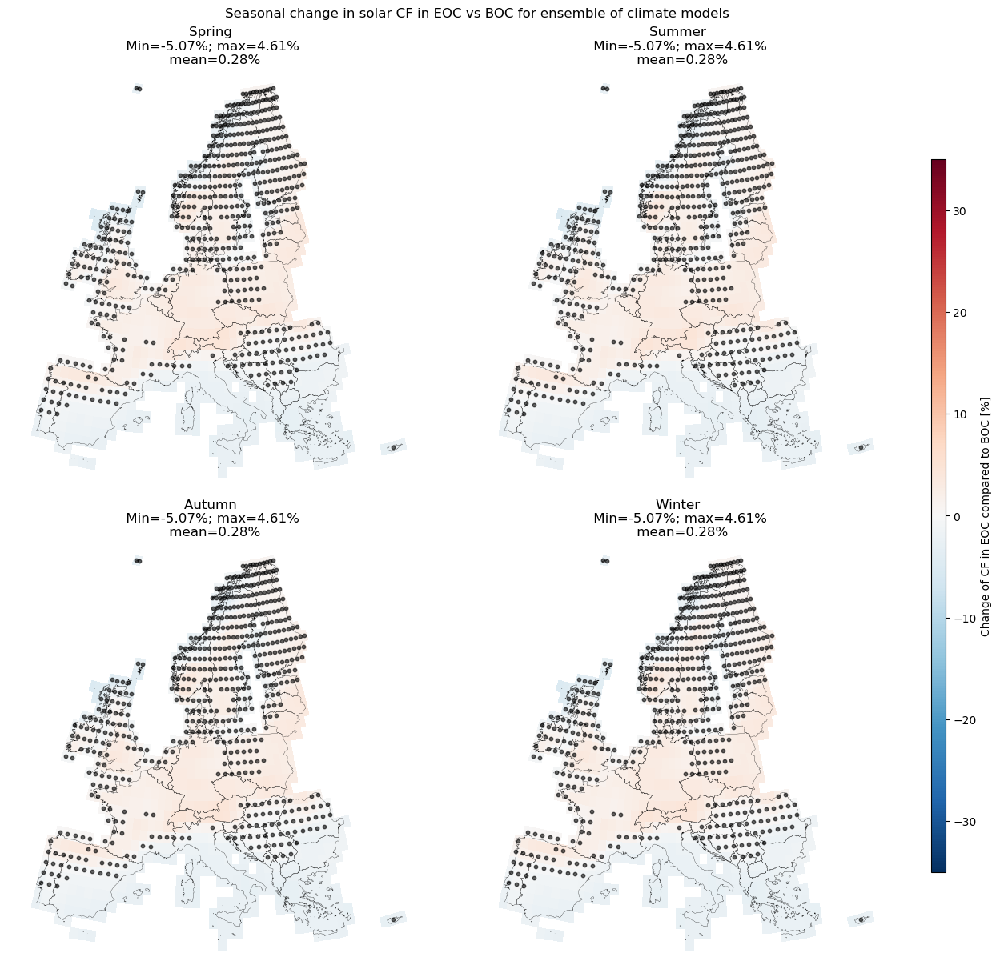

In [179]:
# Creating a figure with all 4 seasons with seasonal comparison of ensemble for PV: 

# Plotting  percentage difference 
nr_of_decimals = 2
seasons = ['Spring', 'Summer','Autumn','Winter'];

fig, axs = plt.subplots(2,2,subplot_kw={"projection": projection},figsize=(13,12), layout='constrained')
fig.suptitle(f'Seasonal change in solar CF in EOC vs BOC for ensemble of climate models');
ii=0;
for season in seasons:
    abs_max_global = 0
    i = 0;
    for CMIP6_model in CMIP6_models_solar:
        CMIP6_model = CMIP6_model.replace("-", "_")
        if i == 0:
            BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
            BOC = (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
            EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
            EOC = (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
        else: 
            BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
            BOC += (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
            EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
            EOC += (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
        i = i+1;
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    percent_diff_sum = ((EOC - BOC) / BOC)*100
    abs_max_local = np.nanmax(abs(percent_diff_sum))
    abs_max_global = abs_max_local

    # Calculating direction-of-change matrix:
    i = 0;      # Initializing counter for subplot number
    for CMIP6_model in CMIP6_models_solar:
        CMIP6_model = CMIP6_model.replace("-", "_")
        cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
        BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
        EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        locals()[percent_diff] = ((EOC - BOC) / BOC)*100
        locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
        i = i+1;

    # Defining points with uncertain direction of change:
    i = 0;
    diff_sum = 0
    for CMIP6_model in CMIP6_models_solar:
        CMIP6_model = CMIP6_model.replace("-", "_")
        if i == 0:
            percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
            diff_sum = locals()[percent_diff]
        else: 
            percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
            diff_sum += locals()[percent_diff]
        i = i+1;
    diff_sum = abs(diff_sum)
    # Matrix with points smaller than 7 out of 9: 
    diff_sum_matrix = xr.where(abs(diff_sum) < 7,1,0)
    points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]

    min_val = np.nanmin(percent_diff_sum)
    max_val = np.nanmax(percent_diff_sum)
    mean_val = np.nanmean(percent_diff_sum)

    # plotting:
    abs_max_global = 35;
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
    im = percent_diff_sum.plot(ax=axs.flat[ii],transform=plate(),norm=norm,cmap="RdBu_r");
    im.colorbar.remove()
    axs.flat[ii].scatter(points_df['lon'],points_df['lat'],s=10,color='black',alpha=0.6,transform=plate())
    Europe.plot(ax=axs.flat[ii], edgecolor='k',color="None",transform=plate(), aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
    ii = ii+1;
fig.colorbar(im, ax=axs, location='right', fraction=.1,shrink=0.8,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
# Saving figure to file: 
plot_filename = f'Ensemble_percentage_change_CF_PV_all_seasons_EOC_vs_BOC.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

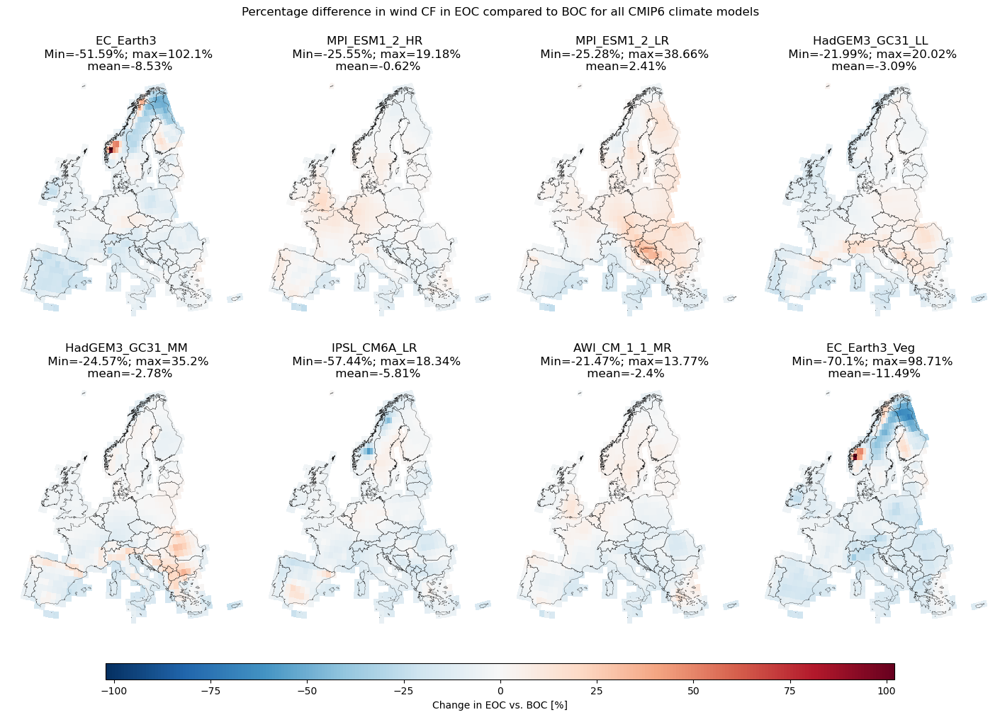

In [180]:
# Plotting % difference EOC vs. BOC for CF average per grid cell:
nr_of_decimals = 2

# Finding global absolute max for common colorbar: 
abs_max_global = 0
for CMIP6_model in CMIP6_models_wind_selection: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    BOC = f'CF_avg_wind_{CMIP6_model}_ssp585_15_22'
    EOC = f'CF_avg_wind_{CMIP6_model}_ssp585_70_99'
    percent_diff = f'CF_avg_{CMIP6_model}_ssp585_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    abs_max_local = np.nanmax(abs(locals()[percent_diff]))
    if abs_max_local > abs_max_global: 
        abs_max_global = abs_max_local

fig,axs = plt.subplots(2,4,subplot_kw={"projection": projection},figsize=(14,10),layout='constrained')
i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind_selection: 
    CMIP6_model = CMIP6_model.replace("-", "_")

    BOC = f'CF_avg_wind_{CMIP6_model}_ssp585_15_22'
    EOC = f'CF_avg_wind_{CMIP6_model}_ssp585_70_99'

    percent_diff = f'CF_avg_{CMIP6_model}_ssp585_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    # locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

    min_val = np.nanmin(locals()[percent_diff])
    max_val = np.nanmax(locals()[percent_diff])
    mean_val = np.nanmean(locals()[percent_diff])
    abs_max = np.nanmax(abs(locals()[percent_diff]))
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);

    im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                    norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.8,aspect=50, norm=norm, cmap="RdBu_r", label='Change in EOC vs. BOC [%]')
fig.suptitle(f'Percentage difference in wind CF in EOC compared to BOC for all CMIP6 climate models');
# fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'EOC_vs_BOC_percentage_diff_wind_CF.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

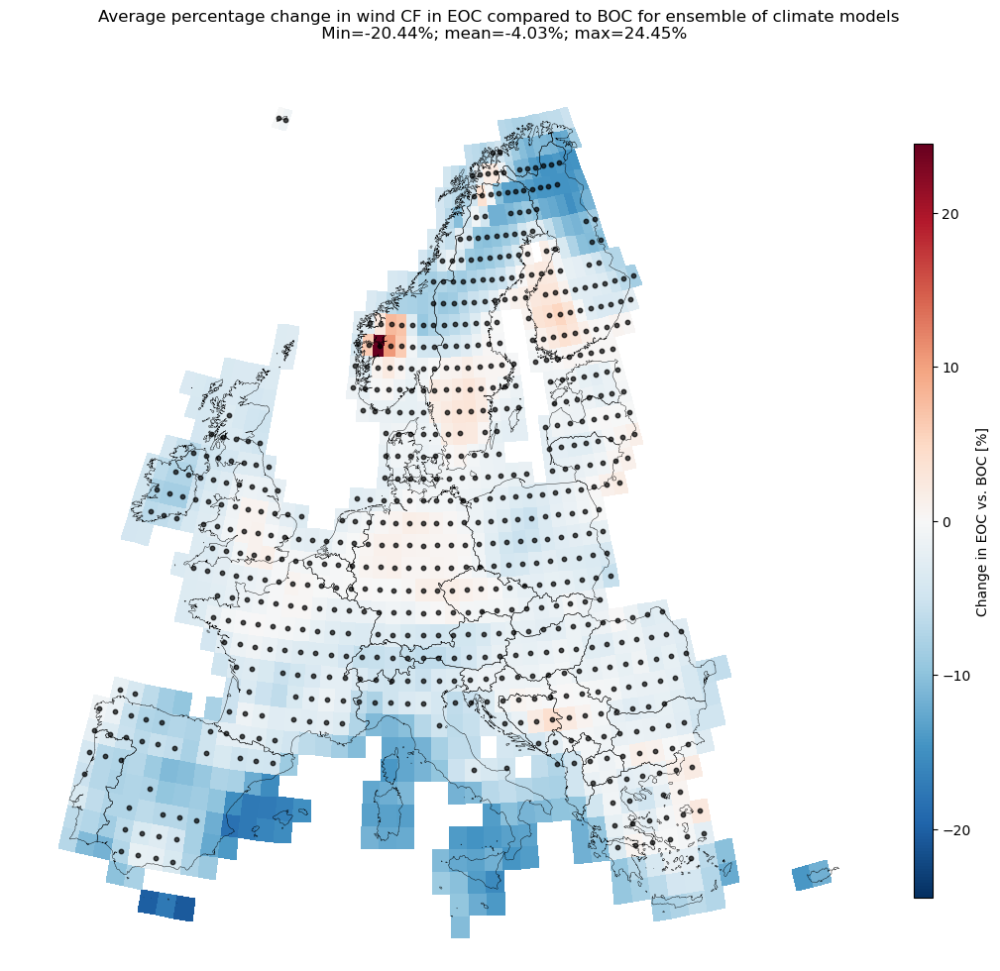

In [181]:
# Plotting % difference for ensemble of models - EOC vs. BOC; wind CF 

i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind_selection: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    BOC = f'CF_avg_wind_{CMIP6_model}_ssp585_15_22'
    EOC = f'CF_avg_wind_{CMIP6_model}_ssp585_70_99'
    if i == 0:
        total_change = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100/len(CMIP6_models_wind_selection)
    else:
        total_change += ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100/len(CMIP6_models_wind_selection)
    total_change = total_change.reset_coords(['band','spatial_ref'], drop=True)
    # Calculating direction of change matrix: 
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
    i = i+1;

# Defining points with uncertain direction of change:
i = 0;
diff_sum = 0
for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum = locals()[percent_diff]
    else: 
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum += locals()[percent_diff]
    i = i+1;
diff_sum = abs(diff_sum)
# Matrix with points smaller than 6 out of 8: 
diff_sum_matrix = xr.where(abs(diff_sum) < 6,1,0)
# points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]
points_df = diff_sum_matrix.to_dataframe(name='capacity factor')[diff_sum_matrix.to_dataframe(name='capacity factor')['capacity factor'] == 1]

min_val = np.nanmin(total_change)
max_val = np.nanmax(total_change)
mean_val = np.nanmean(total_change)
abs_max = np.nanmax(abs(total_change))

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')
norm = TwoSlopeNorm(vmin=-abs_max, vcenter=0, vmax=abs_max);
im = total_change.plot(ax=ax,transform=plate(),cmap="RdBu_r",#cbar_kwargs={'colorbar': False},
                  norm=norm);
cb = im.colorbar.remove();
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False);
ax.scatter(points_df['lon'],points_df['lat'],s=10,color='black',alpha=0.7,transform=plate())
fig.colorbar(im, ax=ax, location='right', fraction=.1,shrink=0.8,aspect=40,norm=norm,cmap="RdBu_r",label='Change in EOC vs. BOC [%]')
fig.suptitle(f'Average percentage change in wind CF in EOC compared to BOC for ensemble of climate models \n Min={round(min_val,2)}%; mean={round(mean_val,2)}%; max={round(max_val,2)}%');

# Saving figure to file: 
plot_filename = (f'Ensemble_total_percentage_change_CF_wind_EOC_vs_BOC.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

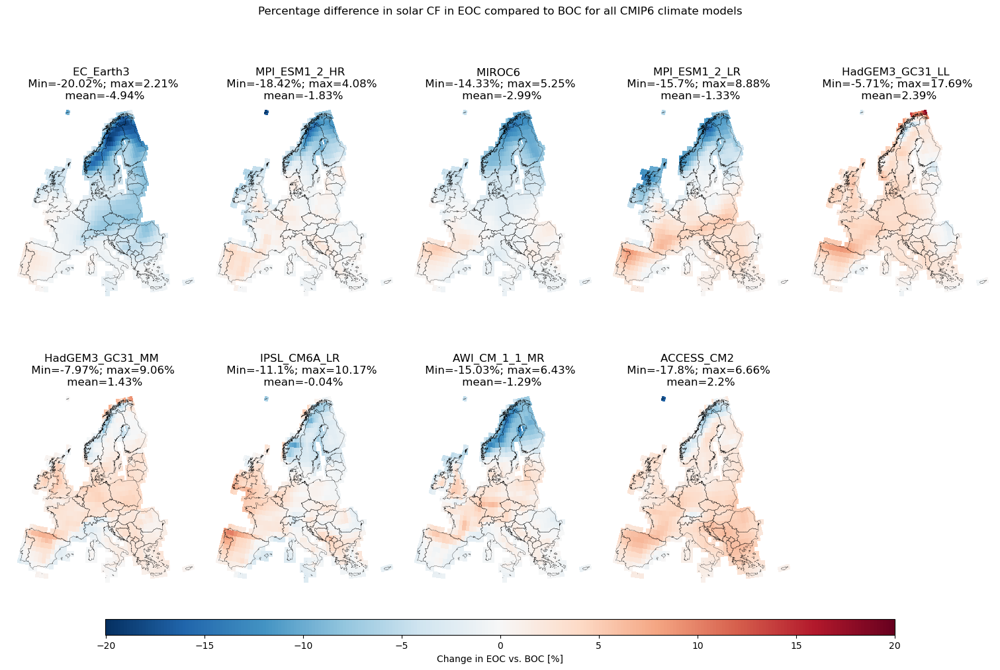

In [182]:
# Plotting % difference EOC vs. BOC for solar CF average per grid cell:
nr_of_decimals = 2

# Finding global absolute max for common colorbar: 
abs_max_global = 0
for CMIP6_model in CMIP6_models_solar: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    BOC = f'CF_avg_PV_{CMIP6_model}_ssp585_15_22'
    EOC = f'CF_avg_PV_{CMIP6_model}_ssp585_70_99'
    percent_diff = f'CF_avg_{CMIP6_model}_ssp585_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    abs_max_local = np.nanmax(abs(locals()[percent_diff]))
    if abs_max_local > abs_max_global: 
        abs_max_global = abs_max_local

fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(15,10),layout='constrained')
i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_solar: 
    CMIP6_model = CMIP6_model.replace("-", "_")

    BOC = f'CF_avg_PV_{CMIP6_model}_ssp585_15_22'
    EOC = f'CF_avg_PV_{CMIP6_model}_ssp585_70_99'

    percent_diff = f'CF_avg_{CMIP6_model}_ssp585_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    # locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

    min_val = np.nanmin(locals()[percent_diff])
    max_val = np.nanmax(locals()[percent_diff])
    mean_val = np.nanmean(locals()[percent_diff])
    abs_max = np.nanmax(abs(locals()[percent_diff]))
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);

    im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.7,'aspect': 40, 'label': f"Scaling correction factor"},
                    norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.8,aspect=50, norm=norm, cmap="RdBu_r", label='Change in EOC vs. BOC [%]')
fig.suptitle(f'Percentage difference in solar CF in EOC compared to BOC for all CMIP6 climate models');
fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'EOC_vs_BOC_percentage_diff_influx_CF.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

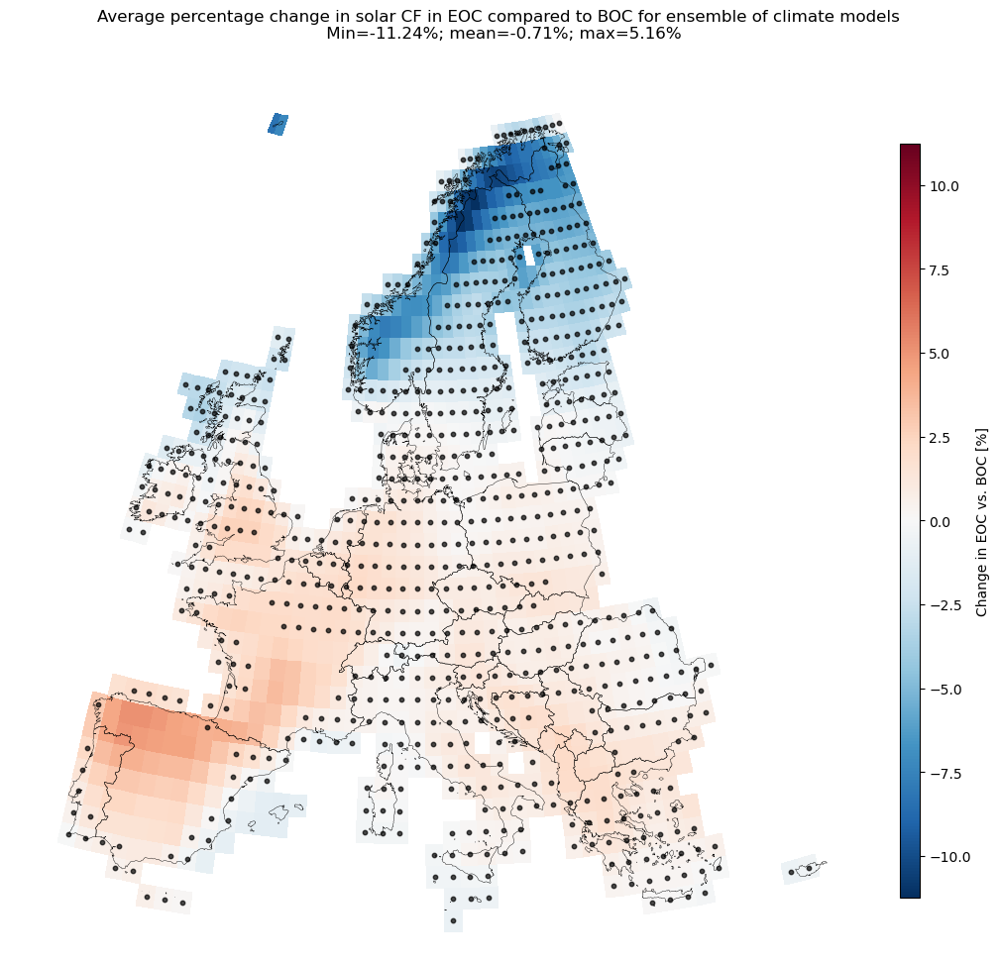

In [183]:
# Plotting % difference for ensemble of models - EOC vs. BOC; influx CF

i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_solar: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    BOC = f'CF_avg_PV_{CMIP6_model}_ssp585_15_22'
    EOC = f'CF_avg_PV_{CMIP6_model}_ssp585_70_99'
    if i == 0:
        total_change = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100/len(CMIP6_models_solar)
    else:
        total_change += ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100/len(CMIP6_models_solar)
    # Calculating direction of change matrix: 
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((locals()[EOC] - locals()[BOC]) / locals()[BOC])*100
    locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
    i = i+1;
total_change = total_change.reset_coords(['band','spatial_ref'], drop=True)
# Defining points with uncertain direction of change:
i = 0;
diff_sum = 0
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum = locals()[percent_diff]
    else: 
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum += locals()[percent_diff]
    i = i+1;
diff_sum = abs(diff_sum)
# Matrix with points smaller than 7 out of 9: 
diff_sum_matrix = xr.where(abs(diff_sum) < 7,1,0)
# points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]
points_df = diff_sum_matrix.to_dataframe(name='capacity factor')[diff_sum_matrix.to_dataframe(name='capacity factor')['capacity factor'] == 1]

min_val = np.nanmin(total_change)
max_val = np.nanmax(total_change)
mean_val = np.nanmean(total_change)
abs_max = np.nanmax(abs(total_change))

fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')
norm = TwoSlopeNorm(vmin=-abs_max, vcenter=0, vmax=abs_max);
im = total_change.plot(ax=ax,transform=plate(),cmap="RdBu_r",#cbar_kwargs={'colorbar': False},
                  norm=norm);
cb = im.colorbar.remove();
Europe.plot(ax=ax, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False);
ax.scatter(points_df['lon'],points_df['lat'],s=10,color='black',alpha=0.7,transform=plate())
fig.colorbar(im, ax=ax, location='right', fraction=.1,shrink=0.8,aspect=40,norm=norm,cmap="RdBu_r",label='Change in EOC vs. BOC [%]')
fig.suptitle(f'Average percentage change in solar CF in EOC compared to BOC for ensemble of climate models \n Min={round(min_val,2)}%; mean={round(mean_val,2)}%; max={round(max_val,2)}%');

# Saving figure to file: 
plot_filename = (f'Ensemble_total_percentage_change_CF_PV_EOC_vs_BOC.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

In [184]:
# fig,ax = plt.subplots(subplot_kw={"projection": projection},figsize=(12,10),layout='constrained')
# Europe.plot(ax=ax, edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
# Europe_EC_Earth3_ssp585_70_99_wnd90m_GWA_corrected_mean.plot(ax=ax,transform=plate());

In [185]:
# Calculating GWA-based correction factors for ERA5 for entire cutout including sea:

# Corr_factors_wind_ERA5_no_indicator_matrix = (gwa.fillna(0) / ERA5_wnd100m_mean)
path = f'E://Cutouts/Corrected ERA5/Corr_factors_wind_ERA5_no_indicator_matrix.nc'
# Corr_factors_wind_ERA5_no_indicator_matrix.to_netcdf(path=path)
Corr_factors_wind_ERA5_no_indicator_matrix = xr.open_dataarray(path)
# Corr_factors_wind_ERA5_no_indicator_matrix.plot();

In [186]:
# # Calculating correction factors without indicator matrix
# overwrite = 0

# output_folder_path_wind = f'E://Cutouts/CMIP6_BOC/Correction factors with sea areas/Wind/'
# output_folder_path_PV = f'E://Cutouts/CMIP6_BOC/Correction factors with sea areas/PV/'

# for CMIP6_model in CMIP6_models_wind:
#     CMIP6_model = CMIP6_model.replace("-", "_")
#     # Wind: 
#     mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_mean'
#     corr_factor_filename = f'Corrected_ERA5_Corr_factors_wind_{CMIP6_model}_no_indicator_matrix'
#     locals()[corr_factor_filename] = ((GWA_corrected_ERA5_wnd90m_coarse_mean) / (locals()[mean_da_name]))
#     path = f'{output_folder_path_wind}{corr_factor_filename}.nc'
#     if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
#         # Creating PV timeseries:
#         print(f'Creating "{corr_factor_filename}"')
#         locals()[corr_factor_filename].load()
#         locals()[corr_factor_filename].to_netcdf(path=path)      # Saving average CF to file
#     else:
#         locals()[corr_factor_filename] = xr.open_dataarray(path)
#         print(f'"{corr_factor_filename}" already exists in "{path}". ')

# for CMIP6_model in CMIP6_models_solar:
#     CMIP6_model = CMIP6_model.replace("-", "_")
#     # Wind: 
#     mean_da_name = f'Europe_{CMIP6_model}_ssp585_15_22_influx_mean'
#     corr_factor_filename = f'Corr_factors_PV_{CMIP6_model}_no_indicator_matrix'
#     locals()[corr_factor_filename] = ((ERA5_influx_coarse_mean) / (locals()[mean_da_name]))
#     path = f'{output_folder_path_PV}{corr_factor_filename}.nc'
#     if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
#         # Creating PV timeseries:
#         print(f'Creating "{corr_factor_filename}"')
#         locals()[corr_factor_filename].load()
#         locals()[corr_factor_filename].to_netcdf(path=path)      # Saving average CF to file
#     else:
#         locals()[corr_factor_filename] = xr.open_dataarray(path)
#         print(f'"{corr_factor_filename}" already exists in "{path}". ')

## Seasonal comparison

In [188]:
# # Seasonal comparison of wnd90m

# # Creating a figure with all 4 seasons with seasonal comparison of ensemble for wind: 
# nr_of_decimals = 2
# seasons = ['Spring', 'Summer','Autumn','Winter'];

# fig, axs = plt.subplots(2,2,subplot_kw={"projection": projection},figsize=(13,12), layout='constrained')
# fig.suptitle(f'Seasonal change in wind speed at 90 meters in EOC vs BOC for ensemble of climate models');
# ii=0;
# for season in seasons:
#     if season == 'Winter':
#         season_name = 'DJF'
#     if season == 'Summer':
#         season_name = 'JJA'
#     if season == 'Spring':
#         season_name = 'MAM'
#     if season == 'Autumn':
#         season_name = 'SON'

#     abs_max_global = 0
#     i = 0;
#     for CMIP6_model in CMIP6_models_wind_selection:
#         CMIP6_model = CMIP6_model.replace("-", "_")
#         if i == 0:
#             BOC_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_GWA_corrected'
#             BOC = (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
#             EOC_name = f'Europe_{CMIP6_model}_ssp585_70_99_wnd90m_GWA_corrected'
#             EOC = (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
#         else: 
#             BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
#             BOC += (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
#             EOC_name = f'Europe_{CMIP6_model}_ssp585_70_99_wnd90m_GWA_corrected'
#             EOC += (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
#         i = i+1;
#     percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
#     percent_diff_sum = ((EOC - BOC) / BOC)*100
#     abs_max_local = np.nanmax(abs(percent_diff_sum))
#     abs_max_global = abs_max_local

#     abs_max_global = 1.1;

#     i = 0;      # Initializing counter for subplot number
#     for CMIP6_model in CMIP6_models_wind_selection:
#         CMIP6_model = CMIP6_model.replace("-", "_")
#         cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
#         BOC_name = f'Europe_{CMIP6_model}_ssp585_15_22_wnd90m_GWA_corrected'
#         BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
#         EOC_name = f'Europe_{CMIP6_model}_ssp585_70_99_wnd90m_GWA_corrected'
#         EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
#         percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
#         locals()[percent_diff] = ((EOC - BOC) / BOC)*100
#         locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
#         i = i+1;

#     i = 0;
#     diff_sum = 0
#     for CMIP6_model in CMIP6_models_wind_selection:
#         CMIP6_model = CMIP6_model.replace("-", "_")
#         if i == 0:
#             percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
#             diff_sum = locals()[percent_diff]
#         else: 
#             percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
#             diff_sum += locals()[percent_diff]
#         i = i+1;
#     diff_sum = abs(diff_sum)
#     # Matrix with points smaller than 6: 
#     diff_sum_matrix = xr.where(abs(diff_sum) < 6,1,0)

#     points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]

#     min_val = np.nanmin(percent_diff_sum)
#     max_val = np.nanmax(percent_diff_sum)
#     mean_val = np.nanmean(percent_diff_sum)

#     # plotting:
#     abs_max_global = 38;
#     norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
#     im = percent_diff_sum.plot(ax=axs.flat[ii],transform=plate(),norm=norm,cmap="RdBu_r");
#     im.colorbar.remove()
#     axs.flat[ii].scatter(points_df['lon'],points_df['lat'],s=10,color='black',alpha=0.7,transform=plate())
#     Europe.plot(ax=axs.flat[ii], edgecolor='k',color="None",transform=plate(), aspect="equal",linewidth=0.2).set_frame_on(False)
#     axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
#     ii = ii+1;
# fig.colorbar(im, ax=axs, location='right', fraction=.1,shrink=0.8,aspect=50,norm=norm,cmap="RdBu_r",label='Change in EOC compared to BOC [%]')
# # Saving figure to file: 
# plot_filename = f'Ensemble_percentage_change_wnd90m_all_seasons_EOC_vs_BOC.png';
# # plt.savefig(plot_path(plot_filename), dpi=300);

In [189]:
# # Seasonal comparison of influx
 
# nr_of_decimals = 2
# seasons = ['Spring', 'Summer','Autumn','Winter'];

# fig, axs = plt.subplots(2,2,subplot_kw={"projection": projection},figsize=(13,12), layout='constrained')
# fig.suptitle(f'Seasonal change in influx in EOC vs BOC for ensemble of climate models');
# ii=0;
# for season in seasons:
#     if season == 'Winter':
#         season_name = 'DJF'
#     if season == 'Summer':
#         season_name = 'JJA'
#     if season == 'Spring':
#         season_name = 'MAM'
#     if season == 'Autumn':
#         season_name = 'SON'

#     abs_max_global = 0
#     i = 0;
#     for CMIP6_model in CMIP6_models_solar:
#         CMIP6_model = CMIP6_model.replace("-", "_")
#         if i == 0:
#             BOC_name = f'Europe_{CMIP6_model}_ssp585_15_22_influx_corrected'
#             BOC = (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
#             EOC_name = f'Europe_{CMIP6_model}_ssp585_70_99_influx_corrected'
#             EOC = (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
#         else: 
#             BOC_name = f'Europe_{CMIP6_model}_ssp585_15_22_influx_corrected'
#             BOC += (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
#             EOC_name = f'Europe_{CMIP6_model}_ssp585_70_99_influx_corrected'
#             EOC += (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
#         i = i+1;
#     percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
#     percent_diff_sum = ((EOC - BOC) / BOC)*100
#     abs_max_local = np.nanmax(abs(percent_diff_sum))
#     abs_max_global = abs_max_local

#     # Calculating direction-of-change matrix:
#     i = 0;      # Initializing counter for subplot number
#     for CMIP6_model in CMIP6_models_solar:
#         CMIP6_model = CMIP6_model.replace("-", "_")
#         cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
#         BOC_name = f'Europe_{CMIP6_model}_ssp585_15_22_influx_corrected'
#         BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
#         EOC_name = f'Europe_{CMIP6_model}_ssp585_70_99_influx_corrected'
#         EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
#         percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
#         locals()[percent_diff] = ((EOC - BOC) / BOC)*100
#         locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
#         i = i+1;

#     # Defining points with uncertain direction of change:
#     i = 0;
#     diff_sum = 0
#     for CMIP6_model in CMIP6_models_solar:
#         CMIP6_model = CMIP6_model.replace("-", "_")
#         if i == 0:
#             percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
#             diff_sum = locals()[percent_diff]
#         else: 
#             percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
#             diff_sum += locals()[percent_diff]
#         i = i+1;
#     diff_sum = abs(diff_sum)
#     # Matrix with points smaller than 7 out of 9: 
#     diff_sum_matrix = xr.where(abs(diff_sum) < 7,1,0)
#     points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]

#     min_val = np.nanmin(percent_diff_sum)
#     max_val = np.nanmax(percent_diff_sum)
#     mean_val = np.nanmean(percent_diff_sum)

#     # plotting:
#     abs_max_global = 35;
#     norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
#     im = percent_diff_sum.plot(ax=axs.flat[ii],transform=plate(),norm=norm,cmap="RdBu_r");
#     im.colorbar.remove()
#     axs.flat[ii].scatter(points_df['lon'],points_df['lat'],s=10,color='black',alpha=0.7,transform=plate())
#     Europe.plot(ax=axs.flat[ii], edgecolor='k',color="None",transform=plate(), aspect="equal",linewidth=0.2).set_frame_on(False)
#     axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
#     ii = ii+1;
# fig.colorbar(im, ax=axs, location='right', fraction=.1,shrink=0.8,aspect=50,norm=norm,cmap="RdBu_r",label='Change in EOC compared to BOC [%]')
# # Saving figure to file: 
# plot_filename = f'Ensemble_percentage_change_influx_all_seasons_EOC_vs_BOC.png';
# # plt.savefig(plot_path(plot_filename), dpi=300);

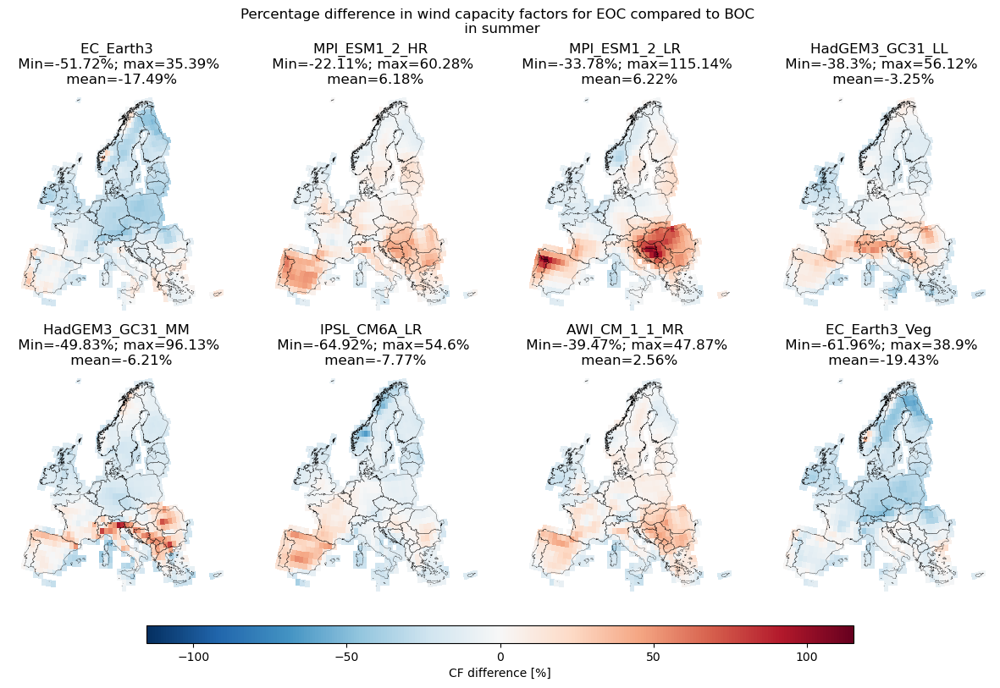

In [190]:
# Plotting  percentage difference 
nr_of_decimals = 2

# Select season to compare: 
season = 'summer'

if season == 'winter':
    season_name = 'DJF'
if season == 'summer':
    season_name = 'JJA'
if season == 'spring':
    season_name = 'MAM'
if season == 'autumn':
    season_name = 'SON'


# Finding global absolute max for common colorbar: 
abs_max_global = 0
for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
    EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((EOC - BOC) / BOC)*100
    abs_max_local = np.nanmax(abs(locals()[percent_diff]))
    if abs_max_local > abs_max_global and abs_max_local < 120: 
        abs_max_global = abs_max_local

fig,axs = plt.subplots(2,4,subplot_kw={"projection": projection},figsize=(12,8),layout='constrained')
fig.suptitle(f'Percentage difference in wind capacity factors for EOC compared to BOC \n in {season}');
i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
    EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((EOC - BOC) / BOC)*100
    # locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

    min_val = np.nanmin(locals()[percent_diff])
    max_val = np.nanmax(locals()[percent_diff])
    mean_val = np.nanmean(locals()[percent_diff])
    abs_max = np.nanmax(abs(locals()[percent_diff]))
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
    im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(), cmap="RdBu_r", norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=40,norm=norm,cmap="RdBu_r",label='CF difference [%]')

# Saving figure to file: 
plot_filename = (f'EOC_vs_BOC_wind_{season}_CF_percentage_diff.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

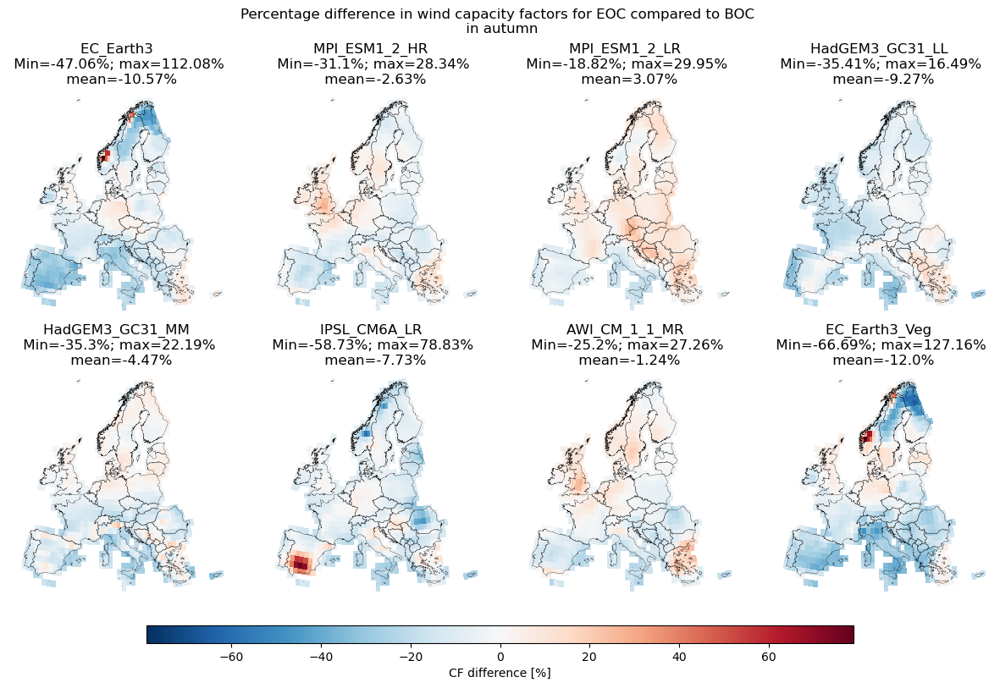

In [191]:
# Plotting  percentage difference 
nr_of_decimals = 2

# Select season to compare: 
season = 'autumn'

if season == 'winter':
    season_name = 'DJF'
if season == 'summer':
    season_name = 'JJA'
if season == 'spring':
    season_name = 'MAM'
if season == 'autumn':
    season_name = 'SON'


# Finding global absolute max for common colorbar: 
abs_max_global = 0
for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
    EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((EOC - BOC) / BOC)*100
    abs_max_local = np.nanmax(abs(locals()[percent_diff]))
    if abs_max_local > abs_max_global and abs_max_local < 100: 
        abs_max_global = abs_max_local

fig,axs = plt.subplots(2,4,subplot_kw={"projection": projection},figsize=(12,8),layout='constrained')
fig.suptitle(f'Percentage difference in wind capacity factors for EOC compared to BOC \n in {season}');
i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
    EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((EOC - BOC) / BOC)*100
    # locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

    min_val = np.nanmin(locals()[percent_diff])
    max_val = np.nanmax(locals()[percent_diff])
    mean_val = np.nanmean(locals()[percent_diff])
    abs_max = np.nanmax(abs(locals()[percent_diff]))
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
    im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(), cmap="RdBu_r", norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=40,norm=norm,cmap="RdBu_r",label='CF difference [%]')

# Saving figure to file: 
plot_filename = (f'EOC_vs_BOC_wind_{season}_CF_percentage_diff.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

In [192]:
# Creating seasonal ensemble of all CMIP6 models: 

# Plotting  percentage difference 
nr_of_decimals = 2

# Select season to compare: 
season = 'spring'

if season == 'winter':
    season_name = 'DJF'
if season == 'summer':
    season_name = 'JJA'
if season == 'spring':
    season_name = 'MAM'
if season == 'autumn':
    season_name = 'SON'

abs_max_global = 0
i = 0;
for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
        BOC = (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
        EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
        EOC = (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
    else: 
        BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
        BOC += (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
        EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
        EOC += (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
    i = i+1;
percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
percent_diff_sum = ((EOC - BOC) / BOC)*100
abs_max_local = np.nanmax(abs(percent_diff_sum))
abs_max_global = abs_max_local
# percent_diff_sum.plot(figsize=(8,7));

In [193]:
# Calculating direction-of-change matrix:
nr_of_decimals = 2

abs_max_global = 1.1;

# fig,axs = plt.subplots(2,4,subplot_kw={"projection": projection},figsize=(12,8),layout='constrained')
# fig.suptitle(f'Direction of change in wind capacity factors for EOC compared to BOC \n in {season}');
i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
    EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((EOC - BOC) / BOC)*100
    locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
    # locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)
    # min_val = np.nanmin(locals()[percent_diff])
    # max_val = np.nanmax(locals()[percent_diff])
    # mean_val = np.nanmean(locals()[percent_diff])
    # abs_max = np.nanmax(abs(locals()[percent_diff]))
    # norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
    # im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(), cmap="RdBu_r", norm=norm);
    # Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
    # axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}; max={round(max_val,nr_of_decimals)} \n mean={round(mean_val,nr_of_decimals)}');
    # im.colorbar.remove()
    i = i+1;
# fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=40,norm=norm,cmap="RdBu_r",label='CF difference [%]')

# Saving figure to file: 
plot_filename = (f'EOC_vs_BOC_wind_{season}_CF_percentage_diff.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

In [194]:
i = 0;
diff_sum = 0
for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum = locals()[percent_diff]
    else: 
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum += locals()[percent_diff]
    i = i+1;
diff_sum = abs(diff_sum)
# Matrix with points smaller than 6: 
diff_sum_matrix = xr.where(abs(diff_sum) < 6,1,0)
points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]

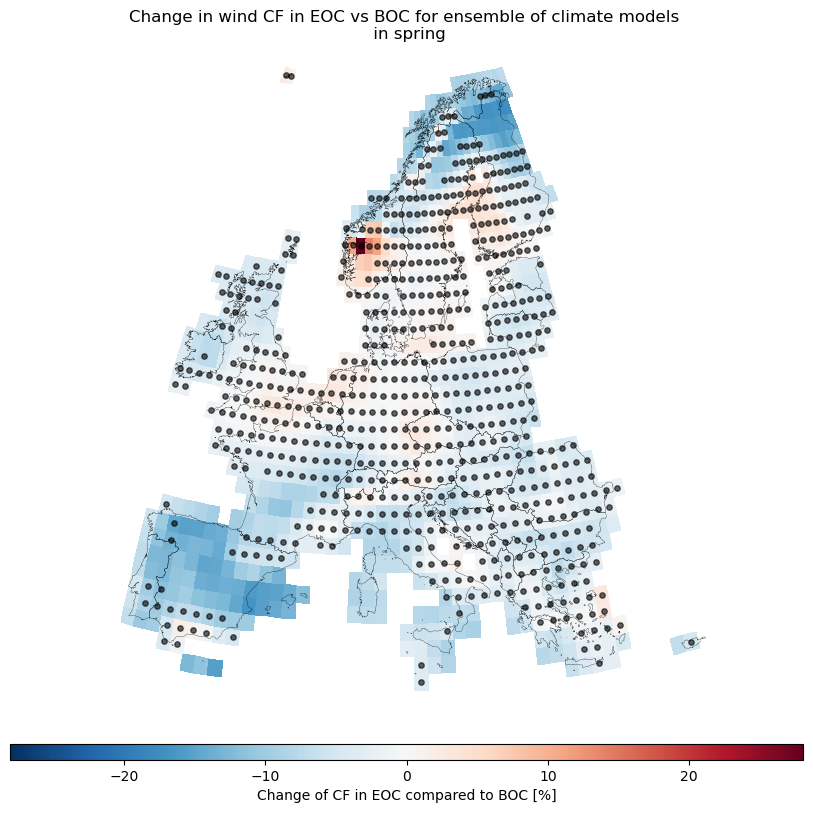

In [195]:
fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,8), layout='constrained')

im = percent_diff_sum.plot(ax=ax,transform=plate());
im.colorbar.remove()
ax.scatter(points_df['lon'],points_df['lat'],s=15,color='black',alpha=0.6,transform=plate())
# ax.scatter(diff_sum_matrix['lon'],diff_sum_matrix['lat'])
Europe.plot(ax=ax, edgecolor='k',color="None",transform=plate(), aspect="equal",linewidth=0.2).set_frame_on(False)
fig.colorbar(im, ax=ax, location='bottom', fraction=.1,shrink=0.8,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
ax.set_title(f'Change in wind CF in EOC vs BOC for ensemble of climate models \n in {season}');

# Saving figure to file: 
plot_filename = f'Ensemble_percentage_change_CF_wind_{season}_EOC_vs_BOC.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

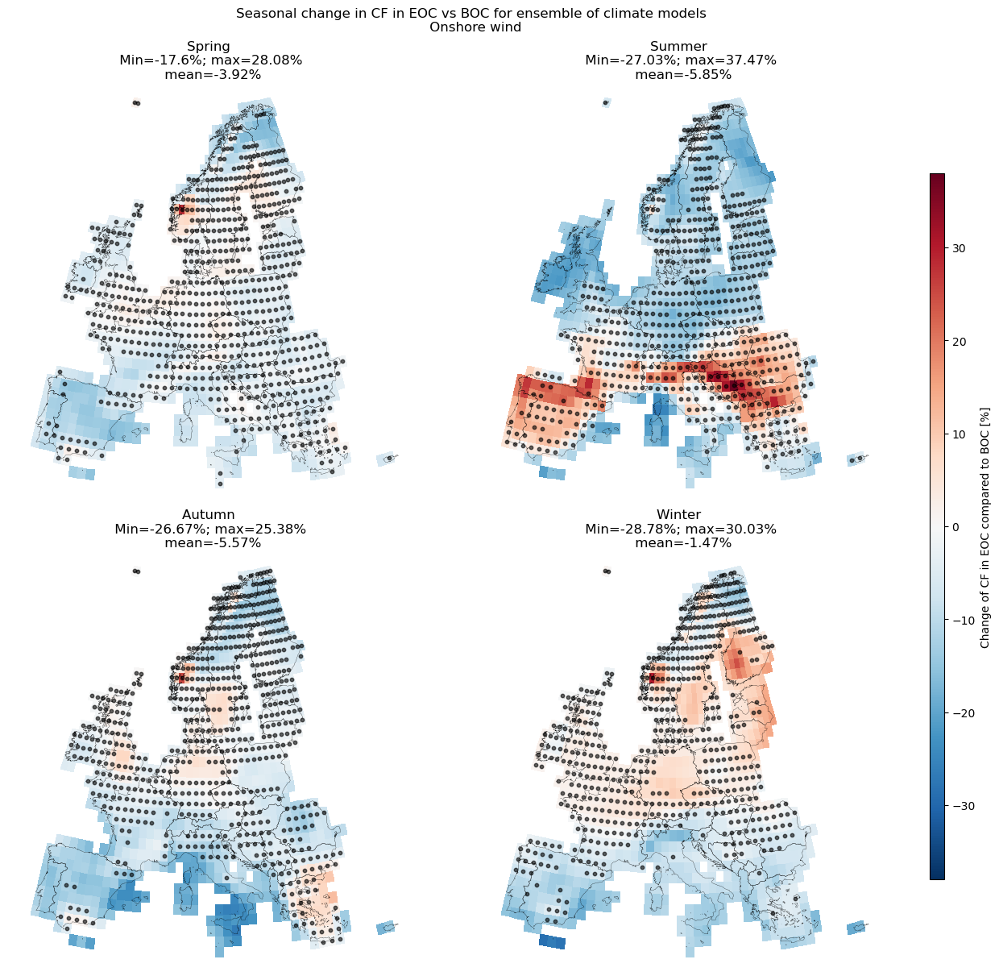

In [196]:
# Creating a figure with all 4 seasons with seasonal comparison of ensemble for wind: 

# Plotting  percentage difference 
nr_of_decimals = 2
seasons = ['Spring', 'Summer','Autumn','Winter'];

fig, axs = plt.subplots(2,2,subplot_kw={"projection": projection},figsize=(13,12), layout='constrained')
fig.suptitle(f'Seasonal change in CF in EOC vs BOC for ensemble of climate models \n Onshore wind');
ii=0;
for season in seasons:
    if season == 'Winter':
        season_name = 'DJF'
    if season == 'Summer':
        season_name = 'JJA'
    if season == 'Spring':
        season_name = 'MAM'
    if season == 'Autumn':
        season_name = 'SON'

    abs_max_global = 0
    i = 0;
    for CMIP6_model in CMIP6_models_wind_selection:
        CMIP6_model = CMIP6_model.replace("-", "_")
        if i == 0:
            BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
            BOC = (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
            EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
            EOC = (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
        else: 
            BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
            BOC += (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
            EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
            EOC += (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_wind_selection))
        i = i+1;
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    percent_diff_sum = ((EOC - BOC) / BOC)*100
    abs_max_local = np.nanmax(abs(percent_diff_sum))
    abs_max_global = abs_max_local

    abs_max_global = 1.1;

    i = 0;      # Initializing counter for subplot number
    for CMIP6_model in CMIP6_models_wind_selection:
        CMIP6_model = CMIP6_model.replace("-", "_")
        cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
        BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
        EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        locals()[percent_diff] = ((EOC - BOC) / BOC)*100
        locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
        i = i+1;

    i = 0;
    diff_sum = 0
    for CMIP6_model in CMIP6_models_wind_selection:
        CMIP6_model = CMIP6_model.replace("-", "_")
        if i == 0:
            percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
            diff_sum = locals()[percent_diff]
        else: 
            percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
            diff_sum += locals()[percent_diff]
        i = i+1;
    diff_sum = abs(diff_sum)
    # Matrix with points smaller than 6: 
    diff_sum_matrix = xr.where(abs(diff_sum) < 6,1,0)

    points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]

    min_val = np.nanmin(percent_diff_sum)
    max_val = np.nanmax(percent_diff_sum)
    mean_val = np.nanmean(percent_diff_sum)

    # plotting:
    abs_max_global = 38;
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
    im = percent_diff_sum.plot(ax=axs.flat[ii],transform=plate(),norm=norm,cmap="RdBu_r");
    im.colorbar.remove()
    axs.flat[ii].scatter(points_df['lon'],points_df['lat'],s=10,color='black',alpha=0.6,transform=plate())
    Europe.plot(ax=axs.flat[ii], edgecolor='k',color="None",transform=plate(), aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
    ii = ii+1;
fig.colorbar(im, ax=axs, location='right', fraction=.1,shrink=0.8,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
# Saving figure to file: 
plot_filename = f'Ensemble_percentage_change_CF_wind_all_seasons_EOC_vs_BOC.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

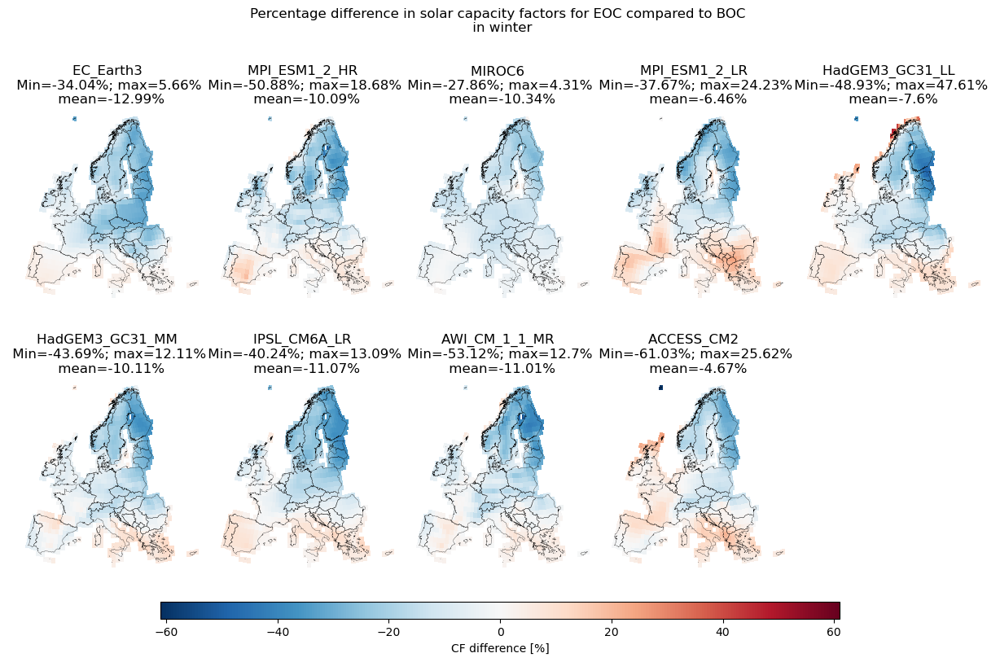

In [197]:
# Plotting  percentage difference 
nr_of_decimals = 2

# Select season to compare: 
season = 'winter'

if season == 'winter':
    season_name = 'DJF'
if season == 'summer':
    season_name = 'JJA'
if season == 'spring':
    season_name = 'MAM'
if season == 'autumn':
    season_name = 'SON'


# Finding global absolute max for common colorbar: 
abs_max_global = 0
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
    EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((EOC - BOC) / BOC)*100
    abs_max_local = np.nanmax(abs(locals()[percent_diff]))
    if abs_max_local > abs_max_global: 
        abs_max_global = abs_max_local

fig,axs = plt.subplots(2,5,subplot_kw={"projection": projection},figsize=(12,8),layout='constrained')
fig.suptitle(f'Percentage difference in solar capacity factors for EOC compared to BOC \n in {season}');
i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
    EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((EOC - BOC) / BOC)*100
    # locals()[percent_diff] = locals()[percent_diff].reset_coords(['band','spatial_ref'], drop=True)

    min_val = np.nanmin(locals()[percent_diff])
    max_val = np.nanmax(locals()[percent_diff])
    mean_val = np.nanmean(locals()[percent_diff])
    abs_max = np.nanmax(abs(locals()[percent_diff]))
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
    im = locals()[percent_diff].plot(ax=axs.flat[i], transform=plate(), cmap="RdBu_r", norm=norm);
    Europe.plot(ax=axs.flat[i], edgecolor='k', transform=plate(), color="None", aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[i].set_title(f'{CMIP6_model} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%');
    im.colorbar.remove()
    i = i+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=40,norm=norm,cmap="RdBu_r",label='CF difference [%]')
fig.delaxes(axs.flat[-1]) # Deleting last figure (because of odd number of models)

# Saving figure to file: 
plot_filename = (f'EOC_vs_BOC_PV_{season}_CF_percentage_diff.png')
# plt.savefig(plot_path(plot_filename), dpi=300)

In [198]:
# Seasonal comparison of ensemble for PV: 

# Plotting  percentage difference 
nr_of_decimals = 2

# Select season to compare: 
season = 'winter'

if season == 'winter':
    season_name = 'DJF'
if season == 'summer':
    season_name = 'JJA'
if season == 'spring':
    season_name = 'MAM'
if season == 'autumn':
    season_name = 'SON'

abs_max_global = 0
i = 0;
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
        BOC = (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
        EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
        EOC = (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
    else: 
        BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
        BOC += (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
        EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
        EOC += (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
    i = i+1;
percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
percent_diff_sum = ((EOC - BOC) / BOC)*100
abs_max_local = np.nanmax(abs(percent_diff_sum))
abs_max_global = abs_max_local
# percent_diff_sum.plot(figsize=(8,7));

In [199]:
# Calculating direction-of-change matrix:

i = 0;      # Initializing counter for subplot number
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
    EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    locals()[percent_diff] = ((EOC - BOC) / BOC)*100
    locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
    i = i+1;

In [200]:
# Defining points with uncertain direction of change:
i = 0;
diff_sum = 0
for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum = locals()[percent_diff]
    else: 
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        diff_sum += locals()[percent_diff]
    i = i+1;
diff_sum = abs(diff_sum)
# Matrix with points smaller than 7 out of 9: 
diff_sum_matrix = xr.where(abs(diff_sum) < 7,1,0)
points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]

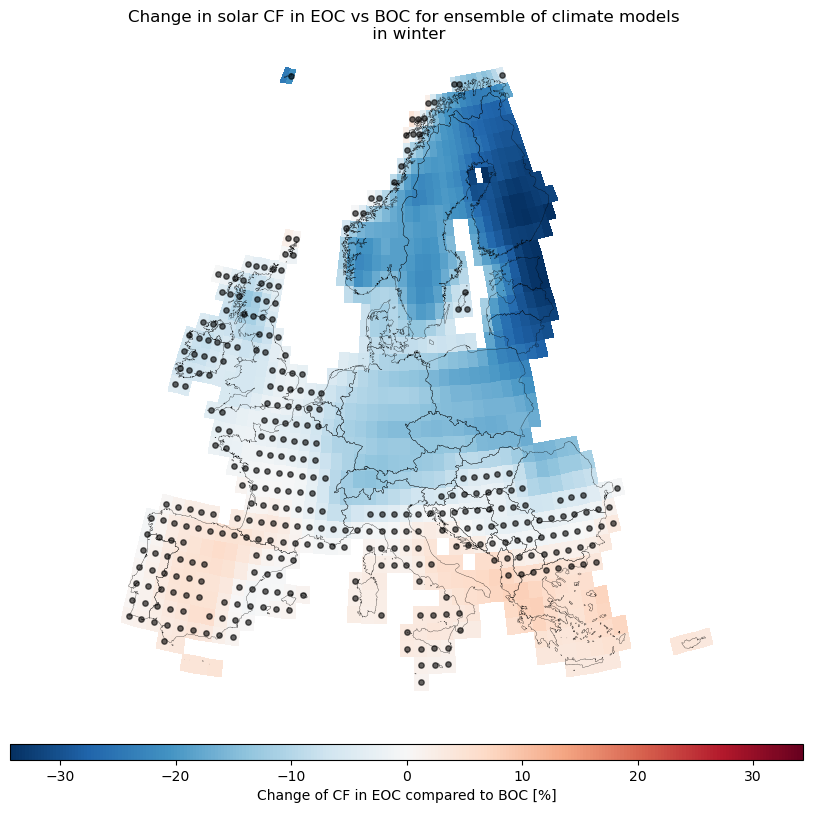

In [201]:
fig, ax = plt.subplots(subplot_kw={"projection": projection},figsize=(10,8), layout='constrained')

im = percent_diff_sum.plot(ax=ax,transform=plate());
im.colorbar.remove()
ax.scatter(points_df['lon'],points_df['lat'],s=15,color='black',alpha=0.6,transform=plate())
Europe.plot(ax=ax, edgecolor='k',color="None",transform=plate(), aspect="equal",linewidth=0.2).set_frame_on(False)
fig.colorbar(im, ax=ax, location='bottom', fraction=.1,shrink=0.8,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
ax.set_title(f'Change in solar CF in EOC vs BOC for ensemble of climate models \n in {season}');

# Saving figure to file: 
plot_filename = f'Ensemble_percentage_change_CF_PV_{season}_EOC_vs_BOC.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

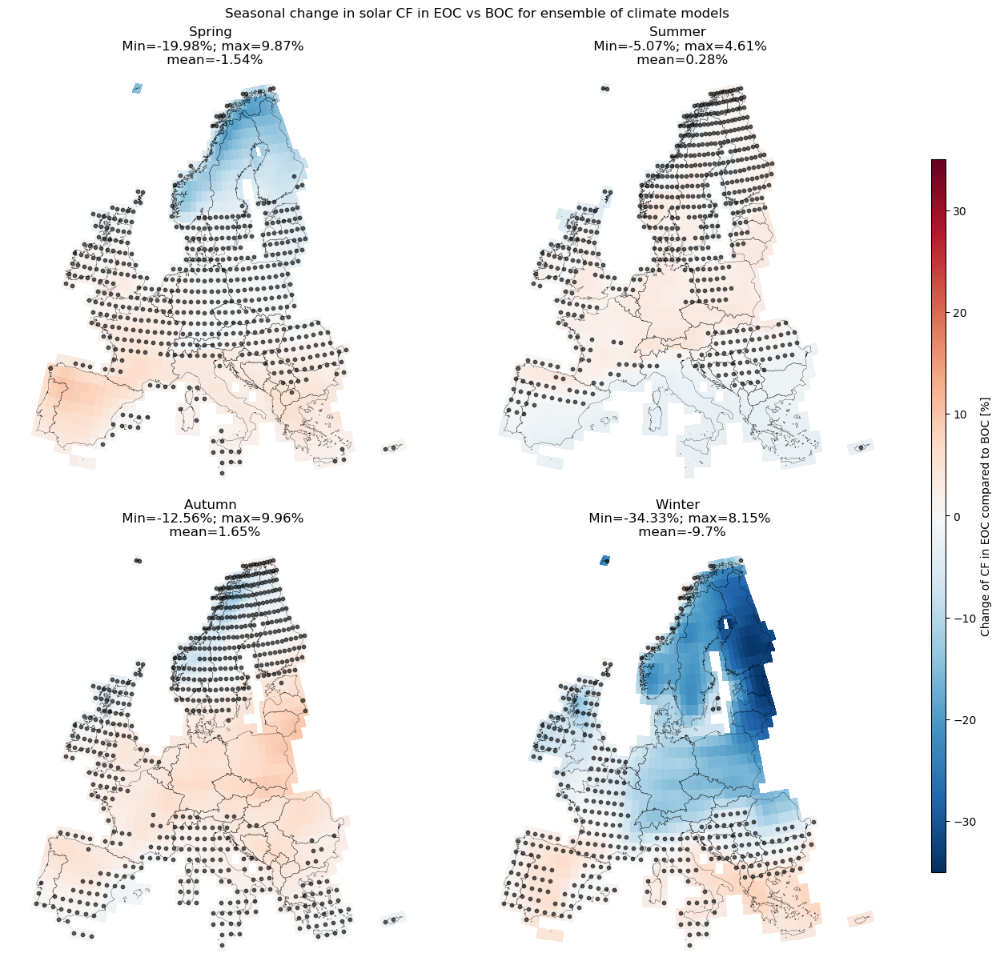

In [202]:
# Creating a figure with all 4 seasons with seasonal comparison of ensemble for PV: 

# Plotting  percentage difference 
nr_of_decimals = 2
seasons = ['Spring', 'Summer','Autumn','Winter'];

fig, axs = plt.subplots(2,2,subplot_kw={"projection": projection},figsize=(13,12), layout='constrained')
fig.suptitle(f'Seasonal change in solar CF in EOC vs BOC for ensemble of climate models');
ii=0;
for season in seasons:
    if season == 'Winter':
        season_name = 'DJF'
    if season == 'Summer':
        season_name = 'JJA'
    if season == 'Spring':
        season_name = 'MAM'
    if season == 'Autumn':
        season_name = 'SON'

    abs_max_global = 0
    i = 0;
    for CMIP6_model in CMIP6_models_solar:
        CMIP6_model = CMIP6_model.replace("-", "_")
        if i == 0:
            BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
            BOC = (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
            EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
            EOC = (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
        else: 
            BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
            BOC += (locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
            EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
            EOC += (locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)/len(CMIP6_models_solar))
        i = i+1;
    percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
    percent_diff_sum = ((EOC - BOC) / BOC)*100
    abs_max_local = np.nanmax(abs(percent_diff_sum))
    abs_max_global = abs_max_local

    # Calculating direction-of-change matrix:

    i = 0;      # Initializing counter for subplot number
    for CMIP6_model in CMIP6_models_solar:
        CMIP6_model = CMIP6_model.replace("-", "_")
        cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
        BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].groupby("time.season").mean().sel(season=season_name)
        EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].groupby("time.season").mean().sel(season=season_name)
        percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
        locals()[percent_diff] = ((EOC - BOC) / BOC)*100
        locals()[percent_diff] = locals()[percent_diff]/abs(locals()[percent_diff])
        i = i+1;

    # Defining points with uncertain direction of change:
    i = 0;
    diff_sum = 0
    for CMIP6_model in CMIP6_models_solar:
        CMIP6_model = CMIP6_model.replace("-", "_")
        if i == 0:
            percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
            diff_sum = locals()[percent_diff]
        else: 
            percent_diff = f'Europe_{CMIP6_model}_ssp585_{season}_percent_difference'
            diff_sum += locals()[percent_diff]
        i = i+1;
    diff_sum = abs(diff_sum)
    # Matrix with points smaller than 7 out of 9: 
    diff_sum_matrix = xr.where(abs(diff_sum) < 7,1,0)
    points_df = diff_sum_matrix.to_dataframe()[diff_sum_matrix.to_dataframe()['capacity factor'] == 1]

    min_val = np.nanmin(percent_diff_sum)
    max_val = np.nanmax(percent_diff_sum)
    mean_val = np.nanmean(percent_diff_sum)

    # plotting:
    abs_max_global = 35;
    norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
    im = percent_diff_sum.plot(ax=axs.flat[ii],transform=plate(),norm=norm,cmap="RdBu_r");
    im.colorbar.remove()
    axs.flat[ii].scatter(points_df['lon'],points_df['lat'],s=10,color='black',alpha=0.6,transform=plate())
    Europe.plot(ax=axs.flat[ii], edgecolor='k',color="None",transform=plate(), aspect="equal",linewidth=0.2).set_frame_on(False)
    axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
    ii = ii+1;
fig.colorbar(im, ax=axs, location='right', fraction=.1,shrink=0.8,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
# Saving figure to file: 
plot_filename = f'Ensemble_percentage_change_CF_PV_all_seasons_EOC_vs_BOC.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

## Plotting Duration curves

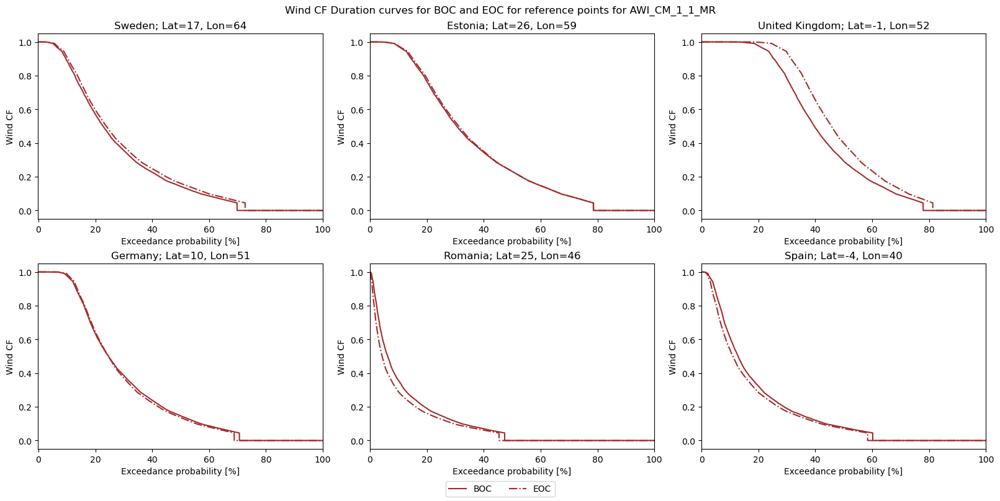

In [203]:
CMIP6_model = 'AWI-CM-1-1-MR'
plotcolor = model_colors.loc[CMIP6_model]['Color']
CMIP6_model = CMIP6_model.replace("-", "_")

fig,axs = plt.subplots(2,3,figsize=(16,8),layout='constrained')
title = f'Wind CF Duration curves for BOC and EOC for reference points for {CMIP6_model}'
fig.suptitle(title)
legend_mod = False;

for ii in range(6):
    point_name = f'point_{ii+1}';
    country_name = ref_country[ii]
    point = locals()[point_name];
    BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()
    EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()

    dur2 = pd.DataFrame(BOC).sort_values(by='capacity factor',ascending = False)
    title = 'BOC';
    dur_test = pd.DataFrame({title:dur2['capacity factor']});
    # Use the cumsum() function to to add a column with the duration 
    # for which the system load is greater than or equal to each load
    dur_test['Interval'] = 1;
    dur_test['Duration'] = dur_test['Interval'].cumsum();
    dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
    dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,100],legend=legend_mod,label=f'BOC', color=plotcolor);

    dur2 = pd.DataFrame(EOC).sort_values(by='capacity factor',ascending = False)
    title = 'EOC';
    dur_test = pd.DataFrame({title:dur2['capacity factor']});
    # Use the cumsum() function to to add a column with the duration 
    # for which the system load is greater than or equal to each load
    dur_test['Interval'] = 1;
    dur_test['Duration'] = dur_test['Interval'].cumsum();
    dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
    dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,100],linestyle='-.',legend=legend_mod,label=f'EOC', color=plotcolor);

    axs.flat[ii].set_ylabel('Wind CF')
    axs.flat[ii].set(xlabel='Exceedance probability [%]')
    axs.flat[ii].set_title(f'{country_name}; Lat={point[0]}, Lon={point[1]}')
    if ii == 0: 
        fig.legend(ncols=2,loc='outside lower center')

# Saving figure to file: 
plot_filename = f'Wind CF Duration curves for BOC and EOC for reference points for {CMIP6_model}';
# plt.savefig(plot_path(plot_filename), dpi=300);

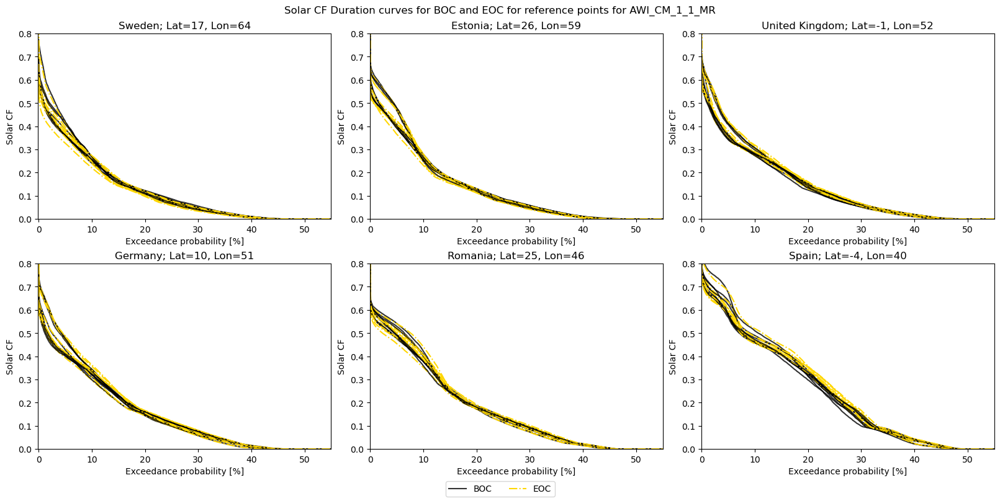

In [204]:
# PV Duration curves for 6 ref. points for all climate models

fig,axs = plt.subplots(2,3,figsize=(16,8),layout='constrained')
title = f'Solar CF Duration curves for BOC and EOC for reference points for {CMIP6_model}'
fig.suptitle(title)
legend_mod = False;

i = 0;
for ii in range(6): 
    for CMIP6_model in CMIP6_models_solar:
        # plotcolor = model_colors.loc[CMIP6_model]['Color']
        CMIP6_model = CMIP6_model.replace("-", "_")

        point_name = f'point_{ii+1}';
        country_name = ref_country[ii]
        point = locals()[point_name];
        BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()
        EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()

        dur2 = pd.DataFrame(BOC).sort_values(by='capacity factor',ascending = False)
        title = 'BOC';
        dur_test = pd.DataFrame({title:dur2['capacity factor']});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title,legend=legend_mod,label=f'BOC', color='black',alpha=0.8);

        dur2 = pd.DataFrame(EOC).sort_values(by='capacity factor',ascending = False)
        title = 'EOC';
        dur_test = pd.DataFrame({title:dur2['capacity factor']});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,55],ylim=[0, 0.8],linestyle='-.',legend=legend_mod,label=f'EOC', color='gold');
        if i == 0: 
            fig.legend(ncols=2,loc='outside lower center')
            i = i+1;
    axs.flat[ii].set_ylabel('Solar CF')
    axs.flat[ii].set(xlabel='Exceedance probability [%]')
    axs.flat[ii].set_title(f'{country_name}; Lat={point[0]}, Lon={point[1]}')


# Saving figure to file: 
plot_filename = f'PV CF Duration curves for BOC and EOC for reference points for {CMIP6_model}';
# plt.savefig(plot_path(plot_filename), dpi=300);

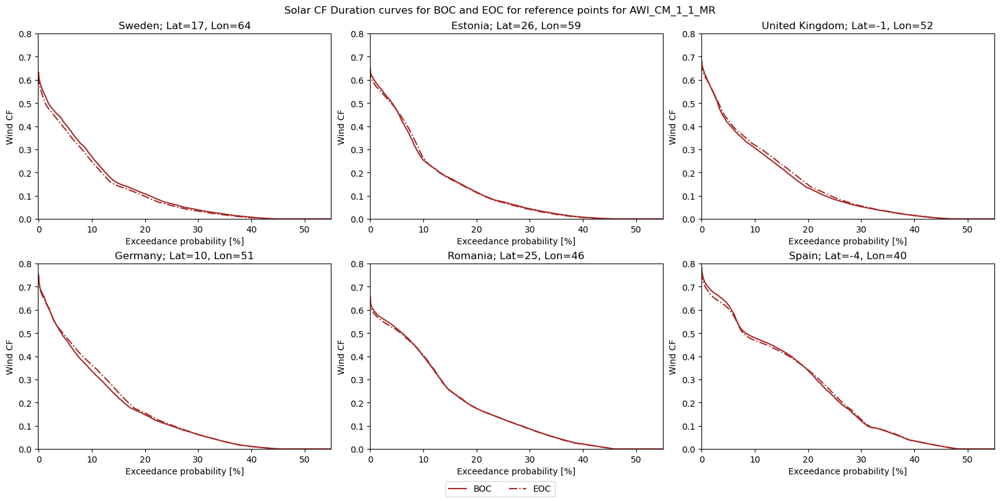

In [205]:
# Sort the DataFrame by the loads, in descending order of magnitude

CMIP6_model = 'AWI-CM-1-1-MR'
plotcolor = model_colors.loc[CMIP6_model]['Color']
CMIP6_model = CMIP6_model.replace("-", "_")

fig,axs = plt.subplots(2,3,figsize=(16,8),layout='constrained')
title = f'Solar CF Duration curves for BOC and EOC for reference points for {CMIP6_model}'
fig.suptitle(title)
legend_mod = False;

for ii in range(6):
    point_name = f'point_{ii+1}';
    country_name = ref_country[ii]
    point = locals()[point_name];
    BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()
    EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()

    dur2 = pd.DataFrame(BOC).sort_values(by='capacity factor',ascending = False)
    title = 'BOC';
    dur_test = pd.DataFrame({title:dur2['capacity factor']});
    # Use the cumsum() function to to add a column with the duration 
    # for which the system load is greater than or equal to each load
    dur_test['Interval'] = 1;
    dur_test['Duration'] = dur_test['Interval'].cumsum();
    dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
    dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title,legend=legend_mod,label=f'BOC', color=plotcolor);

    dur2 = pd.DataFrame(EOC).sort_values(by='capacity factor',ascending = False)
    title = 'EOC';
    dur_test = pd.DataFrame({title:dur2['capacity factor']});
    # Use the cumsum() function to to add a column with the duration 
    # for which the system load is greater than or equal to each load
    dur_test['Interval'] = 1;
    dur_test['Duration'] = dur_test['Interval'].cumsum();
    dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
    dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,55],ylim=[0, 0.8],linestyle='-.',legend=legend_mod,label=f'EOC', color=plotcolor);

    axs.flat[ii].set_ylabel('Wind CF')
    axs.flat[ii].set(xlabel='Exceedance probability [%]')
    axs.flat[ii].set_title(f'{country_name}; Lat={point[0]}, Lon={point[1]}')
    if ii == 0: 
        fig.legend(ncols=2,loc='outside lower center')

# Saving figure to file: 
plot_filename = f'PV CF Duration curves for BOC and EOC for reference points for {CMIP6_model}';
# plt.savefig(plot_path(plot_filename), dpi=300);

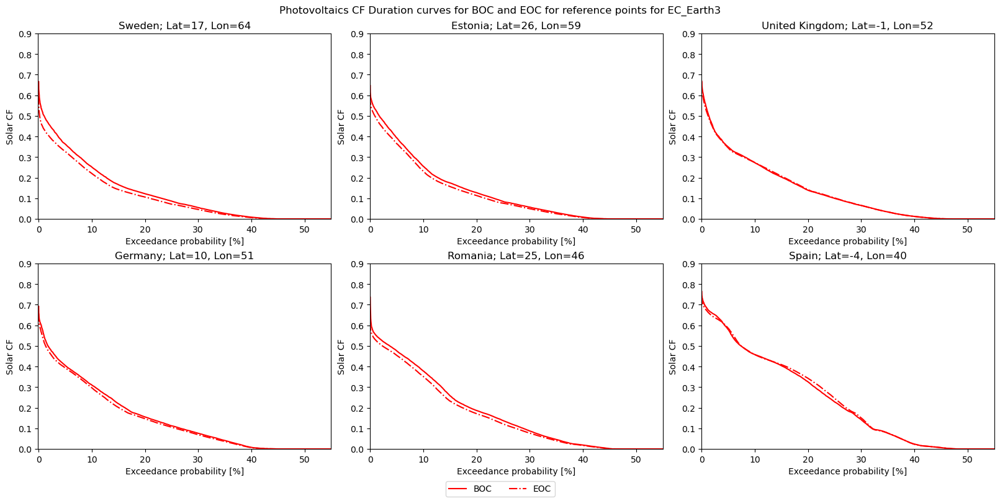

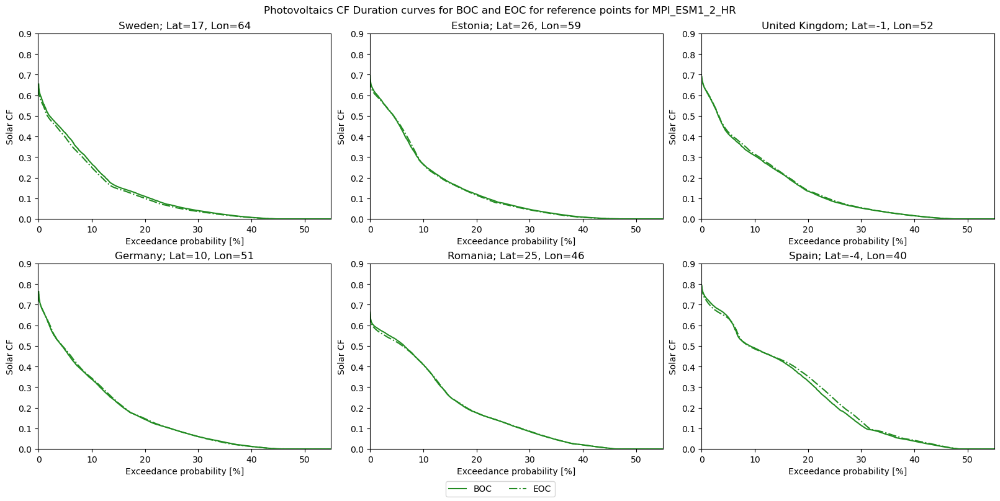

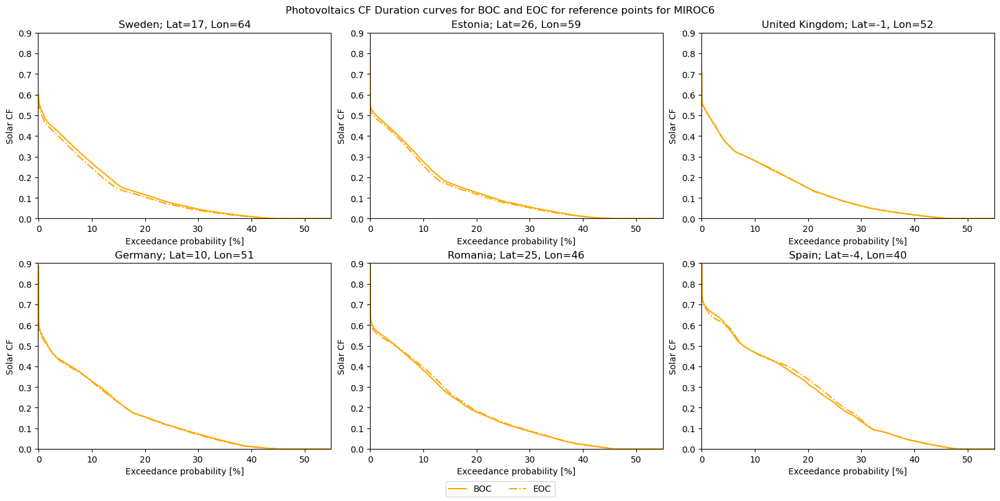

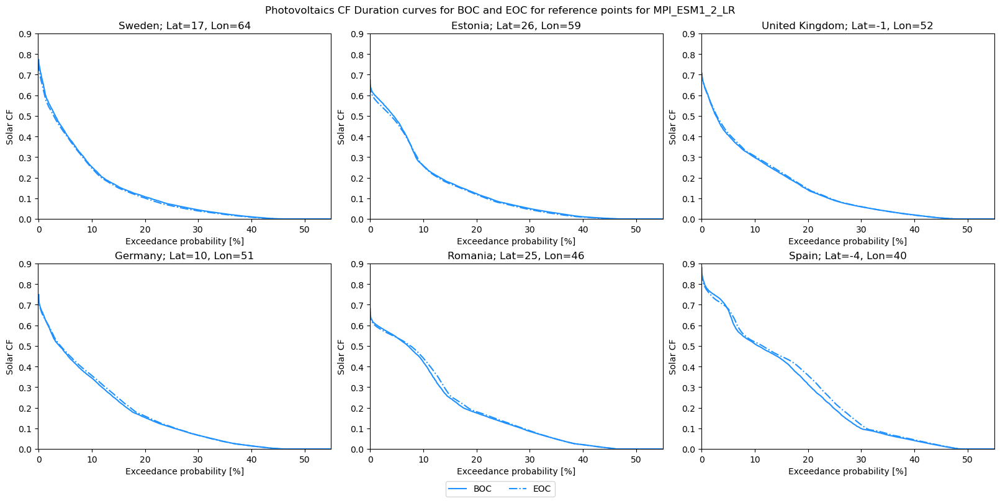

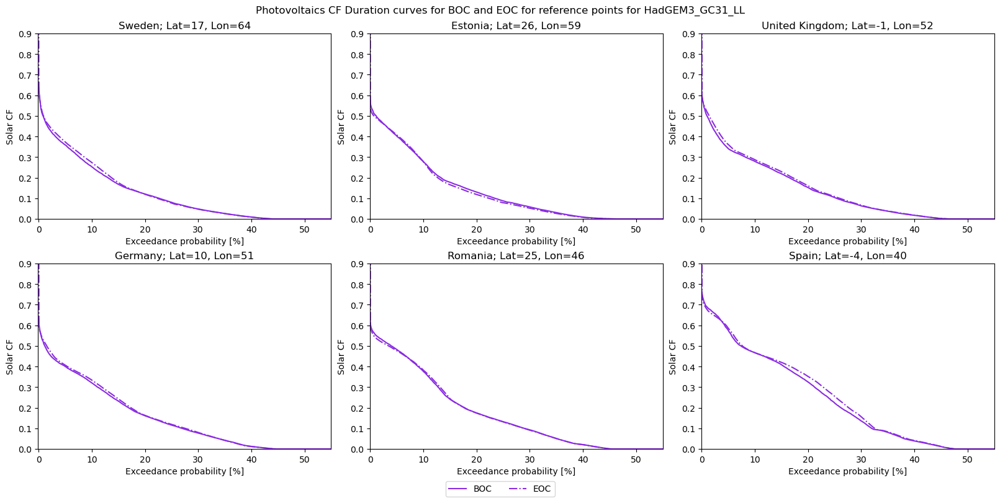

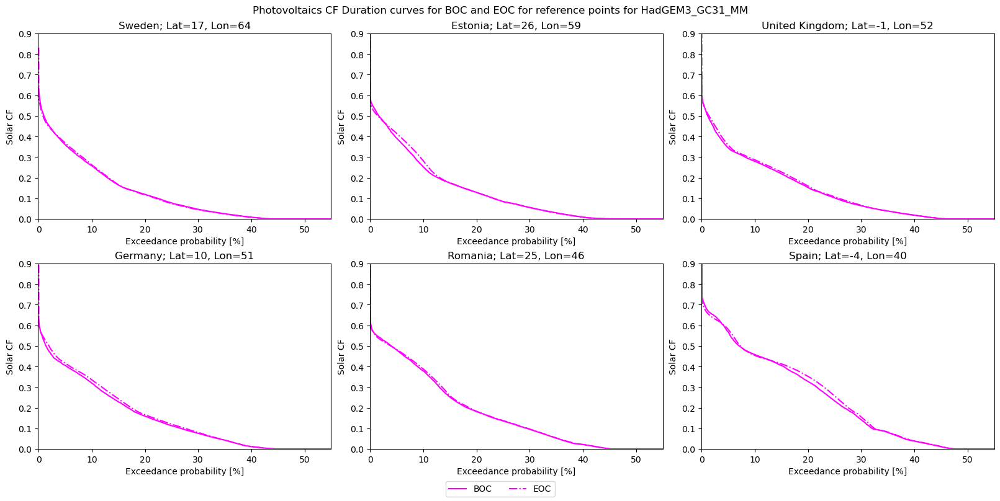

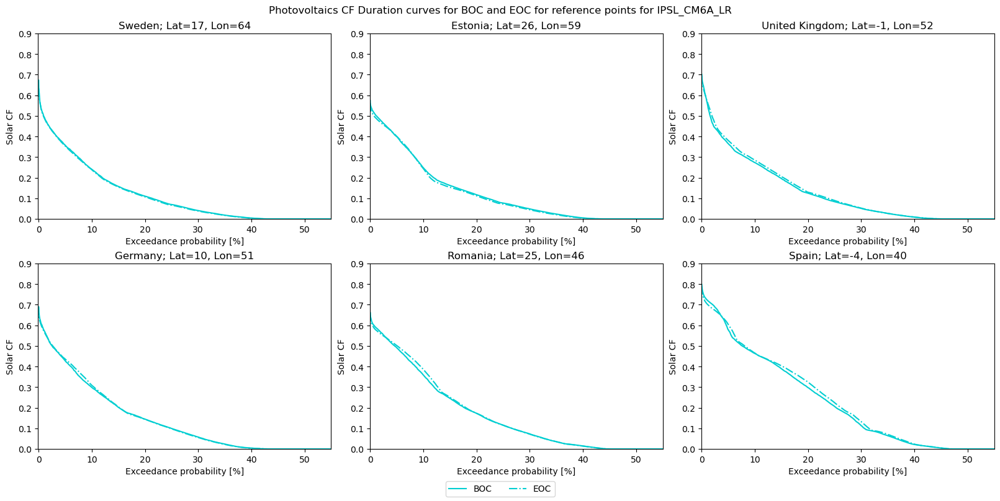

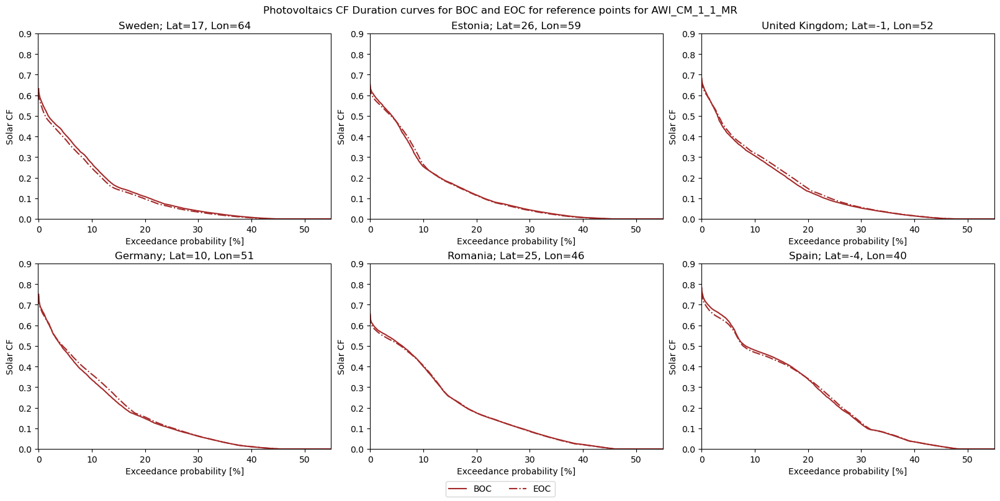

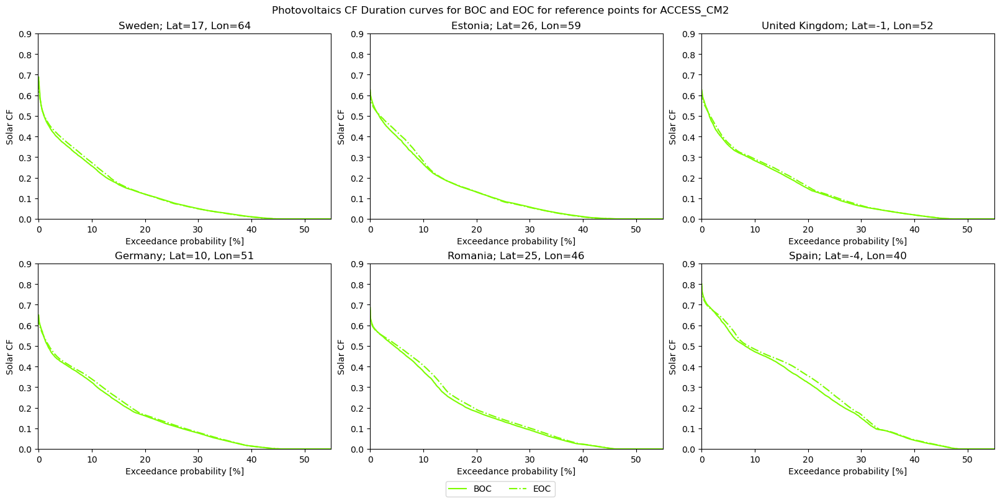

In [206]:
# Duration curves for PV for all reference points for all CMIP6 models
for CMIP6_model in CMIP6_models_solar: 

    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")

    fig,axs = plt.subplots(2,3,figsize=(16,8),layout='constrained')
    title = f'Photovoltaics CF Duration curves for BOC and EOC for reference points for {CMIP6_model}'
    fig.suptitle(title)
    legend_mod = False;

    for ii in range(6):
        point_name = f'point_{ii+1}';
        country_name = ref_country[ii]
        point = locals()[point_name];
        BOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()
        EOC_name = f'CF_timeseries_per_cell_PV_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()

        dur2 = pd.DataFrame(BOC).sort_values(by='capacity factor',ascending = False)
        title = 'BOC';
        dur_test = pd.DataFrame({title:dur2['capacity factor']});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title,legend=legend_mod,label=f'BOC', color=plotcolor);

        dur2 = pd.DataFrame(EOC).sort_values(by='capacity factor',ascending = False)
        title = 'EOC';
        dur_test = pd.DataFrame({title:dur2['capacity factor']});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,55],ylim=[0, 0.9],linestyle='-.',legend=legend_mod,label=f'EOC', color=plotcolor);

        axs.flat[ii].set_ylabel('Solar CF')
        axs.flat[ii].set(xlabel='Exceedance probability [%]')
        axs.flat[ii].set_title(f'{country_name}; Lat={point[0]}, Lon={point[1]}')
        if ii == 0: 
            fig.legend(ncols=2,loc='outside lower center')

    # Saving figure to file: 
    plot_filename = f'PV CF Duration curves for BOC and EOC for reference points for {CMIP6_model}';
    # plt.savefig(plot_path(plot_filename), dpi=300);

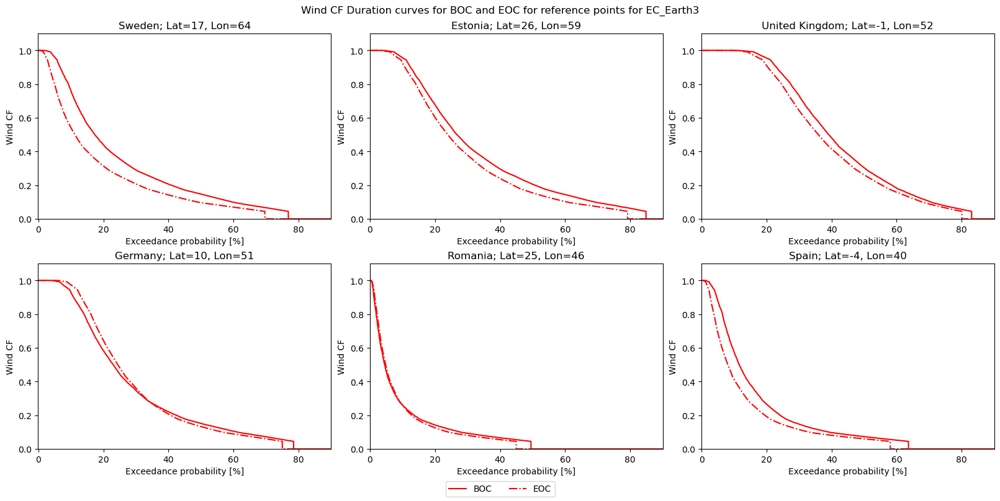

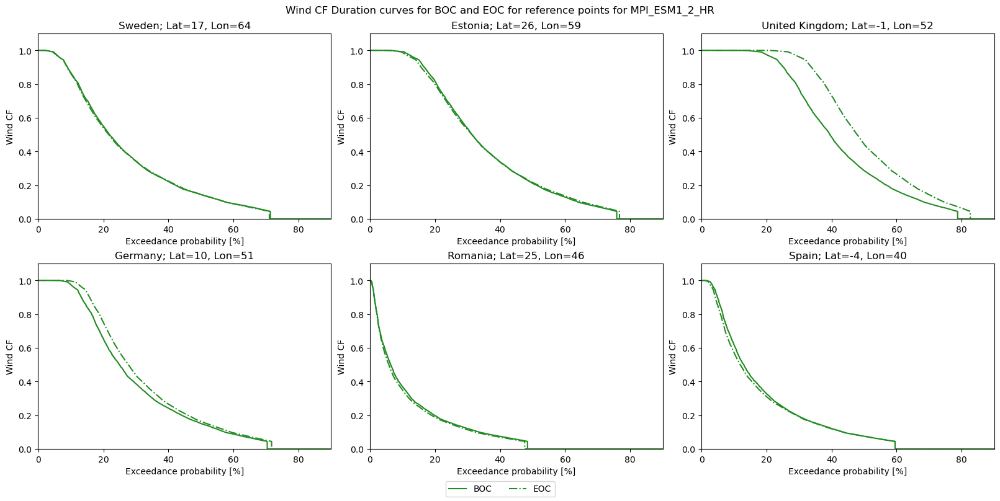

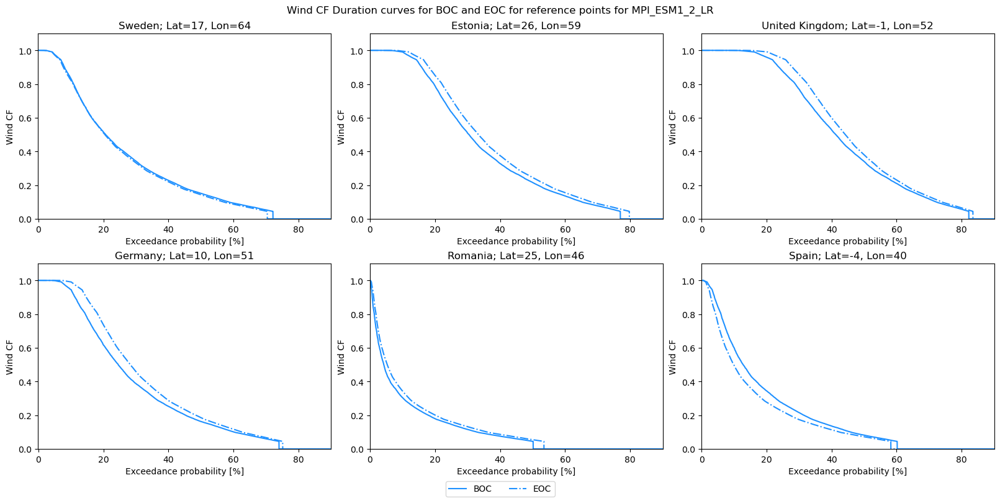

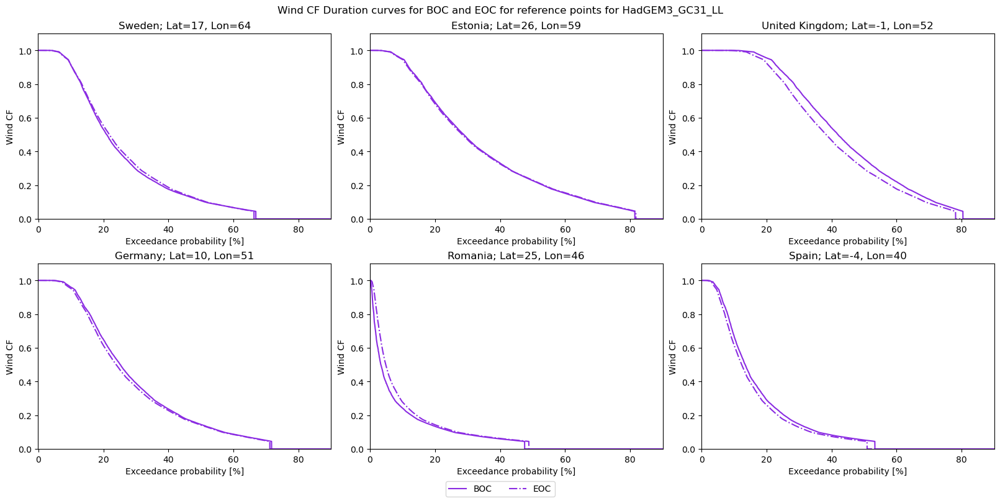

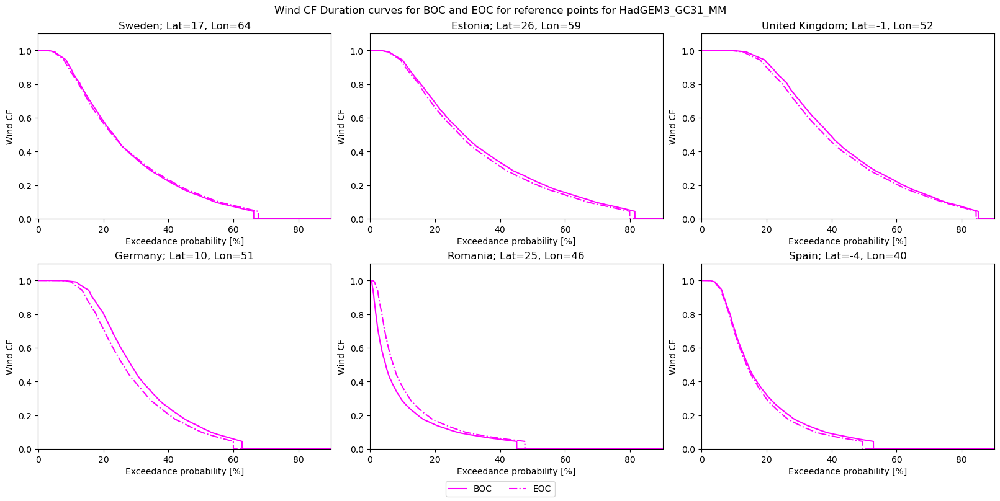

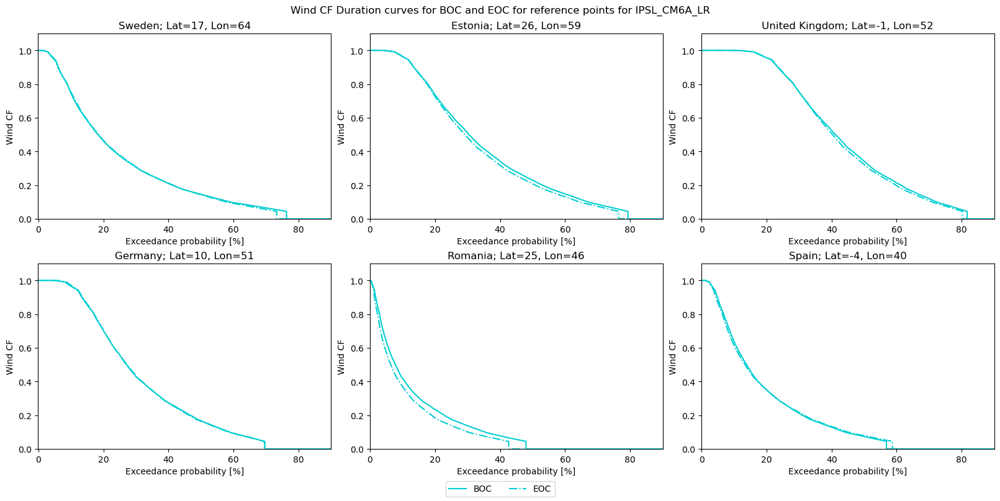

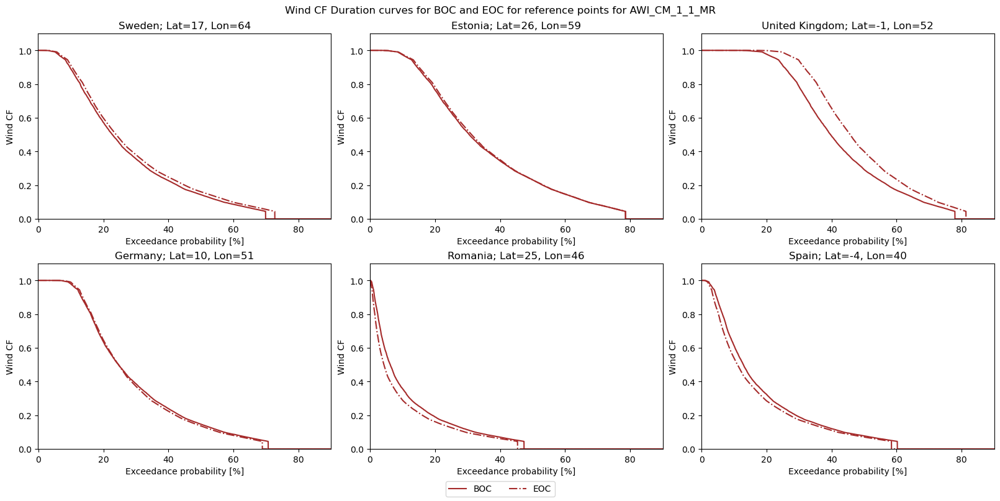

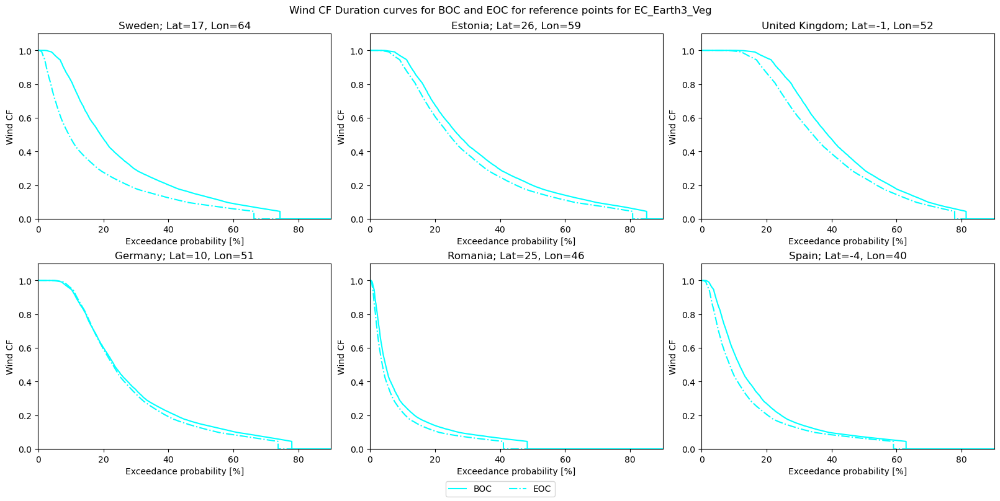

In [207]:
# # Duration curves for wind for all reference points for all CMIP6 models

for CMIP6_model in CMIP6_models_wind_selection: 
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")

    fig,axs = plt.subplots(2,3,figsize=(16,8),layout='constrained')
    title = f'Wind CF Duration curves for BOC and EOC for reference points for {CMIP6_model}'
    fig.suptitle(title)
    legend_mod = False;

    for ii in range(6):
        point_name = f'point_{ii+1}';
        country_name = ref_country[ii]
        point = locals()[point_name];
        BOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()
        EOC_name = f'CF_timeseries_per_cell_wind_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].sel(x=point[0],y=point[1]).squeeze().to_series()

        dur2 = pd.DataFrame(BOC).sort_values(by='capacity factor',ascending = False)
        title = 'BOC';
        dur_test = pd.DataFrame({title:dur2['capacity factor']});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title,legend=legend_mod,label=f'BOC', color=plotcolor);

        dur2 = pd.DataFrame(EOC).sort_values(by='capacity factor',ascending = False)
        title = 'EOC';
        dur_test = pd.DataFrame({title:dur2['capacity factor']});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,90],ylim=[0,1.1],linestyle='-.',legend=legend_mod,label=f'EOC', color=plotcolor);

        axs.flat[ii].set_ylabel('Wind CF')
        axs.flat[ii].set(xlabel='Exceedance probability [%]')
        axs.flat[ii].set_title(f'{country_name}; Lat={point[0]}, Lon={point[1]}')
        if ii == 0: 
            fig.legend(ncols=2,loc='outside lower center')

    # Saving figure to file: 
    plot_filename = f'Wind CF Duration curves for BOC and EOC for reference points for {CMIP6_model}';
    # plt.savefig(plot_path(plot_filename), dpi=300);

## Plotting CF comparisons per country

In [208]:
# Generating CF timeseries per country for BOC

overwrite = 0;
date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2015-01-01"
end_date = "2022-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000
ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/'

for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_wnd90m_GWA_corrected'
    locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
    my_file = Path(cutout_path)
    name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'    # Defining average CF filename: 
    filename = f'{name}.nc'
    path = f'{output_folder_path}{filename}'
    if cutout_name in locals():
        if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
            # Creating average wind CF:
            print(f'Creating "{filename}"')
            locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind,turbine=turbine,capacity_factor=True,layout=layout_wind,per_unit=True,index=Europe.index)
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name].to_netcdf(path=path)      # Saving average CF to file
        else:
            locals()[name] = xr.open_dataarray(path)
            locals()[name] = locals()[name].load()
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            print(f'"{filename}" already exists in "{path}". ')
    else: 
        print(f'File "{path}" skipped. The cutout does not exist. ')

# PV:
output_folder_path = f'E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/PV/'

for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_influx_corrected'
    locals()[cutout_name].data['influx'] = locals()[corrected_data_name]
    my_file = Path(cutout_path)
    name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'    # Defining average CF filename: 
    filename = f'{name}.nc'
    path = f'{output_folder_path}{filename}'
    if cutout_name in locals():
        if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
            # Creating average wind CF:
            print(f'Creating "{filename}"')
            locals()[name] = locals()[cutout_name].pv(matrix=matrix_PV,panel=PV_panel,orientation="latitude_optimal",capacity_factor=True,layout=layout_PV,per_unit=True,index=Europe.index)
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name].to_netcdf(path=path)      # Saving average CF to file
        else:
            locals()[name] = xr.open_dataarray(path)
            locals()[name] = locals()[name].load()
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            print(f'"{filename}" already exists in "{path}". ')
    else: 
        print(f'File "{path}" skipped. The cutout does not exist. ')

"Aggregated_CF_timeseries_per_country_wind_EC_Earth3_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/Aggregated_CF_timeseries_per_country_wind_EC_Earth3_ssp585_15_22.nc". 
"Aggregated_CF_timeseries_per_country_wind_MPI_ESM1_2_HR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/Aggregated_CF_timeseries_per_country_wind_MPI_ESM1_2_HR_ssp585_15_22.nc". 
"Aggregated_CF_timeseries_per_country_wind_MPI_ESM1_2_LR_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/Aggregated_CF_timeseries_per_country_wind_MPI_ESM1_2_LR_ssp585_15_22.nc". 
"Aggregated_CF_timeseries_per_country_wind_HadGEM3_GC31_LL_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggregated CF timeseries/Wind/Aggregated_CF_timeseries_per_country_wind_HadGEM3_GC31_LL_ssp585_15_22.nc". 
"Aggregated_CF_timeseries_per_country_wind_HadGEM3_GC31_MM_ssp585_15_22.nc" already exists in "E://Cutouts/CMIP6_BOC/Aggrega

In [209]:
# Generating Cf timeseries per country for EOC

overwrite = 0;
date_format = "%Y-%m-%d"
# Define cutout time duration: 
start_date = "2070-01-01"
end_date = "2099-12-31"

yy_start = datetime.datetime.strptime(start_date,"%Y-%m-%d").year-2000
yy_end = datetime.datetime.strptime(end_date,"%Y-%m-%d").year-2000
ssp_variants = ['ssp585']

# Onshore wind:
output_folder_path = f'E://Cutouts/CMIP6_EOC/Aggregated CF timeseries/Wind/'

for CMIP6_model in CMIP6_models_wind_selection:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_wnd90m_GWA_corrected'
    locals()[cutout_name].data['wnd90m'] = locals()[corrected_data_name]
    my_file = Path(cutout_path)
    name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'    # Defining average CF filename: 
    filename = f'{name}.nc'
    path = f'{output_folder_path}{filename}'
    if cutout_name in locals():
        if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
            # Creating average wind CF:
            print(f'Creating "{filename}"')
            locals()[name] = locals()[cutout_name].wind(matrix=matrix_wind,turbine=turbine,capacity_factor=True,layout=layout_wind,per_unit=True,index=Europe.index)
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name].to_netcdf(path=path)      # Saving average CF to file
        else:
            locals()[name] = xr.open_dataarray(path)
            locals()[name] = locals()[name].load()
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            print(f'"{filename}" already exists in "{path}". ')
    else: 
        print(f'File "{path}" skipped. The cutout does not exist. ')

# PV:
output_folder_path = f'E://Cutouts/CMIP6_EOC/Aggregated CF timeseries/PV/'

for CMIP6_model in CMIP6_models_solar:
    CMIP6_model = CMIP6_model.replace("-", "_")
    cutout_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'
    corrected_data_name = f'Europe_{CMIP6_model}_ssp585_{yy_start}_{yy_end}_influx_corrected'
    locals()[cutout_name].data['influx'] = locals()[corrected_data_name]
    my_file = Path(cutout_path)
    name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_{yy_start}_{yy_end}'    # Defining average CF filename: 
    filename = f'{name}.nc'
    path = f'{output_folder_path}{filename}'
    if cutout_name in locals():
        if not Path(path).is_file() or overwrite == 1:                 # Checking if the average CF file is aready created
            # Creating average wind CF:
            print(f'Creating "{filename}"')
            locals()[name] = locals()[cutout_name].pv(matrix=matrix_PV,panel=PV_panel,orientation="latitude_optimal",capacity_factor=True,layout=layout_PV,per_unit=True,index=Europe.index)
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            locals()[name].to_netcdf(path=path)      # Saving average CF to file
        else:
            locals()[name] = xr.open_dataarray(path)
            locals()[name] = locals()[name].load()
            # locals()[name] = locals()[name].reset_coords(['band','spatial_ref'], drop=True)
            print(f'"{filename}" already exists in "{path}". ')
    else: 
        print(f'File "{path}" skipped. The cutout does not exist. ')

"Aggregated_CF_timeseries_per_country_wind_EC_Earth3_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Aggregated CF timeseries/Wind/Aggregated_CF_timeseries_per_country_wind_EC_Earth3_ssp585_70_99.nc". 
"Aggregated_CF_timeseries_per_country_wind_MPI_ESM1_2_HR_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Aggregated CF timeseries/Wind/Aggregated_CF_timeseries_per_country_wind_MPI_ESM1_2_HR_ssp585_70_99.nc". 
"Aggregated_CF_timeseries_per_country_wind_MPI_ESM1_2_LR_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Aggregated CF timeseries/Wind/Aggregated_CF_timeseries_per_country_wind_MPI_ESM1_2_LR_ssp585_70_99.nc". 
"Aggregated_CF_timeseries_per_country_wind_HadGEM3_GC31_LL_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Aggregated CF timeseries/Wind/Aggregated_CF_timeseries_per_country_wind_HadGEM3_GC31_LL_ssp585_70_99.nc". 
"Aggregated_CF_timeseries_per_country_wind_HadGEM3_GC31_MM_ssp585_70_99.nc" already exists in "E://Cutouts/CMIP6_EOC/Aggrega

In [210]:
# Comparison of average change per country

# Calculating ENSEMBLE % difference EOC vs BOC
# Onshore wind
i = 0;
for CMIP6_model in CMIP6_models_wind_selection: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        BOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_15_22'
        BOC = (locals()[BOC_name].mean(dim='time')/len(CMIP6_models_wind_selection))
        EOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_70_99'
        EOC = (locals()[EOC_name].mean(dim='time')/len(CMIP6_models_wind_selection))
    else:
        BOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_15_22'
        BOC = BOC + (locals()[BOC_name].mean(dim='time')/len(CMIP6_models_wind_selection))
        EOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_70_99'
        EOC = EOC + (locals()[EOC_name].mean(dim='time')/len(CMIP6_models_wind_selection))
    i = i+1;
percent_diff_wind = ((EOC - BOC) / BOC)*100

In [211]:
# Solar
i = 0;
for CMIP6_model in CMIP6_models_solar: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0: 
        BOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].mean(dim='time')/len(CMIP6_models_solar)
        EOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].mean(dim='time')/len(CMIP6_models_solar)
    else: 
        BOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_15_22'
        BOC = BOC + locals()[BOC_name].mean()/len(CMIP6_models_solar)
        EOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_70_99'
        EOC = EOC + locals()[EOC_name].mean(dim='time')/len(CMIP6_models_solar)
    i = i+1;
percent_diff_PV = ((EOC - BOC) / BOC)*100

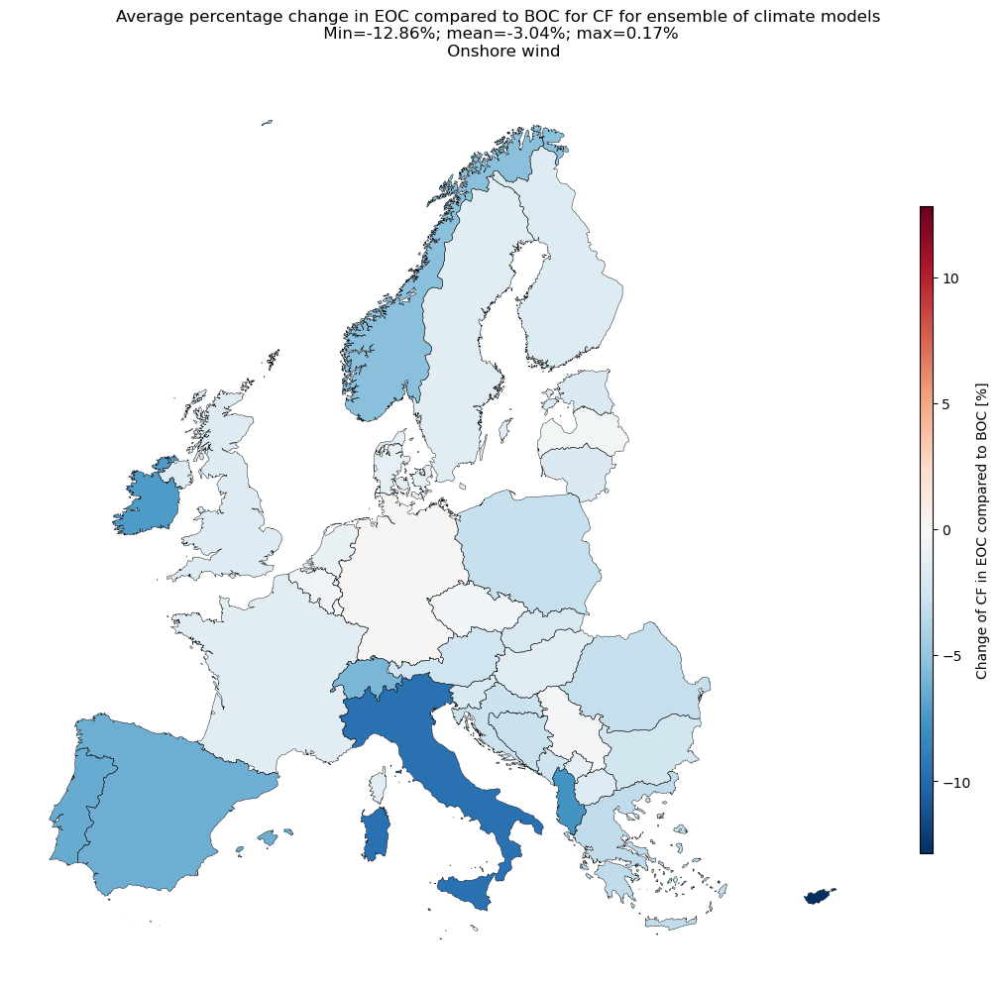

In [212]:
# Plotting total changes for ensemble: 
# Onshore wind

# Finding global abs max: 
abs_max_global = 0;
seasonal1_df = percent_diff_wind.to_dataframe(CMIP6_model)
Countries_europe_df = gpd.GeoDataFrame(Europe)
Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
column_name = f'{CMIP6_model}'
abs_max_local = np.nanmax(np.abs(Countries_europe_df[CMIP6_model]))
if abs_max_local > abs_max_global:
    abs_max_global = abs_max_local

# Plotting all 4 seasons:
norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
fig, axs = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')

seasonal1_df = percent_diff_wind.to_dataframe(CMIP6_model)
Countries_europe_df = gpd.GeoDataFrame(Europe)
Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
column_name = f'{CMIP6_model}'
# abs_max_local = np.abs(np.nanmax(Countries_europe_df[CMIP6_model]))
min_val = np.nanmin(Countries_europe_df[CMIP6_model])
max_val = np.nanmax(Countries_europe_df[CMIP6_model])
mean_val = np.nanmean(Countries_europe_df[CMIP6_model])

im = Countries_europe_df.plot(ax=axs,column=column_name,transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.5},
                norm=norm,aspect="equal").set_frame_on(False);
Europe.plot(ax=axs, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
# axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
fig.colorbar(im, ax=axs, location='right', fraction=.1,shrink=0.7,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
fig.suptitle(f'Average percentage change in EOC compared to BOC for CF for ensemble of climate models \n Min={round(min_val,2)}%; mean={round(mean_val,2)}%; max={round(max_val,2)}% \n Onshore wind');

# Saving figure to file: 
plot_filename = f'Ensemble_total_percentage_change_CF_per_country_wind_EOC_vs_BOC.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

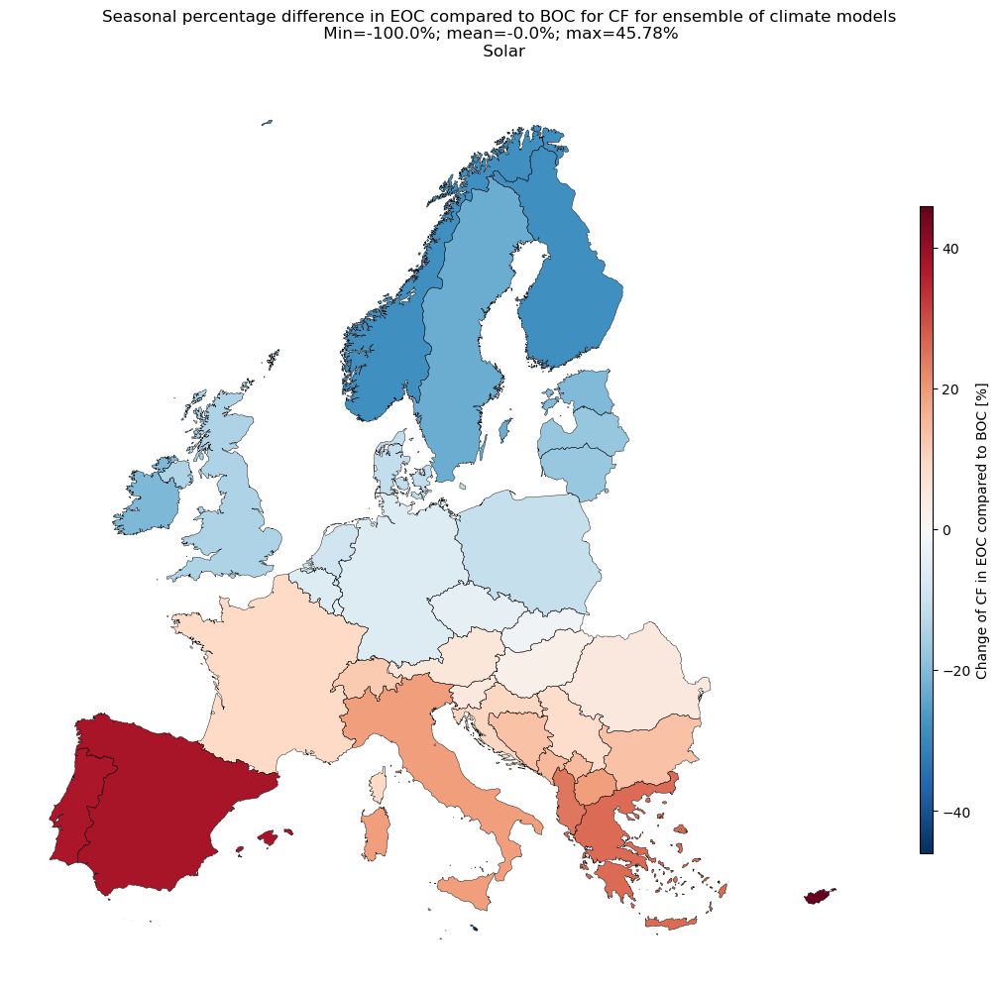

In [213]:
# Plotting seasonal changes for all season for ensemble: 
# Solar

# Finding global abs max: 
abs_max_global = 0;
# seasonal1_df = percent_diff_PV.to_dataframe(CMIP6_model)
# Countries_europe_df = gpd.GeoDataFrame(Europe)
# Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
# Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
# column_name = f'{CMIP6_model}'
# abs_max_local = np.nanmax(np.abs(Countries_europe_df[CMIP6_model]))
# abs_max_global = abs_max_local

# Plotting
fig, axs = plt.subplots(subplot_kw={"projection": projection},figsize=(10,10), layout='constrained')

seasonal1_df = percent_diff_PV.to_dataframe(CMIP6_model)
Countries_europe_df = gpd.GeoDataFrame(Europe)
Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
column_name = f'{CMIP6_model}'
abs_max_local = np.nanmax(np.abs(Countries_europe_df[CMIP6_model]))
# abs_max_global = abs_max_local
abs_max_global = 46;
min_val = np.nanmin(Countries_europe_df[CMIP6_model])
max_val = np.nanmax(Countries_europe_df[CMIP6_model])
mean_val = np.nanmean(Countries_europe_df[CMIP6_model])
norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
im = Countries_europe_df.plot(ax=axs,column=column_name,transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.5},
                norm=norm,aspect="equal").set_frame_on(False);
Europe.plot(ax=axs, edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
# axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
fig.colorbar(im, ax=axs, location='right', fraction=.1,shrink=0.7,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
fig.suptitle(f'Seasonal percentage difference in EOC compared to BOC for CF for ensemble of climate models \n Min={round(min_val,2)}%; mean={round(mean_val,2)}%; max={round(max_val,2)}% \n Solar');

# Saving figure to file: 
plot_filename = f'Ensemble_total_percentage_change_CF_per_country_PV_EOC_vs_BOC.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

In [214]:
# Calculating seasonal % difference EOC vs BOC

season = 'Summer'

CMIP6_model = 'EC-Earth3'
CMIP6_model = CMIP6_model.replace("-", "_")
BOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_15_22'
BOC = locals()[BOC_name].groupby("time.season").mean()
EOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_70_99'
EOC = locals()[EOC_name].groupby("time.season").mean()
percent_diff = ((EOC - BOC) / BOC)*100

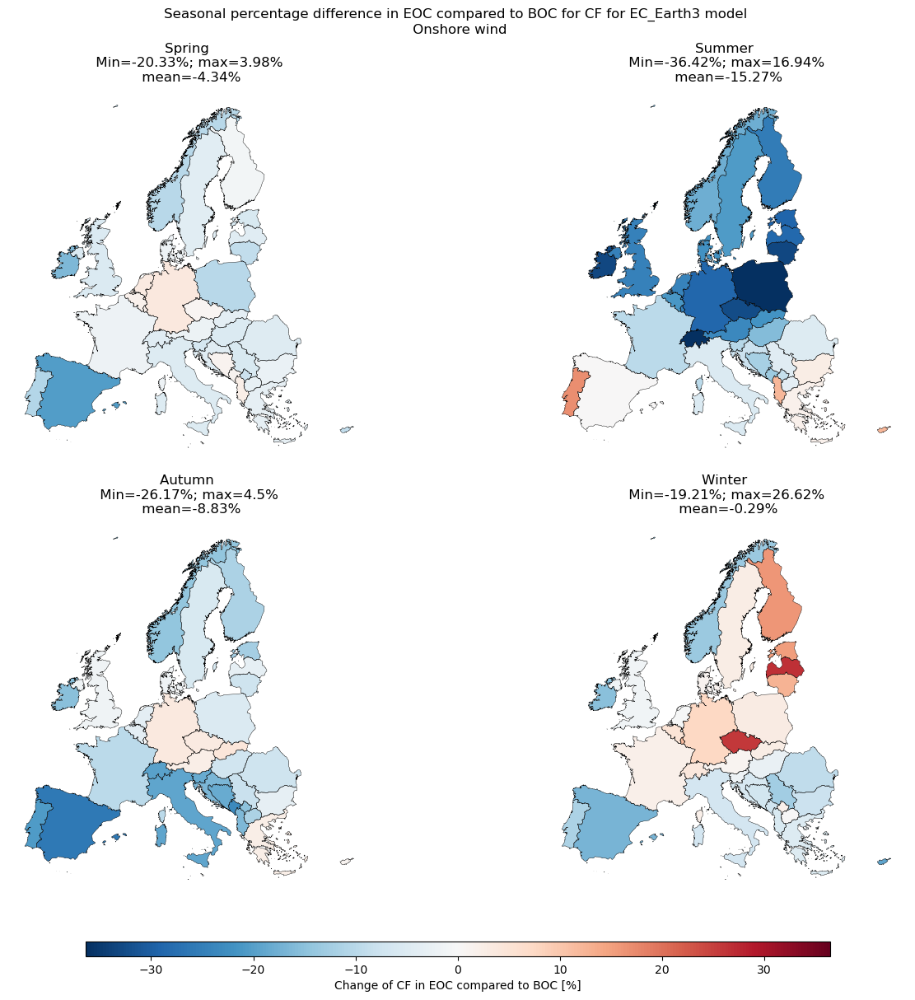

In [215]:
# Plotting seasonal changes for all season for 1 CMIP model: 

# Finding global abs max: 
abs_max_global = 0;
for season in seasons:
    if season == 'Winter':
        season_name = 'DJF'
    if season == 'Summer':
        season_name = 'JJA'
    if season == 'Spring':
        season_name = 'MAM'
    if season == 'Autumn':
        season_name = 'SON'
    seasonal1_df = percent_diff.sel(season=season_name).to_dataframe(CMIP6_model)
    Countries_europe_df = gpd.GeoDataFrame(Europe)
    Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
    Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
    column_name = f'{CMIP6_model}'
    abs_max_local = np.nanmax(np.abs(Countries_europe_df[CMIP6_model]))
    if abs_max_local > abs_max_global:
        abs_max_global = abs_max_local

# Plotting all 4 seasons:
norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
fig, axs = plt.subplots(2,2,subplot_kw={"projection": projection},figsize=(13,12), layout='constrained')
ii = 0;
for season in seasons:
    if season == 'Winter':
        season_name = 'DJF'
    if season == 'Summer':
        season_name = 'JJA'
    if season == 'Spring':
        season_name = 'MAM'
    if season == 'Autumn':
        season_name = 'SON'

    seasonal1_df = percent_diff.sel(season=season_name).to_dataframe(CMIP6_model)
    Countries_europe_df = gpd.GeoDataFrame(Europe)
    Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
    Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
    column_name = f'{CMIP6_model}'
    # abs_max_local = np.abs(np.nanmax(Countries_europe_df[CMIP6_model]))
    min_val = np.nanmin(Countries_europe_df[CMIP6_model])
    max_val = np.nanmax(Countries_europe_df[CMIP6_model])
    mean_val = np.nanmean(Countries_europe_df[CMIP6_model])

    im = Countries_europe_df.plot(ax=axs.flat[ii],column=column_name,transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.5},
                  norm=norm,aspect="equal").set_frame_on(False);
    Europe.plot(ax=axs.flat[ii], edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
    axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
    ii = ii+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
fig.suptitle(f'Seasonal percentage difference in EOC compared to BOC for CF for {CMIP6_model} model \n Onshore wind');

# Saving figure to file: 
plot_filename = f'Percentage_change_CF_per_country_wind_all_seasons_EOC_vs_BOC_{CMIP6_model}.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

In [216]:
# Calculating ENSEMBLE seasonal % difference EOC vs BOC
# Onshore wind
i = 0;
for CMIP6_model in CMIP6_models_wind_selection: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0:
        BOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_15_22'
        BOC = (locals()[BOC_name].groupby("time.season").mean()/len(CMIP6_models_wind_selection))
        EOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_70_99'
        EOC = (locals()[EOC_name].groupby("time.season").mean()/len(CMIP6_models_wind_selection))
    else:
        BOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_15_22'
        BOC = BOC + (locals()[BOC_name].groupby("time.season").mean()/len(CMIP6_models_wind_selection))
        EOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_70_99'
        EOC = EOC + (locals()[EOC_name].groupby("time.season").mean()/len(CMIP6_models_wind_selection))
    i = i+1;
percent_diff_tot_wind = ((EOC - BOC) / BOC)*100

In [217]:
# Solar
i = 0;
for CMIP6_model in CMIP6_models_solar: 
    CMIP6_model = CMIP6_model.replace("-", "_")
    if i == 0: 
        BOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].groupby("time.season").mean()/len(CMIP6_models_solar)
        EOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].groupby("time.season").mean()/len(CMIP6_models_solar)
    else: 
        BOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_15_22'
        BOC = BOC + locals()[BOC_name].groupby("time.season").mean()/len(CMIP6_models_solar)
        EOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_70_99'
        EOC = EOC + locals()[EOC_name].groupby("time.season").mean()/len(CMIP6_models_solar)
    i = i+1;
percent_diff_tot_PV = ((EOC - BOC) / BOC)*100

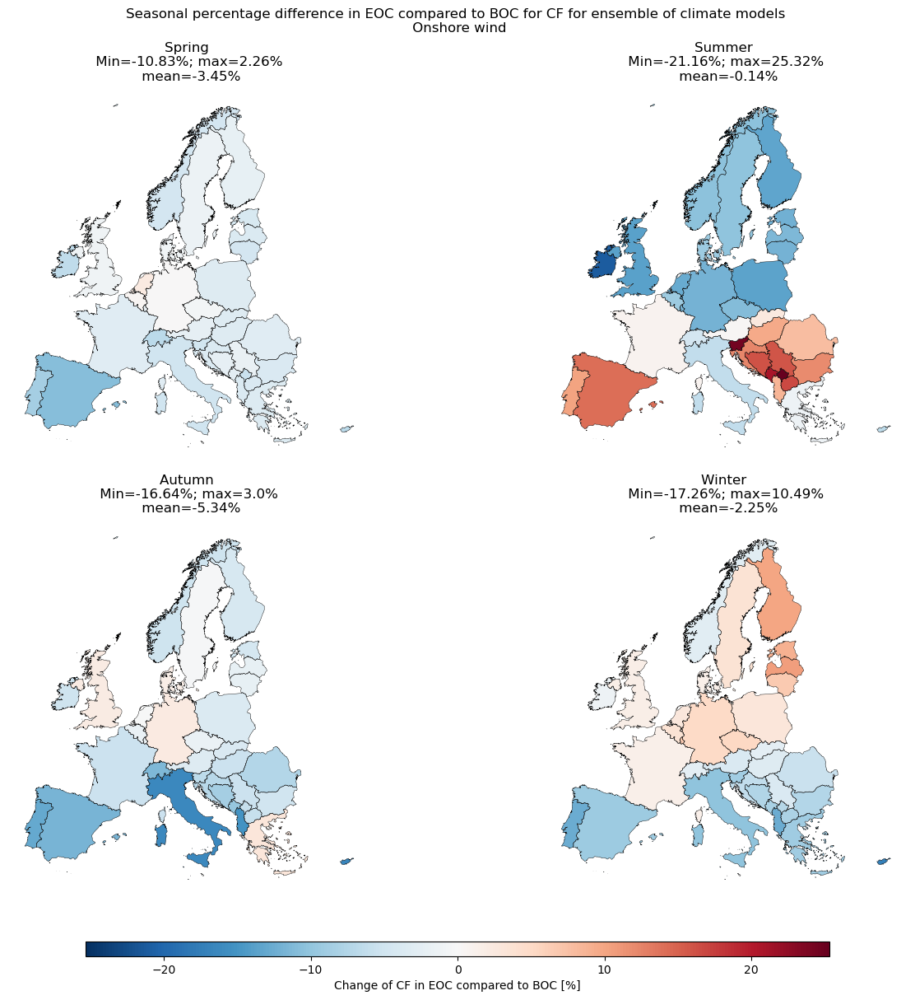

In [218]:
# Plotting seasonal changes for all season for ensemble: 
# Onshore wind

# Finding global abs max: 
abs_max_global = 0;
for season in seasons:
    if season == 'Winter':
        season_name = 'DJF'
    if season == 'Summer':
        season_name = 'JJA'
    if season == 'Spring':
        season_name = 'MAM'
    if season == 'Autumn':
        season_name = 'SON'
    seasonal1_df = percent_diff_tot_wind.sel(season=season_name).to_dataframe(CMIP6_model)
    Countries_europe_df = gpd.GeoDataFrame(Europe)
    Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
    Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
    column_name = f'{CMIP6_model}'
    abs_max_local = np.nanmax(np.abs(Countries_europe_df[CMIP6_model]))
    if abs_max_local > abs_max_global:
        abs_max_global = abs_max_local

# Plotting all 4 seasons:
norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
fig, axs = plt.subplots(2,2,subplot_kw={"projection": projection},figsize=(13,12), layout='constrained')
ii = 0;
for season in seasons:
    if season == 'Winter':
        season_name = 'DJF'
    if season == 'Summer':
        season_name = 'JJA'
    if season == 'Spring':
        season_name = 'MAM'
    if season == 'Autumn':
        season_name = 'SON'

    seasonal1_df = percent_diff_tot_wind.sel(season=season_name).to_dataframe(CMIP6_model)
    Countries_europe_df = gpd.GeoDataFrame(Europe)
    Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
    Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
    column_name = f'{CMIP6_model}'
    # abs_max_local = np.abs(np.nanmax(Countries_europe_df[CMIP6_model]))
    min_val = np.nanmin(Countries_europe_df[CMIP6_model])
    max_val = np.nanmax(Countries_europe_df[CMIP6_model])
    mean_val = np.nanmean(Countries_europe_df[CMIP6_model])

    im = Countries_europe_df.plot(ax=axs.flat[ii],column=column_name,transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.5},
                  norm=norm,aspect="equal").set_frame_on(False);
    Europe.plot(ax=axs.flat[ii], edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
    axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
    ii = ii+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
fig.suptitle(f'Seasonal percentage difference in EOC compared to BOC for CF for ensemble of climate models \n Onshore wind');

# Saving figure to file: 
plot_filename = f'Ensemble_percentage_change_CF_per_country_wind_all_seasons_EOC_vs_BOC.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

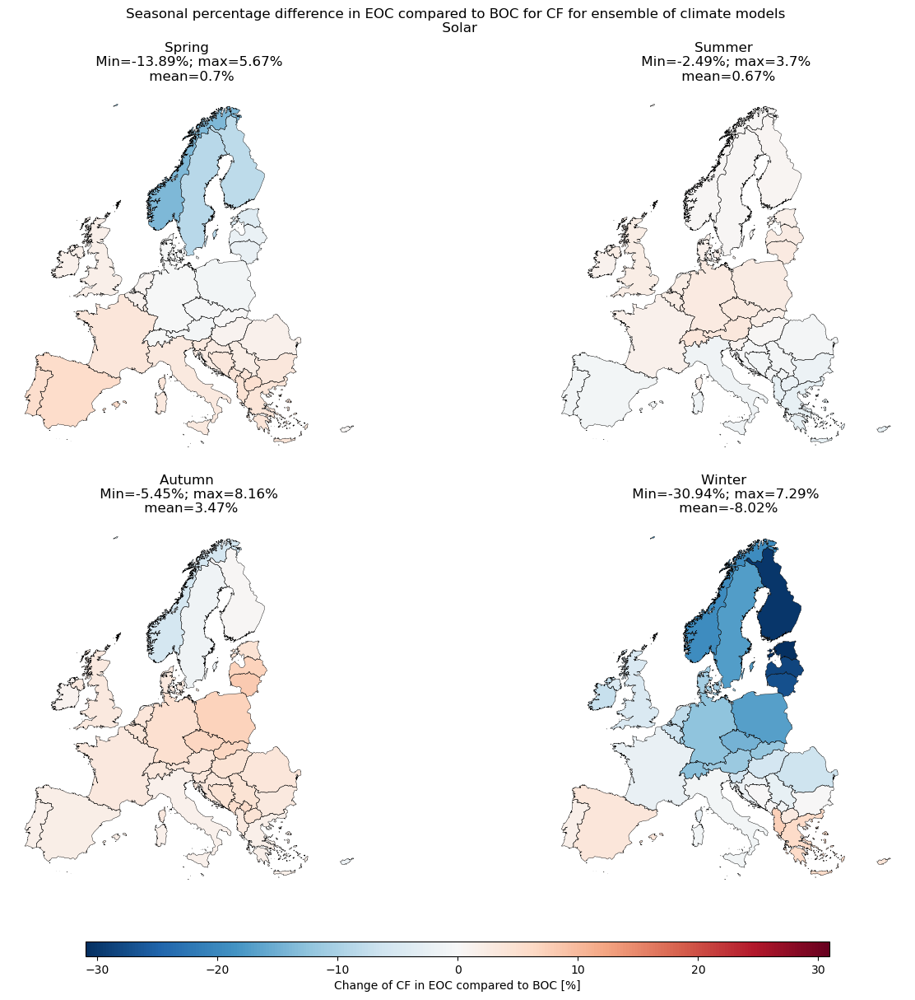

In [219]:
# Plotting seasonal changes for all season for ensemble: 
# Solar

# Finding global abs max: 
abs_max_global = 0;
for season in seasons:
    if season == 'Winter':
        season_name = 'DJF'
    if season == 'Summer':
        season_name = 'JJA'
    if season == 'Spring':
        season_name = 'MAM'
    if season == 'Autumn':
        season_name = 'SON'
    seasonal1_df = percent_diff_tot_PV.sel(season=season_name).to_dataframe(CMIP6_model)
    Countries_europe_df = gpd.GeoDataFrame(Europe)
    Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
    Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
    column_name = f'{CMIP6_model}'
    abs_max_local = np.nanmax(np.abs(Countries_europe_df[CMIP6_model]))
    if abs_max_local > abs_max_global:
        abs_max_global = abs_max_local

# Plotting all 4 seasons:
norm = TwoSlopeNorm(vmin=-abs_max_global, vcenter=0, vmax=abs_max_global);
fig, axs = plt.subplots(2,2,subplot_kw={"projection": projection},figsize=(13,12), layout='constrained')
ii = 0;
for season in seasons:
    if season == 'Winter':
        season_name = 'DJF'
    if season == 'Summer':
        season_name = 'JJA'
    if season == 'Spring':
        season_name = 'MAM'
    if season == 'Autumn':
        season_name = 'SON'

    seasonal1_df = percent_diff_tot_PV.sel(season=season_name).to_dataframe(CMIP6_model)
    Countries_europe_df = gpd.GeoDataFrame(Europe)
    Countries_europe_df.rename(columns ={0:'geometry'},inplace=True);
    Countries_europe_df[CMIP6_model] = seasonal1_df[CMIP6_model]
    column_name = f'{CMIP6_model}'
    # abs_max_local = np.abs(np.nanmax(Countries_europe_df[CMIP6_model]))
    min_val = np.nanmin(Countries_europe_df[CMIP6_model])
    max_val = np.nanmax(Countries_europe_df[CMIP6_model])
    mean_val = np.nanmean(Countries_europe_df[CMIP6_model])

    im = Countries_europe_df.plot(ax=axs.flat[ii],column=column_name,transform=plate(),cmap="RdBu_r",#legend=True,legend_kwds={'shrink': 0.5},
                  norm=norm,aspect="equal").set_frame_on(False);
    Europe.plot(ax=axs.flat[ii], edgecolor='k', transform=plate(),color="None", aspect="equal",linewidth=0.3).set_frame_on(False)
    axs.flat[ii].set_title(f'{season} \n Min={round(min_val,nr_of_decimals)}%; max={round(max_val,nr_of_decimals)}% \n mean={round(mean_val,nr_of_decimals)}%')
    ii = ii+1;
fig.colorbar(im, ax=axs, location='bottom', fraction=.1,shrink=0.7,aspect=50,norm=norm,cmap="RdBu_r",label='Change of CF in EOC compared to BOC [%]')
fig.suptitle(f'Seasonal percentage difference in EOC compared to BOC for CF for ensemble of climate models \n Solar');

# Saving figure to file: 
plot_filename = f'Ensemble_percentage_change_CF_per_country_PV_all_seasons_EOC_vs_BOC.png';
# plt.savefig(plot_path(plot_filename), dpi=300);

## Plotting duration curves per coutnry

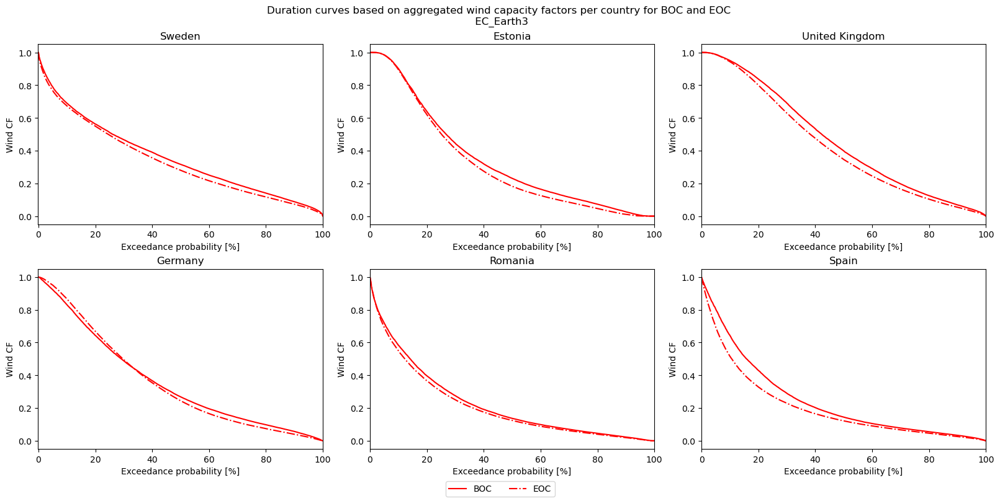

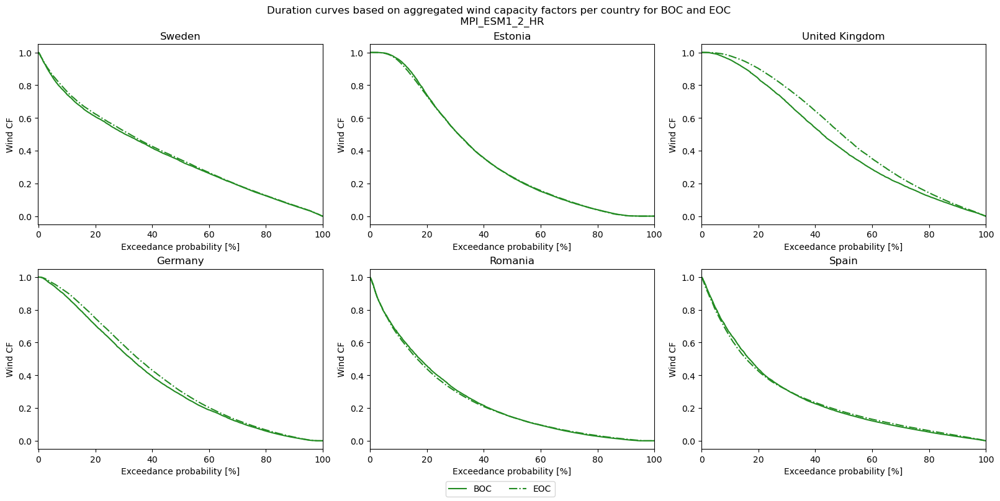

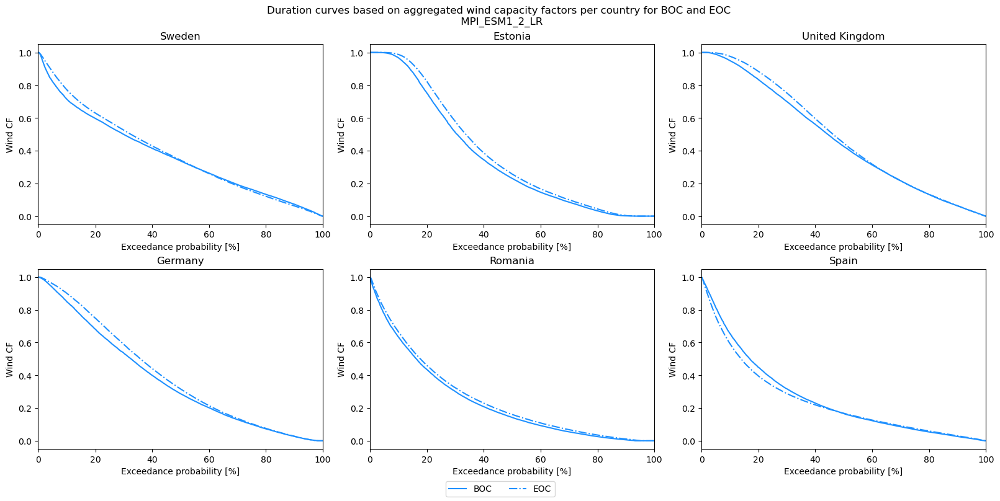

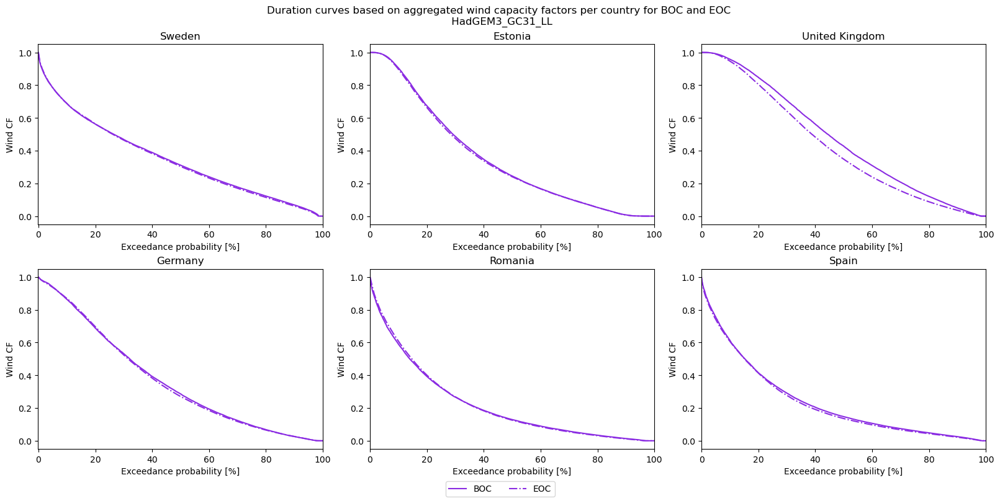

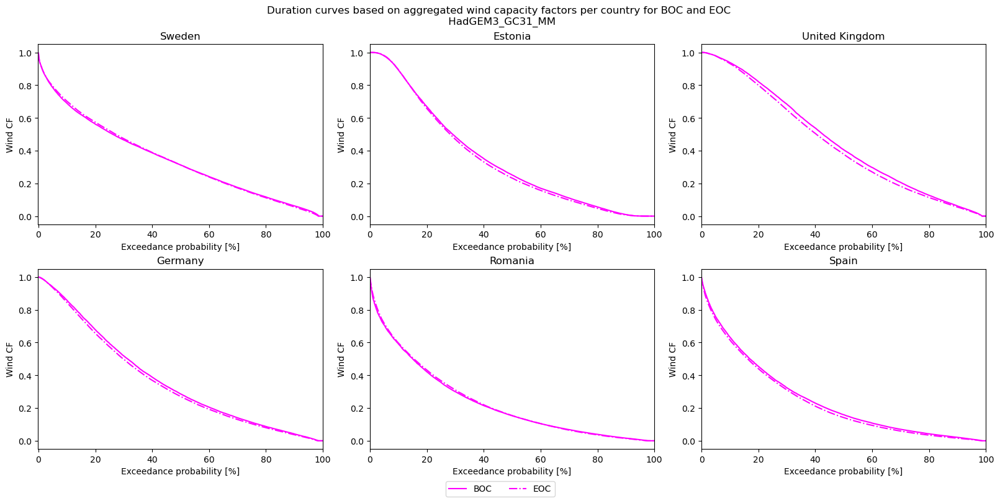

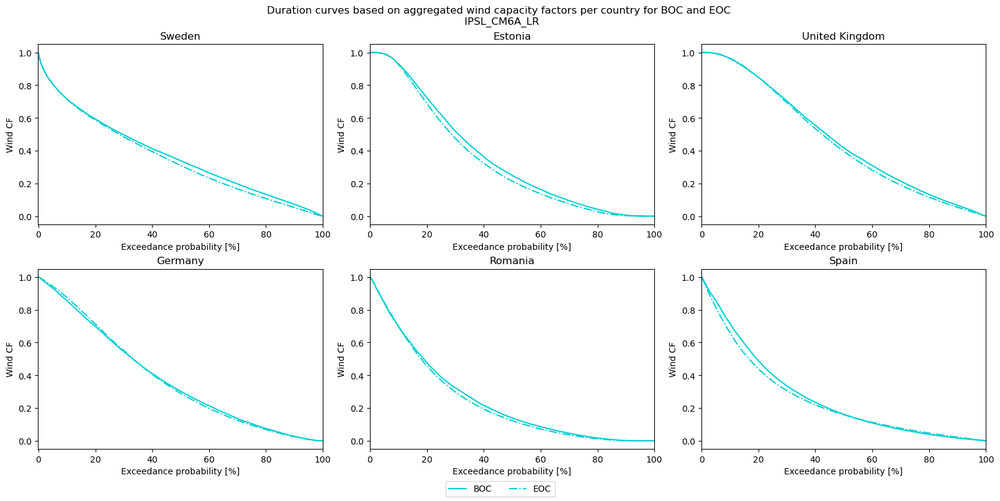

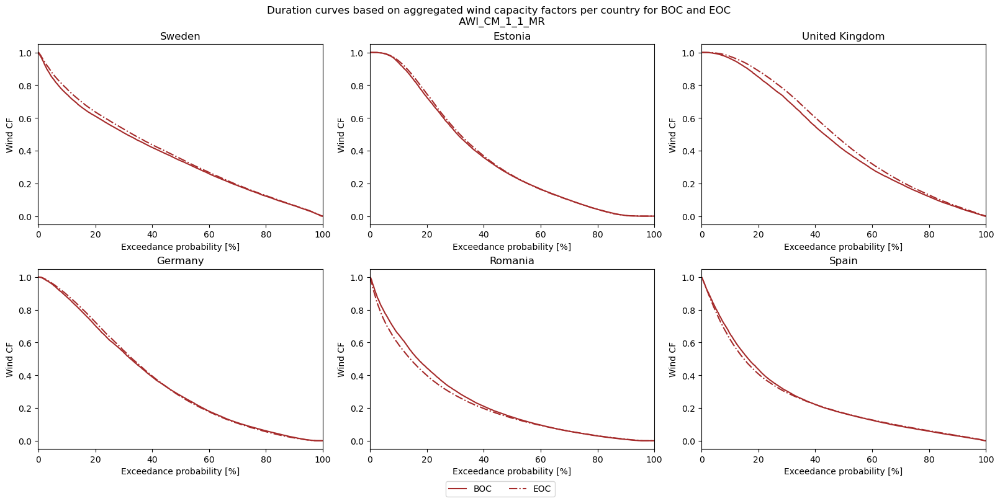

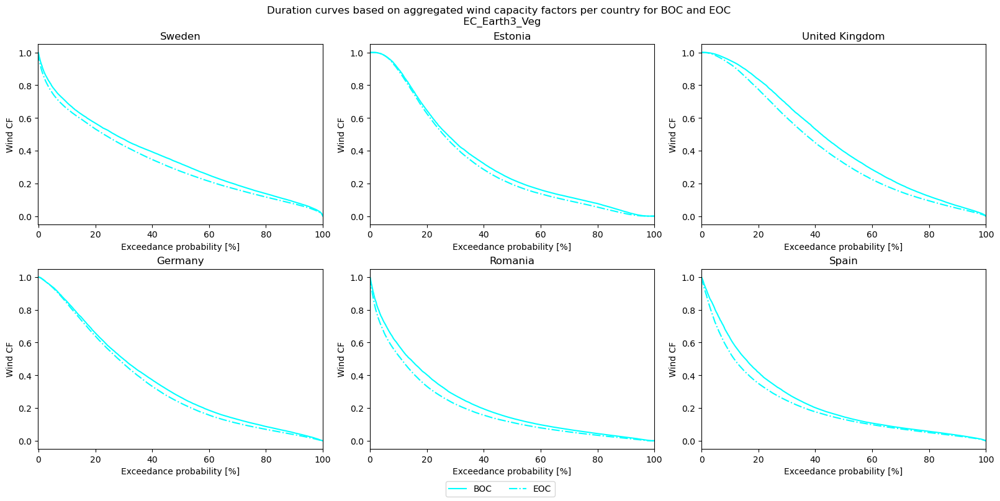

In [220]:
# Plotting duration curves for 6 countries from the reference points

for CMIP6_model in CMIP6_models_wind_selection:
    # CMIP6_model = 'AWI-CM-1-1-MR'
    # CMIP6_model = CMIP6_models_wind_selection[0]
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")

    fig,axs = plt.subplots(2,3,figsize=(16,8),layout='constrained')
    title = f'Duration curves based on aggregated wind capacity factors per country for BOC and EOC \n {CMIP6_model}'
    fig.suptitle(title)
    legend_mod = False;

    for ii in range(6):
        point_name = f'point_{ii+1}';
        country_name = ref_country[ii]
        point = locals()[point_name];
        BOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].sel(dim_0=country_name).squeeze().to_series()
        EOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].sel(dim_0=country_name).squeeze().to_series()

        dur2 = pd.DataFrame(BOC).sort_values(by=0,ascending = False)
        title = 'BOC';
        dur_test = pd.DataFrame({title:dur2[0]});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,100],ylim=[-0.05,1.05],legend=legend_mod,label=f'BOC', color=plotcolor);

        dur2 = pd.DataFrame(EOC).sort_values(by=0,ascending = False)
        title = 'EOC';
        dur_test = pd.DataFrame({title:dur2[0]});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,100],ylim=[-0.05,1.05],linestyle='-.',legend=legend_mod,label=f'EOC', color=plotcolor);

        axs.flat[ii].set_ylabel('Wind CF')
        axs.flat[ii].set(xlabel='Exceedance probability [%]')
        axs.flat[ii].set_title(f'{country_name}')
        if ii == 0: 
            fig.legend(ncols=2,loc='outside lower center')

    # Saving figure to file: 
    plot_filename = f'Aggregated wind CF duration curves per country for BOC and EOC for {CMIP6_model}';
    # plt.savefig(plot_path(plot_filename), dpi=300);

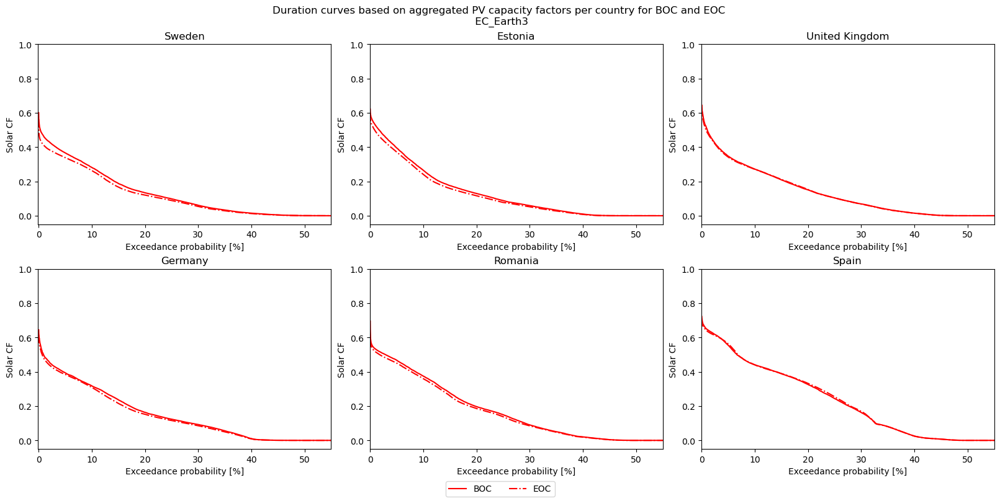

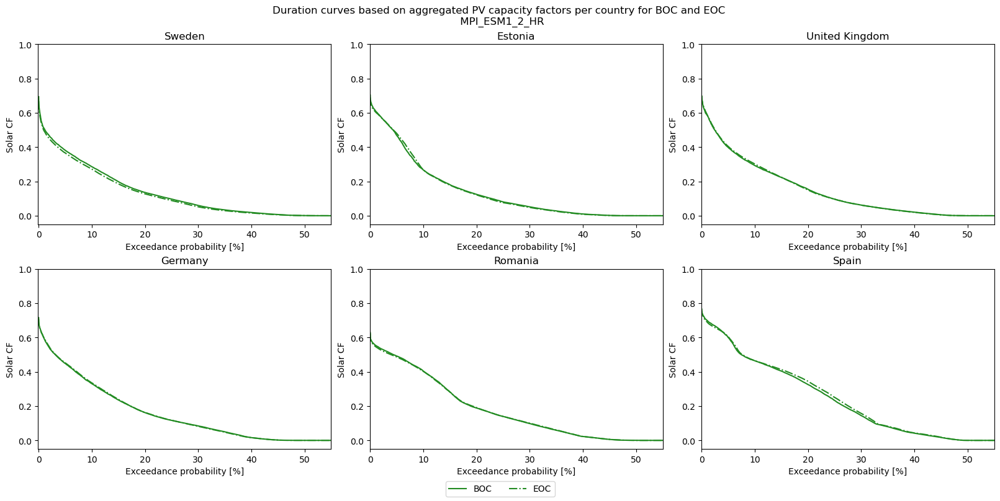

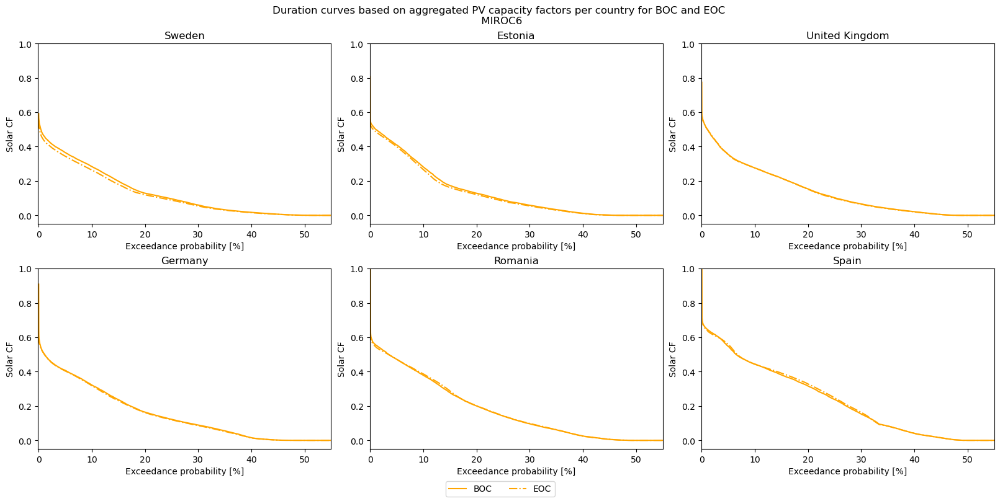

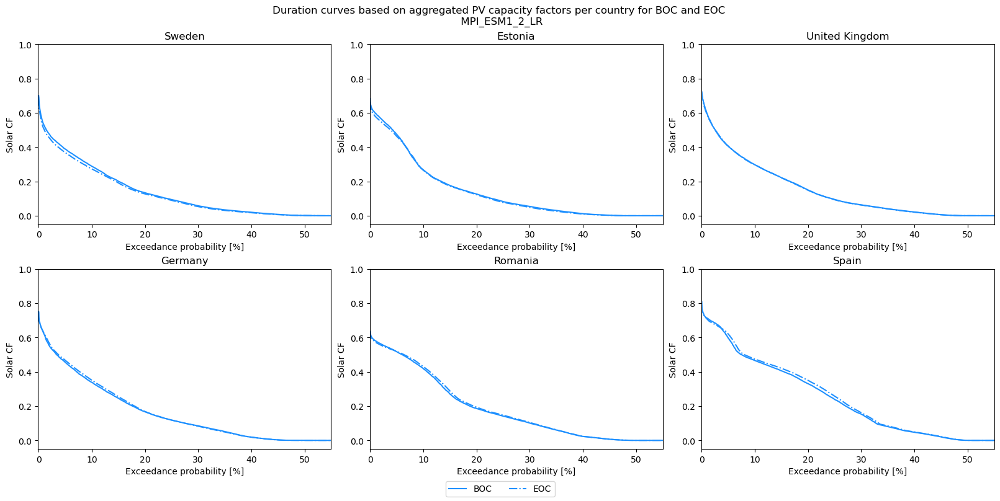

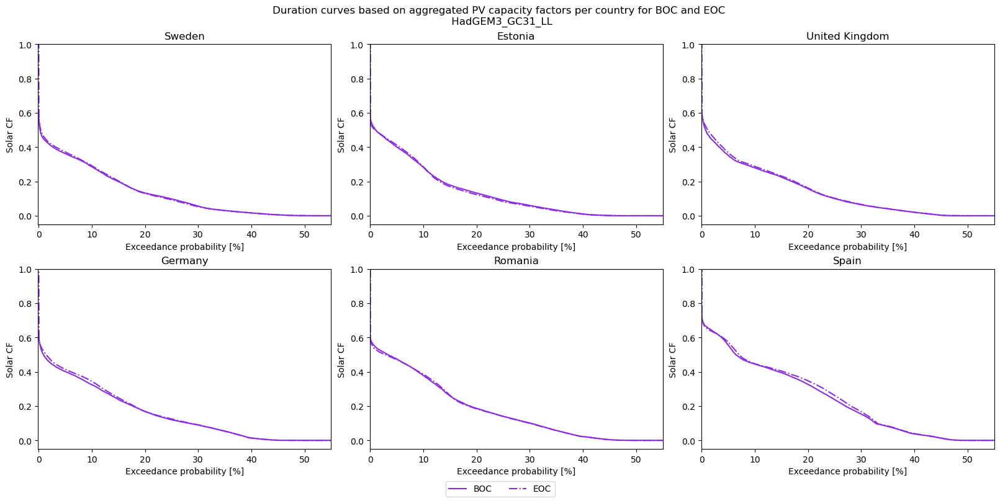

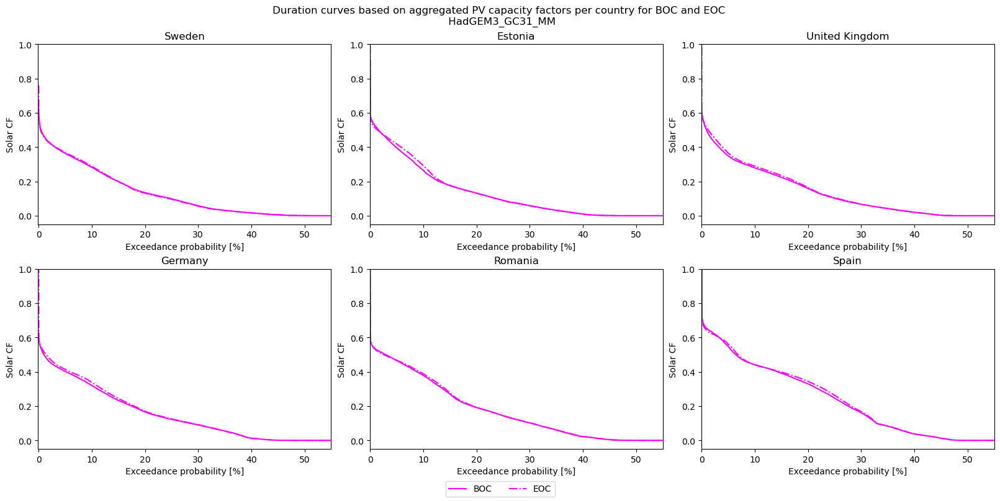

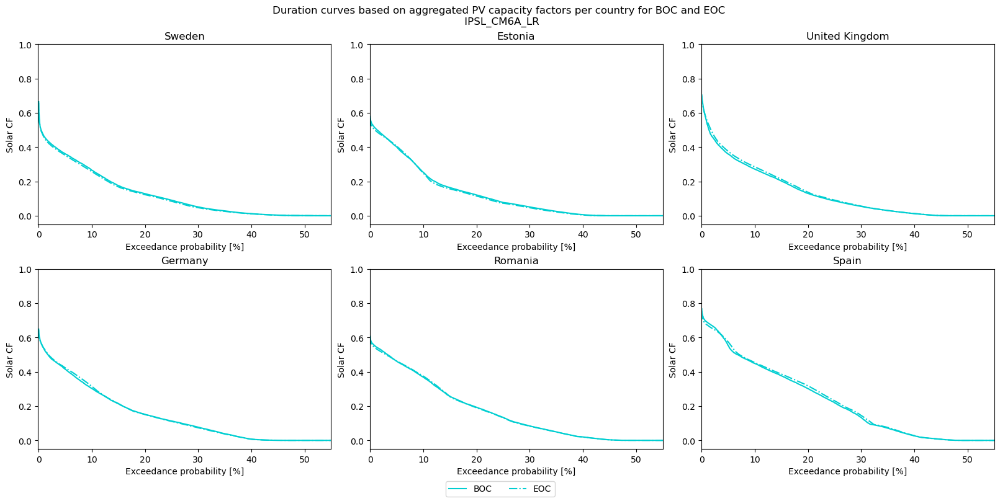

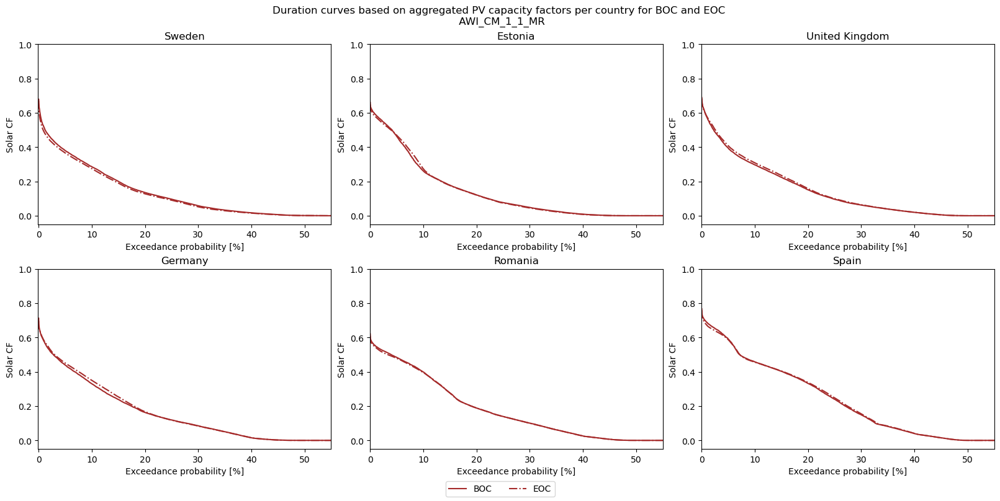

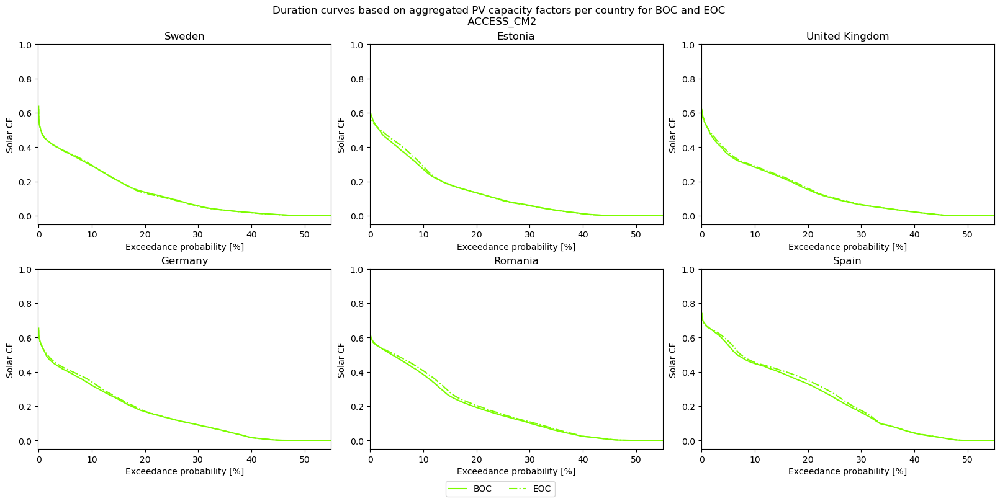

In [221]:
# Plotting duration curves for 6 countries from the reference points

for CMIP6_model in CMIP6_models_solar:
    # CMIP6_model = 'AWI-CM-1-1-MR'
    # CMIP6_model = CMIP6_models_wind_selection[0]
    plotcolor = model_colors.loc[CMIP6_model]['Color']
    CMIP6_model = CMIP6_model.replace("-", "_")

    fig,axs = plt.subplots(2,3,figsize=(16,8),layout='constrained')
    title = f'Duration curves based on aggregated PV capacity factors per country for BOC and EOC \n {CMIP6_model}'
    fig.suptitle(title)
    legend_mod = False;

    for ii in range(6):
        point_name = f'point_{ii+1}';
        country_name = ref_country[ii]
        point = locals()[point_name];
        BOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_15_22'
        BOC = locals()[BOC_name].sel(dim_0=country_name).squeeze().to_series()
        EOC_name = f'Aggregated_CF_timeseries_per_country_PV_{CMIP6_model}_ssp585_70_99'
        EOC = locals()[EOC_name].sel(dim_0=country_name).squeeze().to_series()

        dur2 = pd.DataFrame(BOC).sort_values(by=0,ascending = False)
        title = 'BOC';
        dur_test = pd.DataFrame({title:dur2[0]});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,55],ylim=[-0.05,1],legend=legend_mod,label=f'BOC', color=plotcolor);

        dur2 = pd.DataFrame(EOC).sort_values(by=0,ascending = False)
        title = 'EOC';
        dur_test = pd.DataFrame({title:dur2[0]});
        # Use the cumsum() function to to add a column with the duration 
        # for which the system load is greater than or equal to each load
        dur_test['Interval'] = 1;
        dur_test['Duration'] = dur_test['Interval'].cumsum();
        dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
        dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,55],ylim=[-0.05,1],linestyle='-.',legend=legend_mod,label=f'EOC', color=plotcolor);

        axs.flat[ii].set_ylabel('Solar CF')
        axs.flat[ii].set(xlabel='Exceedance probability [%]')
        axs.flat[ii].set_title(f'{country_name}')
        if ii == 0: 
            fig.legend(ncols=2,loc='outside lower center')

    # Saving figure to file: 
    plot_filename = f'Aggregated PV CF duration curves per country for BOC and EOC for {CMIP6_model}';
    # plt.savefig(plot_path(plot_filename), dpi=300);

In [222]:
# diff_dur_curves = pd.DataFrame()
# diff_dur_curves['Percentage'] = dur_test2['Percentage']
# diff_dur_curves.set_index('Percentage')
# diff_dur_curves['diff'] = dur_test2.set_index('Percentage')['EOC'] - dur_test.set_index('Percentage')['BOC']
# diff_dur_curves

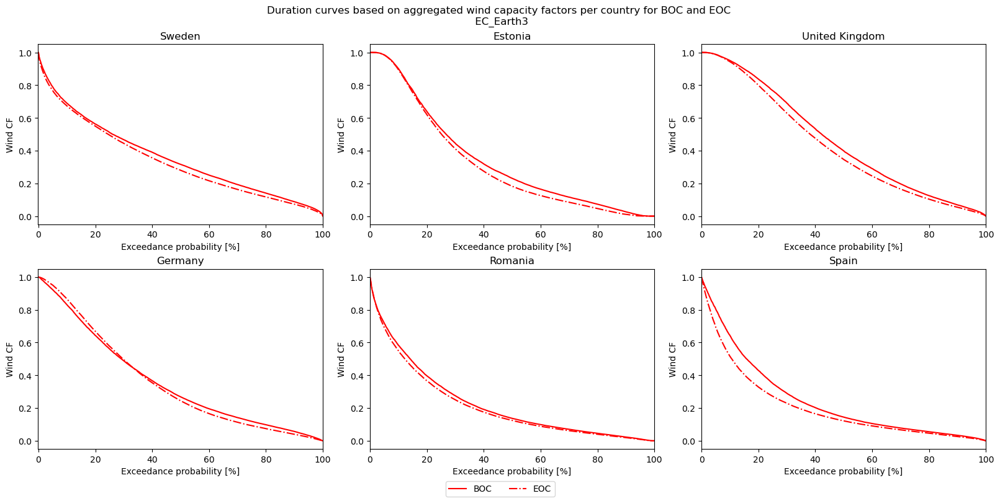

In [223]:
# Plotting duration curves for 6 countries from the reference points

# CMIP6_model = 'AWI-CM-1-1-MR'
CMIP6_model = CMIP6_models_wind_selection[0]
plotcolor = model_colors.loc[CMIP6_model]['Color']
CMIP6_model = CMIP6_model.replace("-", "_")

fig,axs = plt.subplots(2,3,figsize=(16,8),layout='constrained')
title = f'Duration curves based on aggregated wind capacity factors per country for BOC and EOC \n {CMIP6_model}'
fig.suptitle(title)
legend_mod = False;

for ii in range(6):
    point_name = f'point_{ii+1}';
    country_name = ref_country[ii]
    point = locals()[point_name];
    BOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_15_22'
    BOC = locals()[BOC_name].sel(dim_0=country_name).squeeze().to_series()
    EOC_name = f'Aggregated_CF_timeseries_per_country_wind_{CMIP6_model}_ssp585_70_99'
    EOC = locals()[EOC_name].sel(dim_0=country_name).squeeze().to_series()

    dur2 = pd.DataFrame(BOC).sort_values(by=0,ascending = False)
    title = 'BOC';
    dur_test = pd.DataFrame({title:dur2[0]});
    # Use the cumsum() function to to add a column with the duration 
    # for which the system load is greater than or equal to each load
    dur_test['Interval'] = 1;
    dur_test['Duration'] = dur_test['Interval'].cumsum();
    dur_test['Percentage'] = dur_test['Duration']*100/len(dur_test);
    dur_test.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,100],ylim=[-0.05,1.05],legend=legend_mod,label=f'BOC', color=plotcolor);

    dur2 = pd.DataFrame(EOC).sort_values(by=0,ascending = False)
    title = 'EOC';
    dur_test2 = pd.DataFrame({title:dur2[0]});
    # Use the cumsum() function to to add a column with the duration 
    # for which the system load is greater than or equal to each load
    dur_test2['Interval'] = 1;
    dur_test2['Duration'] = dur_test2['Interval'].cumsum();
    dur_test2['Percentage'] = dur_test2['Duration']*100/len(dur_test2);
    dur_test2.plot(ax=axs.flat[ii],x = 'Percentage', y = title, xlim=[-0.1,100],ylim=[-0.05,1.05],linestyle='-.',legend=legend_mod,label=f'EOC', color=plotcolor);

    # diff_dur_curves = dur_test2['EOC'] - dur_test2['BOC']

    axs.flat[ii].set_ylabel('Wind CF')
    axs.flat[ii].set(xlabel='Exceedance probability [%]')
    axs.flat[ii].set_title(f'{country_name}')
    if ii == 0: 
        fig.legend(ncols=2,loc='outside lower center')

# Saving figure to file: 
plot_filename = f'Aggregated wind CF duration curves per country for BOC and EOC for {CMIP6_model}';
# plt.savefig(plot_path(plot_filename), dpi=300);